# Imports

In [2]:
import numpy as np
from mpl_toolkits import mplot3d
import matplotlib.pyplot as plt
from scipy.special import legendre
import math
import pandas as pd
import xlsxwriter 

plt.rcParams.update({'font.size': 18})



#  Realtime 3d plotting
#%matplotlib notebook

#%matplotlib inline

#  Data 

In [3]:
#  Data
#  Phase shift data from P Van Reeth for Positron-hyd s,p,d,f waves
#  Runs other .ipynb files that stores P Van Reeth's phase shift data into a list of floats
%run van_reeth_data.ipynb
%run vr_higher.ipynb
%run vr_pos_hel_data.ipynb


#  Phase shift data from P Van Reeth and J W Humberston 1999 for Positron-helium
phase_shift_0_positron_hel = [0.035, 0.041, 0.030, 0.008, -0.021, 
                              -0.054, -0.089, -0.124, -0.157, -0.189, -0.219]
phase_shift_1_positron_hel = [
    0.003, 0.010, 0.019, 0.030, 0.041, 0.049, 0.056, 0.060, 0.061, 0.060, 0.058]
phase_shift_2_positron_hel = [0.0014, 0.0016, 0.004,
                              0.006, 0.011, 0.014, 0.021, 0.026, 0.031, 0.037, 0.043]
phase_shift_3_positron_hel = [0.00014, 0.00055, 0.00124,
                              0.00211, 0.004, 0.006, 0.008, 0.010, 0.012, 0.017, 0.021]



# Phase shift data from J W Humberston, P Van Reeth, M S T Watts and W E Meyerhof 1997 for the s,p waves for Positron-hydrogen
phase_shift_0_positron_hyd_array = np.array(
    [0.1479, 0.1875, 0.1672, 0.1198, 0.0624, 0.0036, -0.0515])
phase_shift_1_positron_hyd_array = np.array(
    [0.0086, 0.032, 0.0657, 0.1003, 0.1306, 0.1544, 0.1786])
#  Correct d wave, f wave from T T Gien 1997 for the d,f waves for Positron-hydrogen
phase_shift_2_positron_hyd_array = np.array(
    [0.00134, 0.00548, 0.0129, 0.0241, 0.0396, 0.0597, 0.0884])
phase_shift_3_positron_hyd_array = np.array(
    [0.000436, 0.00177, 0.00406, 0.00751, 0.0125, 0.0197, 0.0306])



#  Storing P Van Reeth's k values in a list for positron-hydrogen
k_list_positron_hyd_vr = []
count = 0
#  van_reeth_floats from van_reeth_data.ipynb
for value in van_reeth_floats:
    if count == 0:
        k_list_positron_hyd_vr.append(value)
    count += 1
    if count == 3:
        count = 0
    if len(k_list_positron_hyd_vr) == 87:
        break


#  storing all inverse kohn values for Positron-hydrogen from P Van Reeth
phase_values_positron_hyd_vr_inv_kohn = []
count = 0
for value in van_reeth_floats:
    if count == 2:
        phase_values_positron_hyd_vr_inv_kohn.append(value)
    count += 1
    if count == 3:
        count = 0

#  storing all kohn values for Positron-hydrogen from P Van Reeth
phase_values_positron_hyd_vr_kohn = []
count = 0
for value in van_reeth_floats:
    if count == 1:
        phase_values_positron_hyd_vr_kohn.append(value)
    count += 1
    if count == 3:
        count = 0

#  Storing the inverse-kohn phase shifts in list for each s,p,d,f waves from P Van Reeth for positron-hydrogen
phase_shift_0_positron_hyd_vr_inv_kohn = phase_values_positron_hyd_vr_inv_kohn[0:87]
phase_shift_1_positron_hyd_vr_inv_kohn = phase_values_positron_hyd_vr_inv_kohn[87:174]
phase_shift_2_positron_hyd_vr_inv_kohn = phase_values_positron_hyd_vr_inv_kohn[174:261]
phase_shift_3_positron_hyd_vr_inv_kohn = phase_values_positron_hyd_vr_inv_kohn[261:348]

phase_shift_0_positron_hyd_vr_kohn = phase_values_positron_hyd_vr_kohn[0:87]
phase_shift_1_positron_hyd_vr_kohn = phase_values_positron_hyd_vr_kohn[87:174]
phase_shift_2_positron_hyd_vr_kohn = phase_values_positron_hyd_vr_kohn[174:261]
phase_shift_3_positron_hyd_vr_kohn = phase_values_positron_hyd_vr_kohn[261:348]





#  Storing the inverse-kohn phase shift data for 3<l=<9 from P Van Reeth
phase_shift_4_positron_hyd_vr_inv_kohn = []
phase_shift_5_positron_hyd_vr_inv_kohn = []
phase_shift_6_positron_hyd_vr_inv_kohn = []
phase_shift_7_positron_hyd_vr_inv_kohn = []
phase_shift_8_positron_hyd_vr_inv_kohn = []
phase_shift_9_positron_hyd_vr_inv_kohn = []
k_vr_higher = [] # k values for waves 3<l=<9
for value in vr_higher:
    if count == 0:
        k_vr_higher.append(value)
    count += 1
    if count == 13:
        count = 0

count = 0
for value in vr_higher:
    if count == 2:
        phase_shift_4_positron_hyd_vr_inv_kohn.append(value)
    elif count == 4:
        phase_shift_5_positron_hyd_vr_inv_kohn.append(value)
    elif count == 6:
        phase_shift_6_positron_hyd_vr_inv_kohn.append(value)
    elif count == 8:
        phase_shift_7_positron_hyd_vr_inv_kohn.append(value)
    elif count == 10:
        phase_shift_8_positron_hyd_vr_inv_kohn.append(value)
    elif count == 12:
        phase_shift_9_positron_hyd_vr_inv_kohn.append(value)
    count += 1
    if count == 13:
        count = 0

#  sliced phase shift lists to match the k limit of the lower waves to the higher waves, higher waves stopped at a lower k than the lower waves
phase_shift_0_positron_hyd_sl = phase_shift_0_positron_hyd_vr_inv_kohn[:77]
phase_shift_1_positron_hyd_sl = phase_shift_1_positron_hyd_vr_inv_kohn[:77]
phase_shift_2_positron_hyd_sl = phase_shift_2_positron_hyd_vr_inv_kohn[:77]
phase_shift_3_positron_hyd_sl = phase_shift_3_positron_hyd_vr_inv_kohn[:77]



#  Kohn values, positron-hydrogen higher waves, P Van Reeth
phase_shift_4_positron_hyd_vr_kohn = []
phase_shift_5_positron_hyd_vr_kohn = []
phase_shift_6_positron_hyd_vr_kohn = []
phase_shift_7_positron_hyd_vr_kohn = []
phase_shift_8_positron_hyd_vr_kohn = []
phase_shift_9_positron_hyd_vr_kohn = []
count = 0
for value in vr_higher:
    if count == 1:
        phase_shift_4_positron_hyd_vr_kohn.append(value)
    elif count == 3:
        phase_shift_5_positron_hyd_vr_kohn.append(value)
    elif count == 5:
        phase_shift_6_positron_hyd_vr_kohn.append(value)
    elif count == 7:
        phase_shift_7_positron_hyd_vr_kohn.append(value)
    elif count == 9:
        phase_shift_8_positron_hyd_vr_kohn.append(value)
    elif count == 11:
        phase_shift_9_positron_hyd_vr_kohn.append(value)
    count += 1
    if count == 13:
        count = 0

#  sliced as before but for kohn values
phase_shift_0_positron_hyd_sl_k = phase_shift_0_positron_hyd_vr_kohn[:77]
phase_shift_1_positron_hyd_sl_k = phase_shift_1_positron_hyd_vr_kohn[:77]
phase_shift_2_positron_hyd_sl_k = phase_shift_2_positron_hyd_vr_kohn[:77]
phase_shift_3_positron_hyd_sl_k = phase_shift_3_positron_hyd_vr_kohn[:77]



# hybrid for higher waves, in order to reduce singularities 

phase_shift_4_positron_hyd_hyb = []
for i in range(len(phase_shift_4_positron_hyd_vr_inv_kohn)):
    if i < 36 or 44 < i < 61 or 67 < i :
        phase_shift_4_positron_hyd_hyb.append(phase_shift_4_positron_hyd_vr_inv_kohn[i])
    else:
        phase_shift_4_positron_hyd_hyb.append(phase_shift_4_positron_hyd_vr_kohn[i])


#  POSITRONIUM-HELIUM
#  Data from Nirmal K Sarkar et al 1999 J. Phys. B: At. Mol. Opt. Phys. 32 1657

phase_shift_0_ps_hel = [2.9514, 2.764, 2.584, 2.412, 2.260, 2.103, 1.966, 1.843]
phase_shift_1_ps_hel = [-0.00254, -0.0185, -0.0545, -0.109, -0.177, -0.253, -0.329, -0.403]
phase_shift_2_ps_hel = [-0.0000112, -0.000331, -0.00220, -0.00772, -0.0189, -0.0365, -0.0601, -0.0879]

#  ELECTRON-HELIUM
#  From R K Nesbet 1979
phase_shift_0_e_hel = [3.0134, 2.8761, 2.7395, 2.6028, 2.4732,
                 2.3486, 2.2349, 2.1261, 2.0253, 1.9359, 1.8568]
phase_shift_1_e_hel = [0.0031, 0.0131, 0.0306, 0.0552, 0.0861,
                 0.1209, 0.1588, 0.1960, 0.2305, 0.2626, 0.2932]
phase_shift_2_e_hel = [0.0004, 0.0017, 0.0037, 0.0066, 0.0104,
                 0.0149, 0.0203, 0.0265, 0.0335, 0.0414, 0.0501]
#  From A. L. Sinfailam and R K Nesbet 1972
phase_shift_3_e_hel = [0.00013, 0.00031, 0.00052, 0.00095,
                 0.0015, 0.0023, 0.0032, 0.0043, 0.0057, 0.0076, 0.0098]



#  Storing P Van Reeth's Positron-Helium data
phase_shift_0_positron_hel_vr = []
phase_shift_1_positron_hel_vr = []
phase_shift_2_positron_hel_vr = []
phase_shift_3_positron_hel_vr = []

energy_vr_pos_hel = [] #  values provided by P Van Reeth were in E (eV)


count = 0
for value in vr_pos_hel:
    if count == 0:
        energy_vr_pos_hel.append(value)
    elif count == 1:
        phase_shift_0_positron_hel_vr.append(value)
    elif count == 2:
        phase_shift_1_positron_hel_vr.append(value)
    elif count == 3:
        phase_shift_2_positron_hel_vr.append(value)
    elif count == 4:
        phase_shift_3_positron_hel_vr.append(value)
    count += 1
    if count == 6:
        count = 0

k_vr_pos_hel = [np.sqrt(2*(i/27.211)) for i in energy_vr_pos_hel]  # converting energy (eV) to k (au)


# ELECTRON-POSITRONIUM
k_e_ps_w = [0.05,.10,0.15,0.20,0.25,0.30,0.35,0.40,0.45,0.50]  #  Ward et al 1987

#  Singlet Phase shift data from Ward et al 1987

phase_shift_0_e_ps_w = [2.547,2.049,1.668,1.378,1.156,0.984,0.852,0.748,0.667,0.617]

phase_shift_1_e_ps_w = [-0.0006,-0.038,-0.123,-0.235,-0.353,-0.463,-0.559,-0.635,-0.687,-0.664]

phase_shift_2_e_ps_w = [0.0007,0.0093,0.0320,0.0769,0.141,0.210,0.269,0.308,0.329,0.335]

phase_shift_3_e_ps_w = [0.0006,0.0013,0.0042,0.0050,0.0024,-0.0046,-0.0148,-0.0260,-0.0362,-0.0439]


#  Triplet phaseshifts from Ward et al 1987

phase_shift_0_e_ps_trip_w = [-0.25,-0.5361,-0.797,-1.035,-1.247,-1.432,-1.596,-1.739,-1.865,-1.975]

phase_shift_1_e_ps_trip_w = [0.031,0.192,0.484,0.707,0.784,0.778,0.737,0.687,0.641,0.647]   #  error at k = 0.50?

phase_shift_2_e_ps_trip_w = [0.0005,0.0040,0.0012,-0.0142,-0.0420,-0.0764,-0.111,-0.141,-0.162,-0.175]

phase_shift_3_e_ps_trip_w = [0.0006,0.0015,0.0060,0.0137,0.0276,0.0480,0.0731,0.0994,0.123,0.143]

#  A Igarashi et al 2000

k_e_ps = [0.1, 0.2, 0.3, 0.4]

# singlet

phase_shift_0_e_ps = [2.056, 1.378, 0.983, 0.746]

phase_shift_1_e_ps = [-0.0379, -0.235, -0.463, -0.634]

phase_shift_2_e_ps = [0.0101, 0.0823, 0.230, 0.341]

phase_shift_3_e_ps = [0.00227, 0.00424, -0.0100, -0.0396]

#  triplet

phase_shift_0_e_ps_trip = [-0.536, -1.033, -1.430, -1.736]

phase_shift_1_e_ps_trip = [0.192, 0.707, 0.778, 0.687]  

phase_shift_2_e_ps_trip = [0.00405, -0.0214, -0.0992, -0.183]

phase_shift_3_e_ps_trip = [0.00244, 0.0143, 0.0522, 0.114]

#  Ward et al 1987, and A Igarashi et al 2000, mixture

k_e_ps_m = [0.05,.10,0.15,0.20,0.25,0.30,0.35,0.40,0.45,0.50]  

#  Singlet

phase_shift_0_e_ps_m = [2.547,2.056,1.668,1.378,1.156,0.983,0.852,0.746,0.667,0.617] 

phase_shift_1_e_ps_m = [-0.0006,-0.0379,-0.123,-0.235,-0.353,-0.463,-0.559,-0.634,-0.687,-0.664] 

phase_shift_2_e_ps_m = [0.0007,0.0101,0.0320,0.0823,0.141,0.230,0.269,0.341,0.329,0.335]

phase_shift_3_e_ps_m = [0.0006,0.00227,0.0042,0.00424,0.0024,-0.0100,-0.0148,-0.0396,-0.0362,-0.0439]


#  Triplet

phase_shift_0_e_ps_trip_m = [-0.25,-0.536,-0.797,-1.033,-1.247,-1.430,-1.596,-1.736,-1.865,-1.975]

phase_shift_1_e_ps_trip_m = [0.031,0.192,0.484,0.707,0.784,0.778,0.737,0.687,0.641,0.647]

phase_shift_2_e_ps_trip_m = [0.0005,0.00405,0.0012,-0.0214,-0.0420,-0.0992,-0.111,-0.183,-0.162,-0.175]

phase_shift_3_e_ps_trip_m = [0.0006,0.00244,0.0060,0.0143,0.0276,0.0522,0.0731,0.114,0.123,0.143]


## Storing Data

In [4]:
#  POSITRON-HELIUM
#  P Van Reeth and J W Humberston 1999
positron_hel_phases = [phase_shift_0_positron_hel,phase_shift_1_positron_hel,phase_shift_2_positron_hel,phase_shift_3_positron_hel]  

k_list_positron_hel = [round(i, 3) for i in np.arange(0.1, 1.2, 0.1)]

#  POSITRON-HYDROGEN
#  J W Humberston et al 1997, T T Given 1997
positron_hyd_phases = [phase_shift_0_positron_hyd_array,phase_shift_1_positron_hyd_array,phase_shift_2_positron_hyd_array,phase_shift_3_positron_hyd_array] 

k_list_positron_hyd = [round(i, 3) for i in np.arange(0.1, 0.8, 0.1)]

# P Van Reeth Private Communication 2020
positron_hyd_vr_inv_lower = [phase_shift_0_positron_hyd_vr_inv_kohn,phase_shift_1_positron_hyd_vr_inv_kohn,phase_shift_2_positron_hyd_vr_inv_kohn,phase_shift_3_positron_hyd_vr_inv_kohn] 
positron_hyd_vr_kohn_lower = [phase_shift_0_positron_hyd_vr_kohn,phase_shift_1_positron_hyd_vr_kohn,phase_shift_2_positron_hyd_vr_kohn,phase_shift_3_positron_hyd_vr_kohn] 

#k_list_positron_hyd_vr is used for the above 2 lists

#  P Van Reeth Private Communication 2020
#  inverse-kohn, waves l<10
positron_hyd_vr_inv_all = [phase_shift_0_positron_hyd_sl, phase_shift_1_positron_hyd_sl, phase_shift_2_positron_hyd_sl, phase_shift_3_positron_hyd_sl, 
                           phase_shift_4_positron_hyd_vr_inv_kohn, phase_shift_5_positron_hyd_vr_inv_kohn, phase_shift_6_positron_hyd_vr_inv_kohn, 
                           phase_shift_7_positron_hyd_vr_inv_kohn,phase_shift_8_positron_hyd_vr_inv_kohn, phase_shift_9_positron_hyd_vr_inv_kohn]
#  kohn, waves l<10
positron_hyd_vr_kohn_all = [phase_shift_0_positron_hyd_sl_k, phase_shift_1_positron_hyd_sl_k, phase_shift_2_positron_hyd_sl_k, phase_shift_3_positron_hyd_sl_k, 
                           phase_shift_4_positron_hyd_vr_kohn, phase_shift_5_positron_hyd_vr_kohn, phase_shift_6_positron_hyd_vr_kohn, 
                           phase_shift_7_positron_hyd_vr_kohn,phase_shift_8_positron_hyd_vr_kohn, phase_shift_9_positron_hyd_vr_kohn]

#  A mixture of inverse-kohn and kohn phaseshifts for waves l<10
positron_hyd_vr_hybrid = [phase_shift_0_positron_hyd_sl, phase_shift_1_positron_hyd_sl, phase_shift_2_positron_hyd_sl, phase_shift_3_positron_hyd_sl, 
                           phase_shift_4_positron_hyd_hyb, phase_shift_5_positron_hyd_vr_kohn, phase_shift_6_positron_hyd_vr_kohn, 
                           phase_shift_7_positron_hyd_vr_kohn,phase_shift_8_positron_hyd_vr_kohn, phase_shift_9_positron_hyd_vr_kohn]

# k_vr_higher is used for the above 3 lists



#  POSITRONIUM-HELIUM
#  Nirmal K Sarkar et al 1999
ps_hel_phases = [phase_shift_0_ps_hel,phase_shift_1_ps_hel,phase_shift_2_ps_hel]

k_list_ps_hel = [ round(i, 3) for i in np.arange(0.1, 0.9, 0.1)]

#  ELECTRON-HELIUM
#  R K Nesbet 1979, A. L. Sinfailam and R K Nesbet 1972
e_hel_phases = [phase_shift_0_e_hel,phase_shift_1_e_hel,phase_shift_2_e_hel,phase_shift_3_e_hel]

k_list_e_hel = k_list_positron_hel.copy()


#  POSITRON-HELIUM
#  p Van Reeth Private Communication 2020
pos_hel_vr_phases = [phase_shift_0_positron_hel_vr, phase_shift_1_positron_hel_vr, phase_shift_2_positron_hel_vr, phase_shift_3_positron_hel_vr]

#  k_vr_pos_hel is used for the above list

#  ELECTRON-POSITRONIUM
#  Ward et al 1987
#  singlet
e_ps_phases_w = [phase_shift_0_e_ps_w,phase_shift_1_e_ps_w,phase_shift_2_e_ps_w,phase_shift_3_e_ps_w]

#  triplet
e_ps_phases_trip_w = [phase_shift_0_e_ps_trip_w,phase_shift_1_e_ps_trip_w,phase_shift_2_e_ps_trip_w,phase_shift_3_e_ps_trip_w]

#  k_e_ps_w is used for the above lists

# A Igarashi et al 2000
#  Singlet values
e_ps_phases = [phase_shift_0_e_ps,phase_shift_1_e_ps,phase_shift_2_e_ps,phase_shift_3_e_ps]

#  k_e_ps is used for the above list

#  Triplet Values
e_ps_phases_trip = [phase_shift_0_e_ps_trip,phase_shift_1_e_ps_trip,phase_shift_2_e_ps_trip,phase_shift_3_e_ps_trip]

#  k_e_ps is used for the above list

#  Mixture of A Igarashi et al 2000, and Ward et al 1987

#  singlet
e_ps_phases_m = [phase_shift_0_e_ps_m,phase_shift_1_e_ps_m,phase_shift_2_e_ps_m,phase_shift_3_e_ps_m]

#  triplet
e_ps_phases_trip_m = [phase_shift_0_e_ps_trip_m,phase_shift_1_e_ps_trip_m,phase_shift_2_e_ps_trip_m,phase_shift_3_e_ps_trip_m]

#  k_e_ps_m is used for the above lists

#  DATA LIKELY TO BE REPLACED
#ps_ps_phases = [phase_shift_0_ps_ps,phase_shift_1_ps_ps]

# k_ps_ps is used for the above list




#print(k_vr_pos_hel)

k_001_11 = [round(i, 3) for i in np.arange(0.1,1.2,0.1)]


tol = 0.001

k_pos_hel_at_interval = []

#  for the purpose of putting phase shifts into excel document
index_count = 0
index_values = []
for value in k_001_11:
    index_count = 0
    for k in k_vr_pos_hel:
        difference = abs(k-value)
        if difference < tol:
            k_pos_hel_at_interval.append(k)
            index_values.append(index_count)
        index_count += 1
#print(k_pos_hel_at_interval)

#print(index_values)

#for value in index_values:
   # print(k_vr_pos_hel[value])

# Functions and Classes

In [7]:
class collision():
    """
    Class containing the functions for calculating desired quantities and plotting them
    
    Args:
      phase_shift_data (list): A list of list of phase shift values for needed waves used during calculations
      k_data (list): List of k values that correspond to the phase shifts
      system_1 (str): Name of the first system
      phase_shift_data_2 (list, optional): A list of list of phase shift values for needed waves used during calculations. Defaults to an empty list
      k_data_2 (list, optional): List of k values that correspond to the phase shifts in phase_shift_data_2. Defaults to an empty list
      system_2 (str, optional): Name of the second system. Defaults to 'none'
    
    """
    
    
    degree_list = [i for i in np.arange(0, 181, 1)]
    radian_list = [((degree * np.pi) / 180) for degree in degree_list]
    radian_array = np.array(radian_list)
    degree_array = np.array(degree_list)
    
    def lower_limit(self,list_1, list_2):
        tol = 0.001
        for i in range(len(list_1)):
            for j in range(len(list_2)):
                if abs(list_1[i] - list_2[j]) <= tol:
                    return(list_1[i])
    
    def upper_limit(self,list_1, list_2):
        tol = 0.001
        for i in range(len(list_1) - 1, -1, -1):
            for j in range(len(list_2)- 1, -1, -1):
                if abs(list_1[i] - list_2[j]) <= tol:
                    return(list_1[i])
    
    def __init__(self, phase_shift_data,k_data,system_1,mass_1,phase_shift_data_2=[],k_data_2=[],system_2='none', mass_2 = 1):
        """The constructor for the class
        
        Initializes by assigning the phaseshift data and k values as both list and arrays to the objects
        which are then used throughout the class
        
        """
        self.phases = phase_shift_data
        self.phases_2 = phase_shift_data_2
        self.k = k_data
        self.k_2 = k_data_2
        self.phases_array = np.array(phase_shift_data)
        self.phases_array_2 = np.array(phase_shift_data_2)
        self.k_array = np.array(k_data)
        self.k_array_2 = np.array(k_data_2)
        self.system = system_1
        self.system_2 = system_2
        self.systems = [self.system,self.system_2]
        self.mass_1 = mass_1
        self.mass_2 = mass_2
        self.masses = [self.mass_1, self.mass_2]
        self.v = [i/self.mass_1 for i in self.k]
        self.v_2 = [i/self.mass_2 for i in self.k_2]
        self.v_array = np.array(self.v)
        self.v_array_2 = np.array(self.v_2)
        self.v_limit_low = self.lower_limit(self.v, self.v_2)
        self.v_limit_up = self.upper_limit(self.v, self.v_2)
        self.k_limit_low = self.lower_limit(self.k, self.k_2)
        self.k_limit_up = self.upper_limit(self.k, self.k_2)
    
    def comparison(self,phase_lists,k_lists,v_lists,m):
        """Aligns the k/v values of two different systems for comparison during graphing
        
        Args:
            phase_lists (list): A nested list. Contains two list corresponding to the different systems. Each is a list of a list that contains the phase shifts.
            k_lists (list): List of list. Contains two list corresponding to the different systems. Each has the k values for the system.
            m (int): Just a counter for the systems. Program is currently configured such that if one system is positronium incoming then the positronium system must be inputted second
            
        Returns:
            list: Used phase shifts
            list: Used k values
            list: Used v values

        """
        v_values = []
        k_values = []
        phases = []
        tol < 0.00001
        index = 0
        count = 0
        count_low = 0
        count_up = 0
        index_up = 0
        for v in v_lists[m]:
            if v < self.v_limit_low and abs(self.v_limit_low - v) > tol:
                tomato = 1 #  placeholder code
            elif abs(self.v_limit_low - v) < tol or self.v_limit_low <= v <= self.v_limit_up or abs(self.v_limit_up - v) < tol:
                v_values.append(v)
                if count_low == 0:
                    index_low = index
                count_low += 1
            elif v > self.v_limit_up and abs(self.v_limit_up - v) > tol:
                if count_up == 0:
                    index_up = index #  the limit of upper index, this is not to be included
                count_up += 1
            index += 1
        if index_up == 0:
            index_up = index
        for i in range(index_low, index_up):
            k_values.append(k_lists[m][i])
        index = 0 
        for phase_shift_list in phase_lists[m]:
            phases_list = []
            for phase in phase_shift_list:
                if index_low <= index < index_up:
                    phases_list.append(phase)
                index += 1
            index = 0
            phases.append(phases_list)
        return phases, k_values, v_values
    
    def cross_section(self,k,delta,l):
        """Calculates the partial wave cross section.

        Args:
          k (float): The value of the wavenumber
          delta (float): The phaseshift in radians 
          l (int): The angular momentum quantum number

        Returns:
          float: The partial wave cross section value

        """
        sigma = (4) * (2 * l + 1) * (1 / k ** 2) * (np.sin(delta)) ** 2
        return sigma
    
    def legendre_cos(self, x, n):
        """Calculates the nth legendre polynomial of cos(x)

        Args:
          x (float): Radian value 
          n (int): Degree of polynomial

        Returns:
          float: Value returned of P_n(cos(x))

        """
        poly = legendre(n)
        value = poly(np.cos(x))
        return value

    def diff_cross_sect(self,k, delta_1, delta_2, theta,  l_1, l_2, imaginary=False):
        """Calculates the differential cross section

        By default only contains the real part of the original equation obtained by Euler's Formula
        Uses the legendre_cos function to determine the two legendre polynomials 

        Args:
          k (float): Wavenumber
          delta_1 (float): Phase shift value in radians for first wave
          delta_2 (float): Phase shift value in radians for second wave
          theta (float): Angle in radians
          l_1 (int): First momentum quantum number
          l_2 (int): Second momentum quantum number
          imaginary (bool, optional): Set to true to calculate the imaginary component of the differential cross section (this should be 0). Defaults to False

        Returns:
          float: Value of the differential cross section

        """
        poly_1 = self.legendre_cos(theta, l_1)
        poly_2 = self.legendre_cos(theta, l_2)
        phase_difference = delta_1 - delta_2
        if imaginary == False:
            differential_cross_section = ((1 / k ** 2) * (2 * l_1 + 1) * (2 * l_2 + 1) * (np.cos(phase_difference)) *
                                      np.sin(delta_1) * np.sin(delta_2) * poly_1 * poly_2)
        if imaginary == True:
            differential_cross_section = ((1 / k ** 2) * (2 * l_1 + 1) * (2 * l_2 + 1) * (np.sin(phase_difference)) *
                                  np.sin(delta_1) * np.sin(delta_2) * poly_1 * poly_2)
        return differential_cross_section
    
    def momentum_transfer(self,l,phase_shift_1,phase_shift_2,k):
        """Calculates the momentum transfer cross section
        
        Args:
            l (int): Angular momentum quantum number
            phase_shift_1 (float): First phase shift value
            phase_shift_2 (float): Second phase shift value
            k (float): Wavenumber
        
        Returns:
            float: Momentum transfer cross section value

        """
        M = ((4)/(k**2))*(l+1)*(np.sin(phase_shift_2 - phase_shift_1))**2
        return M
        
    
    def plot_momentum_transfer(self,velocity=False,compare=False,data=False,spin_weight=False):
        """Plots the momentum transfer cross section
        
        Args:
            velocity (bool, optional): Set to True if velocity rather than wavenumber is desired. Defaults to False
            compare (bool, optional): Set to True if two systems are being compared. Defaults to False
        
        Returns:
            None
        
        """
        if compare == True:
            fig = plt.figure(figsize=(20,16))
            plot_labels = ['-.', '--', ':','.']
            k_lists = [self.k,self.k_2]
            phase_lists = [self.phases,self.phases_2]
            v_lists = [self.v,self.v_2]
            for m in range(len(k_lists)):
                legend_list = []
                phases, k_values, v_values = self.comparison(phase_lists, k_lists, v_lists, m)  #  determines the used values
                plt.subplot(2,1,m+1)
                total_momentum_transfer = np.zeros(len(k_values))
                partial_momentum_transfers = np.zeros((len(phases)-1,len(k_values)))  #  x dimension equal to the highest wave - 1, y dimension equal to amount of k values
                for i in range(len(k_values)):
                    total_momentum = 0
                    for j in range(len(phases)-1): #  was not - 1
                        momentum = self.momentum_transfer(j,phases[j][i],phases[j+1][i],k_values[i])  #  j = l, phases[j][i] = first phase shift
                        total_momentum_transfer[i] += momentum
                        partial_momentum_transfers[j,i] = momentum  #  partial transfer cross section for wave
                if velocity == True:
                    c = 0  #  counter
                    for i in range(len(partial_momentum_transfers[:,0])):  #  equal to amount of waves -1 
                        plt.plot(v_values,partial_momentum_transfers[i],plot_labels[c])
                        legend_list.append('l = {}'.format(i))
                        c += 1
                        if c == 4:
                            c = 0  #  only 4 plot labels configured
                    plt.plot(v_values,total_momentum_transfer, color='red')
                    plt.xlabel('v (a.u.)')
                if velocity == False:
                    c = 0
                    for i in range(len(partial_momentum_transfers[:,0])):  #  equal to amount of waves -1 
                        plt.plot(k_values,partial_momentum_transfers[i],plot_labels[c])
                        legend_list.append('l = {}'.format(i))
                        c += 1
                        if c == 4:
                            c = 0  #  only 4 plot labels configured
                    plt.plot(k_values,total_momentum_transfer, color='red')
                    plt.xlabel("k (a.u.)")
                legend_list.append('Total')
                plt.legend(legend_list)
                plt.ylabel('$\sigma_{M} (\pi a_o^2)$')
                plt.title('Momentum Transfer Cross Section ({})'.format(self.systems[m]))
        if compare == False:
            if spin_weight == True:
                legend_list = []
                plot_labels = ['-.', '--', ':','.']
                if data == False:
                    fig = plt.figure(figsize=(18,12))
                k_values = self.k
                total_momentum_transfer = np.zeros(len(k_values))
                phase_systems = [self.phases, self.phases_2]
                partial_momentum_transfers = np.zeros((len(phase_systems[0])-1,len(k_values)))  #  x dimension equal to the highest wave - 1, y dimension equal to amount of k values
                for m in range(len(phase_systems)):
                    for i in range(len(k_values)):
                        total_momentum = 0
                        for j in range(len(phase_systems[m]) - 1):
                            momentum = self.momentum_transfer(j,phase_systems[m][j][i], phase_systems[m][j+1][i], k_values[i])
                            if m == 0:
                                partial_momentum_transfers[j,i] += ((1/4)*momentum)
                                total_momentum_transfer[i] += ((1/4)*momentum)
                            if m == 1:
                                partial_momentum_transfers[j,i] += ((3/4)*momentum)
                                total_momentum_transfer[i] += ((3/4)*momentum)
                if velocity == False:
                    c = 0
                    for i in range(len(partial_momentum_transfers[:,0])):  #  equal to amount of waves -1 
                        if data == False:
                            plt.plot(k_values,partial_momentum_transfers[i],plot_labels[c])
                        legend_list.append('l = {}'.format(i))
                        c += 1
                        if c == 4:
                            c = 0  #  only 4 plot labels configured
                    if data == False:
                        plt.plot(k_values,total_momentum_transfer, color='red')
                        plt.xlabel('k (a.u.)')
                if velocity == True:
                    c = 0
                    for i in range(len(partial_momentum_transfers[:,0])):  #  equal to amount of waves -1 
                        if data == False:
                            plt.plot(self.v,partial_momentum_transfers[i],plot_labels[c])
                        legend_list.append('l = {}'.format(i))
                        c += 1
                        if c == 4:
                            c = 0  #  only 4 plot labels configured
                    if data == False:
                        plt.plot(self.v,total_momentum_transfer, color='red')
                        plt.xlabel('v (a.u.)')
                legend_list.append('Total')
                if data == False:
                    plt.legend(legend_list)
                    plt.ylabel("$\sigma_{M} (\pi a_o^2)$")
                    plt.title('Momentum Transfer Cross Section ({})'.format(self.system))
                if data == True:
                    contributions = []
                    for g in range(len(partial_momentum_transfers[:,0])):
                        contribution = [(i/j)*100 for i,j in zip(partial_momentum_transfers[g,:],total_momentum_transfer)]
                        contribution = [str(round(i,4)) + '%' for i in contribution]
                        contributions.append(contribution)
                    data_list = [self.v,total_momentum_transfer] 
                    for contribution_list in contributions:
                        data_list.append(contribution_list)
                    data_names = ['v', 'total momentum transfer']
                    dat = map(list, zip(*data_list))
                    for i in range(len(partial_momentum_transfers[:,0])):
                        data_names.append('l = {} contribution'.format(i))
                    df = pd.DataFrame(dat,columns=data_names)
                    df = df.round(3)
                    return df
            
            if spin_weight == False:
                if data == False:
                    fig = plt.figure(figsize=(18,12))
                legend_list = []
                plot_labels = ['-.', '--', ':','.']
                phases = self.phases
                k_values = self.k.copy()
                total_momentum_transfer = np.zeros(len(k_values))
                partial_momentum_transfers = np.zeros((len(phases)-1,len(k_values)))  #  x dimension equal to the highest wave - 1, y dimension equal to amount of k values
                for i in range(len(k_values)):
                    total_momentum = 0
                    for j in range(len(phases)-1):
                        momentum = self.momentum_transfer(j,phases[j][i],phases[j+1][i],k_values[i])  #  j = l, phases[j][i] = first phase shift
                        partial_momentum_transfers[j,i] = momentum
                        total_momentum_transfer[i] += momentum
                if velocity == False:
                    c = 0
                    for i in range(len(partial_momentum_transfers[:,0])):  #  equal to amount of waves -1 
                        if data == False:
                            plt.plot(k_values,partial_momentum_transfers[i],plot_labels[c])
                        legend_list.append('l = {}'.format(i))
                        c += 1
                        if c == 4:
                            c = 0  #  only 4 plot labels configured
                    if data == False:
                        plt.plot(k_values,total_momentum_transfer, color='red')
                        plt.xlabel('k (a.u.)')
                if velocity == True:
                    c = 0
                    for i in range(len(partial_momentum_transfers[:,0])):  #  equal to amount of waves -1 
                        if data == False:
                            plt.plot(self.v,partial_momentum_transfers[i],plot_labels[c])
                        legend_list.append('l = {}'.format(i))
                        c += 1
                        if c == 4:
                            c = 0  #  only 4 plot labels configured
                    if data == False:
                        plt.plot(self.v,total_momentum_transfer, color='red')
                        plt.xlabel('v (a.u.)')
                legend_list.append('Total')
                if data == False:
                    plt.legend(legend_list)
                    plt.ylabel("$\sigma_{M} (\pi a_o^2)$")
                    plt.title('Momentum Transfer Cross Section ({})'.format(self.system))
                if data == True:
                    contributions = []
                    for g in range(len(partial_momentum_transfers[:,0])):
                        contribution = [(i/j)*100 for i,j in zip(partial_momentum_transfers[g,:],total_momentum_transfer)]
                        contribution = [str(round(i,4)) + '%' for i in contribution]
                        contributions.append(contribution)
                    data_list = [self.v,total_momentum_transfer] 
                    for contribution_list in contributions:
                        data_list.append(contribution_list)
                    data_names = ['v', 'total momentum transfer']
                    dat = map(list, zip(*data_list))
                    for i in range(len(partial_momentum_transfers[:,0])):
                        data_names.append('l = {} contribution'.format(i))
                    df = pd.DataFrame(dat,columns=data_names)
                    df = df.round(3)
                    return df

    
    def plot_cross_section(self,velocity=False,compare=False, spin_weight=False, data=False):
        """Plots the partial wave cross sections as well as the total cross section
        
        Iterates through the phase shifts for the corresponding k value for each wave and plots the partial wave cross sections 
        Sums the partial waves cross sections into the total cross section and plots it
        
        Args:
            velocity (bool, optional): Set to True if velocity rather than wavenumber is desired. Defaults to False
            compare (bool, optional): Set to True if two systems are being compared. Defaults to False
            spin_weight (bool, optional): Set to True if the system is spin weighted. Defaults to False.
          
        Returns:
            None
        
        """
        if compare == True:
                fig = plt.figure(figsize=(20,16))
                k_lists = [self.k,self.k_2]
                phase_lists = [self.phases,self.phases_2]
                v_lists = [self.v,self.v_2]
                for m in range(len(k_lists)):
                    phases, k_values, v_values = self.comparison(phase_lists, k_lists, v_lists, m)  #  determines the used values
                    plt.subplot(2,1,m+1)
                    legend_list = []
                    plot_labels = ['-.', '--', ':','.']
                    l = 0
                    c = 0 
                    total_cross_section = np.zeros(len(k_values))
                    for phase_shift_list in phases:  #  list of phase shift values in phases (list of lists)
                        cross_section_list = []
                        for k_value, phase_shift_value in zip(k_values, phase_shift_list):
                            elastic = self.cross_section(k_value, phase_shift_value,l)
                            cross_section_list.append(elastic)
                        for i in range(len(total_cross_section)):
                            total_cross_section[i] += cross_section_list[i]
                        legend_list.append('l = {}'.format(l))
                        l += 1
                        if velocity == False:
                            plt.plot(k_values, cross_section_list, plot_labels[c])
                        else:
                            plt.plot(v_values, cross_section_list, plot_labels[c])
                        c += 1
                        if c == 4:
                            c = 0  #  only 4 plot labels configured
                    legend_list.append('Total')
                    if velocity == False:
                        plt.plot(k_values, total_cross_section, color='red')
                        plt.xlabel('k (a.u.)')
                    if velocity == True:
                        plt.plot(v_values, total_cross_section,  color='red')
                        plt.xlabel('v (a.u.)')
                    plt.legend(legend_list)
                    plt.ylabel("$\sigma_{el} (\pi a_o^2)$")
                    plt.title('Partial Wave Cross Sections ({})'.format(self.systems[m]))
        if compare == False:
            if spin_weight == True:
                    plot_labels = ['-.', '--', ':','.']
                    if data == False:
                        fig = plt.figure(figsize=(18,12))
                    k_values = self.k
                    total_cross_section = np.zeros(len(self.k))
                    phase_systems = [self.phases,self.phases_2]
                    partial_waves = np.zeros((len(phase_systems[0]),len(self.k)))  #  x dimension equal to amount of waves, y dimension equal to amount of k values
                    for m in range(len(phase_systems)):
                        l = 0
                        for phase_shift_list in phase_systems[m]:  #  list of phase shift values in phases (list of lists)
                            k_index = 0
                            for k_value, phase_shift_value in zip(k_values, phase_shift_list):
                                elastic = self.cross_section(k_value, phase_shift_value, l)
                                if m == 0:
                                    partial_waves[l,k_index] += ((1/4)*elastic)  #  1/4 for singlet weight
                                    total_cross_section[k_index] += ((1/4)*elastic)
                                if m == 1:
                                    partial_waves[l,k_index] += ((3/4)*elastic)  #  3/4 for triplet? weight
                                    total_cross_section[k_index] += ((3/4)*elastic)
                                k_index += 1
                            l += 1
                    c = 0
                    if data == False:
                        for i in range(len(partial_waves[:,0])):  #  equal to amount of waves
                            plt.plot(self.v,partial_waves[i,:],plot_labels[c])  #  
                            c += 1
                            if c == 4:
                                c = 0
                        plot_legend = ['l = {}'.format(i) for i in range(len(partial_waves[:,0]))]
                        plot_legend.append('Total')
                        plt.title('Cross Sections of {}'.format(self.system))
                        plt.plot(self.v,total_cross_section,color='red')
                        plt.xlabel('v (a.u.)')
                        plt.ylabel("$\sigma_{el} (\pi a_o^2)$")
                        plt.legend(plot_legend)
                    if data == True:
                        contributions = []
                        for g in range(len(partial_waves[:,0])):
                            contribution = [(i/j)*100 for i,j in zip(partial_waves[g,:],total_cross_section)]
                            contribution = [str(round(i,4)) + '%' for i in contribution]
                            contributions.append(contribution)
                        data_list = [self.v,total_cross_section]
                        for contribution_list in contributions:
                            data_list.append(contribution_list)
                        data_names = ['v', 'total cross section']
                        dat = map(list, zip(*data_list))
                        for i in range(len(partial_waves[:,0])):
                            data_names.append('l = {} contribution'.format(i))
                        df = pd.DataFrame(dat,columns=data_names)
                        df = df.round(3)
                        return df
                        
            if spin_weight == False:
                if data == False:
                    fig = plt.figure(figsize=(18,12))
                phases = self.phases
                k_values = self.k.copy()
                legend_list = []
                plot_labels = ['-.', '--', ':','.']
                l = 0
                c = 0 
                partial_cross_sections = []
                total_cross_section = np.zeros(len(k_values))
                for phase_shift_list in phases:  #  list of phase shift values in phases (list of lists)
                    cross_section_list = []
                    for k_value, phase_shift_value in zip(k_values, phase_shift_list):  
                        elastic = self.cross_section(k_value, phase_shift_value,l)
                        cross_section_list.append(elastic)
                    for i in range(len(total_cross_section)):
                        total_cross_section[i] += cross_section_list[i]
                    legend_list.append('l = {}'.format(l))
                    l += 1
                    if velocity == False:
                        if data == False:
                            plt.plot(k_values, cross_section_list, plot_labels[c])
                    else:
                        if data == False:
                            plt.plot(self.v, cross_section_list, plot_labels[c])
                    partial_cross_sections.append(cross_section_list)
                    c += 1
                    if c == 4:
                        c = 0
                legend_list.append('Total')
                if data == False:
                    if velocity == False:
                        plt.plot(k_values, total_cross_section, color='red')
                        plt.xlabel('k (a.u.)')
                    if velocity == True:
                        plt.plot(self.v, total_cross_section,  color='red')
                        plt.xlabel('v (a.u.)')
                    plt.legend(legend_list)
                    plt.ylabel("$\sigma_{el} (\pi a_o^2)$")
                    plt.title('Partial Wave Cross Sections ({})'.format(self.system))
                if data == True:
                    contributions = []
                    for g in range(len(partial_cross_sections)):
                        contribution = [(i/j)*100 for i,j in zip(partial_cross_sections[g],total_cross_section)]
                        contribution = [str(round(i,4)) + '%' for i in contribution]
                        contributions.append(contribution)
                    data_list = [self.v,total_cross_section]
                    for contribution_list in contributions:
                        data_list.append(contribution_list)
                    data_names = ['v', 'total cross section']
                    dat = map(list, zip(*data_list))
                    for i in range(len(partial_cross_sections)):
                        data_names.append('l = {} contribution'.format(i))
                    df = pd.DataFrame(dat,columns=data_names)
                    df = df.round(3)
                    return df
                    

    def plot_phase_shifts(self,velocity=False,compare=False):
        """Plots the phaseshifts in radians against the k values
        
        Iterates through the phase shifts for the corresponding k value for each wave and plots them 
        
        Args:
            velocity (bool, optional): Set to True if velocity rather than wavenumber is desired. Defaults to False
            compare (bool, optional): Set to True if two systems are being compared. Defaults to False
          
        Returns:
            None
        
        """
        if compare == True:
                fig = plt.figure(figsize=(20,16))
                k_lists = [self.k,self.k_2]
                phase_lists = [self.phases,self.phases_2]
                v_lists = [self.v,self.v_2]
                for m in range(len(k_lists)):
                    phases, k_values, v_values = self.comparison(phase_lists,k_lists,v_lists, m)  #  determines the used values
                    plt.subplot(2,1,m+1)
                    plot_labels = ['-.', '--', ':','.']
                    l_legend = ["l = " + str(i) for i in range(len(phases))]
                    c = 0
                    for phase_shift_list in phases:
                        if velocity == False:
                            plt.plot(k_values, phase_shift_list, plot_labels[c])
                        if velocity == True:
                            plt.plot(v_values, phase_shift_list, plot_labels[c])
                        c += 1
                        if c == 4:
                            c = 0
                    if velocity == False:
                        plt.xlabel("k (a.u.)")
                        plt.ylabel("$\delta_l$ (radians)")
                        plt.legend(l_legend)
                        plt.title("Phase Shifts vs k ({})".format(self.systems[m]))
                    if velocity == True:
                        plt.xlabel("v (a.u.)")
                        plt.ylabel("$\delta_l$ (radians)")
                        plt.legend(l_legend)
                        plt.title("Phase Shifts vs v ({})".format(self.systems[m]))
        if compare == False:
            plot_labels = ['-.', '--', ':','.']
            l_legend = ["l = " + str(i) for i in range(len(self.phases))]
            c = 0
            fig = plt.figure(figsize=(18,12))
            for phase_shift_list in self.phases:
                if velocity == False:
                    plt.plot(self.k, phase_shift_list, plot_labels[c])
                else:
                    plt.plot(self.v, phase_shift_list, plot_labels[c])
                c += 1
                if c == 4:
                    c = 0
            if velocity == False:
                plt.xlabel("k (a.u.)")
                plt.ylabel("$\delta_l$ (radians)")
                plt.legend(l_legend)
                plt.title("Phase Shifts vs k ({})".format(self.system))
            if velocity == True:
                plt.xlabel("v (a.u.)")
                plt.ylabel("$\delta_l$ (radians)")
                plt.legend(l_legend)
                plt.title("Phase Shifts vs v ({})".format(self.system))
        
    def plot_diff_cross_vs_k(self,radian_list,velocity=False,compare=False,data=False,spin_weight=False):
        """Plots the differential cross section vs k at a the given radian values
        
        Iterates through the radian values and all waves for the range of k values
        Sums the differential cross section values for all waves at a k value for a radian value
        Plots these differential cross section values vs k for the radian value
        
        Args:
          radian_list (list): list of desired radian values
          velocity (bool, optional): Set to True if velocity rather than wavenumber is desired. Defaults to False
          compare (bool, optional): Set to True if two systems are being compared. Defaults to False
          
        Returns:
          None
        
        """
        if compare == True:
                fig = plt.figure(figsize=(20,16))
                k_lists = [self.k,self.k_2]
                phase_lists = [self.phases,self.phases_2]
                v_lists = [self.v,self.v_2]
                for m in range(len(k_lists)):
                    phases, k_values, v_values = self.comparison(phase_lists,k_lists,v_lists,m)  #  determines the used values
                    plt.subplot(2,1,m+1)
                    plot_labels = ['-.', '--', ':']
                    c = 0
                    for radian in radian_list:
                        diff_cross = np.zeros((1,len(k_values)))  
                        for i in range(len(phases)):
                            for j in range(len(phases)):
                                for g in range(len(k_values)):
                                    w = self.diff_cross_sect(k_values[g], phases[i][g], phases[j][g], radian, i, j)  #  k_values[g] = k, phases[i][g] = phase shift 1, i =l, j = l_2
                                    diff_cross[0][g] += w  #  adds differential cross section value to corresponding k value
                        if velocity == False:
                            plt.plot(k_values, diff_cross[0],plot_labels[c])
                        if velocity == True:
                            plt.plot(v_values, diff_cross[0],plot_labels[c])
                        c += 1
                    plt.legend(['0 degrees','90 degrees','180 degrees'])
                    if velocity == False:
                        plt.xlabel("k (a.u.)")
                    if velocity == True:
                        plt.xlabel('v (a.u.)')
                    plt.ylabel(r"$\frac{d\sigma_{el}}{d\Omega} (\frac{a_o^2}{sr})$")
                    plt.title("Differential Cross Sections at Certain Degrees ({})".format(self.systems[m]))
        if compare== False:
            if spin_weight == True:
                plot_labels = ['-.', '--', ':']
                if data == False:
                    fig = plt.figure(figsize=(18,12))
                c = 0
                all_diff_cross = []
                phase_systems = [self.phases, self.phases_2]
                diff_cross = np.zeros(len(self.k)) # was np.zeros((1,len(k_values))), changing 1 to 0 !!!!!!!!
                for radian in radian_list:
                    for m in range(len(phase_systems)):
                        for i in range(len(phase_systems[m])):
                            for j in range(len(phase_systems[m])):
                                for g in range(len(self.k)):
                                    w = self.diff_cross_sect(self.k[g], phase_systems[m][i][g], phase_systems[m][j][g], radian, i, j)  #  k_values[g] = k, phases[i][g] = phase shift 1, i =l, j = l_2
                                    if m == 0:
                                        diff_cross[g] += ((1/4)*w)
                                    if m == 1:
                                        diff_cross[g] += ((3/4)*w)
                    if data == False:
                        if velocity == False:
                            plt.plot(self.k, diff_cross,plot_labels[c])
                        if velocity == True:
                            plt.plot(self.v, diff_cross,plot_labels[c])
                    b = diff_cross.tolist()
                    all_diff_cross.append(b)
                    c += 1
                    diff_cross = np.zeros(len(self.k)) # was np.zeros((1,len(k_values))), changing 1 to 0 !!!!!!!!
                if data == False:
                    if velocity == False:
                        plt.xlabel("k (a.u.)")
                    if velocity == True:
                        plt.xlabel('v (a.u.)')
                    plt.ylabel(r"$\frac{d\sigma_{el}}{d\Omega} (\frac{a_o^2}{sr})$")
                    plt.title("Differential Cross Sections at Certain Degrees ({})".format(self.system))
                    plt.legend(['0 degrees','90 degrees','180 degrees'])
                if data == True:
                    data_list = [self.v]
                    for i in range(len(r_interval)):
                        data_list.append(all_diff_cross[i])
                    data_names = ['v']
                    degree_names = [0,90,180]
                    degree_names = ['{} degrees'.format(i) for i in degree_names]
                    for name in degree_names:
                        data_names.append(name)
                    dat = map(list, zip(*data_list))
                    df = pd.DataFrame(dat,columns=data_names)
                    df = df.round(3)
                    return df
            
            if spin_weight == False:
                plot_labels = ['-.', '--', ':']
                if data == False:
                    fig = plt.figure(figsize=(18,12))
                c = 0
                all_diff_cross = []
                for radian in radian_list:
                    diff_cross = np.zeros(len(self.k)) # was np.zeros((1,len(k_values))), changing 1 to 0 !!!!!!!!
                    for i in range(len(self.phases)):
                        for j in range(len(self.phases)):
                            for g in range(len(self.k)):
                                w = self.diff_cross_sect(self.k[g], self.phases[i][g], self.phases[j][g], radian, i, j)  #  k_values[g] = k, phases[i][g] = phase shift 1, i =l, j = l_2
                                diff_cross[g] += w  #  adds differential cross section value to corresponding k value
                    if data == False:
                        if velocity == False:
                            plt.plot(self.k, diff_cross,plot_labels[c])
                        if velocity == True:
                            plt.plot(self.v, diff_cross,plot_labels[c])
                    b = diff_cross.tolist()
                    all_diff_cross.append(b)
                    c += 1
                if data == False:
                    if velocity == False:
                        plt.xlabel("k (a.u.)")
                    if velocity == True:
                        plt.xlabel('v (a.u.)')
                    plt.ylabel(r"$\frac{d\sigma_{el}}{d\Omega} (\frac{a_o^2}{sr})$")
                    plt.title("Differential Cross Sections at Certain Degrees ({})".format(self.system))
                    plt.legend(['0 degrees','90 degrees','180 degrees'])
                if data == True:
                    data_list = [self.v]
                    for i in range(len(r_interval)):
                        data_list.append(all_diff_cross[i])
                    data_names = ['v']
                    degree_names = [0,90,180]
                    degree_names = ['{} degrees'.format(i) for i in degree_names]
                    for name in degree_names:
                        data_names.append(name)
                    dat = map(list, zip(*data_list))
                    df = pd.DataFrame(dat,columns=data_names)
                    df = df.round(3)
                    return df


            
    def diff_plot(self,sin=False,velocity=False,interval=False,spin_weight=False,data=False):
        """Plots differential cross sections vs degrees for all k values
        
        
        Iterates through every value in radians between 0 and pi in pi/180 intervals
        For a given k value iterates through all waves and puts them into the differential cross section function
        Plots the differential cross section vs degrees for the k value
        Some data sets are in intervals of 0.1 but others are varied. It is therefore necessary to pick out the data in intervals from a smoother set

        Args:
          system (str): Name of the system
          sin (bool, optional): Determines if the differential cross section is multiplied by sin(θ). Defaults to False
          velocity (bool, optional): Set to True if velocity rather than wavenumber is desired. Defaults to False
          interval (str,bool, optional): Determines the limit of the k values. 'hydrogen' has limit k = 0.7, 'helium' has limit k = 1.1. Defaults to False

        Returns:
          None

        """
        if interval == False:  
            k_values = self.k.copy()
            k_legend = ["k = " + str(i) for i in self.k]
            v_legend = ["v = " + str(round(i,3)) + ', k = ' + str(round(j,3)) for i,j in zip(self.v,k_values)]
            used_phases = self.phases.copy()
        else:
            if interval == 'hydrogen':
                k_interval = [round(i, 3) for i in np.arange(0.1, 0.8, 0.1)]
            if interval == 'helium':
                k_interval = [round(i, 3) for i in np.arange(0.1, 1.2, 0.1)]
            k_values = []
            k_legend = ["k = " + str(i) for i in k_interval]
            index = 0
            index_list = []
            tol = 0.001
            for value in self.k:  #  grabs k values that are within a tolerance of the k values at interval (0.1)
                for k in k_interval:
                    difference = abs(k-value)
                    if difference < tol:
                        index_list.append(index)
                        k_values.append(value)
                index += 1
            phases_interval = []
            for i in range(len(self.phases)):
                interval_list = []
                for j in range(len(self.phases[i])):
                    if j in index_list:
                        interval_list.append(self.phases[i][j])  #  phase shift values that correspond to the k values at interval
                phases_interval.append(interval_list)
            used_phases = phases_interval.copy()
        v_values = [i/self.mass_1 for i in k_values]
        v_legend = ["v = " + str(round(i,3)) + ', k = ' + str(round(j,3)) for i,j in zip(v_values,k_values)]
        if spin_weight == True:
            collective_values = []
            phase_systems = [self.phases, self.phases_2]
            if data == False:
                fig = plt.figure(figsize=(18,12))
            for g in range(len(self.k)):
                diff_cross_2 = np.zeros((1,len(self.radian_list)))
                for m in range(len(phase_systems)):
                    for i in range(len(phase_systems[m])):
                        for j in range(len(phase_systems[m])):
                            for h in range(len(self.radian_list)):
                                b = self.diff_cross_sect(self.k[g], phase_systems[m][i][g], phase_systems[m][j][g], self.radian_list[h], i, j)
                                if sin == False:
                                    if m == 0:
                                        diff_cross_2[0][h] += ((1/4)*b)
                                    if m == 1:
                                        diff_cross_2[0][h] += ((3/4)*b)
                                if sin == True:
                                    if m == 0:
                                        diff_cross_2[0][h] += np.sin(self.radian_list[h])*((1/4)*b)
                                    if m == 1:
                                        diff_cross_2[0][h] += np.sin(self.radian_list[h])*((3/4)*b)
                collective_values.append(diff_cross_2[0])
                if data == False:
                    if k_values[g] < 1.05:
                        plt.plot(self.degree_list, diff_cross_2[0])
                    if k_values[g] > 1.05:
                        plt.plot(self.degree_list, diff_cross_2[0], color='purple')  #  to prevent color repeat
                    if velocity == False:
                        plt.legend(k_legend)
                        if sin == False:
                            plt.ylabel(r"$\frac{d\sigma_{el}}{d\Omega} (\frac{a_o^2}{sr})$")
                            plt.title("Differential Cross Sections for Various k ({})".format(self.system))
                        if sin == True:
                            plt.ylabel(r"$sin(\theta) \frac{d\sigma_{el}}{d\Omega} (\frac{a_o^2}{sr})$")
                            plt.title("sin(θ) * Differential Cross Sections for Various k ({})".format(self.system))
                    if velocity == True:
                        plt.legend(v_legend)
                        if sin == False:
                            plt.ylabel(r"$\frac{d\sigma_{el}}{d\Omega} (\frac{a_o^2}{sr})$")
                            plt.title("Differential Cross Sections for Various v ({})".format(self.system))
                        if sin == True:
                            plt.ylabel(r"$sin(\theta) \frac{d\sigma_{el}}{d\Omega} (\frac{a_o^2}{sr})$")
                            plt.title("sin(θ) * Differential Cross Sections for Various v ({})".format(self.system))
                    plt.xlabel("θ (degrees)")                    
                                        
        if spin_weight == False:
            collective_values = []
            if data == False:
                fig = plt.figure(figsize=(18,12))
            for g in range(len(k_values)):
                diff_cross_2 = np.zeros((1,len(self.radian_list)))
                for i in range(len(used_phases)):
                    for j in range(len(used_phases)):
                        for h in range(len(self.radian_list)):
                            b = self.diff_cross_sect(k_values[g], used_phases[i][g], used_phases[j][g], self.radian_list[h], i, j)
                            if sin == False:
                                diff_cross_2[0][h] += b
                            if sin == True:
                                diff_cross_2[0][h] += np.sin(self.radian_list[h])*b
                collective_values.append(diff_cross_2[0])
                if data == False:
                    if k_values[g] < 1.05:
                        plt.plot(self.degree_list, diff_cross_2[0])
                    if k_values[g] > 1.05:
                        plt.plot(self.degree_list, diff_cross_2[0], color='purple')  #  to prevent color repeat
                    if velocity == False:
                        plt.legend(k_legend)
                        if sin == False:
                            plt.ylabel(r"$\frac{d\sigma_{el}}{d\Omega} (\frac{a_o^2}{sr})$")
                            plt.title("Differential Cross Sections for Various k ({})".format(self.system))
                        if sin == True:
                            plt.ylabel(r"$sin(\theta) \frac{d\sigma_{el}}{d\Omega} (\frac{a_o^2}{sr})$")
                            plt.title("sin(θ) * Differential Cross Sections for Various k ({})".format(self.system))
                    if velocity == True:
                        plt.legend(v_legend)
                        if sin == False:
                            plt.ylabel(r"$\frac{d\sigma_{el}}{d\Omega} (\frac{a_o^2}{sr})$")
                            plt.title("Differential Cross Sections for Various v ({})".format(self.system))
                        if sin == True:
                            plt.ylabel(r"$sin(\theta) \frac{d\sigma_{el}}{d\Omega} (\frac{a_o^2}{sr})$")
                            plt.title("sin(θ) * Differential Cross Sections for Various v ({})".format(self.system))
                    plt.xlabel("θ (degrees)")
        if data == True:
            data_list = [self.degree_list]
            for i in range(len(collective_values)):
                data_list.append(collective_values[i])
            data_names = ['degrees']
            v_values = [round(i,3) for i in v_values]
            v_names = ['v = {}'.format(i) for i in v_values]
            for v in v_names:
                data_names.append(v)
            dat = map(list, zip(*data_list))
            df = pd.DataFrame(dat, columns=data_names)
            df = df.round(3)
            return df

    def diff_plot_3d(self,density=False, imaginary=False, velocity=False,compare=False,spin_weight=False):
        """Plots the differential cross section in 3d or as a density plot
        
        Creates meshgrids for all phaseshifts, k values, degrees, and radians
        Runs all the grid values through the differntial cross section functions
        Puts the differential cross section values into a meshgrid
        Can be used to create a surface plot or density plot
        Can be used with the imaginary component of the differential cross section to demonstrate 0 value
        
        Args:
          density (bool, optional): Set to True if density plot is desired. Defaults to False
          imaginary (bool, optional): Set to True if imaginary component of differential cross section is desired. Defaults to False
          velocity (bool, optional): Set to True if velocity rather than wavenumber is desired. Defaults to False
          compare (bool, optional): Set to True if two systems are being compared. Defaults to False
        
        Returns:
          None
        
        """
        if compare == True:
                fig = plt.figure(figsize=(40,16))
                k_lists = [self.k,self.k_2]
                phase_lists = [self.phases,self.phases_2]
                v_lists = [self.v,self.v_2]
                for m in range(len(k_lists)):
                    phases, k_values, v_values = self.comparison(phase_lists,k_lists,v_lists,m)  #  determines the used values
                    k_array = np.array(k_values)
                    v_array = np.array(v_values)
                    phases_array = np.array(phases)
                    grids = []  #  stores the meshgrids for each meshgrid(phase_shift_array, radian array)
                    v_grid, radian_grid = np.meshgrid(v_array, self.radian_array)
                    k_grid, radian_grid = np.meshgrid(k_array, self.radian_array)
                    not_used, degree_grid = np.meshgrid(k_array, self.degree_array)
                    for q in phases_array:
                        phase_grid, not_used = np.meshgrid(q, self.radian_array)
                        grids.append(phase_grid)
                    z_values = np.zeros((181,len(k_values)))
                    for i in range(len(grids)):
                        for j in range(len(grids)):
                            if imaginary == False:
                                diff = self.diff_cross_sect(k_grid, grids[i], grids[j], radian_grid, i, j)
                            elif imaginary == True:
                                diff = self.diff_cross_sect(k_grid, grids[i], grids[j], radian_grid, i, j, imaginary=True)
                            z_values += diff
                    if velocity == False:
                        if density == False:
                            ax = fig.add_subplot(1, 2, m+1, projection='3d')
                            surface_plot = ax.plot_surface(degree_grid, k_grid,z_values, cmap='plasma')
                            ax.set_zlabel(r'$\frac{dσ}{dΩ}$($a_o ^2$/sr)',labelpad=15)
                            plt.colorbar(surface_plot)
                        elif density == True:
                            ax = fig.add_subplot(1, 2, m+1)
                            density_plot = plt.pcolormesh(degree_grid, k_grid, z_values, cmap='plasma')
                            plt.colorbar(density_plot)
                        if imaginary == False:
                            ax.set_title(self.systems[m])
                        elif imaginary == True:
                            ax.set_title('Imaginary Component is 0')
                        ax.set_ylabel('k (a.u.)',labelpad=10)
                        ax.set_xlabel('θ (degrees)',labelpad=10)
                    if velocity == True:
                        if density == False:
                            ax = fig.add_subplot(1, 2, m+1, projection='3d')
                            surface_plot = ax.plot_surface(degree_grid, v_grid, z_values, cmap='plasma')
                            ax.set_zlabel(r'$\frac{dσ}{dΩ}$($a_o ^2$/sr)',labelpad=15)
                            plt.colorbar(surface_plot)
                        elif density == True:
                            ax = fig.add_subplot(1, 2, m+1)
                            density_plot = plt.pcolormesh(degree_grid, v_grid, z_values, cmap='plasma')
                            plt.colorbar(density_plot)
                        if imaginary == False:
                            ax.set_title(self.systems[m])
                        elif imaginary == True:
                            ax.set_title('Imaginary Component is 0')
                        ax.set_ylabel('v (a.u.)',labelpad=10)
                        ax.set_xlabel('θ (degrees)',labelpad=10)
        if compare == False:
            if spin_weight == True:
                fig = plt.figure(figsize=(18,12))
                grids = []  #  stores the meshgrids for each meshgrid(phase_shift_array, radian array)
                v_grid, radian_grid = np.meshgrid(self.v_array, self.radian_array)
                k_grid, radian_grid = np.meshgrid(self.k_array, self.radian_array)
                not_used, degree_grid = np.meshgrid(self.k_array, self.degree_array)
                phase_arrays = [self.phases_array, self.phases_array_2]
                z_values = np.zeros((181,len(self.k)))
                for m in range(len(phase_arrays)):
                    grids = []
                    for q in phase_arrays[m]:
                        phase_grid, not_used = np.meshgrid(q, self.radian_array)
                        grids.append(phase_grid)
                    for i in range(len(grids)):
                        for j in range(len(grids)):
                            if imaginary == False:
                                diff = self.diff_cross_sect(k_grid, grids[i], grids[j], radian_grid, i, j)
                            elif imaginary == True:
                                diff = self.diff_cross_sect(k_grid, grids[i], grids[j], radian_grid, i, j, imaginary=True)
                            if m == 0:
                                z_values += ((1/4)*diff)
                            if m == 1:
                                z_values += ((3/4)*diff)
                if velocity == False:
                    if density == False:
                        ax = plt.axes(projection='3d')
                        surface_plot = ax.plot_surface(degree_grid, k_grid,z_values, cmap='plasma')
                        ax.set_zlabel(r'$\frac{dσ}{dΩ}$($a_o ^2$/sr)',labelpad=15)
                        plt.colorbar(surface_plot)
                    elif density == True:
                        ax = plt.axes()
                        density_plot = plt.pcolormesh(degree_grid, k_grid, z_values, cmap='plasma')
                        plt.colorbar(density_plot)
                    if imaginary == False:
                        ax.set_title(self.system)
                    elif imaginary == True:
                        ax.set_title('Imaginary Component is 0')
                    ax.set_ylabel('k (a.u.)',labelpad=10)
                    ax.set_xlabel('θ (degrees)',labelpad=10)
                if velocity == True:
                    if density == False:
                        ax = plt.axes(projection='3d')
                        surface_plot = ax.plot_surface(degree_grid, v_grid, z_values, cmap='plasma')
                        ax.set_zlabel(r'$\frac{dσ}{dΩ}$($a_o ^2$/sr)',labelpad=15)
                        plt.colorbar(surface_plot)
                    elif density == True:
                        ax = plt.axes()
                        density_plot = plt.pcolormesh(degree_grid, v_grid, z_values, cmap='plasma')
                        plt.colorbar(density_plot)
                    if imaginary == False:
                        ax.set_title(self.system)
                    elif imaginary == True:
                        ax.set_title('Imaginary Component is 0')
                    ax.set_ylabel('v (a.u.)',labelpad=10)
                    ax.set_xlabel('θ (degrees)',labelpad=10)
            
            if spin_weight == False:
                fig = plt.figure(figsize=(18,12))
                grids = []  #  stores the meshgrids for each meshgrid(phase_shift_array, radian array)
                v_grid, radian_grid = np.meshgrid(self.v_array, self.radian_array)
                k_grid, radian_grid = np.meshgrid(self.k_array, self.radian_array)
                not_used, degree_grid = np.meshgrid(self.k_array, self.degree_array)
                for q in self.phases_array:
                    phase_grid, not_used = np.meshgrid(q, self.radian_array)
                    grids.append(phase_grid)
                z_values = np.zeros((181,len(self.k)))
                for i in range(len(grids)):
                    for j in range(len(grids)):
                        if imaginary == False:
                            diff = self.diff_cross_sect(k_grid, grids[i], grids[j], radian_grid, i, j)
                        elif imaginary == True:
                            diff = self.diff_cross_sect(k_grid, grids[i], grids[j], radian_grid, i, j, imaginary=True)
                        z_values += diff
                if velocity == False:
                    if density == False:
                        ax = plt.axes(projection='3d')
                        surface_plot = ax.plot_surface(degree_grid, k_grid,z_values, cmap='plasma')
                        ax.set_zlabel(r'$\frac{dσ}{dΩ}$($a_o ^2$/sr)',labelpad=15)
                        plt.colorbar(surface_plot)
                    elif density == True:
                        ax = plt.axes()
                        density_plot = plt.pcolormesh(degree_grid, k_grid, z_values, cmap='plasma')
                        plt.colorbar(density_plot)
                    if imaginary == False:
                        ax.set_title(self.system)
                    elif imaginary == True:
                        ax.set_title('Imaginary Component is 0')
                    ax.set_ylabel('k (a.u.)',labelpad=10)
                    ax.set_xlabel('θ (degrees)',labelpad=10)
                if velocity == True:
                    if density == False:
                        ax = plt.axes(projection='3d')
                        surface_plot = ax.plot_surface(degree_grid, v_grid, z_values, cmap='plasma')
                        ax.set_zlabel(r'$\frac{dσ}{dΩ}$($a_o ^2$/sr)',labelpad=15)
                        plt.colorbar(surface_plot)
                    elif density == True:
                        ax = plt.axes()
                        density_plot = plt.pcolormesh(degree_grid, v_grid, z_values, cmap='plasma')
                        plt.colorbar(density_plot)
                    if imaginary == False:
                        ax.set_title(self.system)
                    elif imaginary == True:
                        ax.set_title('Imaginary Component is 0')
                    ax.set_ylabel('v (a.u.)',labelpad=10)
                    ax.set_xlabel('θ (degrees)',labelpad=10)
        
        
pd.set_option('display.max_rows', 181)  #  changes the amount of rows displayed in the dataframe
r_interval = [0,np.pi/2,np.pi]


In [8]:
#  functions for data comparison

def compare_v(data_1, data_2):
    """
    Obtains the indices of where the velocities match between the two systems
    
    Args:
    data_1 (dataframe?): First dataset that includes a series of velocities 
    data_2 (dataframe?): Second dataset that includes a series of velocities 
    
    Returns:
    list: Indices from the first series that correspond to a match in velocities between the two series
    list: Indices from the second series that correspond to a match in velocities between the two series
    
    """
    index_list_1 = []
    index_list_2 = []
    tol < 0.001
    v_values = (list(data_1['v']))
    v_values_2 = (list(data_2['v']))
    index_1 = 0
    for value in v_values:
        index_2 = 0
        for value_2 in v_values_2:
            if abs(value - value_2) < tol:
                index_list_2.append(index_2)
                index_list_1.append(index_1)
            index_2 += 1
        index_1 += 1
    return index_list_1, index_list_2


def obtain(indices_1, indices_2, data_1, data_2, column_name):
    """ Gets the data from a dataframe given the desired data (column_name)"""
    list_1 = []
    list_2 = []
    for i,j in zip(indices_1,indices_2):
        list_1.append(data_1[column_name][i])
        list_2.append(data_2[column_name][j])
    return list_1, list_2


def data_max(data,column_name):
    print('Maximum value for {}'.format(column_name))
    display(data[data[column_name] == data[column_name].max()])

    
def data_min(data,column_name):
    print('Minimum value for {}'.format(column_name))
    display(data[data[column_name] == data[column_name].min()])
    
    
def cross_momentum_compare(cross_section_data, momentum_transfer_data):
    """creates a dataframe that compares the total cross section to the momentum transfer cross section and the ratio of momentum/cross"""
    ratio_list = []
    for i in range(len(cross_section_data['total cross section'])):
        ratio = (momentum_transfer_data['total momentum transfer'][i]/cross_section_data['total cross section'][i])
        ratio_list.append(ratio)
    data_list = [cross_section_data['v'].tolist(), cross_section_data['total cross section'].tolist(),
                 momentum_transfer_data['total momentum transfer'].tolist(), ratio_list]
    data = map(list, zip(*data_list))
    column_names = ['v', 'total cross section', 'total momentum transfer', 'ratio momentum/cross']
    df = pd.DataFrame(data, columns=column_names)
    df = df.round(3)
    return df
    

def compare_stuff(cross_data_1, cross_data_2, momentum_data_1, momentum_data_2, name_1, name_2):
    """
    gives a dataframe of the elastic cross section, momentum cross section, and ratio of each for the two systems for
    every matching v value
    
    """
    indices_1, indices_2 = compare_v(cross_data_1, cross_data_2) 
    compared_v = [cross_data_1['v'][i] for i in indices_1]
    cross_values_1, cross_values_2 = obtain(indices_1, indices_2, cross_data_1, cross_data_2, 'total cross section')
    momentum_values_1, momentum_values_2 = obtain(indices_1, indices_2, momentum_data_1, momentum_data_2, 'total momentum transfer')
    ratio_cross = [(i/j) for i,j in zip(cross_values_1, cross_values_2)]
    ratio_momentum = [(i/j) for i,j in zip(momentum_values_1, momentum_values_2)]
    data_list = [compared_v, cross_values_1, cross_values_2, ratio_cross, momentum_values_1, momentum_values_2, ratio_momentum]
    data_names = ['v', '{} elastic cross section'.format(name_1), '{} elastic cross section'.format(name_2), 'ratio of elastic cross section {}/{}'.format(name_1, name_2),
                   '{} momentum transfer cross section'.format(name_1), '{} momentum transfer cross section'.format(name_2), 'ratio of momentum transfer cross section {}/{}'.format(name_1, name_2)]
    data_actual = map(list, zip(*data_list))
    df = pd.DataFrame(data_actual, columns=data_names)
    df = df.round(3)
    return df





In [9]:
def compare_at_degree(diff_data_1, diff_data_2, name_1, name_2):
    indices_1, indices_2 = compare_v(diff_data_1, diff_data_2) 
    compared_v = [diff_data_1['v'][i] for i in indices_1]
    diff_values_0_1, diff_values_0_2 = obtain(indices_1, indices_2, diff_data_1, diff_data_2, '0 degrees')
    diff_values_90_1, diff_values_90_2 = obtain(indices_1, indices_2, diff_data_1, diff_data_2, '90 degrees')
    diff_values_180_1, diff_values_180_2 = obtain(indices_1, indices_2, diff_data_1, diff_data_2, '180 degrees')
    ratio_0 = [(i/j) for i,j in zip(diff_values_0_1, diff_values_0_2)]
    ratio_90 = [(i/j) for i,j in zip(diff_values_90_1, diff_values_90_2)]
    ratio_180 = [(i/j) for i,j in zip(diff_values_180_1, diff_values_180_2)]
    data_list = [compared_v, diff_values_0_1, diff_values_0_2, ratio_0, diff_values_90_1, diff_values_90_2, ratio_90, diff_values_180_1, diff_values_180_2, ratio_180]
    data_names = ['v', '{} 0 degrees'.format(name_1), '{} 0 degrees'.format(name_2), 'ratio {}/{} at 0 degrees'.format(name_1, name_2),
                  '{} 90 degrees'.format(name_1), '{} 90 degrees'.format(name_2), 'ratio {}/{} at 90 degrees'.format(name_1, name_2),
                  '{} 180 degrees'.format(name_1), '{} 180 degrees'.format(name_2), 'ratio {}/{} at 180 degrees'.format(name_1, name_2)]
    data_actual = map(list, zip(*data_list))
    df = pd.DataFrame(data_actual, columns=data_names)
    df = df.round(3)
    return df

def get_avg(data, name):
    avg = data[name].mean()
    avg = round(avg, 3)
    print('Average value for {} : {}'.format(name, avg))


In [10]:
ps_hel_system = collision(ps_hel_phases,k_list_ps_hel,'Positronium-Helium',2)
e_hel_system = collision(e_hel_phases,k_list_e_hel,'Electron-Helium',1)
pos_hel_system_vr = collision(pos_hel_vr_phases,k_vr_pos_hel, 'Positron-Helium, Van Reeth',1)

pos_hyd_vr_hybrid_all_system = collision(positron_hyd_vr_hybrid,k_vr_higher,'Positron-Hydrogen, Hybrid All',1)

ps_hel_cross_data = ps_hel_system.plot_cross_section(data=True)
e_hel_cross_data = e_hel_system.plot_cross_section(data=True)
pos_hel_cross_data = pos_hel_system_vr.plot_cross_section(data=True)

pos_hyd_cross_data = pos_hyd_vr_hybrid_all_system.plot_cross_section(data=True)

ps_hel_momentum_data = ps_hel_system.plot_momentum_transfer(data=True)
e_hel_momentum_data = e_hel_system.plot_momentum_transfer(data=True)
pos_hel_momentum_data = pos_hel_system_vr.plot_momentum_transfer(data=True)

pos_hyd_momentum_data = pos_hyd_vr_hybrid_all_system.plot_momentum_transfer(data=True)

e_hel_cross_momentum = cross_momentum_compare(e_hel_cross_data, e_hel_momentum_data)
pos_hel_cross_momentum = cross_momentum_compare(pos_hel_cross_data, pos_hel_momentum_data)
ps_hel_cross_momentum = cross_momentum_compare(ps_hel_cross_data, ps_hel_momentum_data)
pos_hyd_cross_momentum = cross_momentum_compare(pos_hyd_cross_data, pos_hyd_momentum_data)

pos_hyd_cross_momentum = cross_momentum_compare(pos_hyd_cross_data, pos_hyd_momentum_data)


e_hel_pos_compare = compare_stuff(e_hel_cross_data, pos_hel_cross_data, e_hel_momentum_data, pos_hel_momentum_data, 'e-he', 'e(+)-he')
e_hel_ps_compare = compare_stuff(e_hel_cross_data, ps_hel_cross_data, e_hel_momentum_data, ps_hel_momentum_data, 'e-he', 'ps-he')
pos_hel_ps_compare = compare_stuff(pos_hel_cross_data, ps_hel_cross_data, pos_hel_momentum_data, ps_hel_momentum_data, 'e(+)-he', 'ps-he')

pos_hyd_pos_hel_compare = compare_stuff(pos_hyd_cross_data, pos_hel_cross_data, pos_hyd_momentum_data, pos_hel_momentum_data, 'e(+)-h', 'e(+)-he')

e_hel_diff_degree = e_hel_system.plot_diff_cross_vs_k(r_interval, velocity=True, data=True)
pos_hel_diff_degree = pos_hel_system_vr.plot_diff_cross_vs_k(r_interval, velocity=True, data=True)
ps_hel_diff_degree = ps_hel_system.plot_diff_cross_vs_k(r_interval, velocity=True, data=True)

pos_hyd_diff_degree = pos_hyd_vr_hybrid_all_system.plot_diff_cross_vs_k(r_interval, velocity=True, data=True)

e_hel_pos_compare_degree = compare_at_degree(e_hel_diff_degree, pos_hel_diff_degree, 'e-he', 'e(+)-he')
e_hel_ps_compare_degreee = compare_at_degree(e_hel_diff_degree, ps_hel_diff_degree, 'e-he', 'ps-he')
pos_hel_ps_compare_degree = compare_at_degree(pos_hel_diff_degree, ps_hel_diff_degree, 'e(+)-he', 'ps-he')

pos_hyd_pos_hel_compare_degree = compare_at_degree(pos_hyd_diff_degree, pos_hel_diff_degree,'e(+)-h', 'e(+)-he')

C:\Users\Zoruku\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: divide by zero encountered in double_scalars
  
C:\Users\Zoruku\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: divide by zero encountered in double_scalars
  if __name__ == '__main__':


# Individual Systems

## Positron-Hydrogen

### Inverse-Kohn Phase Shifts for Waves l < 4

Here inverse-kohn phase shifts from P Van Reeth [12] are used for s, p, d, and f waves. The inverse-kohn phase shifts provide great stability here, with no noticeable singularities. An abundance of data points allows for very smooth graphing.

In [11]:
#  Positron-Hydrogen using inverse-kohn phase shifts for l<4 from P Van Reeth Private Communication 2020
positron_hyd_vr_inv_lower_system = collision(positron_hyd_vr_inv_lower,k_list_positron_hyd_vr, 'Positron-Hydrogen, Inverse-Kohn',1)

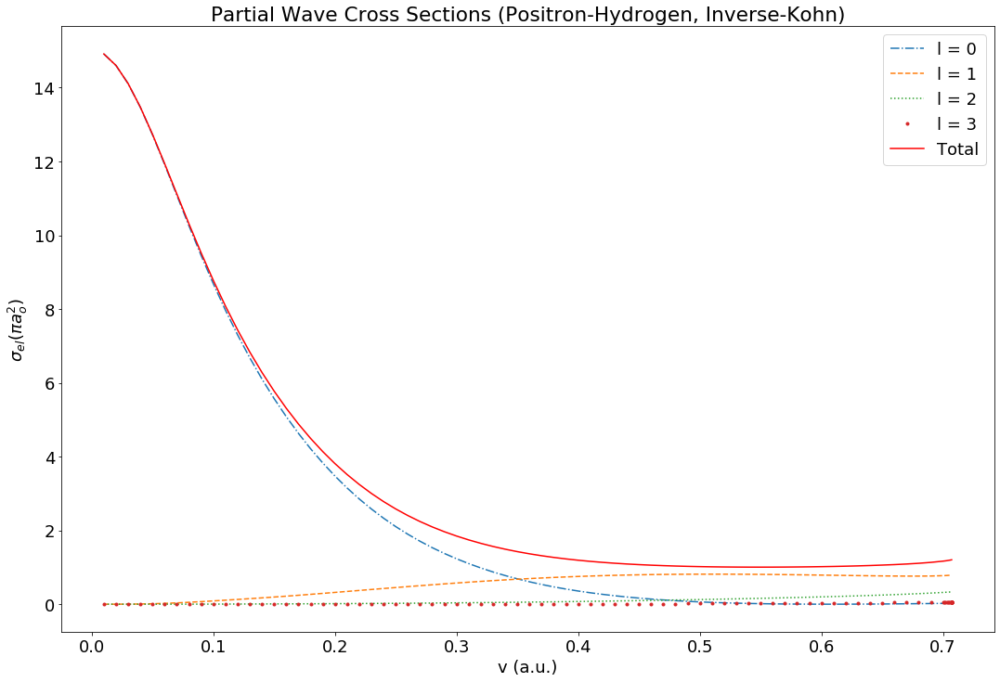

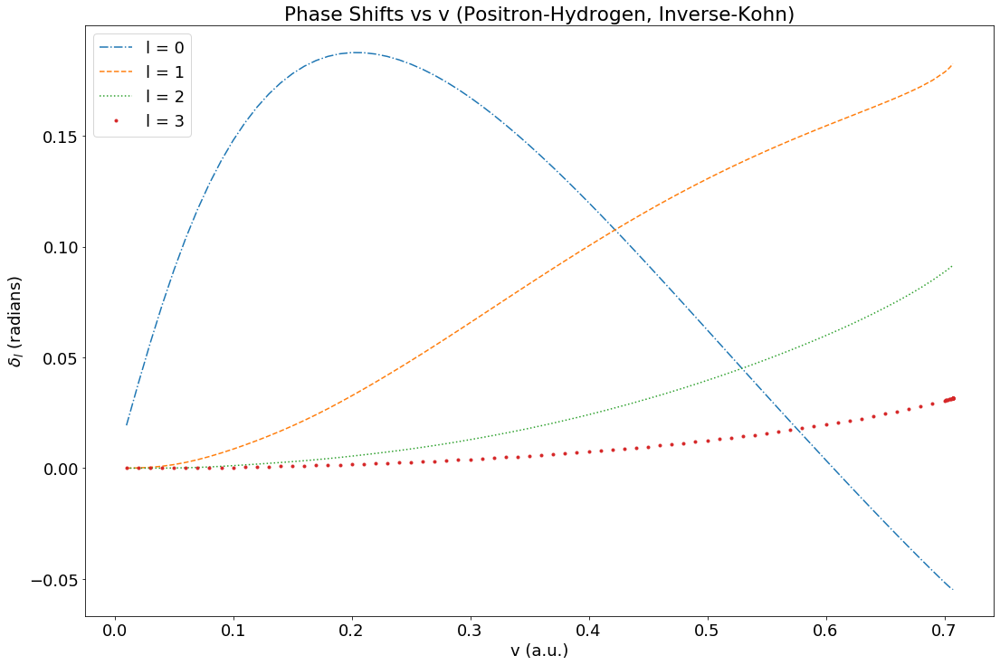

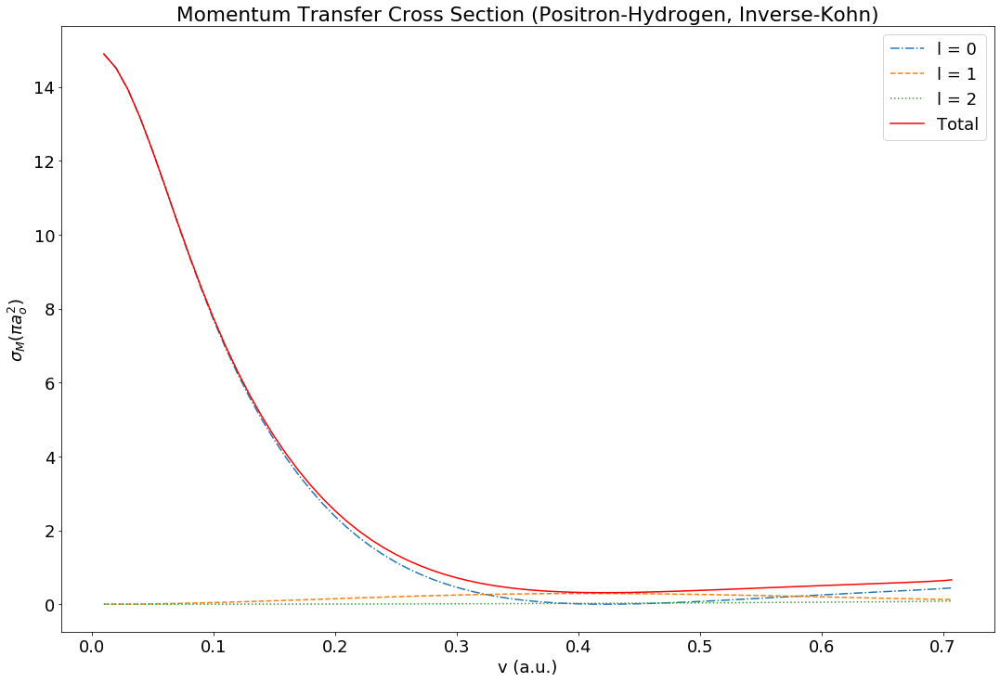

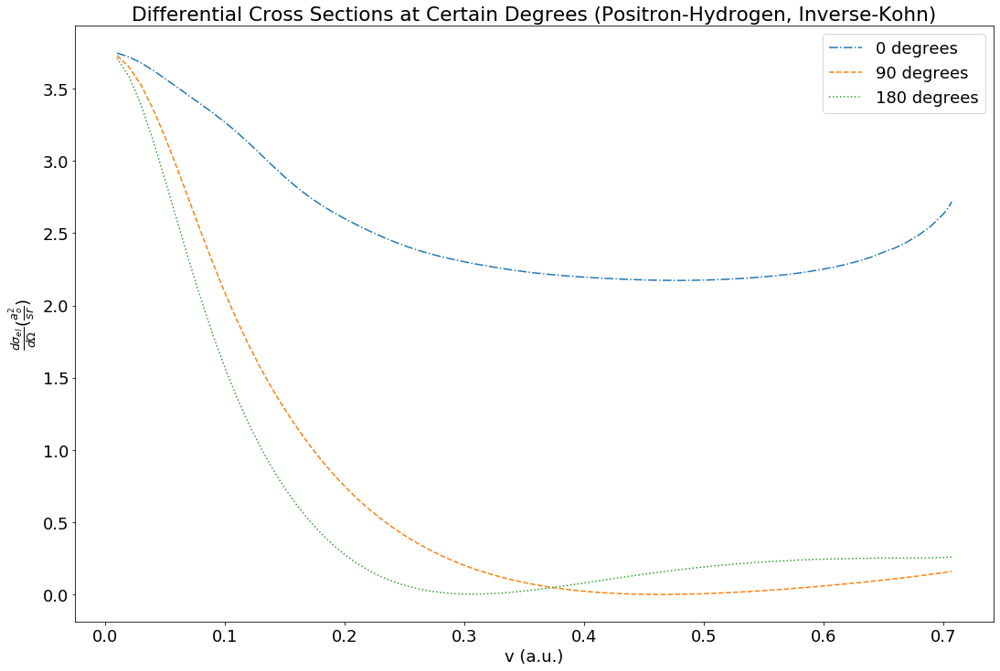

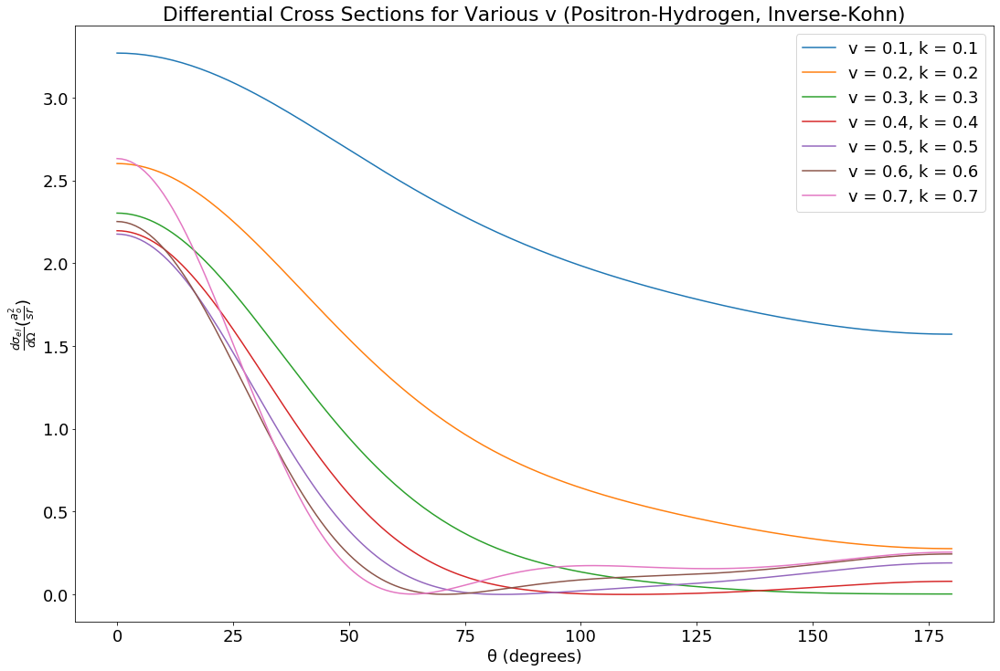

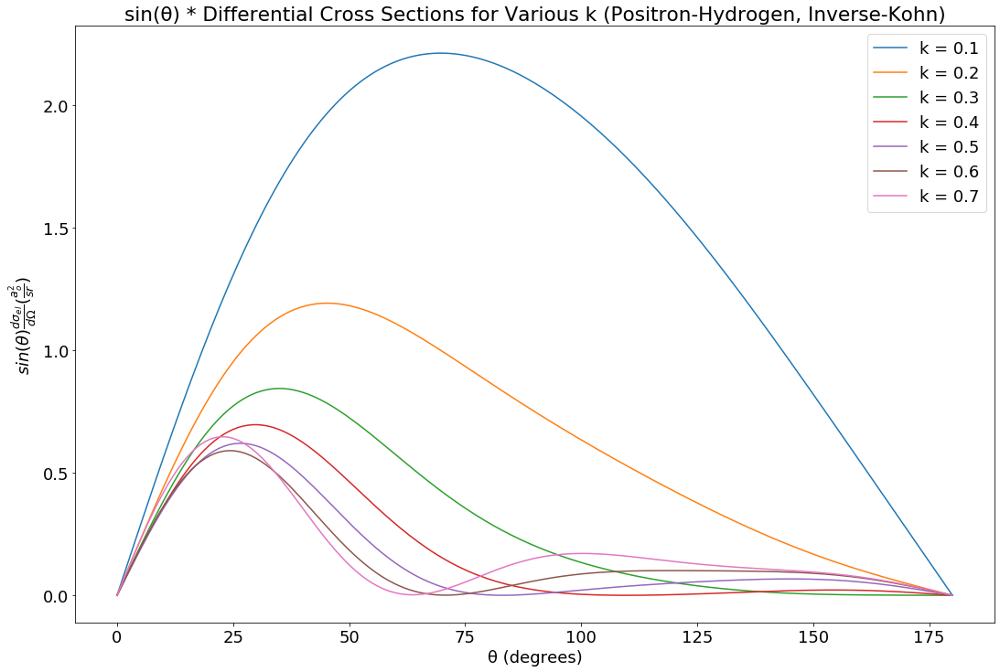

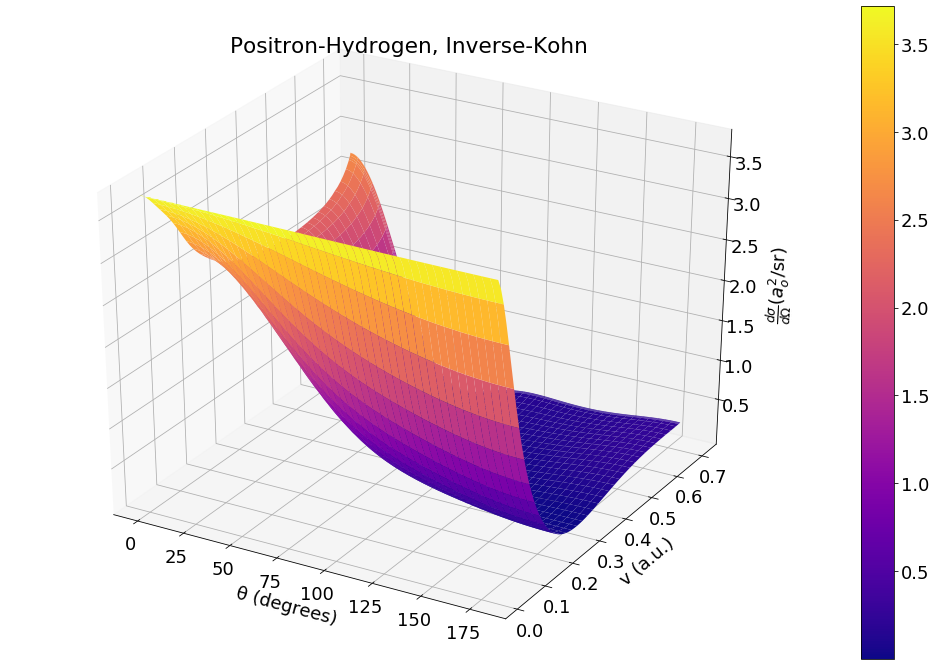

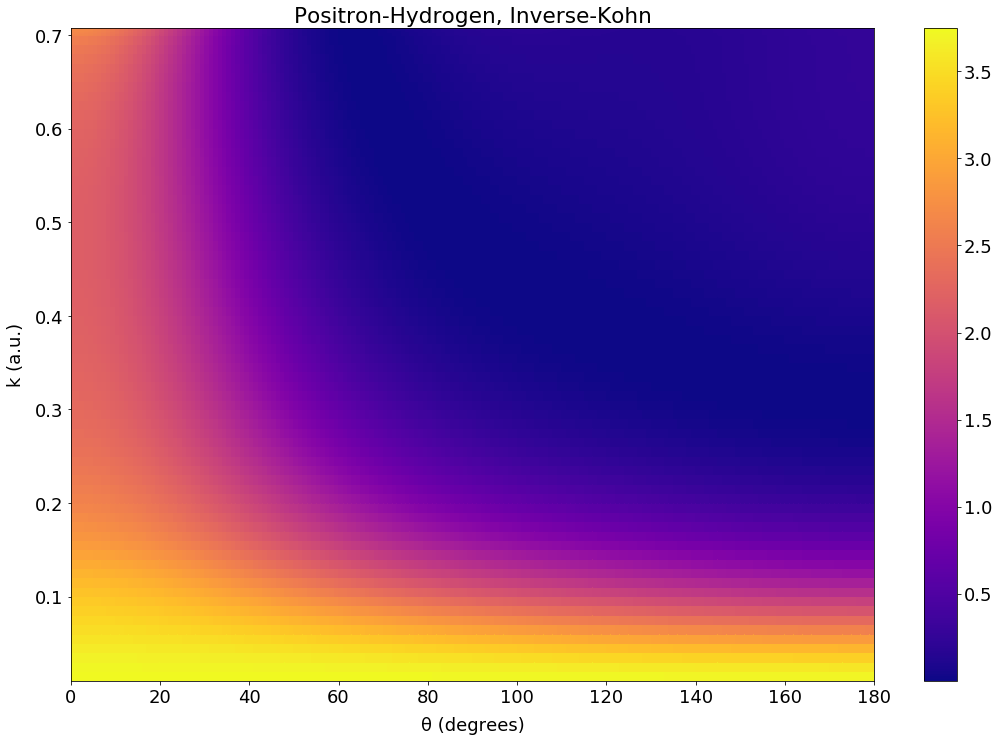

In [12]:
positron_hyd_vr_inv_lower_system.plot_cross_section(velocity=True)
positron_hyd_vr_inv_lower_system.plot_phase_shifts(velocity=True)
positron_hyd_vr_inv_lower_system.plot_momentum_transfer(velocity=True)
positron_hyd_vr_inv_lower_system.plot_diff_cross_vs_k(r_interval,velocity=True)
positron_hyd_vr_inv_lower_system.diff_plot(interval='hydrogen',velocity=True)
positron_hyd_vr_inv_lower_system.diff_plot(sin=True,interval='hydrogen')
positron_hyd_vr_inv_lower_system.diff_plot_3d(velocity=True)
positron_hyd_vr_inv_lower_system.diff_plot_3d(density=True)

### Kohn Phase Shifts for Waves l < 4

Kohn phase shifts [12] for s, p, d, and f waves are used here. A singularity is present around v = 0.7, which makes the inverse-kohn phase shifts preferable. 

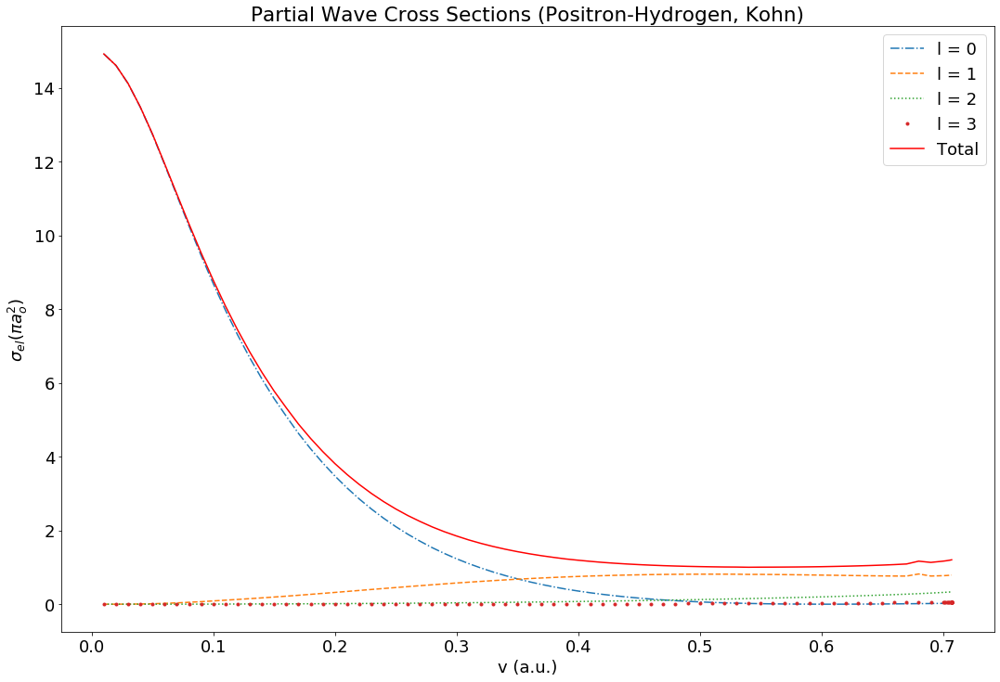

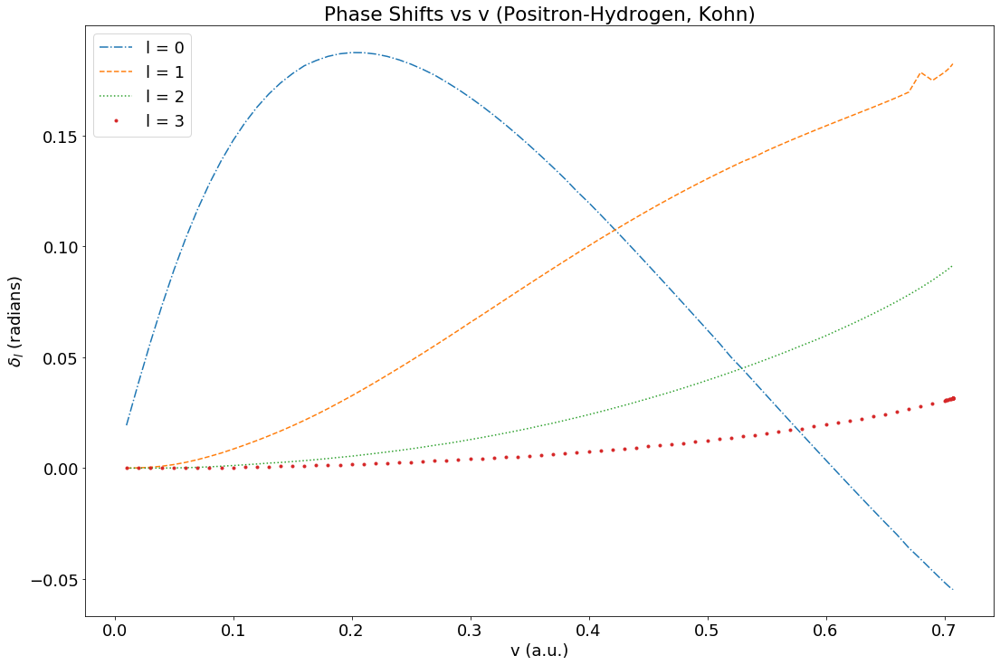

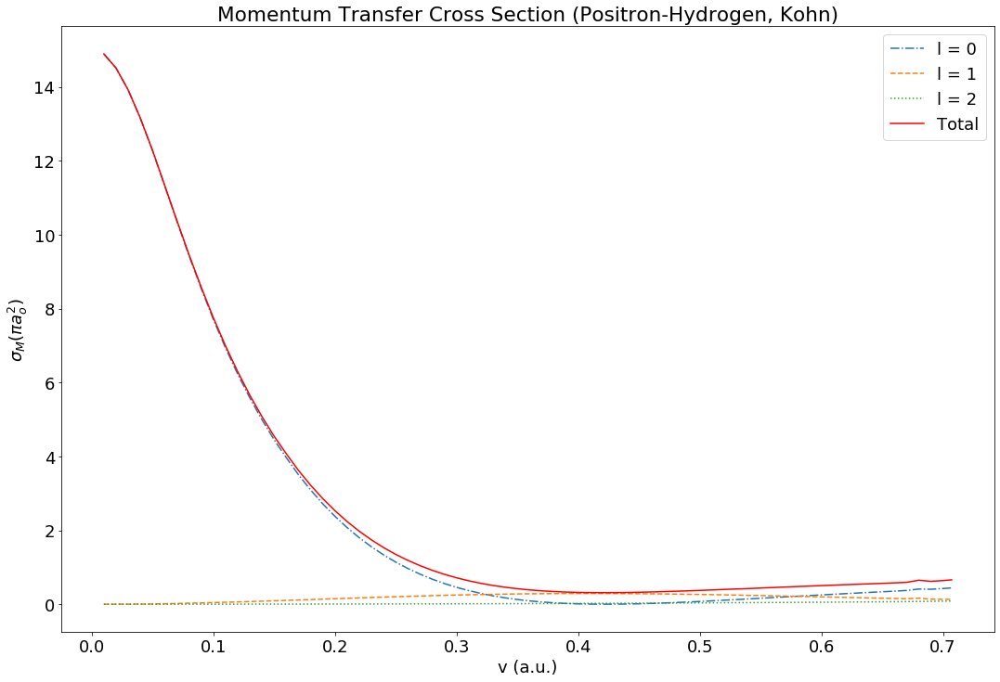

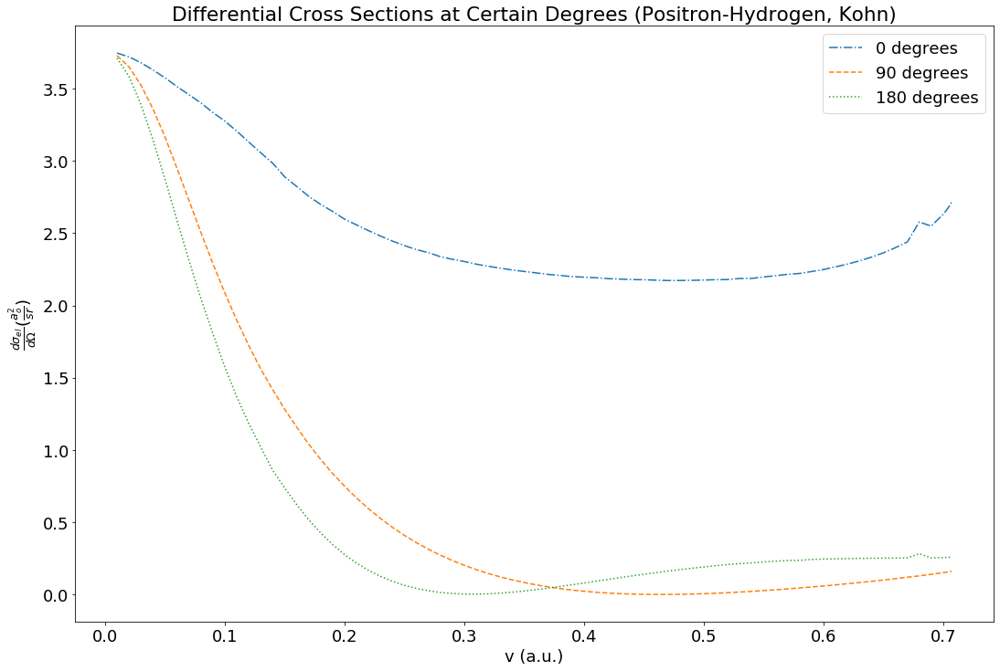

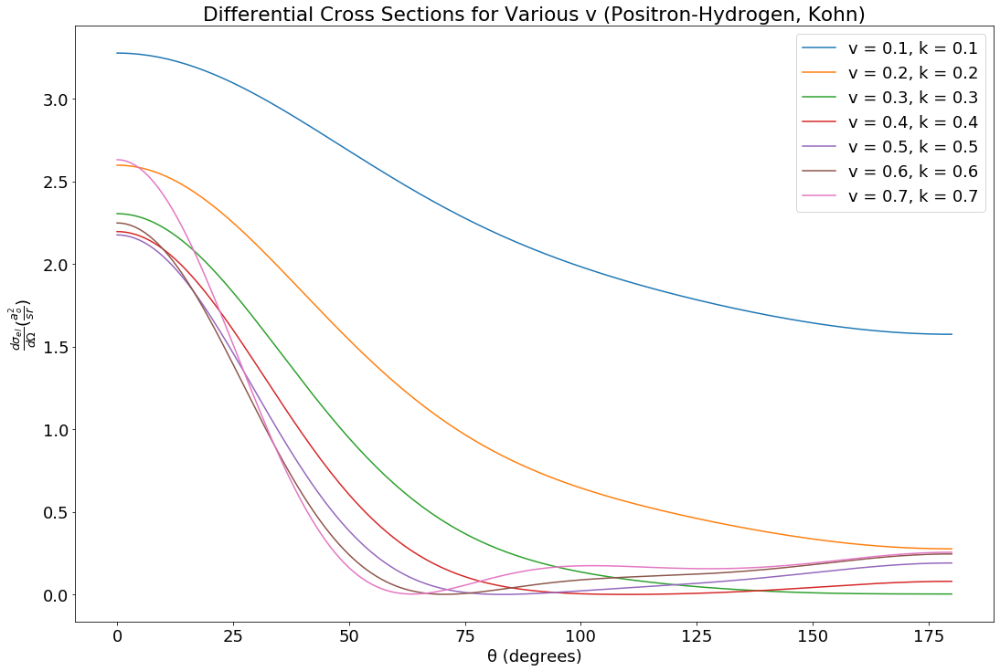

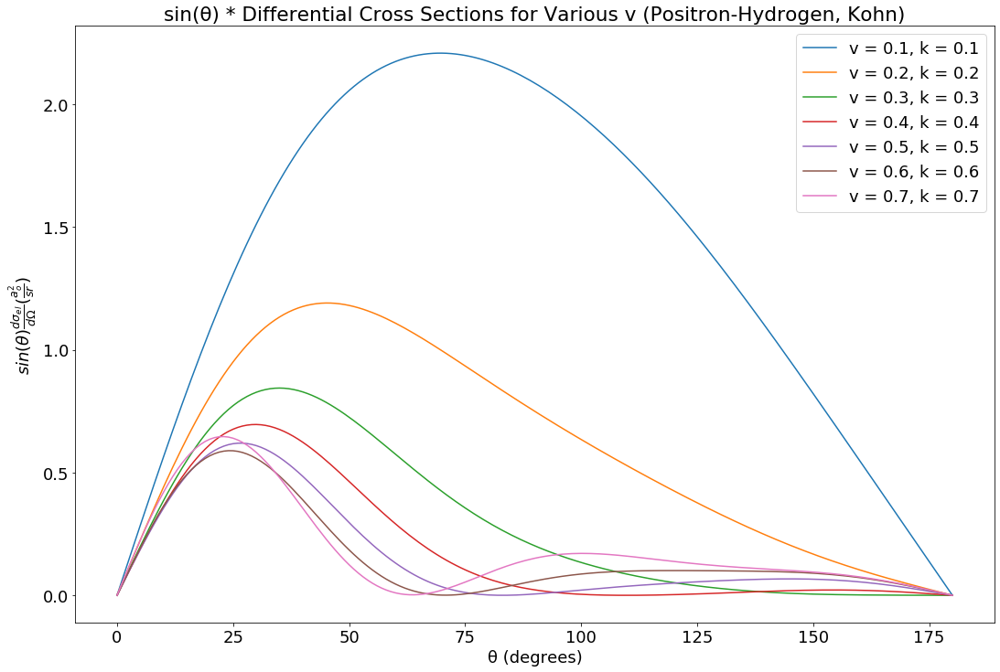

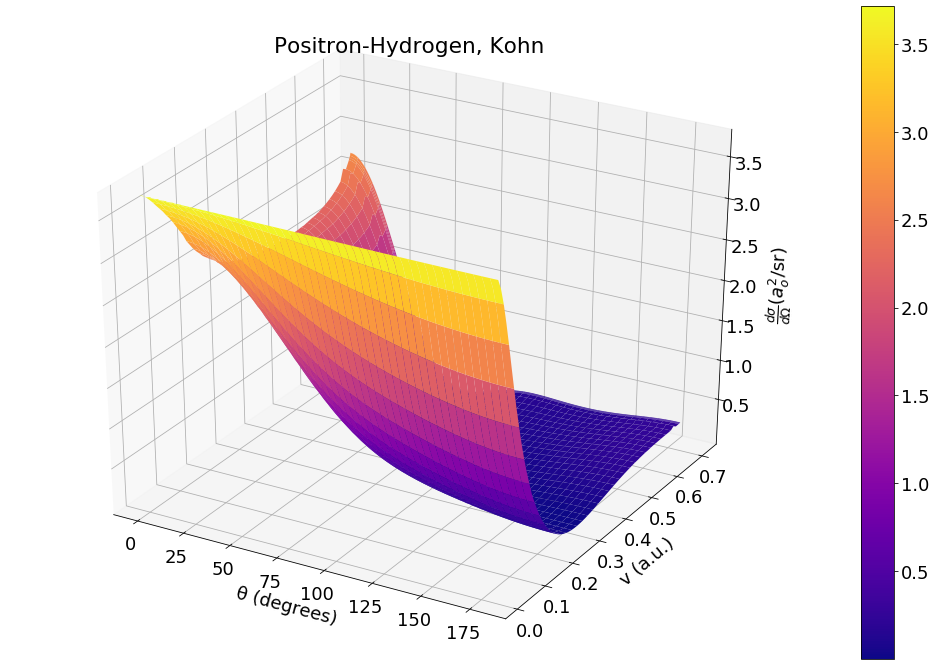

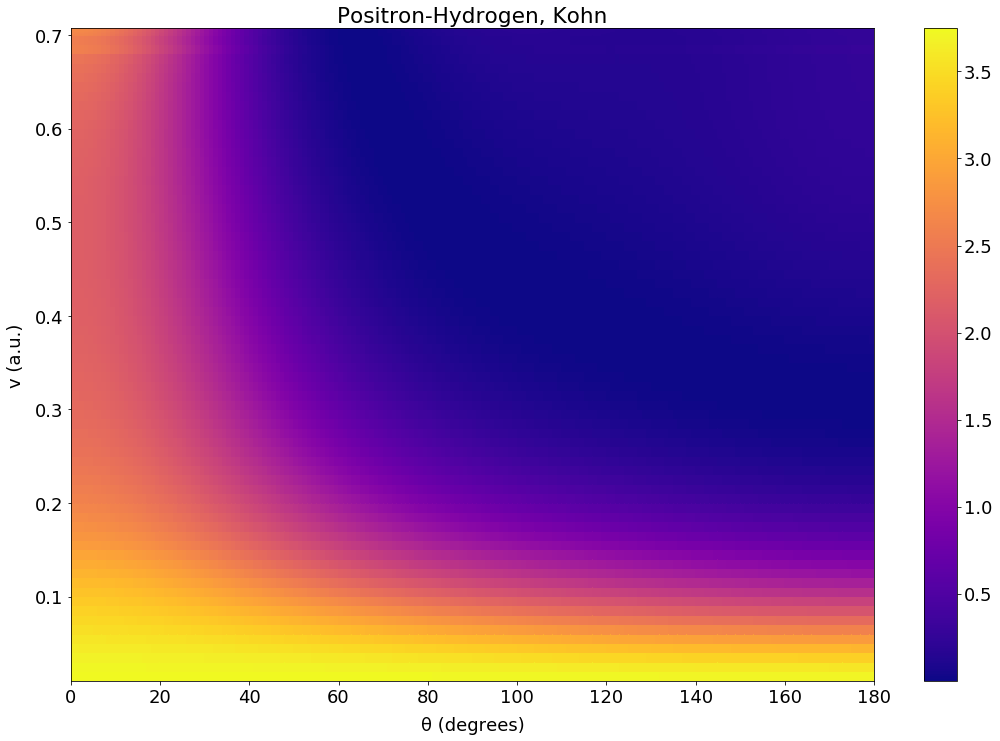

In [13]:
#  Positron-Hydrogen using kohn phase shifts for l<4 from P Van Reeth Private Communication 2020

positron_hyd_vr_kohn_lower_system = collision(positron_hyd_vr_kohn_lower,k_list_positron_hyd_vr, 'Positron-Hydrogen, Kohn',1)

positron_hyd_vr_kohn_lower_system.plot_cross_section(velocity=True)
positron_hyd_vr_kohn_lower_system.plot_phase_shifts(velocity=True)
positron_hyd_vr_kohn_lower_system.plot_momentum_transfer(velocity=True)
positron_hyd_vr_kohn_lower_system.plot_diff_cross_vs_k(r_interval,velocity=True)
positron_hyd_vr_kohn_lower_system.diff_plot(interval='hydrogen',velocity=True)
positron_hyd_vr_kohn_lower_system.diff_plot(sin=True,interval='hydrogen',velocity=True)
positron_hyd_vr_kohn_lower_system.diff_plot_3d(velocity=True)
positron_hyd_vr_kohn_lower_system.diff_plot_3d(density=True, velocity=True)

### Inverse-Kohn Phase Shifts for Waves l < 10

Inverse-Kohn phase shifts [12] for l < 10 are used here. There are two noticeable singularities around v = 0.4, 0.65. 

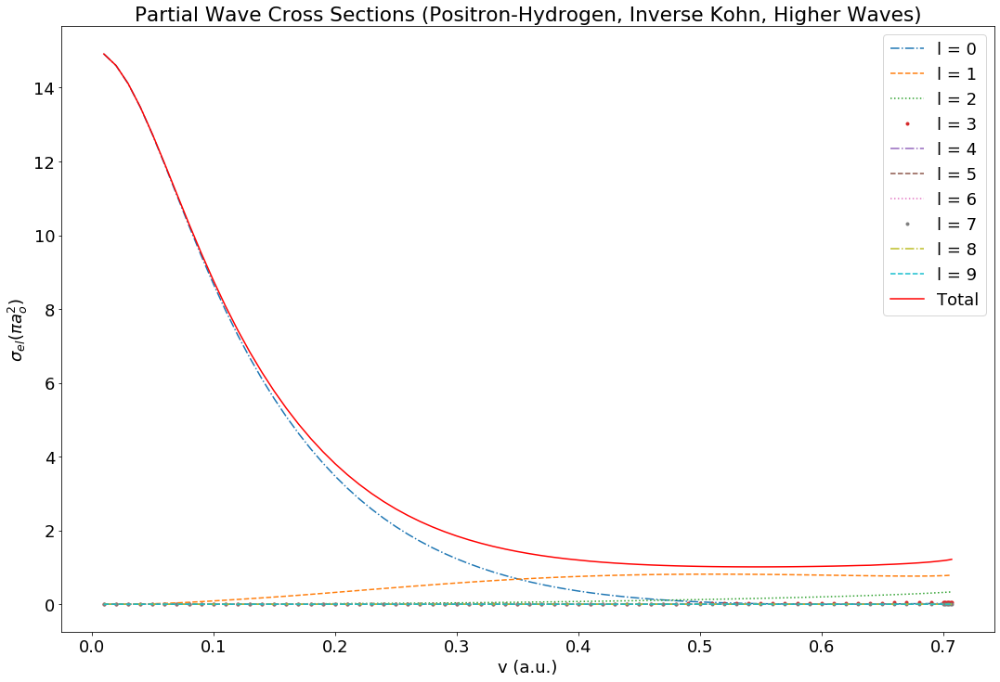

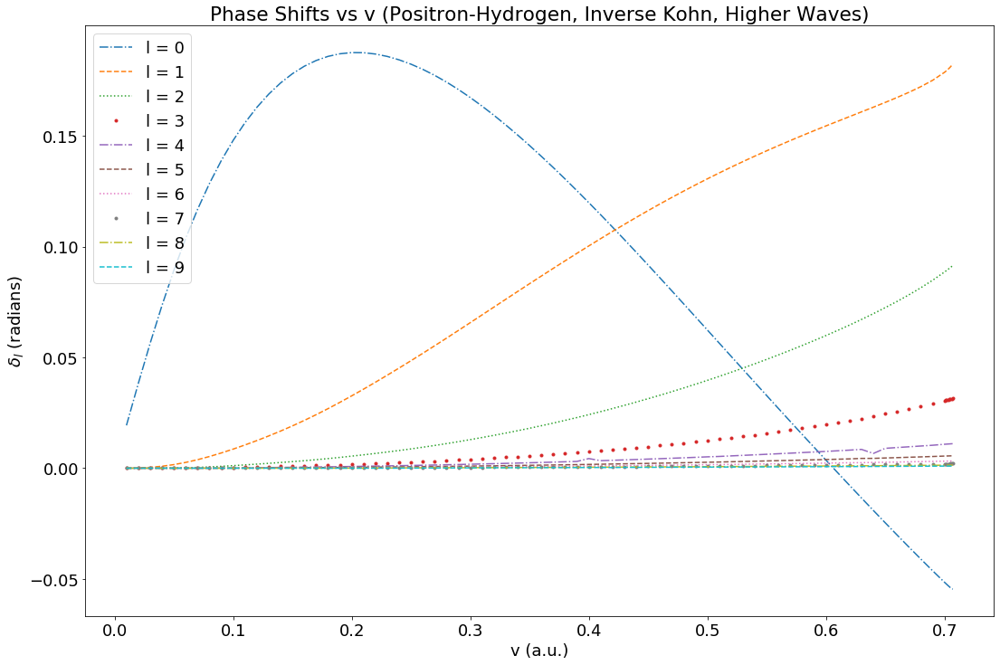

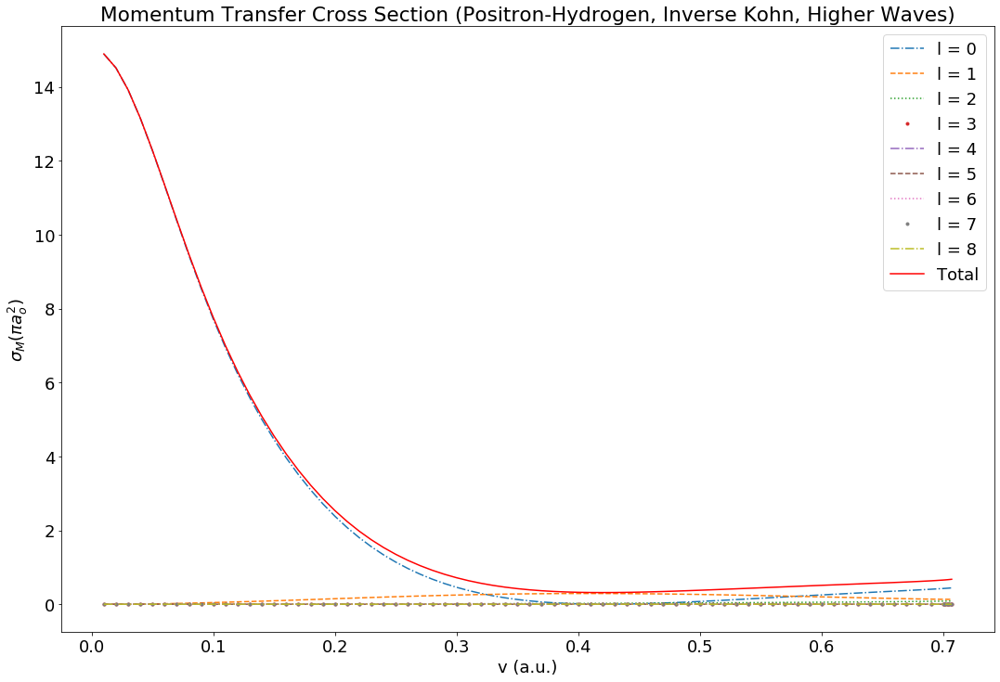

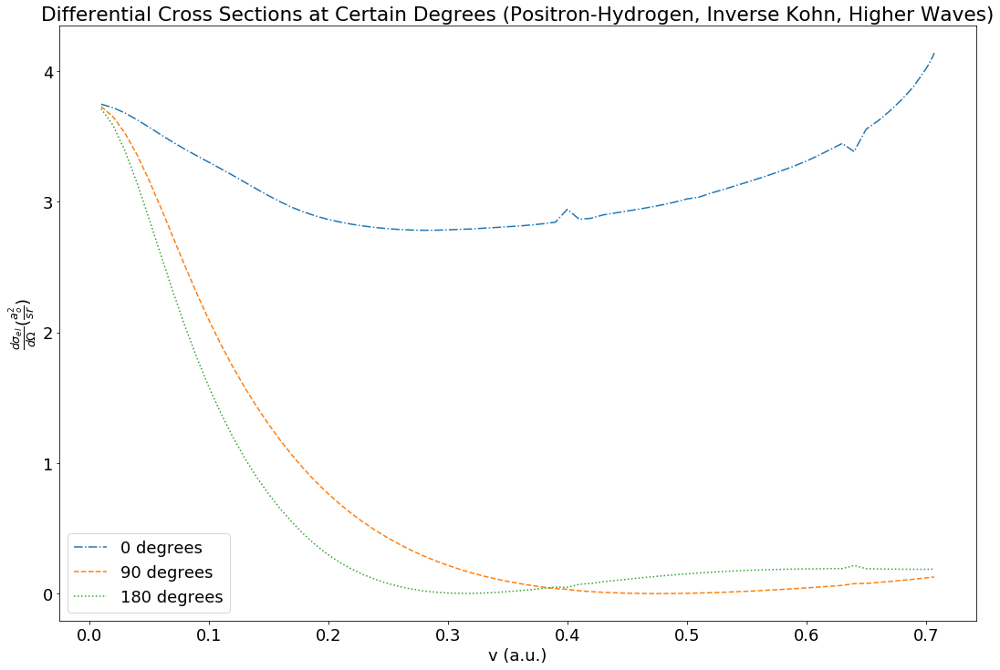

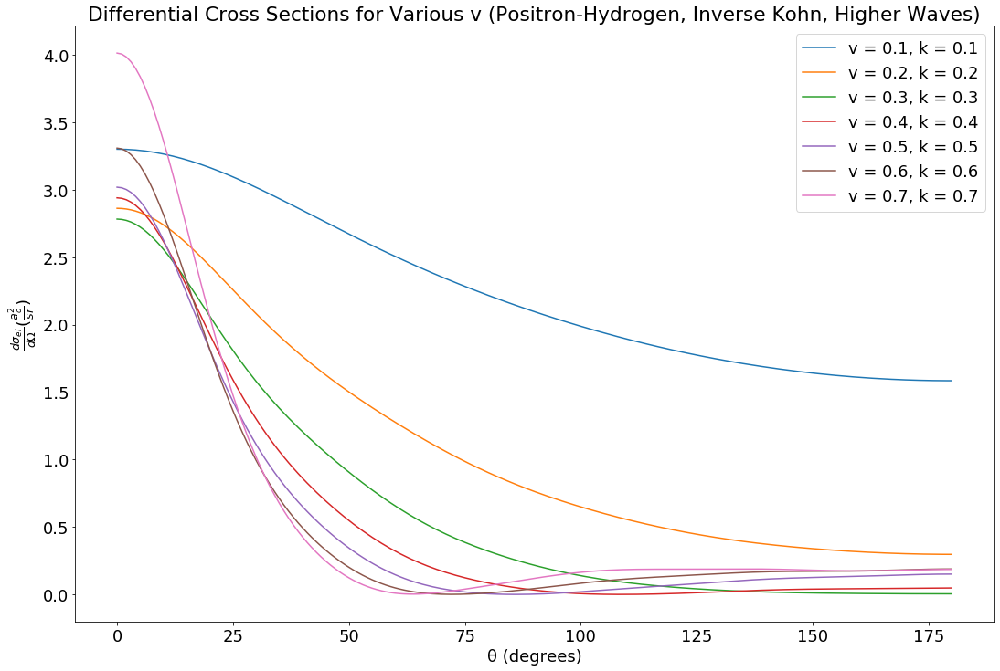

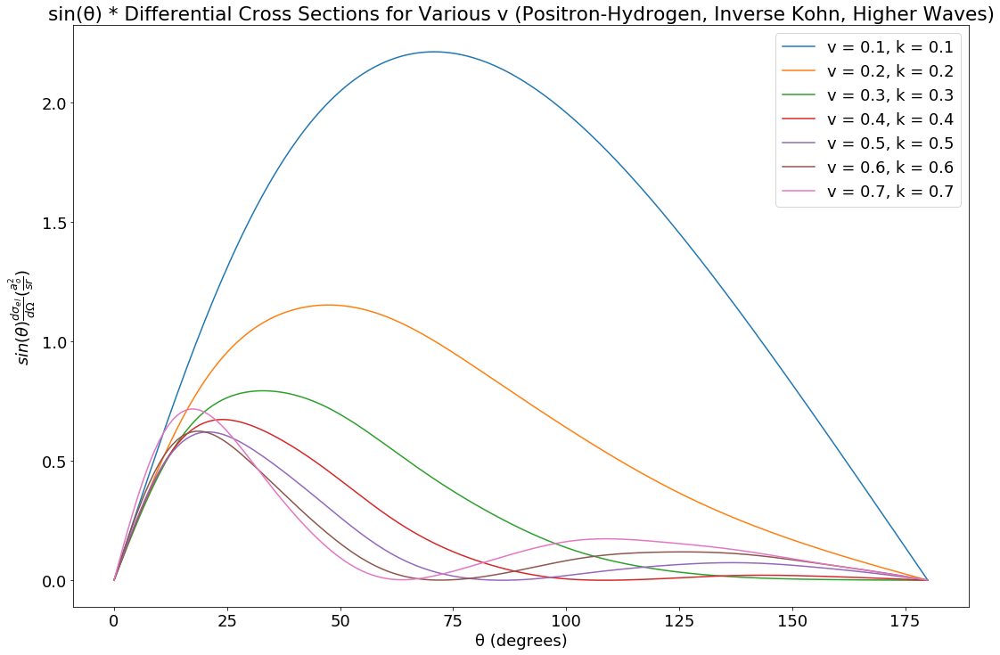

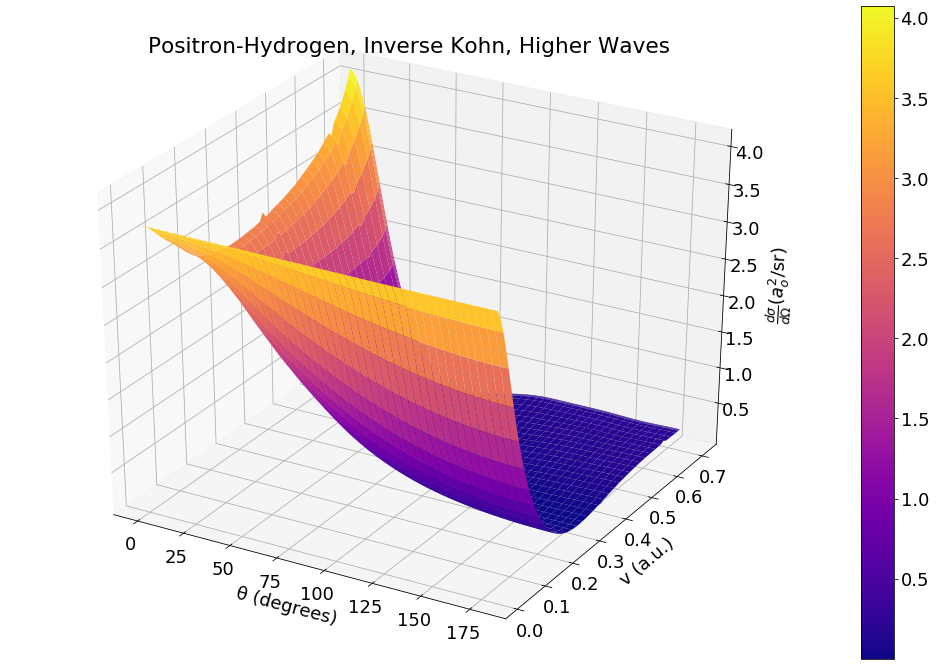

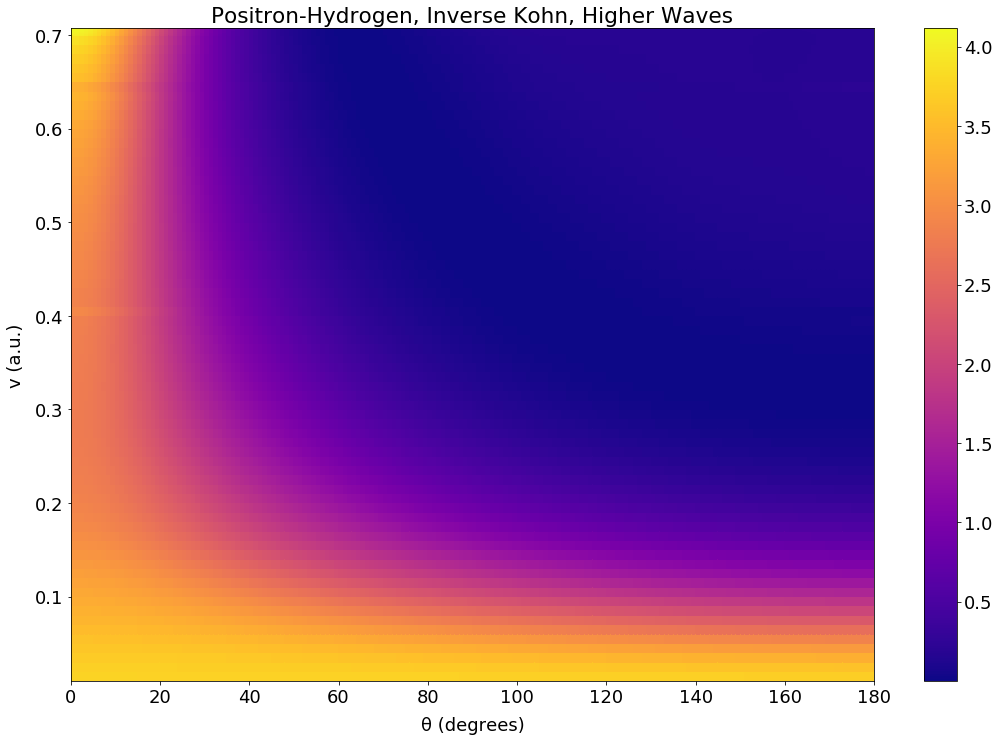

In [14]:
#  Positron-Hydrogen using inverse-kohn phase shifts for l<10 from P Van Reeth Private Communication 2020

positron_hyd_vr_kohn_inv_all_system = collision(positron_hyd_vr_inv_all,k_vr_higher,'Positron-Hydrogen, Inverse Kohn, Higher Waves',1)

positron_hyd_vr_kohn_inv_all_system.plot_cross_section(velocity=True)
positron_hyd_vr_kohn_inv_all_system.plot_phase_shifts(velocity=True)
positron_hyd_vr_kohn_inv_all_system.plot_momentum_transfer(velocity=True)
positron_hyd_vr_kohn_inv_all_system.plot_diff_cross_vs_k(r_interval,velocity=True)
positron_hyd_vr_kohn_inv_all_system.diff_plot(interval='hydrogen',velocity=True)
positron_hyd_vr_kohn_inv_all_system.diff_plot(sin=True,interval='hydrogen',velocity=True)
positron_hyd_vr_kohn_inv_all_system.diff_plot_3d(velocity=True)
positron_hyd_vr_kohn_inv_all_system.diff_plot_3d(density=True,velocity=True)

### Kohn Phase Shifts l < 10

Kohn phase shifts for l < 10 [12] are used here. Several singularities are visible here, especially around v = 0.7.

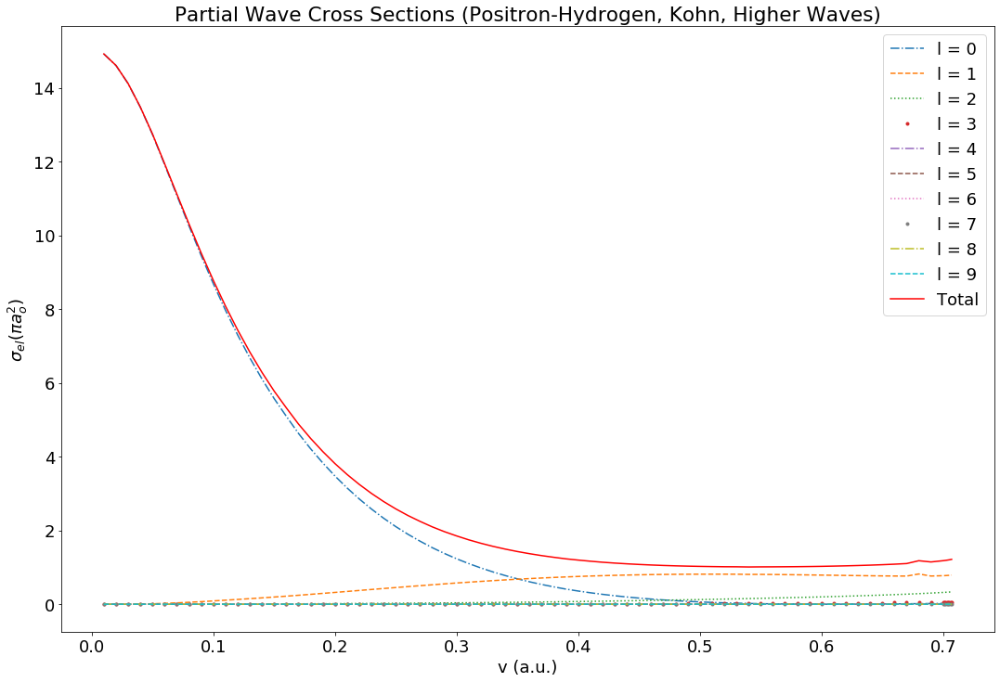

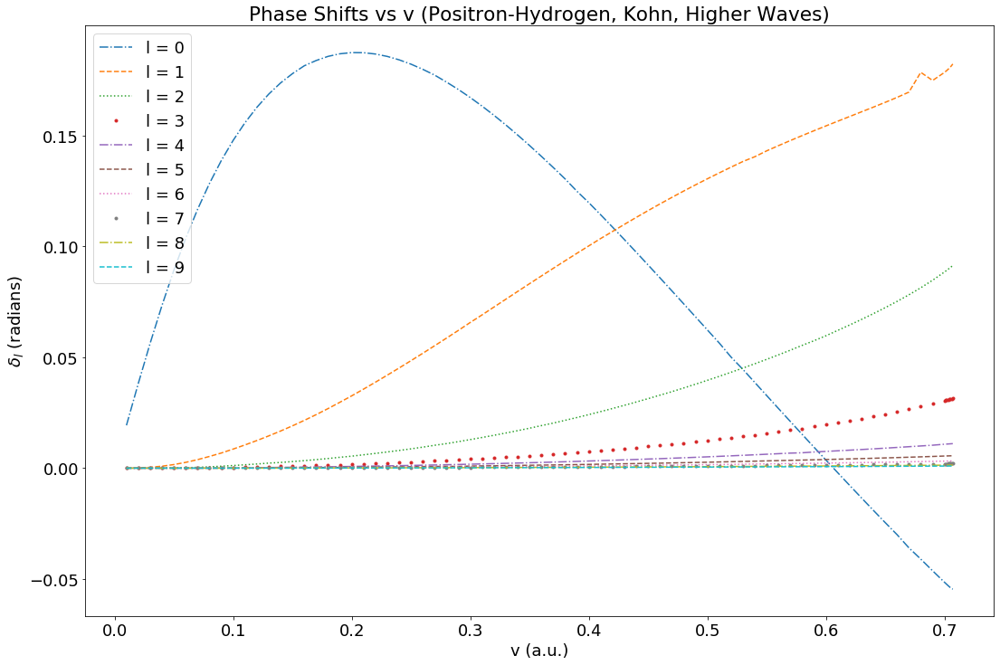

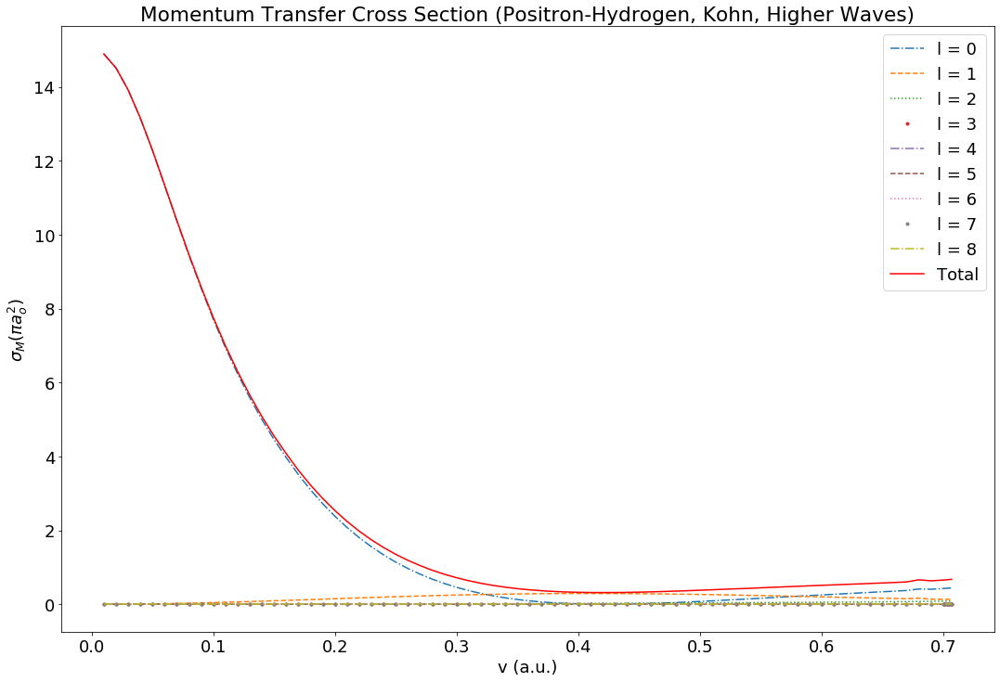

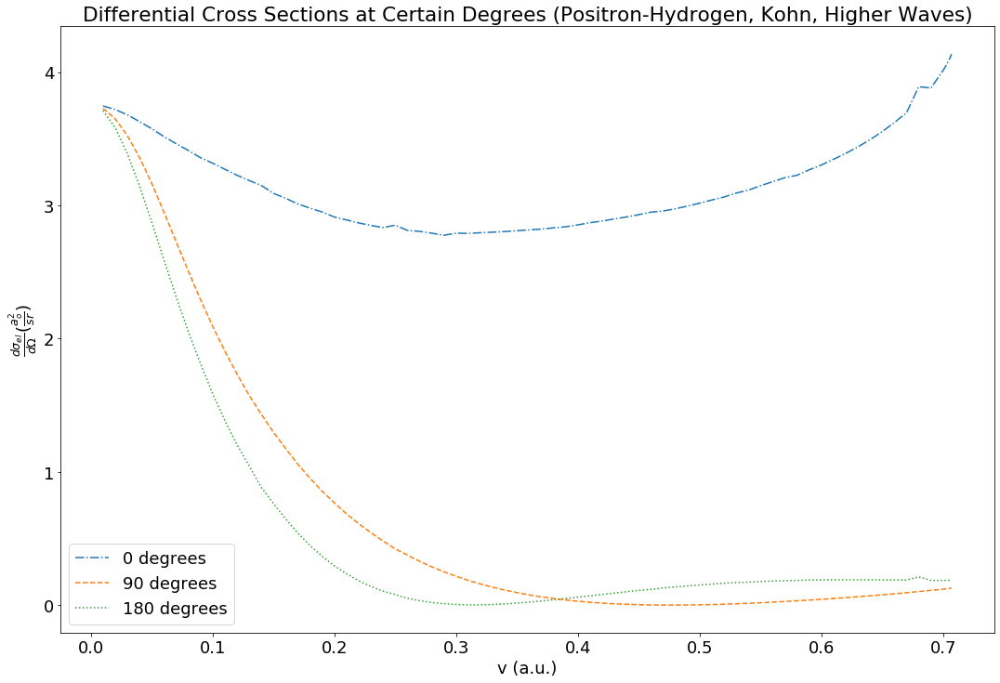

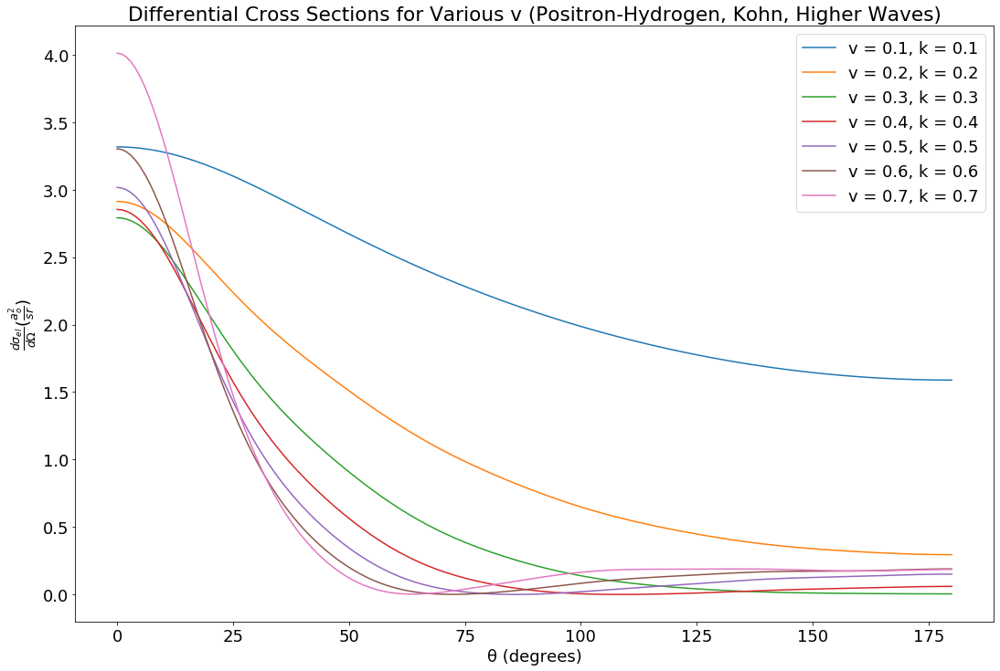

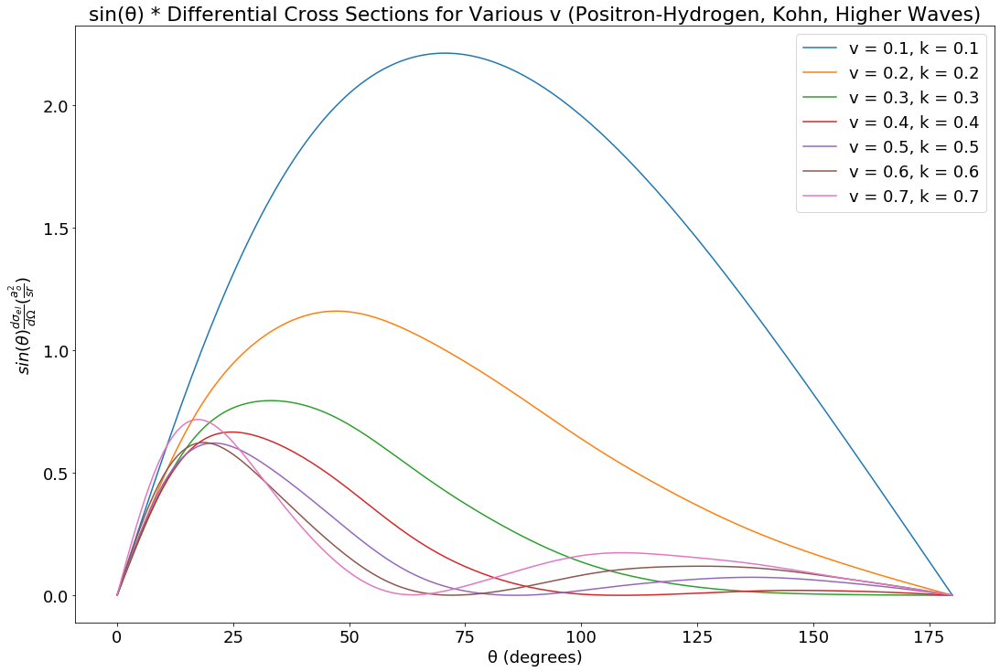

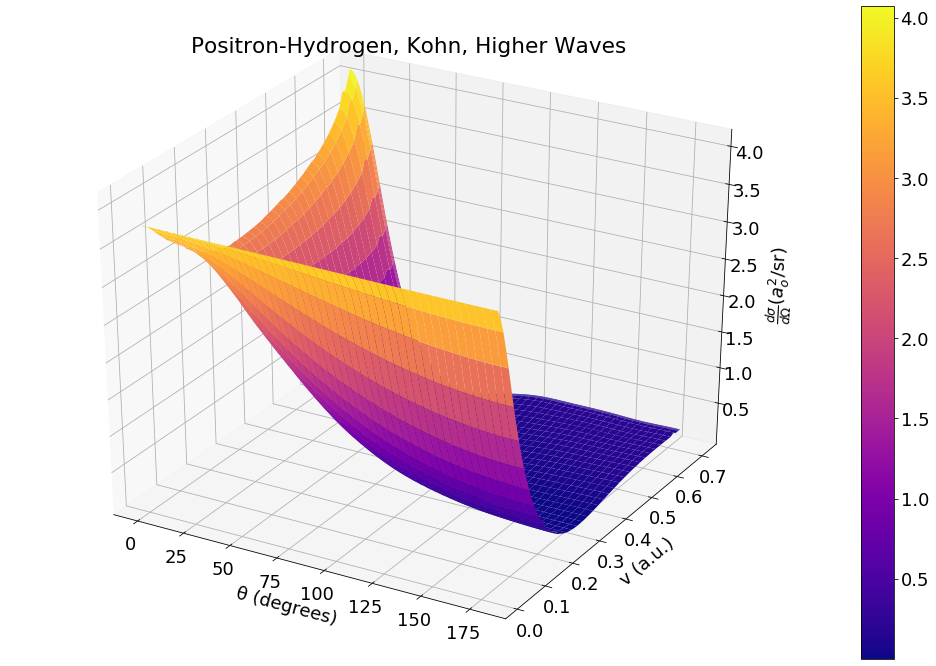

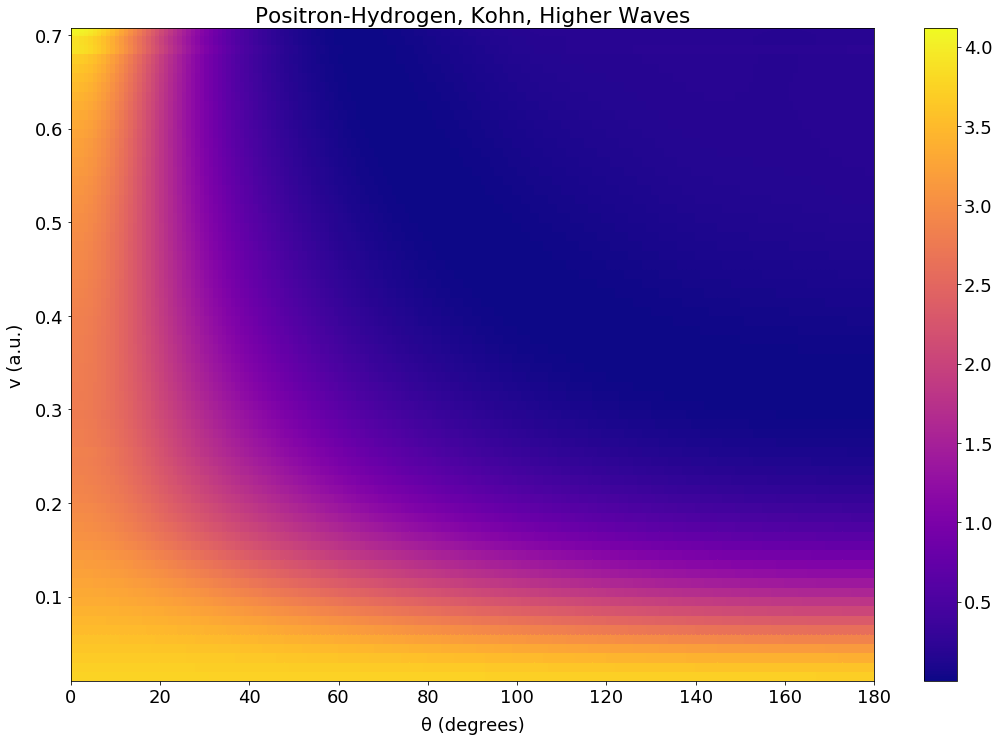

In [15]:
#  Positron-Hydrogen using kohn phase shifts for l<10 from P Van Reeth Private Communication 2020

positron_hyd_vr_kohn_all_system = collision(positron_hyd_vr_kohn_all,k_vr_higher,'Positron-Hydrogen, Kohn, Higher Waves',1)

positron_hyd_vr_kohn_all_system.plot_cross_section(velocity=True)
positron_hyd_vr_kohn_all_system.plot_phase_shifts(velocity=True)
positron_hyd_vr_kohn_all_system.plot_momentum_transfer(velocity=True)
positron_hyd_vr_kohn_all_system.plot_diff_cross_vs_k(r_interval,velocity=True)
positron_hyd_vr_kohn_all_system.diff_plot(interval='hydrogen',velocity=True)
positron_hyd_vr_kohn_all_system.diff_plot(sin=True,interval='hydrogen',velocity=True)
positron_hyd_vr_kohn_all_system.diff_plot_3d(velocity=True)
positron_hyd_vr_kohn_all_system.diff_plot_3d(density=True,velocity=True)

### Mixture of Inverse-Kohn and Kohn Phase Shifts for Waves l < 10

Here a mixture of kohn and inverse-kohn phase shifts [12] are used in an attempt to reduce singularities. These graphs are the most comprehensive and stable for the positron-hydrogen system.

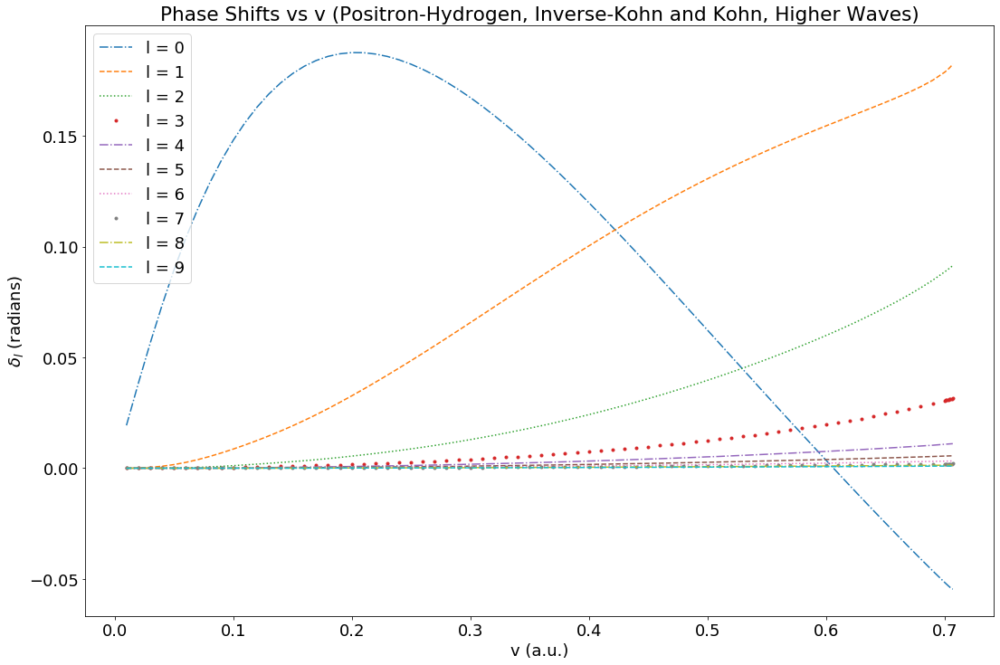

In [16]:
#  Positron-Hydrogen mixture of inverse-kohn and kohn phase shifts for l<10 from P Van Reeth Private Communication 2020
positron_hyd_vr_hybrid_all_system = collision(positron_hyd_vr_hybrid,k_vr_higher,'Positron-Hydrogen, Inverse-Kohn and Kohn, Higher Waves',1)

positron_hyd_vr_hybrid_all_system.plot_phase_shifts(velocity=True)

,v,total cross section,l = 0 contribution,l = 1 contribution,l = 2 contribution,l = 3 contribution,l = 4 contribution,l = 5 contribution,l = 6 contribution,l = 7 contribution,l = 8 contribution,l = 9 contribution
0,0.010,14.914,99.9998%,0.0002%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%
5,0.060,11.940,99.8095%,0.1889%,0.0016%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%
10,0.110,8.081,98.6027%,1.3465%,0.0447%,0.0054%,0.0007%,0.0001%,0.0%,0.0%,0.0%,0.0%
15,0.160,5.312,95.7048%,4.0949%,0.1674%,0.024%,0.006%,0.002%,0.0007%,0.0002%,0.0001%,0.0%
20,0.210,3.516,89.5984%,9.8402%,0.4682%,0.0672%,0.0166%,0.0055%,0.0021%,0.001%,0.0005%,0.0003%
25,0.260,2.404,78.8536%,19.8308%,1.0994%,0.1537%,0.0388%,0.0134%,0.0055%,0.0029%,0.0013%,0.0007%
30,0.310,1.745,63.087%,34.1912%,2.2824%,0.314%,0.0788%,0.0267%,0.0107%,0.0051%,0.0026%,0.0014%
35,0.360,1.369,44.3477%,50.7381%,4.1383%,0.5582%,0.1351%,0.0467%,0.0193%,0.0091%,0.0047%,0.0026%
40,0.410,1.165,26.5916%,65.5208%,6.652%,0.8982%,0.2104%,0.0719%,0.0297%,0.014%,0.0072%,0.0041%
45,0.460,1.063,13.0849%,75.4975%,9.6324%,1.3117%,0.294%,0.0983%,0.0457%,0.0197%,0.0101%,0.0056%


Average value for total cross section : 3.361
Minimum value for total cross section


,v,total cross section,l = 0 contribution,l = 1 contribution,l = 2 contribution,l = 3 contribution,l = 4 contribution,l = 5 contribution,l = 6 contribution,l = 7 contribution,l = 8 contribution,l = 9 contribution
53,0.54,1.012,2.0266%,80.0959%,15.0246%,2.1511%,0.4427%,0.1473%,0.0605%,0.0284%,0.0147%,0.0082%
54,0.55,1.012,1.4037%,79.8606%,15.7325%,2.2713%,0.4623%,0.1534%,0.0629%,0.0295%,0.0153%,0.0085%


Maximum value for total cross section


,v,total cross section,l = 0 contribution,l = 1 contribution,l = 2 contribution,l = 3 contribution,l = 4 contribution,l = 5 contribution,l = 6 contribution,l = 7 contribution,l = 8 contribution,l = 9 contribution
0,0.01,14.914,99.9998%,0.0002%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%


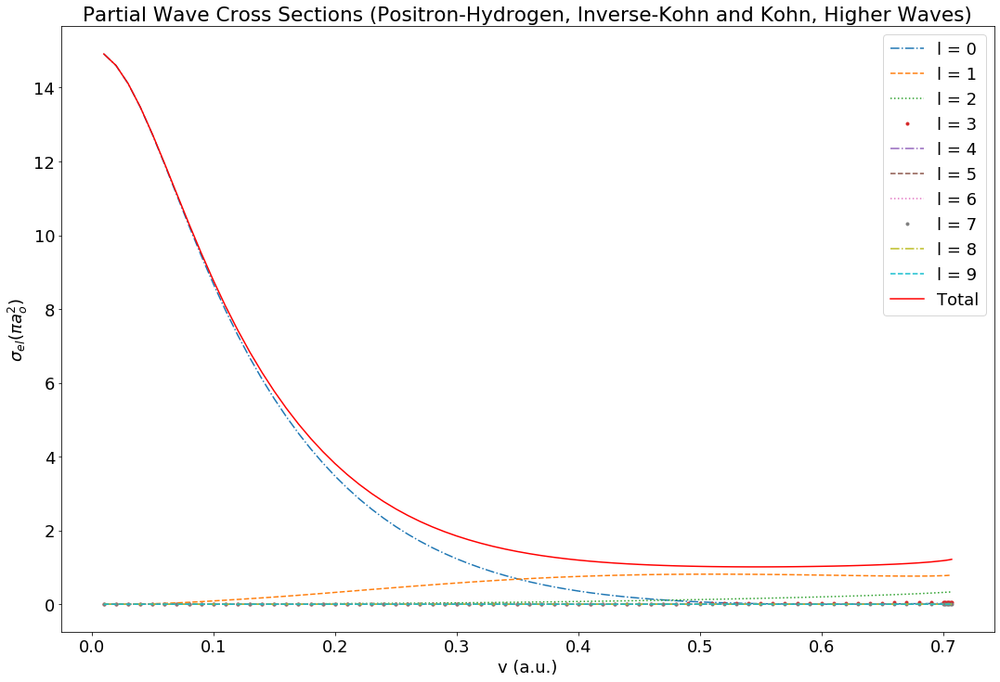

In [17]:
pos_hyd_cross_data = pos_hyd_vr_hybrid_all_system.plot_cross_section(data=True)
sliced_pos_hyd = pos_hyd_cross_data[pos_hyd_cross_data.index % 5 == 0]
display(sliced_pos_hyd)
get_avg(pos_hyd_cross_data, 'total cross section')
data_min(pos_hyd_cross_data, 'total cross section')
data_max(pos_hyd_cross_data, 'total cross section')
positron_hyd_vr_hybrid_all_system.plot_cross_section(velocity=True)

The elastic cross section quickly decreases before leveling out around 1. Waves beyond the f wave do not have significant contribution to the elastic cross section; at no point do any of these higher waves contribute even 1% to the total cross section. As the velocity increases, the contribution from the s wave gradually decreases, while the contribution from all other waves increases. At the highest velocity, the contribution from the s, p, d, and f wave are 2, 65, 27, 5 percent, respectively. 

,v,total momentum transfer,l = 0 contribution,l = 1 contribution,l = 2 contribution,l = 3 contribution,l = 4 contribution,l = 5 contribution,l = 6 contribution,l = 7 contribution,l = 8 contribution
0,0.010,14.891,99.9999%,0.0001%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%
5,0.060,11.343,99.8849%,0.1144%,0.0008%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%
10,0.110,6.995,99.2176%,0.765%,0.0155%,0.0017%,0.0002%,0.0%,0.0%,0.0%,0.0%
15,0.160,4.063,97.3936%,2.5386%,0.0608%,0.0056%,0.001%,0.0003%,0.0001%,0.0%,0.0%
20,0.210,2.239,92.6545%,7.118%,0.2039%,0.019%,0.0034%,0.0008%,0.0003%,0.0001%,0.0%
25,0.260,1.187,81.3928%,17.9136%,0.6252%,0.0552%,0.0096%,0.0025%,0.0007%,0.0004%,0.0001%
30,0.310,0.635,57.9394%,40.0969%,1.7731%,0.1536%,0.0269%,0.007%,0.002%,0.0008%,0.0003%
35,0.360,0.389,23.1038%,72.3012%,4.1552%,0.3596%,0.0579%,0.0149%,0.0048%,0.0018%,0.0008%
40,0.410,0.317,0.8697%,91.3983%,6.9804%,0.6203%,0.0955%,0.0241%,0.0077%,0.0029%,0.0012%
45,0.460,0.334,6.2883%,84.0419%,8.7026%,0.8086%,0.1181%,0.0237%,0.0119%,0.0035%,0.0015%


Average value for total momentum transfer : 2.563
Maximum value for total momentum transfer


,v,total momentum transfer,l = 0 contribution,l = 1 contribution,l = 2 contribution,l = 3 contribution,l = 4 contribution,l = 5 contribution,l = 6 contribution,l = 7 contribution,l = 8 contribution
0,0.01,14.891,99.9999%,0.0001%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%


Minimum value for total momentum transfer


,v,total momentum transfer,l = 0 contribution,l = 1 contribution,l = 2 contribution,l = 3 contribution,l = 4 contribution,l = 5 contribution,l = 6 contribution,l = 7 contribution,l = 8 contribution
41,0.42,0.315,0.0274%,91.7349%,7.4337%,0.6649%,0.1012%,0.0254%,0.0082%,0.0031%,0.0013%


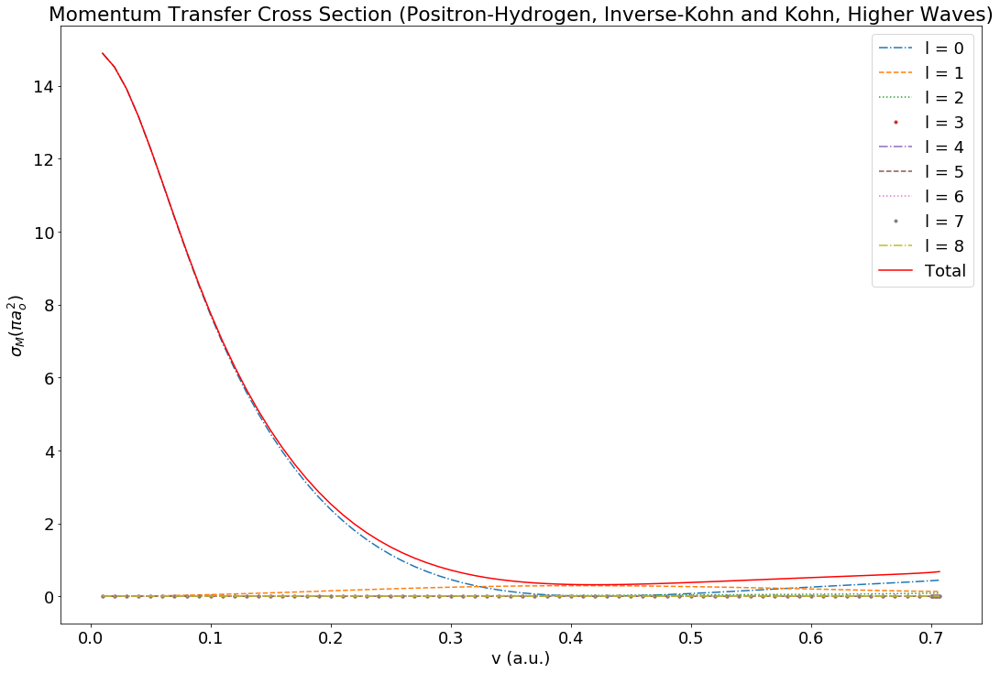

In [18]:
pos_hyd_momentum_data = pos_hyd_vr_hybrid_all_system.plot_momentum_transfer(data=True)
sliced = pos_hyd_momentum_data[pos_hyd_momentum_data.index % 5 == 0]
display(sliced)
get_avg(pos_hyd_momentum_data, 'total momentum transfer')
data_max(pos_hyd_momentum_data, 'total momentum transfer')
data_min(pos_hyd_momentum_data, 'total momentum transfer')

positron_hyd_vr_hybrid_all_system.plot_momentum_transfer(velocity=True)

The elastic cross section is greater than the momentum transfer cross section throughout. The difference between the two increases until mid-range velocities, where it then begins to shrink. The s wave maintains a majority contribution to the momentum transfer cross section except at mid-range velocity. At the highest velocity, the contribution from the s, p, d, and f wave are 65, 20, 13, 2 percent, respectively.

In [19]:
pos_hyd_cross_momentum = cross_momentum_compare(pos_hyd_cross_data, pos_hyd_momentum_data)

sliced = pos_hyd_cross_momentum[pos_hyd_cross_momentum.index % 5 == 0]
display(sliced)
get_avg(pos_hyd_cross_momentum, 'ratio momentum/cross')
data_max(pos_hyd_cross_momentum, 'ratio momentum/cross')
data_min(pos_hyd_cross_momentum, 'ratio momentum/cross')

,v,total cross section,total momentum transfer,ratio momentum/cross
0,0.010,14.914,14.891,0.998
5,0.060,11.940,11.343,0.950
10,0.110,8.081,6.995,0.866
15,0.160,5.312,4.063,0.765
20,0.210,3.516,2.239,0.637
25,0.260,2.404,1.187,0.494
30,0.310,1.745,0.635,0.364
35,0.360,1.369,0.389,0.284
40,0.410,1.165,0.317,0.272
45,0.460,1.063,0.334,0.314


Average value for ratio momentum/cross : 0.547
Maximum value for ratio momentum/cross


,v,total cross section,total momentum transfer,ratio momentum/cross
0,0.01,14.914,14.891,0.998


Minimum value for ratio momentum/cross


,v,total cross section,total momentum transfer,ratio momentum/cross
38,0.39,1.231,0.331,0.269
39,0.40,1.196,0.322,0.269


,v,0 degrees,90 degrees,180 degrees
0,0.010,3.746,3.729,3.711
5,0.060,3.512,2.953,2.591
10,0.110,3.263,1.910,1.384
15,0.160,3.048,1.173,0.645
20,0.210,2.891,0.685,0.235
25,0.260,2.811,0.375,0.051
30,0.310,2.791,0.186,0.002
35,0.360,2.815,0.077,0.022
40,0.410,2.869,0.021,0.070
45,0.460,2.950,0.001,0.118


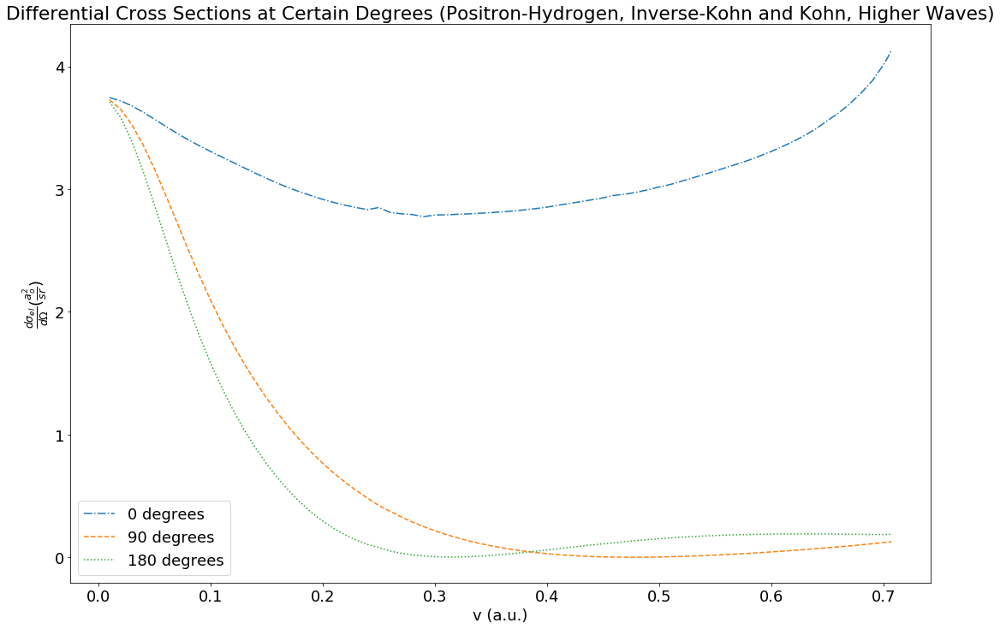

In [20]:
pos_hyd_diff_degree =  positron_hyd_vr_hybrid_all_system.plot_diff_cross_vs_k(r_interval,velocity=True, data=True)
sliced = pos_hyd_diff_degree[pos_hyd_diff_degree.index % 5 == 0]
display(sliced)

positron_hyd_vr_hybrid_all_system.plot_diff_cross_vs_k(r_interval,velocity=True)

,degrees,v = 0.1,v = 0.2,v = 0.3,v = 0.4,v = 0.5,v = 0.6,v = 0.7
0,0,3.308,2.917,2.790,2.854,3.018,3.308,4.013
10,10,3.271,2.767,2.562,2.548,2.627,2.816,3.363
20,20,3.167,2.425,2.062,1.895,1.815,1.818,2.060
30,30,3.017,2.069,1.579,1.300,1.112,0.994,1.018
40,40,2.846,1.771,1.208,0.877,0.651,0.495,0.426
50,50,2.673,1.510,0.908,0.564,0.345,0.202,0.123
60,60,2.508,1.274,0.656,0.329,0.146,0.048,0.009
70,70,2.356,1.072,0.462,0.174,0.043,0.002,0.016
80,80,2.219,0.907,0.322,0.082,0.005,0.011,0.066
90,90,2.097,0.767,0.216,0.029,0.002,0.043,0.120


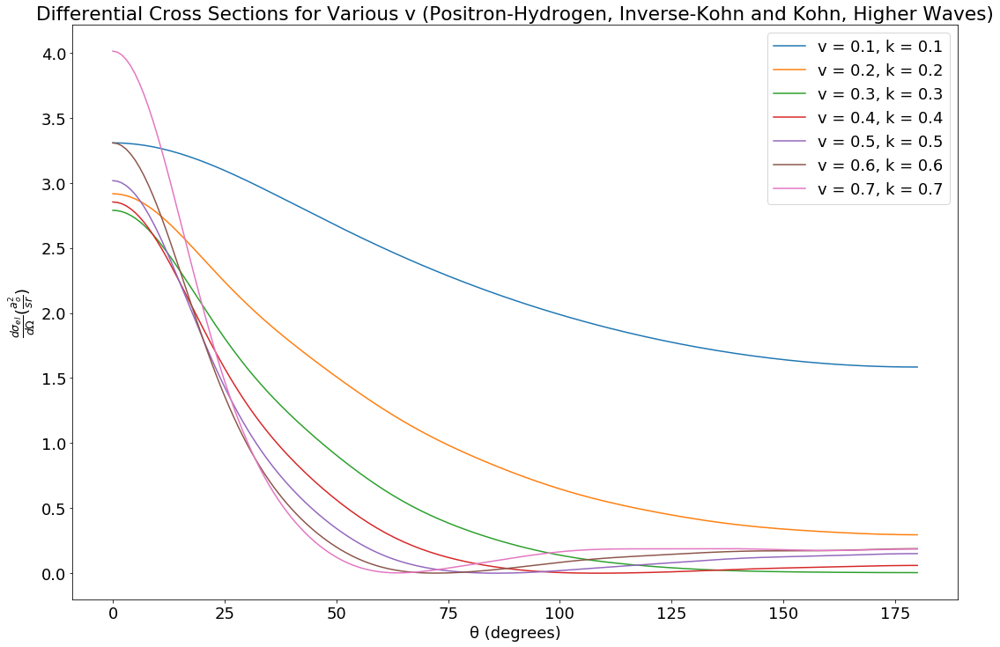

In [21]:
pos_hyd_diff = positron_hyd_vr_hybrid_all_system.diff_plot(interval='hydrogen',velocity=True, data=True)
sliced = pos_hyd_diff[pos_hyd_diff.index % 10 == 0 ]
display(sliced)

positron_hyd_vr_hybrid_all_system.diff_plot(interval='hydrogen',velocity=True)

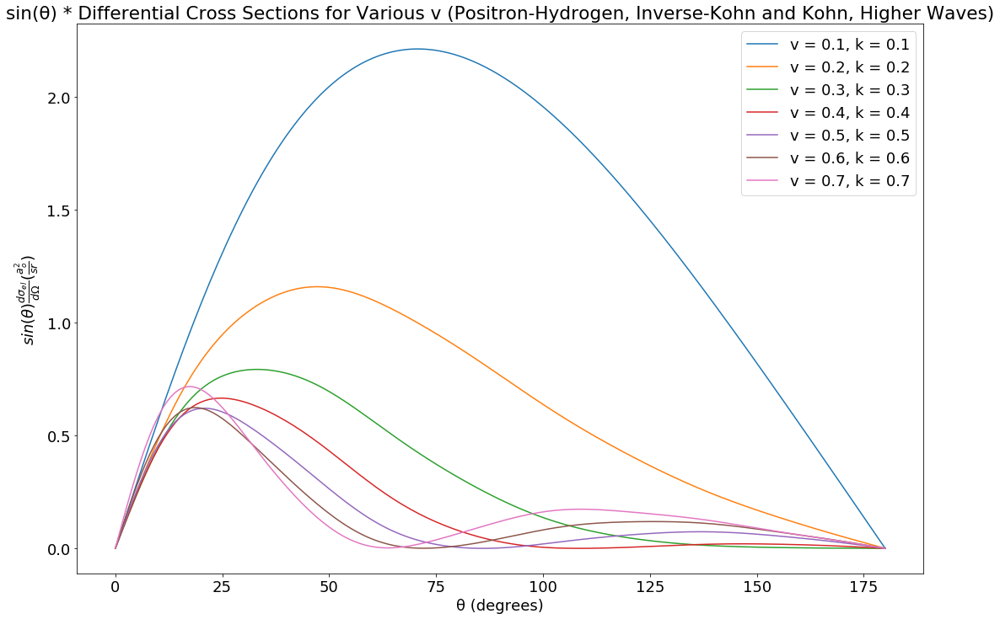

In [22]:
positron_hyd_vr_hybrid_all_system.diff_plot(sin=True,interval='hydrogen',velocity=True)

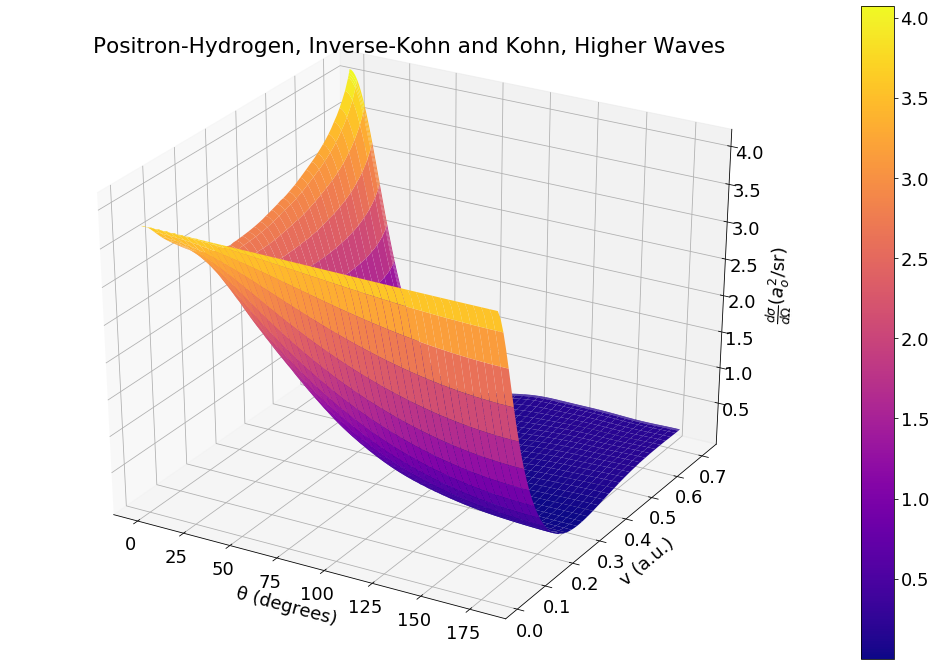

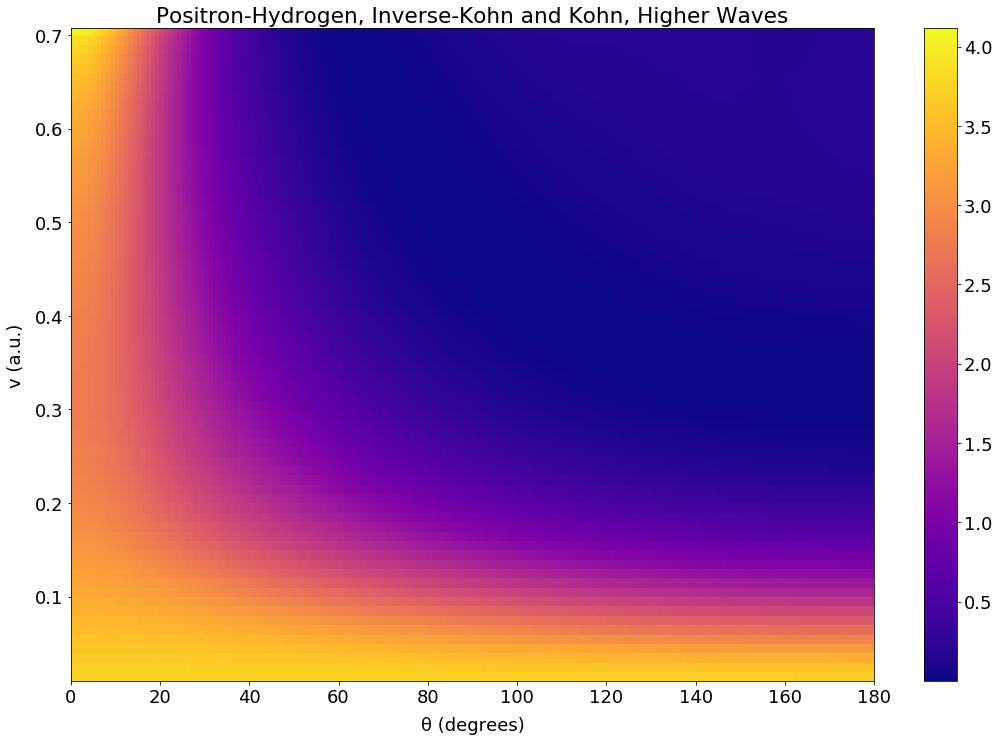

In [23]:
positron_hyd_vr_hybrid_all_system.diff_plot_3d(velocity=True)
positron_hyd_vr_hybrid_all_system.diff_plot_3d(density=True,velocity=True)

## Positron-Helium

Phase shifts provided by P Van Reeth, Private Communication 2020 [13].

In [24]:
#  Positron-Helium, data from P Van Reeth Private Communication 2020, this is the most optimal data
positron_hel_system_vr = collision(pos_hel_vr_phases,k_vr_pos_hel, 'Positron-Helium',1)

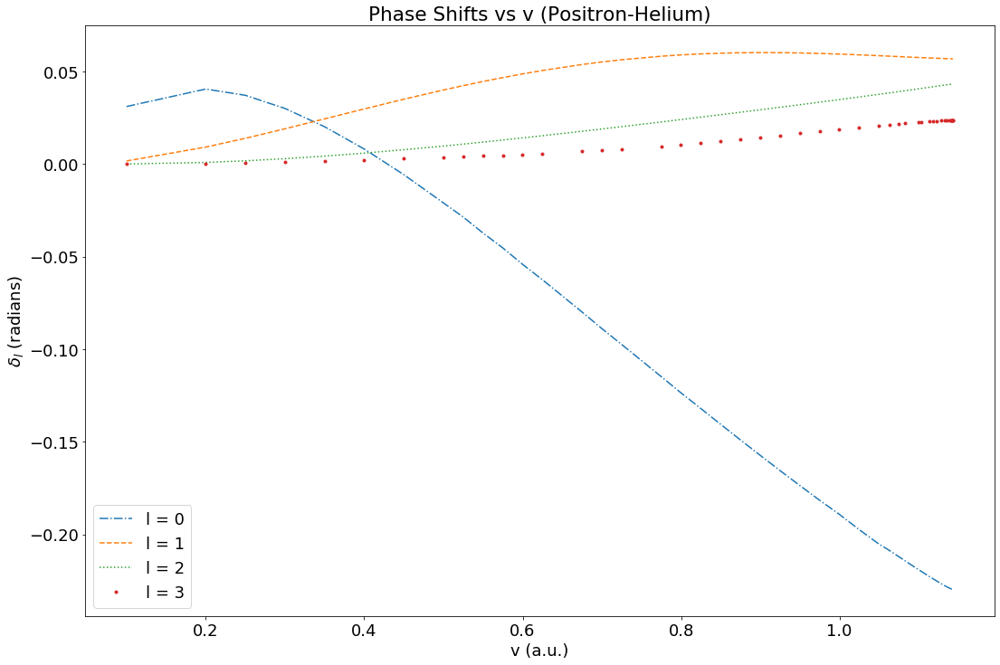

In [25]:
positron_hel_system_vr.plot_phase_shifts(velocity=True)

The s wave phase shifts rapidly decrease into negative values that are greater in magnitude than the other waves. The p, d, and f waves all have a slight increase with increasing energy. The higher the wave, the less this increase.

,v,total cross section,l = 0 contribution,l = 1 contribution,l = 2 contribution,l = 3 contribution
0,0.100,0.388,99.1792%,0.8204%,0.0002%,0.0001%
5,0.400,0.073,2.2413%,90.7431%,5.8941%,1.1214%
10,0.575,0.116,21.4459%,68.2032%,8.7352%,1.6157%
15,0.725,0.163,44.1328%,44.2743%,9.4542%,2.1388%
20,0.875,0.198,58.0061%,28.4515%,10.2636%,3.2788%
25,1.000,0.218,65.003%,19.3915%,11.0993%,4.5061%
30,1.083,0.227,68.0713%,15.0621%,11.7671%,5.0996%
35,1.123,0.229,69.0722%,13.5116%,12.1936%,5.2226%
40,1.141,0.229,69.3567%,12.966%,12.4373%,5.2401%
45,1.143,0.228,69.2947%,12.9341%,12.5144%,5.2568%


Average value for total cross section : 0.189
Maximum value for total cross section


,v,total cross section,l = 0 contribution,l = 1 contribution,l = 2 contribution,l = 3 contribution
0,0.1,0.388,99.1792%,0.8204%,0.0002%,0.0001%


Minimum value for total cross section


,v,total cross section,l = 0 contribution,l = 1 contribution,l = 2 contribution,l = 3 contribution
5,0.4,0.073,2.2413%,90.7431%,5.8941%,1.1214%


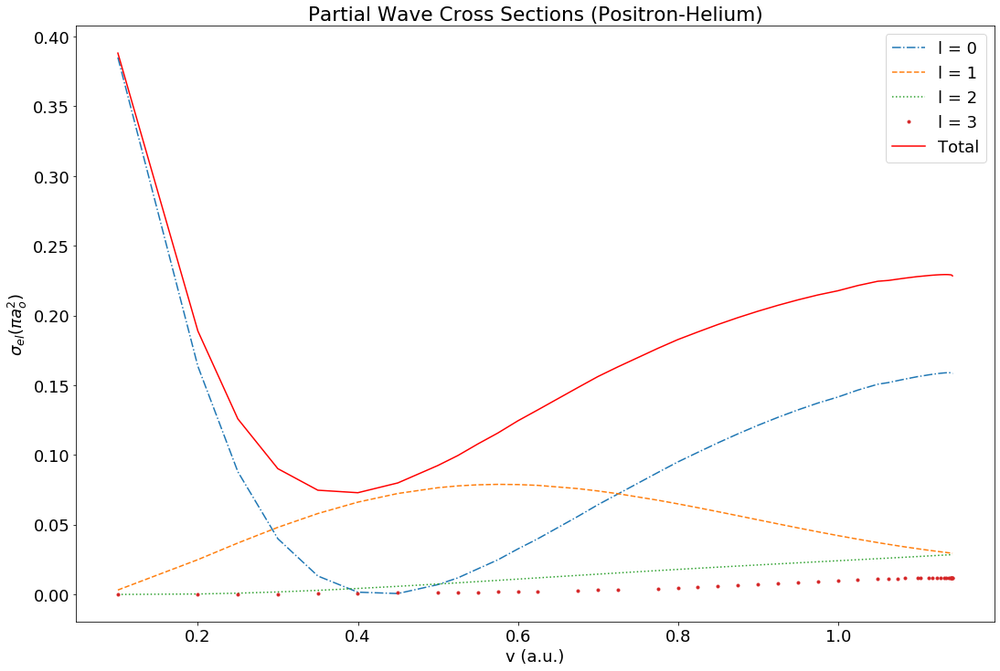

In [26]:
pos_hel_cross_data = positron_hel_system_vr.plot_cross_section(data=True)
sliced = pos_hel_cross_data[pos_hel_cross_data.index % 5 == 0]

display(sliced)
get_avg(pos_hel_cross_data, 'total cross section')
data_max(pos_hel_cross_data, 'total cross section')
data_min(pos_hel_cross_data, 'total cross section')

positron_hel_system_vr.plot_cross_section(velocity=True)

The elastic cross section rapidly decreases before beginning to gradually rise again with increasing energy after v = 0.4. The s wave is the greatest contributor until v = 0.3, where the p wave overtakes it.  The s wave has its lowest contribution at v = 0.45 with only a 0.8% contribution; the p wave contributes 90.5% at this velocity. After this point, the contribution of the s wave rises while the p wave decreases. The d and f wave contributions increase with increasing energy throughout. At the highest velocity of 1.14, the s, p, d, and f wave contribute 69.9, 12.9, 12.5, and 5.3 percent, respectively.

,v,total momentum transfer,l = 0 contribution,l = 1 contribution,l = 2 contribution
0,0.100,0.348,99.3737%,0.6258%,0.0004%
5,0.400,0.041,28.4088%,69.0922%,2.499%
10,0.575,0.132,77.2972%,20.8408%,1.862%
15,0.725,0.202,88.4974%,9.8603%,1.6423%
20,0.875,0.239,94.0959%,4.5093%,1.3948%
25,1.000,0.250,96.831%,1.9331%,1.2358%
30,1.083,0.252,97.8473%,0.9009%,1.2518%
35,1.123,0.251,98.0898%,0.5751%,1.3351%
40,1.141,0.250,98.1391%,0.4634%,1.3975%
45,1.143,0.249,98.1367%,0.4503%,1.4129%


Average value for total momentum transfer : 0.204
Maximum value for total momentum transfer


,v,total momentum transfer,l = 0 contribution,l = 1 contribution,l = 2 contribution
0,0.1,0.348,99.3737%,0.6258%,0.0004%


Minimum value for total momentum transfer


,v,total momentum transfer,l = 0 contribution,l = 1 contribution,l = 2 contribution
4,0.35,0.028,2.0909%,95.3412%,2.5678%


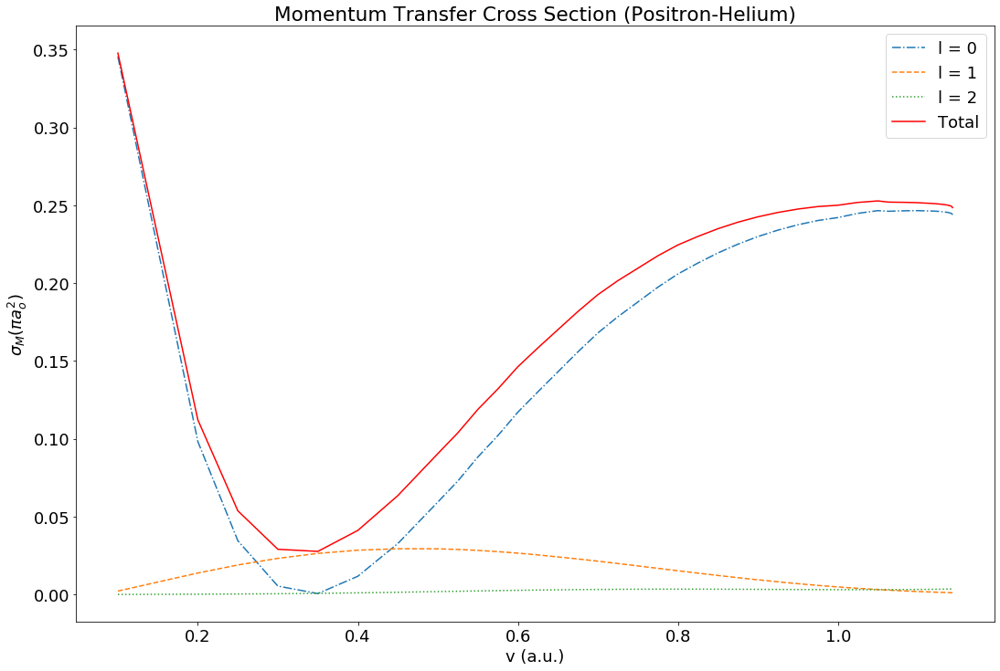

In [27]:
pos_hel_momentum_data = positron_hel_system_vr.plot_momentum_transfer(velocity=True, data=True)

sliced = pos_hel_momentum_data[pos_hel_momentum_data.index % 5 == 0]

display(sliced)
get_avg(pos_hel_momentum_data, 'total momentum transfer')
data_max(pos_hel_momentum_data, 'total momentum transfer')
data_min(pos_hel_momentum_data, 'total momentum transfer')

positron_hel_system_vr.plot_momentum_transfer(velocity=True)

The momentum transfer cross section is less than the elastic cross section for v < 0.52. The momentum transfer cross section rises quicker than the elastic cross section. The s wave has a greater contribution to the momentum transfer cross section than the elastic cross section.

In [28]:
pos_hel_cross_momentum = cross_momentum_compare(pos_hel_cross_data, pos_hel_momentum_data)

sliced = pos_hel_cross_momentum[pos_hel_cross_momentum.index % 5 == 0]
display(sliced)

get_avg(pos_hel_cross_momentum, 'ratio momentum/cross')
data_max(pos_hel_cross_momentum, 'ratio momentum/cross')
data_min(pos_hel_cross_momentum, 'ratio momentum/cross')

,v,total cross section,total momentum transfer,ratio momentum/cross
0,0.100,0.388,0.348,0.897
5,0.400,0.073,0.041,0.562
10,0.575,0.116,0.132,1.138
15,0.725,0.163,0.202,1.239
20,0.875,0.198,0.239,1.207
25,1.000,0.218,0.250,1.147
30,1.083,0.227,0.252,1.110
35,1.123,0.229,0.251,1.096
40,1.141,0.229,0.250,1.092
45,1.143,0.228,0.249,1.092


Average value for ratio momentum/cross : 1.05
Maximum value for ratio momentum/cross


,v,total cross section,total momentum transfer,ratio momentum/cross
15,0.725,0.163,0.202,1.239
16,0.775,0.176,0.218,1.239


Minimum value for ratio momentum/cross


,v,total cross section,total momentum transfer,ratio momentum/cross
3,0.3,0.09,0.029,0.322


,v,0 degrees,90 degrees,180 degrees
0,0.100,0.129,0.097,0.067
5,0.400,0.125,0.000,0.028
10,0.575,0.112,0.018,0.071
15,0.725,0.101,0.041,0.093
20,0.875,0.094,0.062,0.103
25,1.000,0.092,0.075,0.103
30,1.083,0.089,0.082,0.098
35,1.123,0.088,0.084,0.094
40,1.141,0.087,0.085,0.091
45,1.143,0.088,0.085,0.091


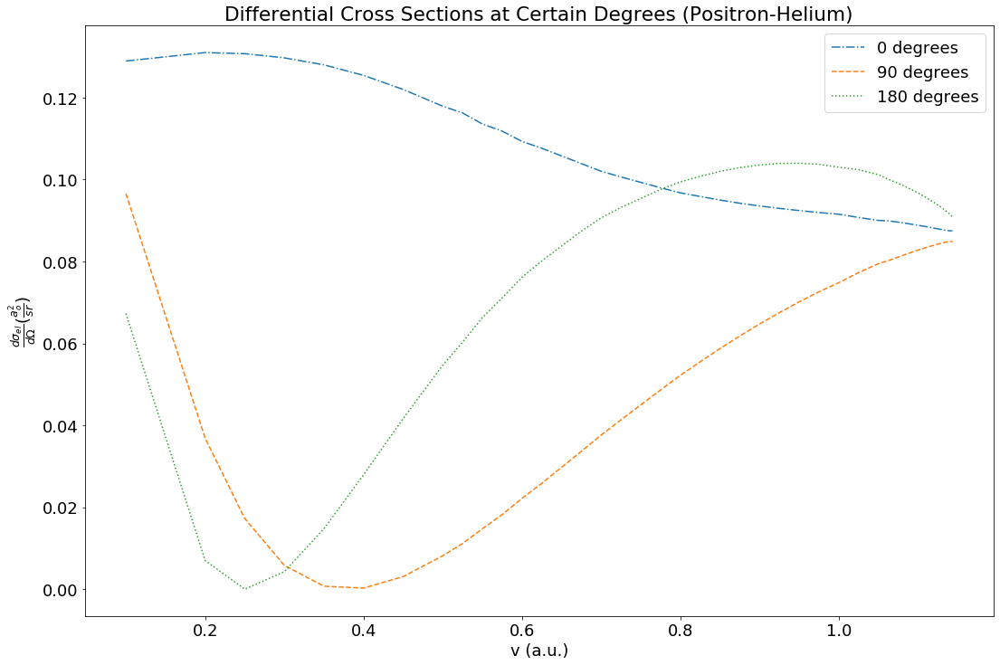

In [29]:
pos_hel_diff_degree =  positron_hel_system_vr.plot_diff_cross_vs_k(r_interval,velocity=True, data=True)
sliced = pos_hel_diff_degree[pos_hel_diff_degree.index % 5 == 0]
display(sliced)

positron_hel_system_vr.plot_diff_cross_vs_k(r_interval,velocity=True)

At 180 degrees the curve resembles the shape of the momentum transfer cross section. At 90 degrees it resembles the shape of the elastic cross section. 

,degrees,v = 0.1,v = 0.2,v = 0.3,v = 0.4,v = 0.5,v = 0.6,v = 0.7,v = 0.8,v = 0.9,v = 1.0,v = 1.1
0,0,0.129,0.131,0.130,0.125,0.118,0.109,0.102,0.097,0.094,0.092,0.089
10,10,0.128,0.129,0.125,0.118,0.110,0.100,0.092,0.086,0.082,0.079,0.076
20,20,0.127,0.122,0.111,0.099,0.087,0.076,0.066,0.058,0.052,0.048,0.044
30,30,0.124,0.112,0.091,0.074,0.059,0.046,0.035,0.027,0.021,0.017,0.014
40,40,0.121,0.099,0.069,0.047,0.031,0.020,0.011,0.006,0.003,0.002,0.003
50,50,0.116,0.085,0.049,0.026,0.012,0.004,0.001,0.001,0.005,0.010,0.015
60,60,0.112,0.071,0.032,0.011,0.002,0.000,0.004,0.011,0.021,0.032,0.042
70,70,0.107,0.058,0.020,0.003,0.000,0.005,0.015,0.027,0.042,0.056,0.069
80,80,0.102,0.047,0.011,0.000,0.003,0.014,0.027,0.043,0.058,0.072,0.083
90,90,0.097,0.037,0.006,0.000,0.008,0.022,0.038,0.052,0.065,0.075,0.083


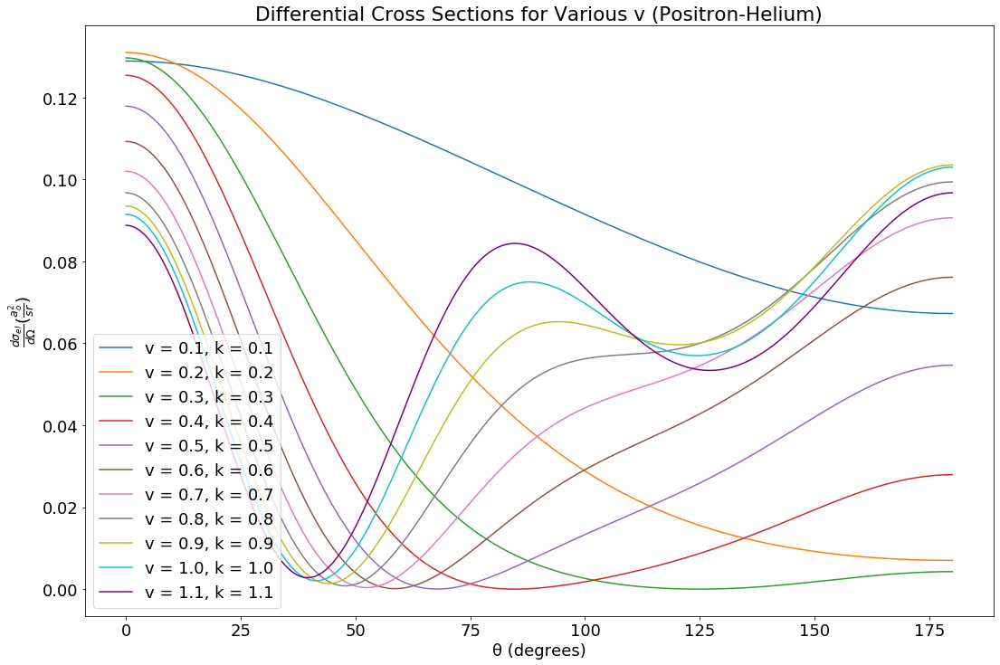

In [30]:
pos_hel_diff = positron_hel_system_vr.diff_plot(interval='helium',velocity=True, data=True)
sliced = pos_hel_diff[pos_hel_diff.index % 10 == 0 ]
display(sliced)

positron_hel_system_vr.diff_plot(interval='helium',velocity=True)

At 0 degrees the differential cross section is less the higher the energy with the exception of v = 0.1, which is slightly less than v = 0.3 . The general behavior of the differential cross section at a given energy it decreases with increasing degrees before rising again. This behavior occurs quicker for higher energy. Thus, at lower energy the curve does not begin to rise by the end of the graph. At higher energies, the differential cross section falls to a lesser extent once at local maximum is reached. It then begins to rise once more. This behavior is more evident the higher the energy. 

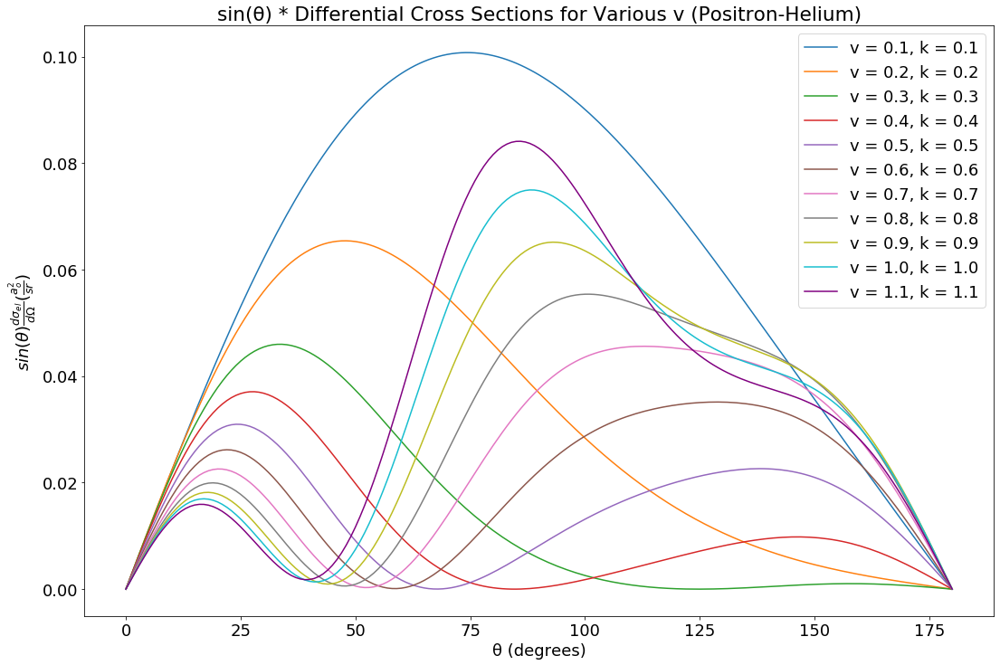

In [31]:
positron_hel_system_vr.diff_plot(sin=True,interval='helium',velocity=True)

At low energies, the curve looks parabolic. As the energy increases the maximum of this first parabola becomes less, and the parabola occurs at a lower degree. Once this parabola is finished another begins to form. This is most evident at the higher energies where two parabolas are easily visible. 

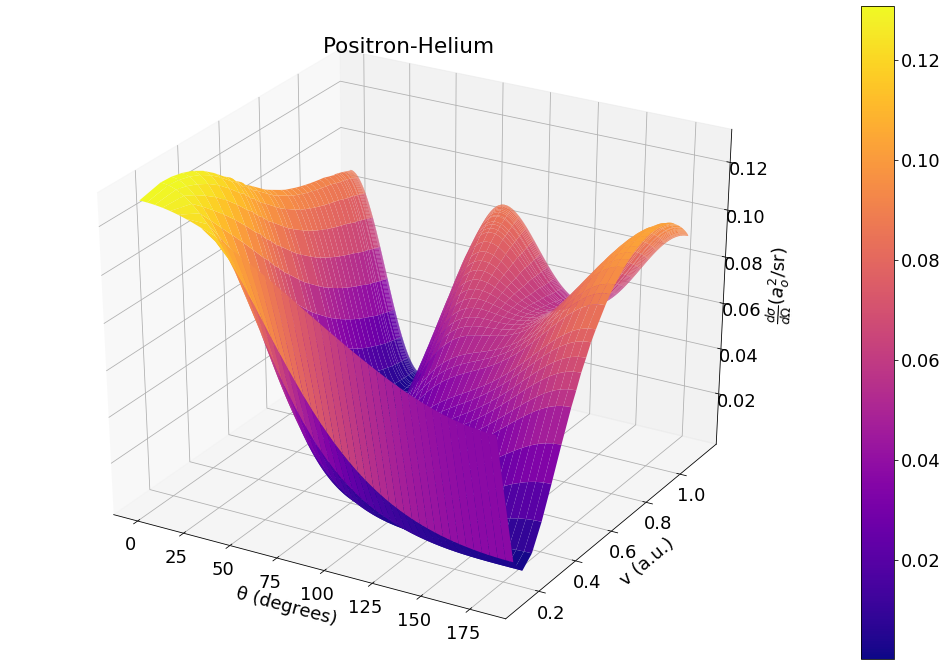

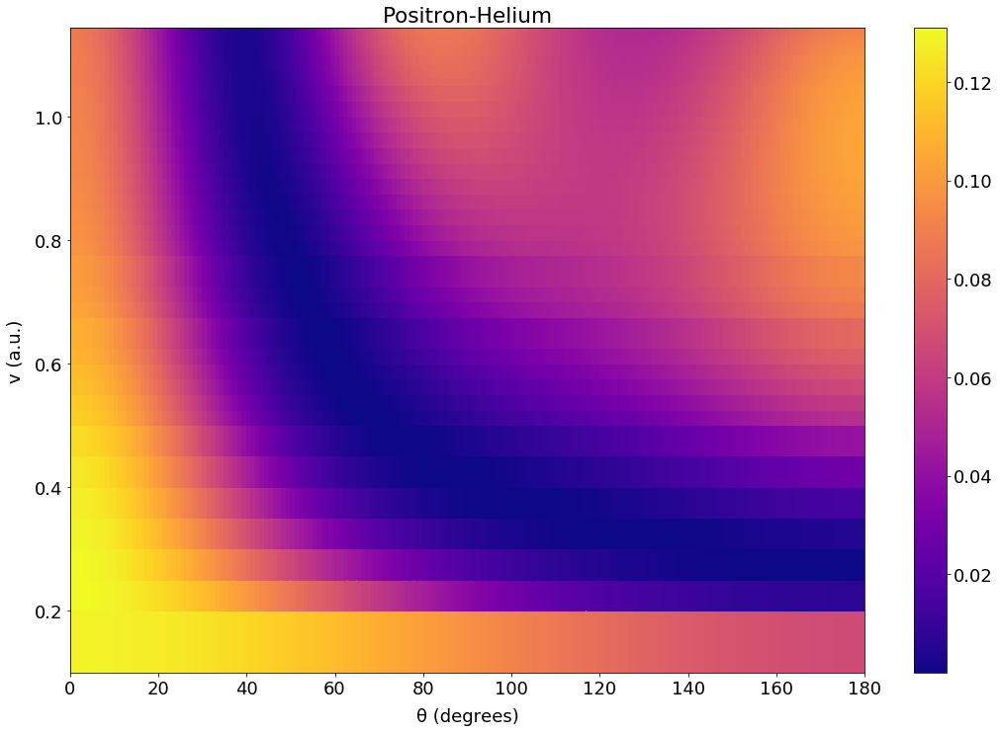

In [32]:
positron_hel_system_vr.diff_plot_3d(velocity=True)
positron_hel_system_vr.diff_plot_3d(density=True,velocity=True)

The greatest peak is in the region of lowest velocity and lowest degrees. Increasing the degrees or velocity decreases the differential cross section until the bottom of the valley is reached. Increasing the velocity or degrees beyond this valley raises the differential cross section, but it never peaks to the extent as low velocity, low degrees. 

Phase shifts from P Van Reeth and J W Humberston 1999 [3] is used here. This is outdated. 

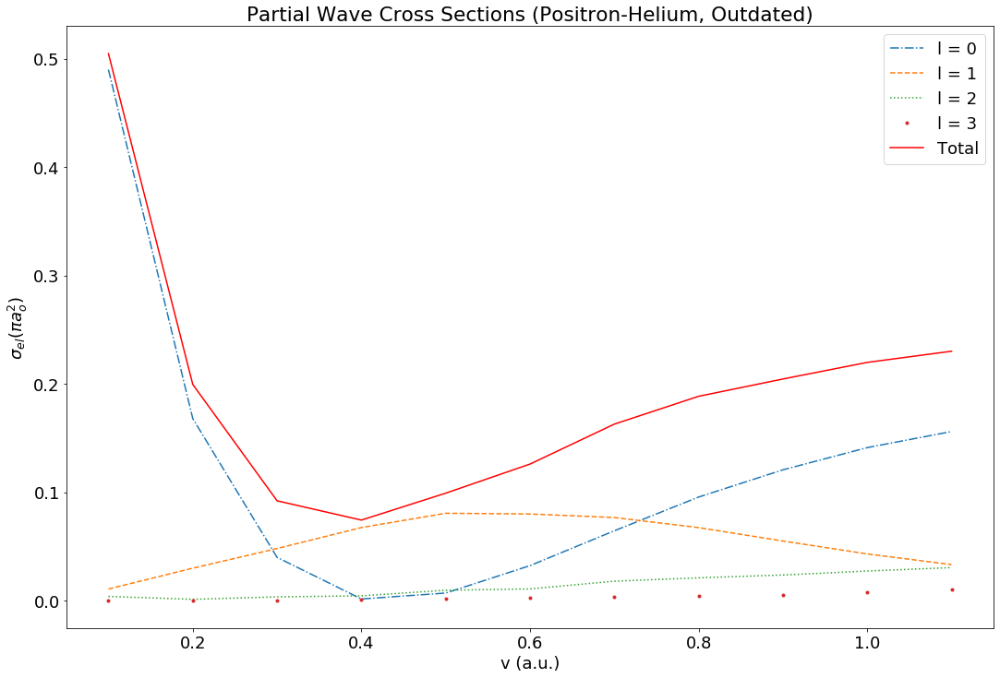

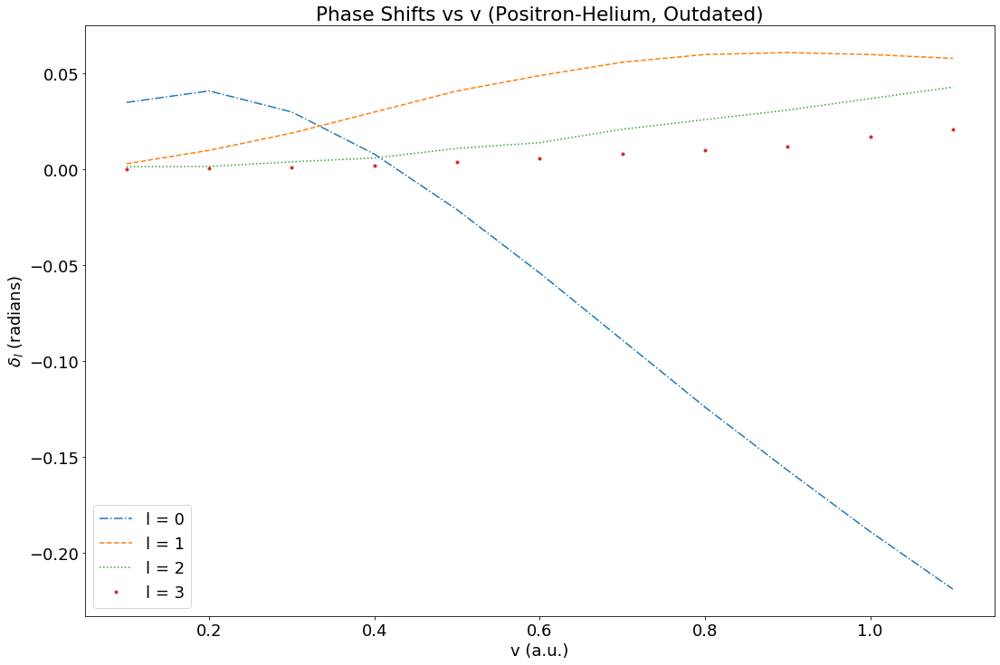

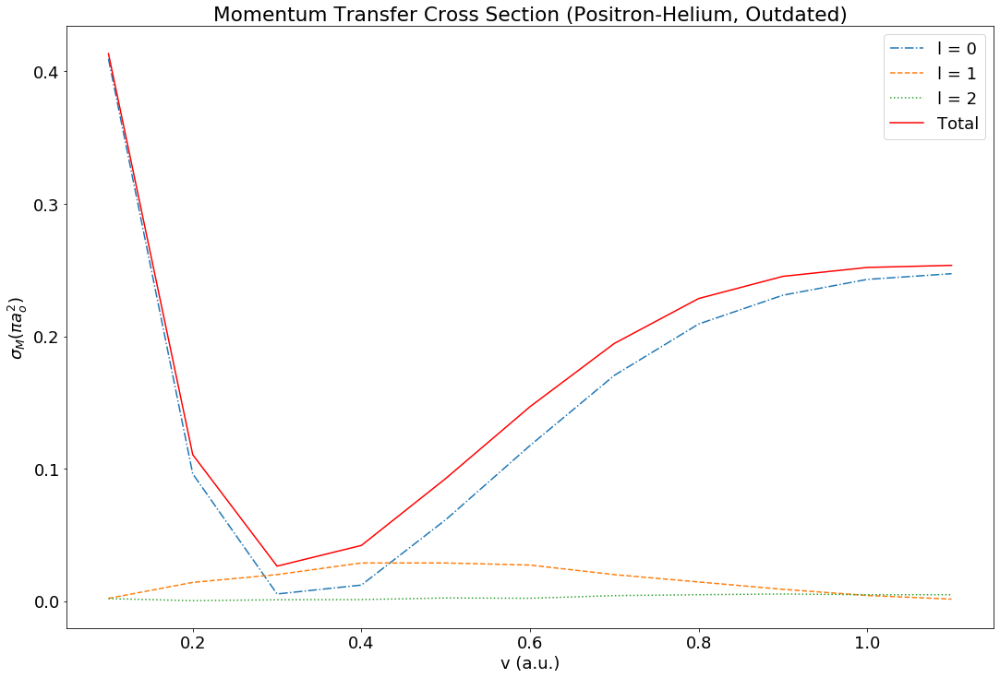

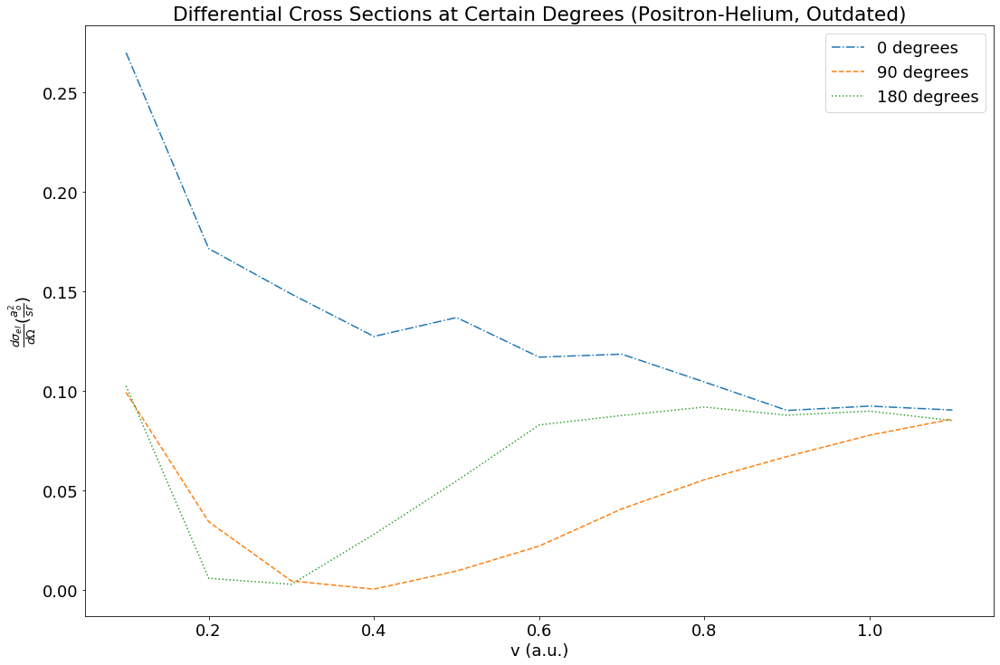

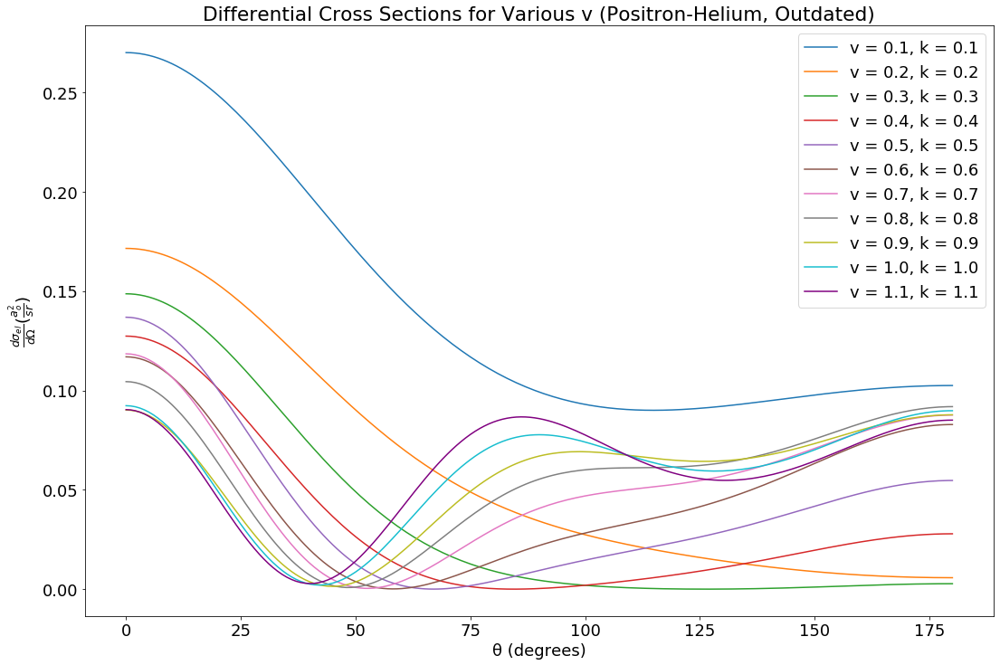

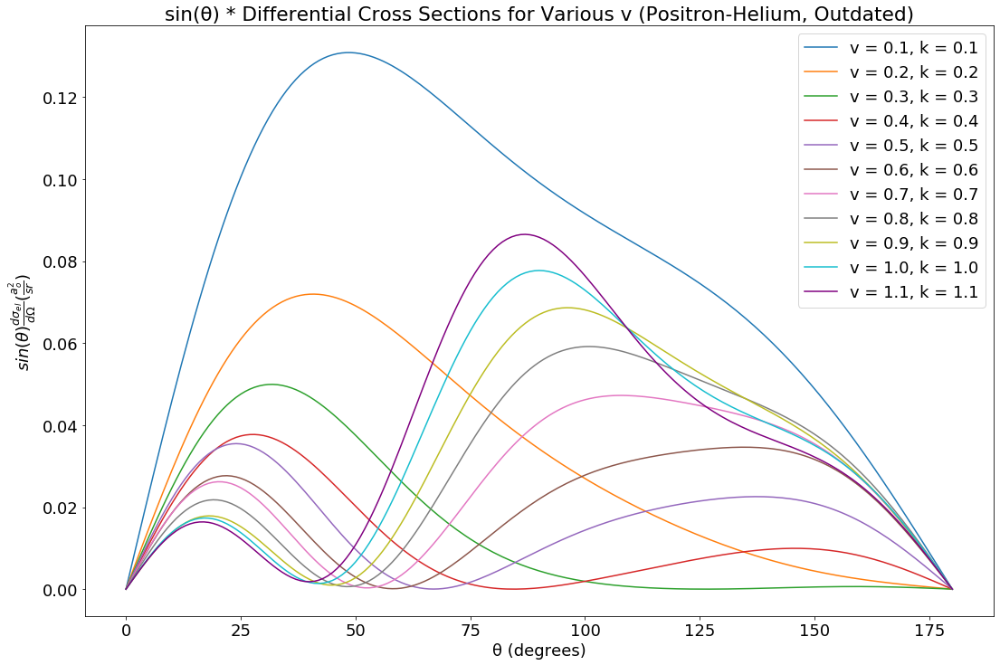

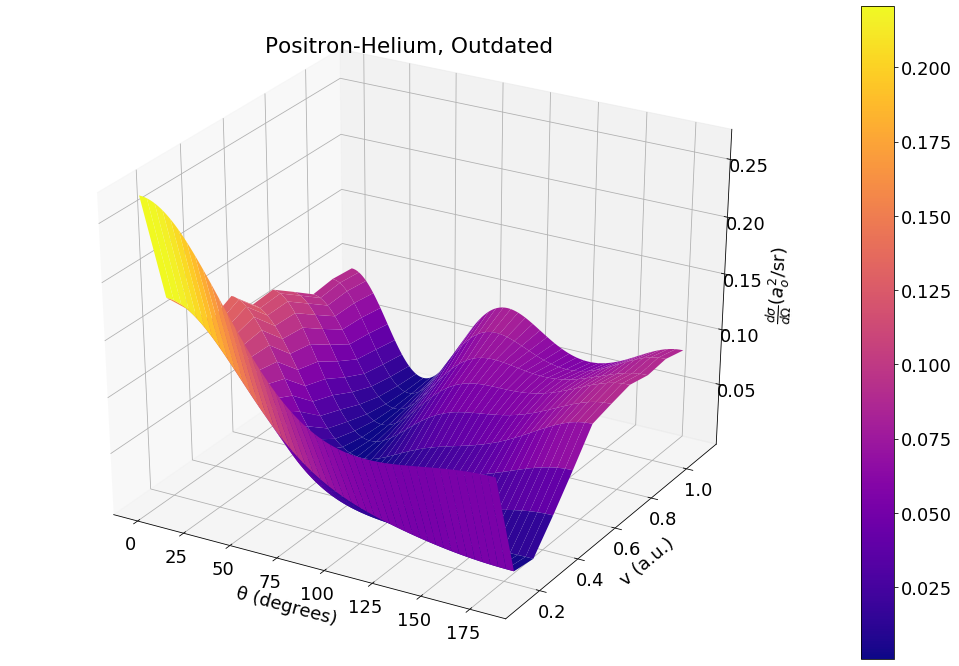

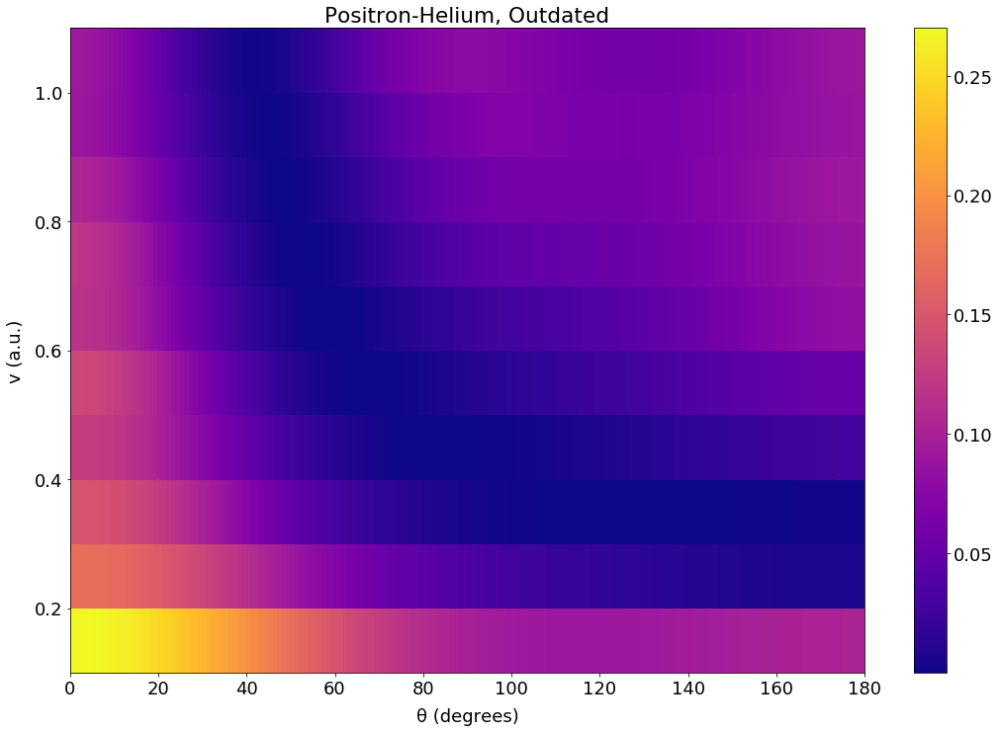

In [33]:
#  Positron-Helium, data from P Van Reeth and J W Humberston 1999, this data is outdated
positron_hel_system = collision(positron_hel_phases,k_list_positron_hel,'Positron-Helium, Outdated',1)

positron_hel_system.plot_cross_section(velocity=True)
positron_hel_system.plot_phase_shifts(velocity=True)
positron_hel_system.plot_momentum_transfer(velocity=True)
positron_hel_system.plot_diff_cross_vs_k(r_interval,velocity=True)
positron_hel_system.diff_plot(velocity=True)
positron_hel_system.diff_plot(sin=True,velocity=True)
positron_hel_system.diff_plot_3d(velocity=True)
positron_hel_system.diff_plot_3d(density=True,velocity=True)


## Electron-Helium

Phase shifts from both R K Nesbet 1979 [5]; A. L. Sinfailam and R K Nesbet 1972 [4].

In [34]:
#  Electron-Helium, R K Nesbet 1979, A. L. Sinfailam and R K Nesbet 1972

electron_hel_system = collision(e_hel_phases,k_list_e_hel,'Electron-Helium',1)

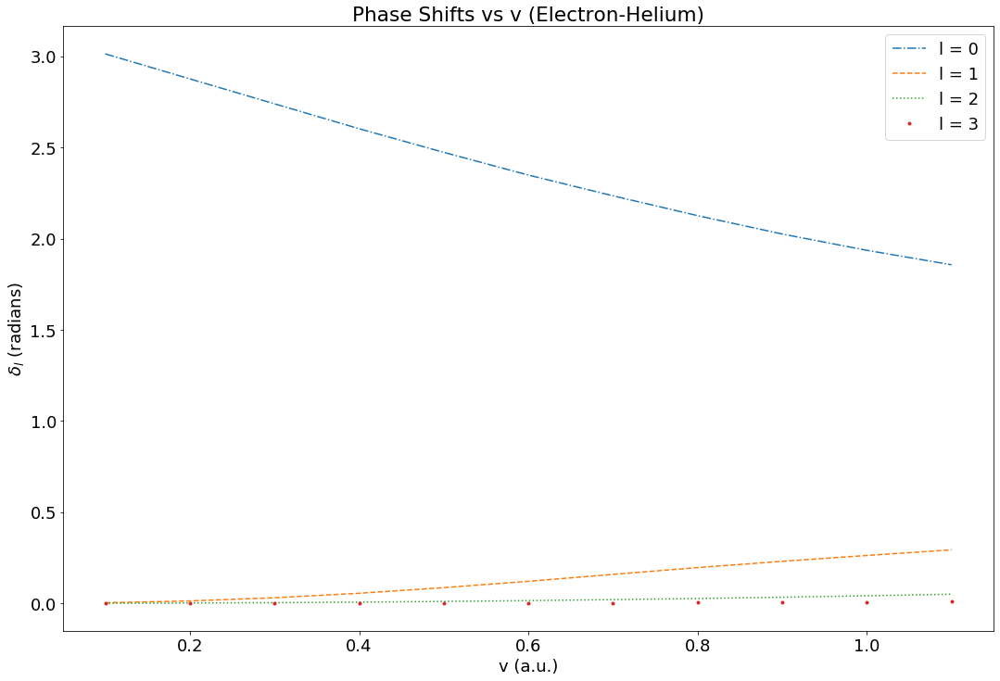

In [35]:
electron_hel_system.plot_phase_shifts(velocity=True)

The s wave phase shifts fall with increasing energy nearly linearly. The p wave increases nearly linearly with increasing energy. The d and f waves remain close to zero.

,v,total cross section,l = 0 contribution,l = 1 contribution,l = 2 contribution,l = 3 contribution
0,0.1,6.549,99.8183%,0.1761%,0.0049%,0.0007%
1,0.2,6.938,99.2362%,0.742%,0.0208%,0.001%
2,0.3,6.935,98.1551%,1.7998%,0.0439%,0.0012%
3,0.4,6.816,96.5682%,3.3496%,0.0799%,0.0023%
4,0.5,6.509,94.4097%,5.4535%,0.1329%,0.0039%
5,0.6,6.138,91.8925%,7.8999%,0.2009%,0.0067%
6,0.7,5.692,88.9352%,10.7591%,0.2955%,0.0103%
7,0.8,5.247,86.0128%,13.5536%,0.4182%,0.0154%
8,0.9,4.789,83.2498%,16.1483%,0.5784%,0.0235%
9,1.0,4.335,80.5165%,18.6559%,0.7904%,0.0373%


Average value for total cross section : 5.806
Maximum value for total cross section


,v,total cross section,l = 0 contribution,l = 1 contribution,l = 2 contribution,l = 3 contribution
1,0.2,6.938,99.2362%,0.742%,0.0208%,0.001%


Minimum value for total cross section


,v,total cross section,l = 0 contribution,l = 1 contribution,l = 2 contribution,l = 3 contribution
10,1.1,3.915,77.7232%,21.1611%,1.0589%,0.0568%


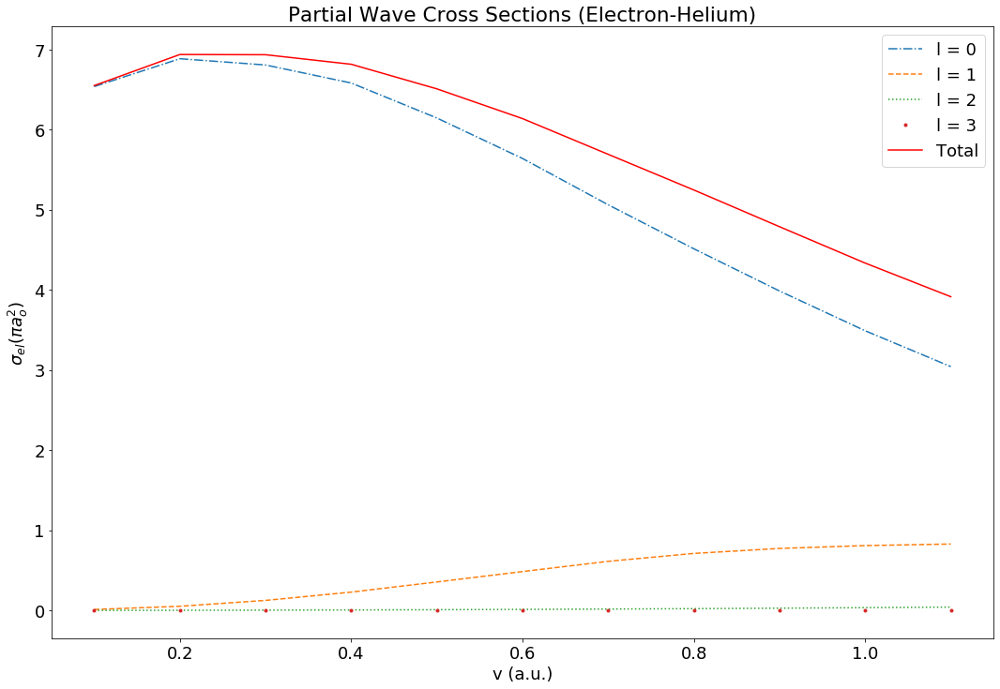

In [36]:
e_hel_cross_data = electron_hel_system.plot_cross_section(data=True)


display(e_hel_cross_data)
get_avg(e_hel_cross_data, 'total cross section')
data_max(e_hel_cross_data, 'total cross section')
data_min(e_hel_cross_data, 'total cross section')

electron_hel_system.plot_cross_section(velocity=True)

The total elastic cross section increases briefly before beginning to fall nearly linearly with increasing velocity. The greatest contributor for all velocities is the s wave, which follows almost exactly the same shape as the total elastic cross section. The contribution of the s wave gradually decreases with increasing energy, and the contribution of the p wave increases by about the amount of the s wave decreases. At the highest velocity, the s, p, d, and f wave contribute 78%, 21%, 1%, and 0.06%, respectively. 

,v,total momentum transfer,l = 0 contribution,l = 1 contribution,l = 2 contribution
0,0.1,6.861,99.9137%,0.085%,0.0013%
1,0.2,7.589,99.6499%,0.3425%,0.0076%
2,0.3,7.880,99.1668%,0.816%,0.0171%
3,0.4,7.951,98.4858%,1.4841%,0.0301%
4,0.5,7.693,97.5713%,2.3792%,0.0494%
5,0.6,7.222,96.4822%,3.4446%,0.0733%
6,0.7,6.569,95.1537%,4.7373%,0.109%
7,0.8,5.842,93.7534%,6.0885%,0.1581%
8,0.9,5.084,92.3332%,7.4417%,0.2251%
9,1.0,4.357,90.8468%,8.8387%,0.3145%


Average value for total momentum transfer : 6.432
Maximum value for total momentum transfer


,v,total momentum transfer,l = 0 contribution,l = 1 contribution,l = 2 contribution
3,0.4,7.951,98.4858%,1.4841%,0.0301%


Minimum value for total momentum transfer


,v,total momentum transfer,l = 0 contribution,l = 1 contribution,l = 2 contribution
10,1.1,3.705,89.2251%,10.3404%,0.4345%


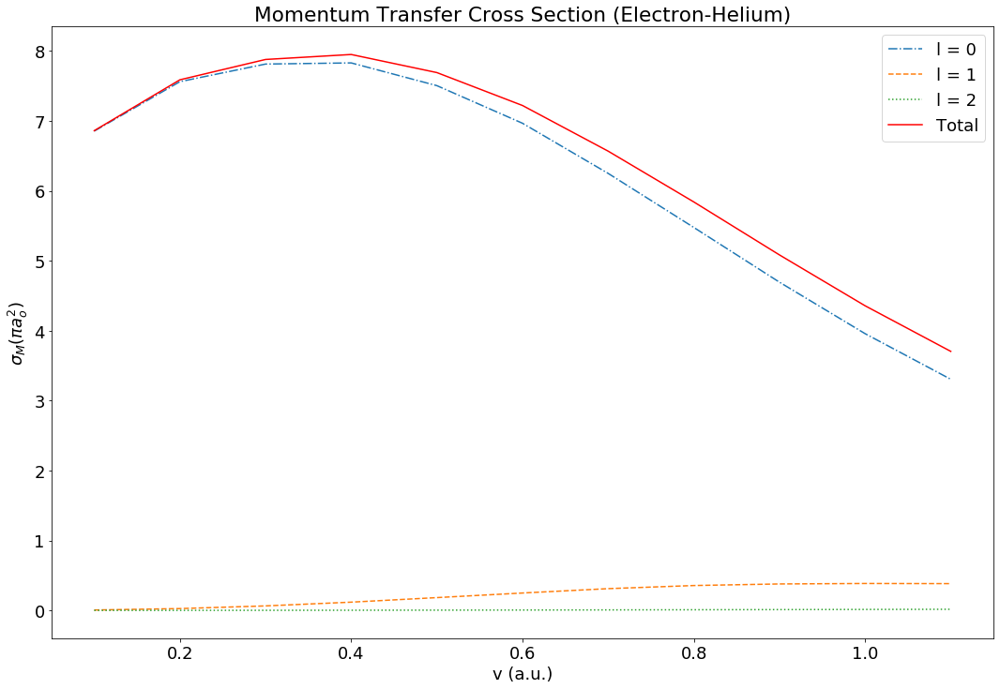

In [37]:
e_hel_momentum_data = electron_hel_system.plot_momentum_transfer(data=True)


display(e_hel_momentum_data)
get_avg(e_hel_momentum_data, 'total momentum transfer')
data_max(e_hel_momentum_data, 'total momentum transfer')
data_min(e_hel_momentum_data, 'total momentum transfer')

electron_hel_system.plot_momentum_transfer(velocity=True)

The momentum transfer cross section is very close to the elastic cross section. At most, it deviants from the elastic cross section by 18% at v = 0.5. Compared to the elastic cross section, the s wave has a greater contribution, never dropping beneath 89% of the total. The maximum for the momentum transfer cross section is greater than the maximum for the elastic cross section, and the minimum is less than the minimum of the elastic cross section.

In [38]:
e_hel_cross_momentum = cross_momentum_compare(e_hel_cross_data, e_hel_momentum_data)


display(e_hel_cross_momentum)
get_avg(e_hel_cross_momentum, 'ratio momentum/cross')
data_max(e_hel_cross_momentum, 'ratio momentum/cross')
data_min(e_hel_cross_momentum, 'ratio momentum/cross')

,v,total cross section,total momentum transfer,ratio momentum/cross
0,0.1,6.549,6.861,1.048
1,0.2,6.938,7.589,1.094
2,0.3,6.935,7.880,1.136
3,0.4,6.816,7.951,1.167
4,0.5,6.509,7.693,1.182
5,0.6,6.138,7.222,1.177
6,0.7,5.692,6.569,1.154
7,0.8,5.247,5.842,1.113
8,0.9,4.789,5.084,1.062
9,1.0,4.335,4.357,1.005


Average value for ratio momentum/cross : 1.099
Maximum value for ratio momentum/cross


,v,total cross section,total momentum transfer,ratio momentum/cross
4,0.5,6.509,7.693,1.182


Minimum value for ratio momentum/cross


,v,total cross section,total momentum transfer,ratio momentum/cross
10,1.1,3.915,3.705,0.946


,v,0 degrees,90 degrees,180 degrees
0,0.1,1.340,1.660,1.849
1,0.2,1.153,1.775,2.164
2,0.3,0.944,1.777,2.373
3,0.4,0.811,1.738,2.502
4,0.5,0.773,1.639,2.496
5,0.6,0.855,1.516,2.382
6,0.7,1.016,1.369,2.172
7,0.8,1.230,1.224,1.903
8,0.9,1.445,1.081,1.609
9,1.0,1.635,0.945,1.329


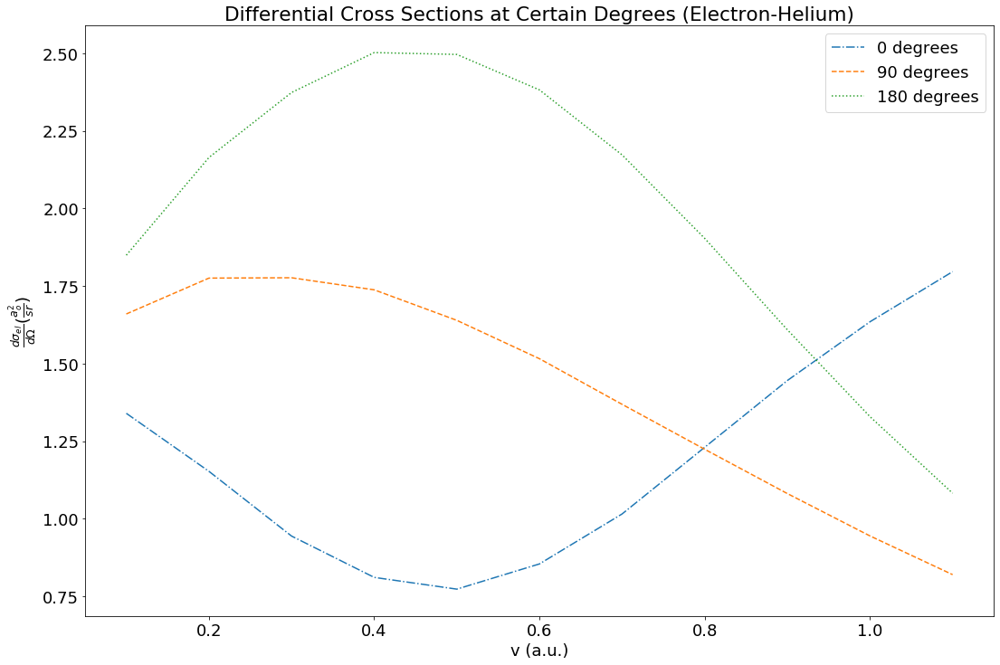

In [39]:
e_hel_diff_degree =  electron_hel_system.plot_diff_cross_vs_k(r_interval,velocity=True, data=True)

display(e_hel_diff_degree)

electron_hel_system.plot_diff_cross_vs_k(r_interval, velocity = True)

The differential cross section at 0 degrees looks similar to 180 degrees if flipped. 

,degrees,v = 0.1,v = 0.2,v = 0.3,v = 0.4,v = 0.5,v = 0.6,v = 0.7,v = 0.8,v = 0.9,v = 1.0,v = 1.1
0,0,1.340,1.153,0.944,0.811,0.773,0.855,1.016,1.230,1.445,1.635,1.796
10,10,1.347,1.165,0.958,0.824,0.782,0.856,1.006,1.210,1.414,1.593,1.745
20,20,1.368,1.200,0.999,0.864,0.809,0.862,0.984,1.157,1.331,1.480,1.604
30,30,1.400,1.256,1.067,0.931,0.859,0.881,0.962,1.089,1.218,1.325,1.409
40,40,1.441,1.329,1.157,1.025,0.936,0.922,0.955,1.029,1.106,1.165,1.205
50,50,1.487,1.414,1.267,1.143,1.040,0.992,0.977,0.997,1.021,1.032,1.030
60,60,1.535,1.507,1.390,1.280,1.169,1.093,1.035,1.004,0.979,0.946,0.906
70,70,1.580,1.600,1.520,1.430,1.317,1.220,1.125,1.050,0.980,0.909,0.837
80,80,1.622,1.691,1.651,1.585,1.477,1.364,1.239,1.127,1.018,0.913,0.813
90,90,1.660,1.775,1.777,1.738,1.639,1.516,1.369,1.224,1.081,0.945,0.820


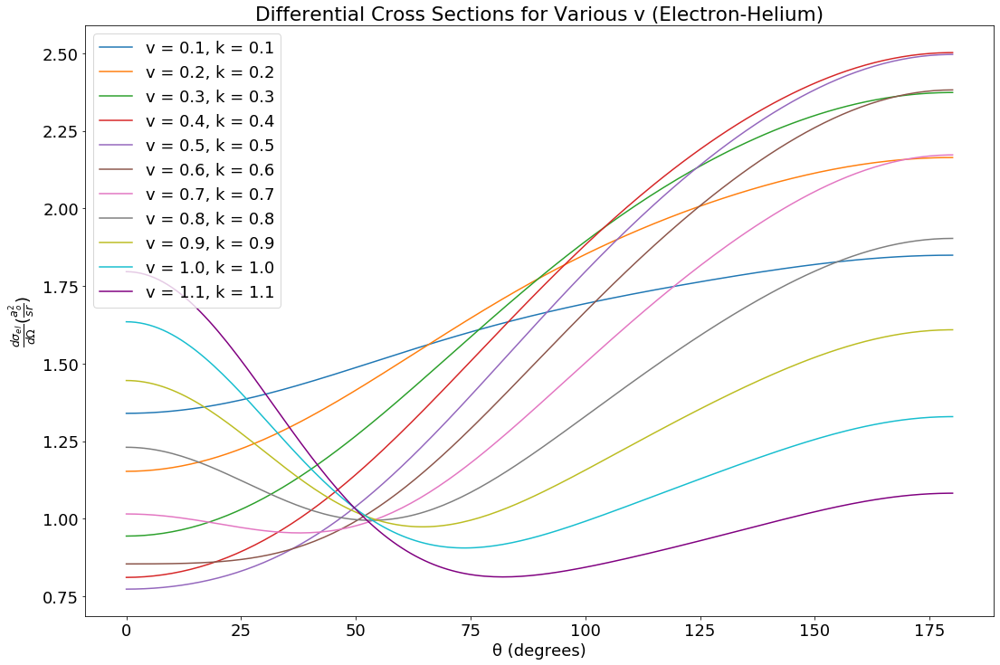

In [40]:
e_hel_diff = electron_hel_system.diff_plot(velocity=True, data=True)
sliced = e_hel_diff[e_hel_diff.index % 10 == 0 ]
display(sliced)


electron_hel_system.diff_plot(velocity=True)

At v =< 0.6 the differential cross section increases with increasing degrees. At higher velocity, the differential cross section first decreases before increasing with increasing energy. There is a large crossing of points around 54 degrees where the differential cross section is around 1.

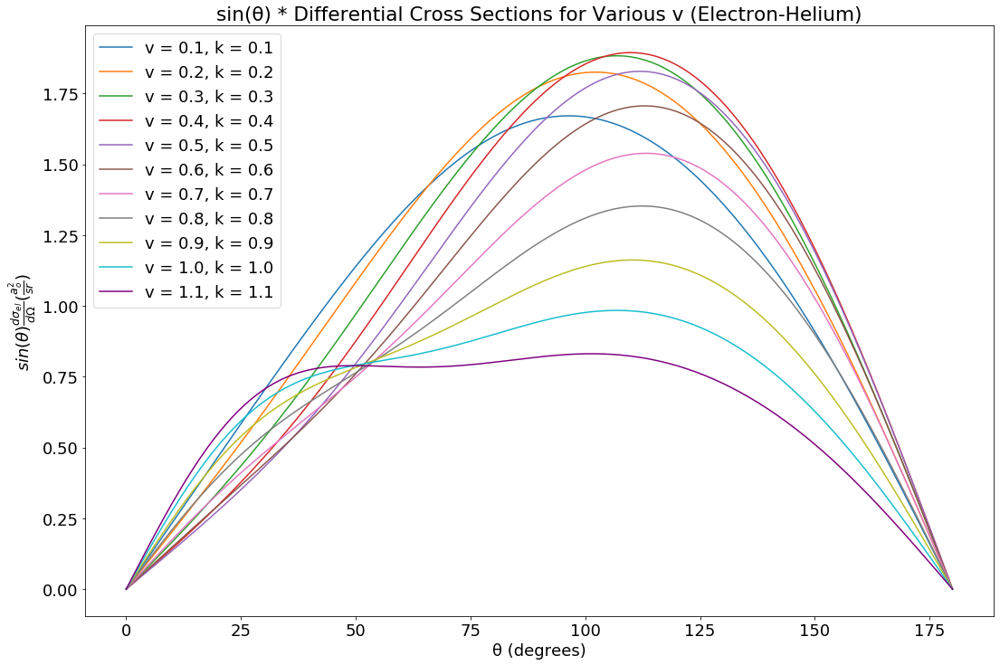

In [41]:
electron_hel_system.diff_plot(sin=True,velocity=True)

The shape of the curves begins in a very parabolic shape at low velocity. As the velocity increases the peak of the parabola becomes increasing flat. 

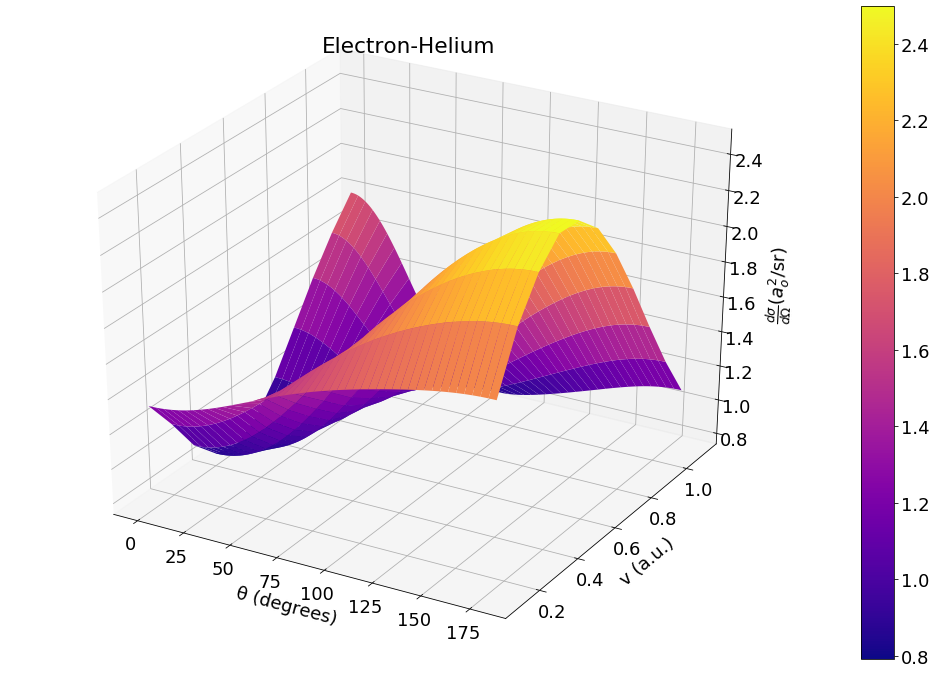

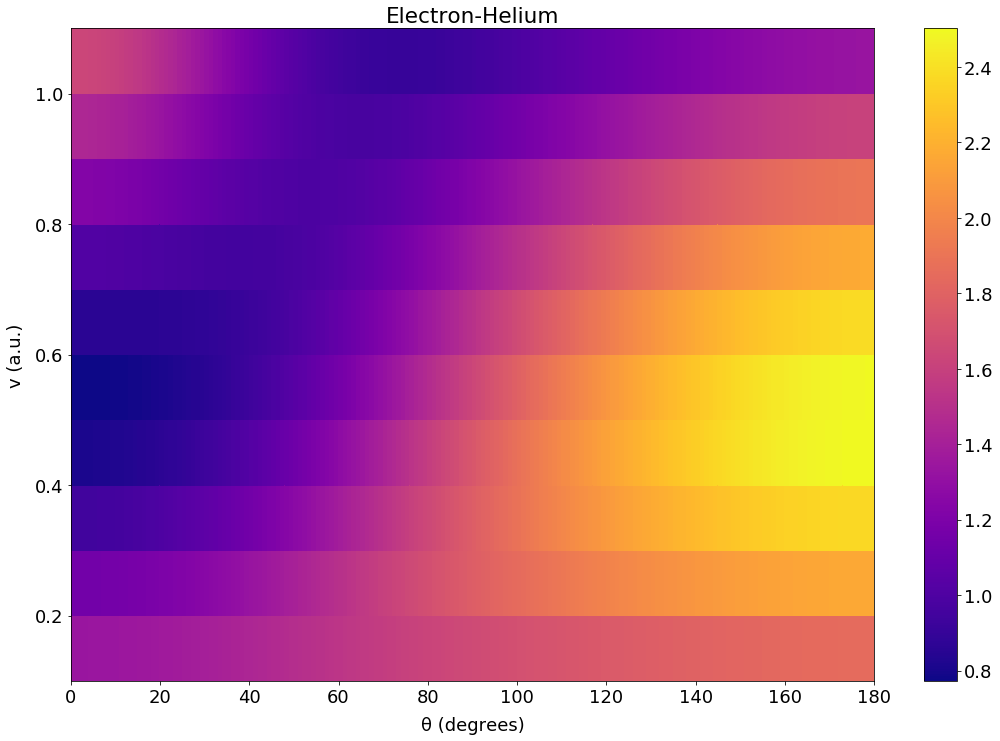

In [42]:
electron_hel_system.diff_plot_3d(velocity=True)
electron_hel_system.diff_plot_3d(density=True,velocity=True)

The differential cross section has a peak in the area of v = 0.5 au and 180 degrees. Moving away from this region decreases the magnitude of the differential cross section. The differential cross section then begins to rise in the region of high velocity and low degrees.

## Positronium-Helium

Phase shifts used are from Nirmal K Sarkar et al 1999 [8].

In [43]:
#  Positronium-Helium, Nirmal K Sarkar et al 1999

ps_hel_system = collision(ps_hel_phases,k_list_ps_hel,'Positronium-Helium',2)

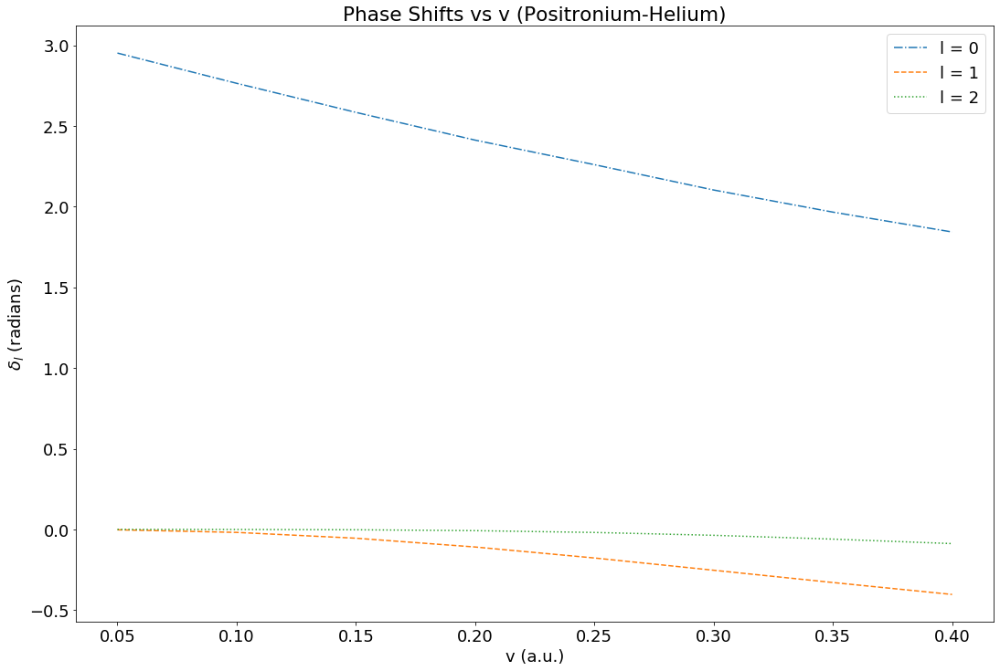

In [44]:
ps_hel_system.plot_phase_shifts(velocity=True)

The phase shifts for the s wave decrease nearly linearly with increasing energy. The p wave phase shifts decrease largely linearly into negative values with increasing energy. The d wave phase shifts remains close to zero with a slight decrease with increasing energy.

,v,total cross section,l = 0 contribution,l = 1 contribution,l = 2 contribution
0,0.05,14.303,99.9459%,0.0541%,0.0%
1,0.10,13.695,99.25%,0.7496%,0.0004%
2,0.15,12.841,96.9105%,3.0811%,0.0084%
3,0.20,12.003,92.5434%,7.3946%,0.0621%
4,0.25,11.046,86.2694%,13.4719%,0.2587%
5,0.30,10.413,79.2321%,20.0574%,0.7105%
6,0.35,9.657,72.0021%,26.4731%,1.5248%
7,0.40,8.923,64.9814%,32.3196%,2.699%


Average value for total cross section : 11.61
Maximum value for total cross section


,v,total cross section,l = 0 contribution,l = 1 contribution,l = 2 contribution
0,0.05,14.303,99.9459%,0.0541%,0.0%


Minimum value for total cross section


,v,total cross section,l = 0 contribution,l = 1 contribution,l = 2 contribution
7,0.4,8.923,64.9814%,32.3196%,2.699%


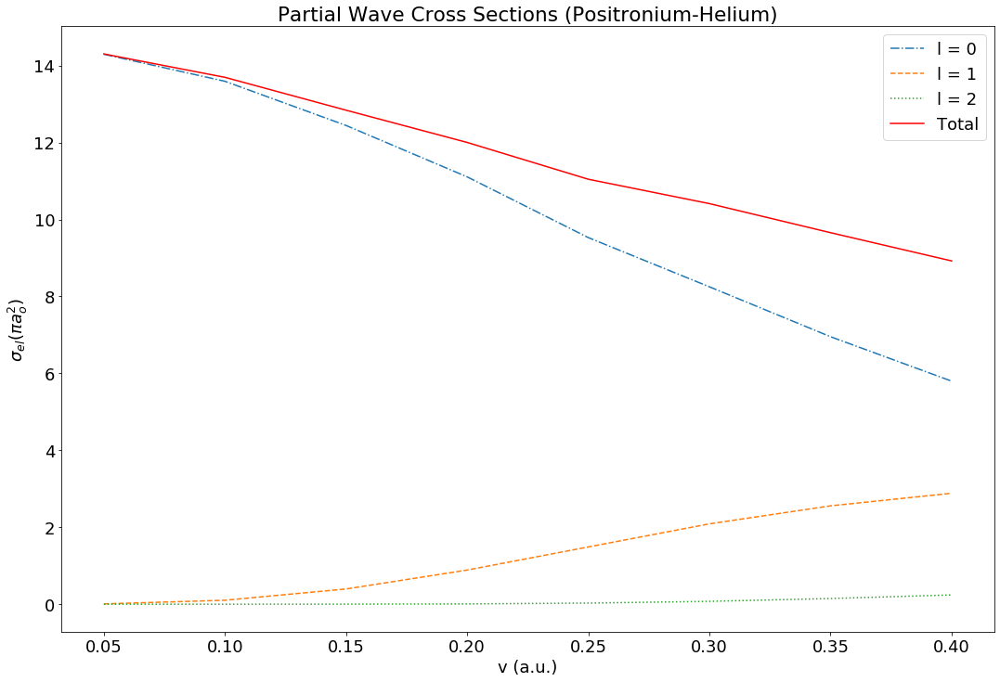

In [45]:
ps_hel_cross_data = ps_hel_system.plot_cross_section(data=True)


display(ps_hel_cross_data)
get_avg(ps_hel_cross_data, 'total cross section')
data_max(ps_hel_cross_data, 'total cross section')
data_min(ps_hel_cross_data, 'total cross section')

ps_hel_system.plot_cross_section(velocity=True)

The elastic cross section starts at the maximum and then decreases mostly linearly with increasing velocity. As the velocity increases, the contribution from the s wave decreases, while the contribution from the higher waves, especially the p wave, increases. At the highest velocity, the s, p, d waves contribute 65, 32.3, and 2.7 percent to the total elastic cross section, respectively.

,v,total momentum transfer,l = 0 contribution,l = 1 contribution
0,0.05,13.926,99.9633%,0.0367%
1,0.10,12.416,99.4683%,0.5317%
2,0.15,10.574,97.7028%,2.2972%
3,0.20,8.965,94.2987%,5.7013%
4,0.25,7.506,89.4322%,10.5678%
5,0.30,6.583,84.4234%,15.5766%
6,0.35,5.732,79.8973%,20.1027%
7,0.40,5.009,76.0305%,23.9695%


Average value for total momentum transfer : 8.839
Maximum value for total momentum transfer


,v,total momentum transfer,l = 0 contribution,l = 1 contribution
0,0.05,13.926,99.9633%,0.0367%


Minimum value for total momentum transfer


,v,total momentum transfer,l = 0 contribution,l = 1 contribution
7,0.4,5.009,76.0305%,23.9695%


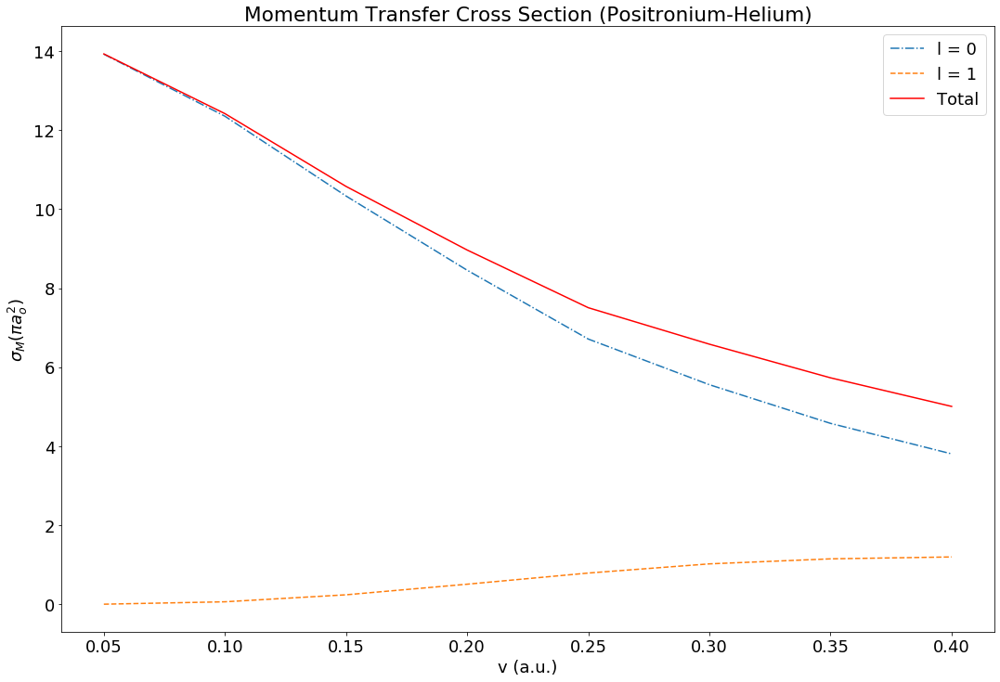

In [46]:
ps_hel_momentum_data = ps_hel_system.plot_momentum_transfer(data=True)


display(ps_hel_momentum_data)
get_avg(ps_hel_momentum_data, 'total momentum transfer')
data_max(ps_hel_momentum_data, 'total momentum transfer')
data_min(ps_hel_momentum_data, 'total momentum transfer')

ps_hel_system.plot_momentum_transfer(velocity=True)

The momentum transfer cross section starts close to the elastic cross section and is always lower than the elastic cross section. The difference between the elastic cross section and momentum transfer cross section increases with increasing velocity. The contributions from the waves to the momentum transfer cross section is similar to the elastic cross section.

In [47]:
ps_hel_cross_momentum = cross_momentum_compare(ps_hel_cross_data, ps_hel_momentum_data)


display(ps_hel_cross_momentum)
get_avg(ps_hel_cross_momentum, 'ratio momentum/cross')
data_max(ps_hel_cross_momentum, 'ratio momentum/cross')
data_min(ps_hel_cross_momentum, 'ratio momentum/cross')

,v,total cross section,total momentum transfer,ratio momentum/cross
0,0.05,14.303,13.926,0.974
1,0.10,13.695,12.416,0.907
2,0.15,12.841,10.574,0.823
3,0.20,12.003,8.965,0.747
4,0.25,11.046,7.506,0.680
5,0.30,10.413,6.583,0.632
6,0.35,9.657,5.732,0.594
7,0.40,8.923,5.009,0.561


Average value for ratio momentum/cross : 0.74
Maximum value for ratio momentum/cross


,v,total cross section,total momentum transfer,ratio momentum/cross
0,0.05,14.303,13.926,0.974


Minimum value for ratio momentum/cross


,v,total cross section,total momentum transfer,ratio momentum/cross
7,0.4,8.923,5.009,0.561


,v,0 degrees,90 degrees,180 degrees
0,0.05,3.865,3.573,3.299
1,0.10,4.466,3.384,2.541
2,0.15,5.242,3.056,1.796
3,0.20,6.062,2.659,1.324
4,0.25,6.793,2.202,1.035
5,0.30,7.477,1.850,0.907
6,0.35,7.902,1.536,0.773
7,0.40,8.127,1.292,0.631


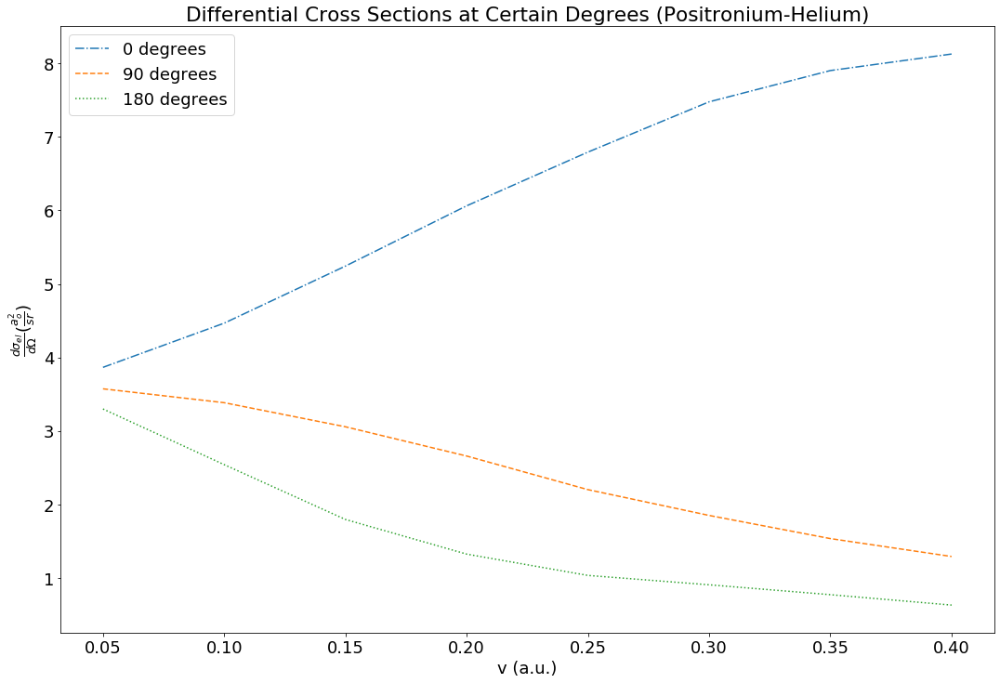

In [48]:
ps_hel_diff_degree =  ps_hel_system.plot_diff_cross_vs_k(r_interval,velocity=True, data=True)

display(ps_hel_diff_degree)

ps_hel_system.plot_diff_cross_vs_k(r_interval, velocity=True)

The differential cross section increases at 0 degrees with increasing energy. The curves of 90 and 180 degrees are very similar except the magnitude at 90 degrees being greater. 

,degrees,v = 0.05,v = 0.1,v = 0.15,v = 0.2,v = 0.25,v = 0.3,v = 0.35,v = 0.4
0,0,3.865,4.466,5.242,6.062,6.793,7.477,7.902,8.127
10,10,3.860,4.448,5.200,5.987,6.677,7.317,7.700,7.889
20,20,3.847,4.393,5.077,5.770,6.346,6.861,7.128,7.217
30,30,3.825,4.306,4.882,5.431,5.836,6.171,6.274,6.228
40,40,3.795,4.189,4.628,5.001,5.205,5.337,5.266,5.082
50,50,3.759,4.049,4.332,4.515,4.517,4.458,4.236,3.944
60,60,3.717,3.893,4.011,4.010,3.832,3.621,3.296,2.948
70,70,3.671,3.725,3.682,3.517,3.200,2.890,2.521,2.170
80,80,3.622,3.554,3.359,3.061,2.651,2.298,1.938,1.629
90,90,3.573,3.384,3.056,2.659,2.202,1.850,1.536,1.292


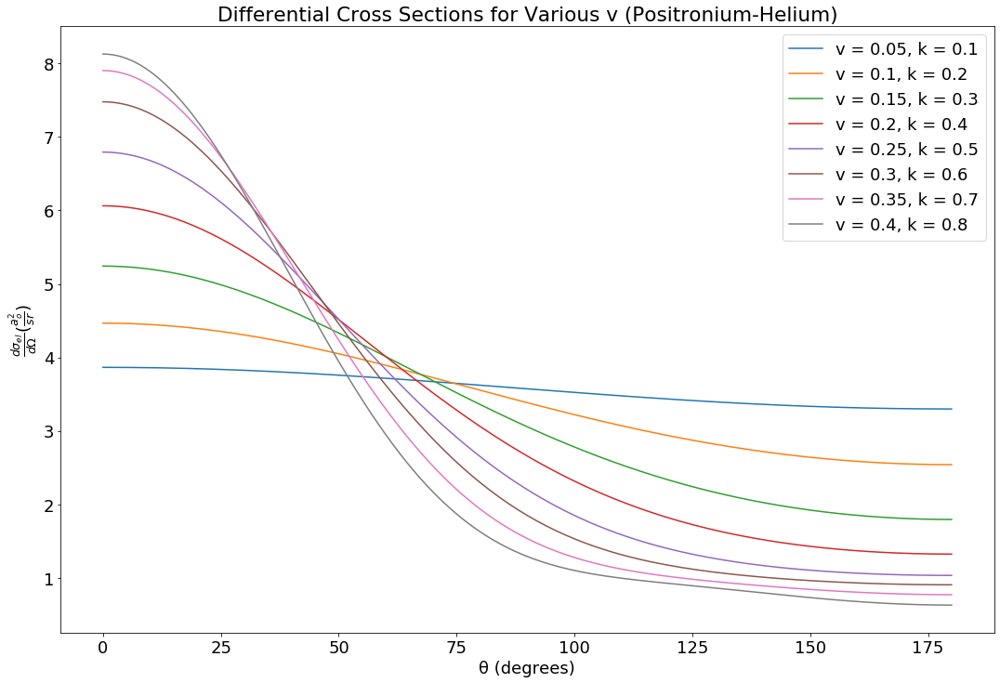

In [49]:
ps_hel_diff = ps_hel_system.diff_plot(velocity=True, data=True)
sliced = ps_hel_diff[ps_hel_diff.index % 10 == 0 ]
display(sliced)

ps_hel_system.diff_plot(velocity=True)

The greater the velocity the greater the drop in magnitude is for increasing degrees before flattening out. At the lowest energy, the curve is almost completely flat. At the highest velocity the curve falls very quickly before flattening out. 

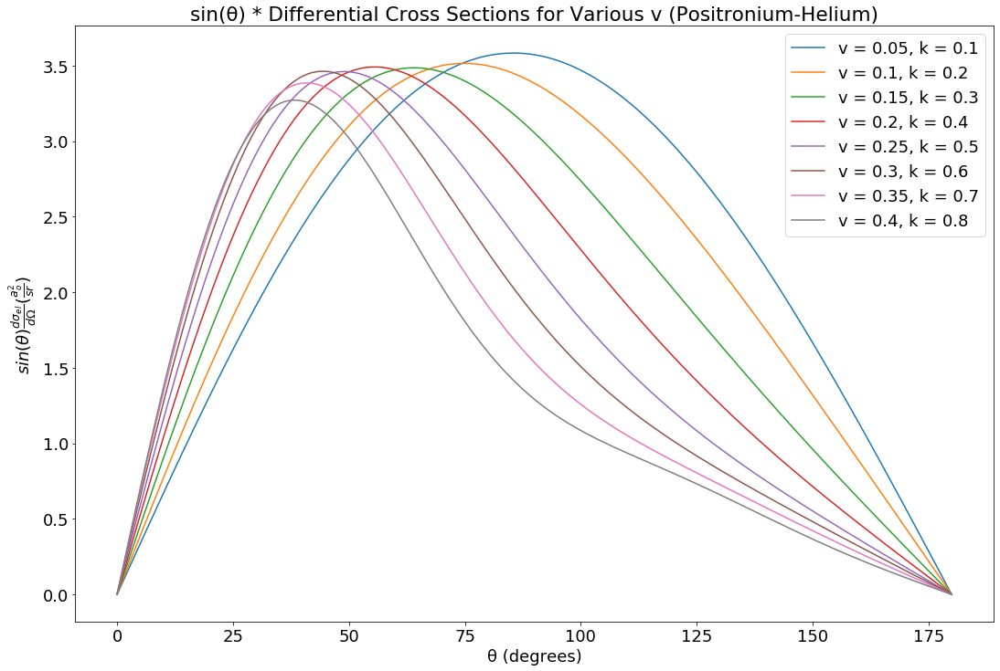

In [50]:
ps_hel_system.diff_plot(sin=True,velocity=True)

The lower the energy the more parabolic the curve is. At v = 0.05, the curve is nearly completely parabolic. As the energy increases, the curve becomes more distorted, having a noticeable dip in the curve at v = 0.4. 

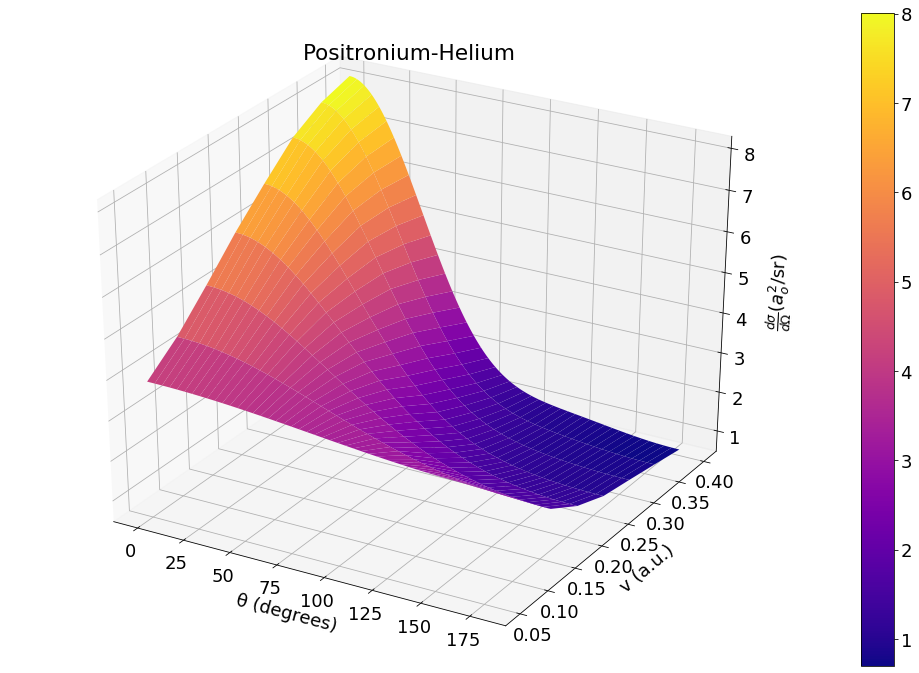

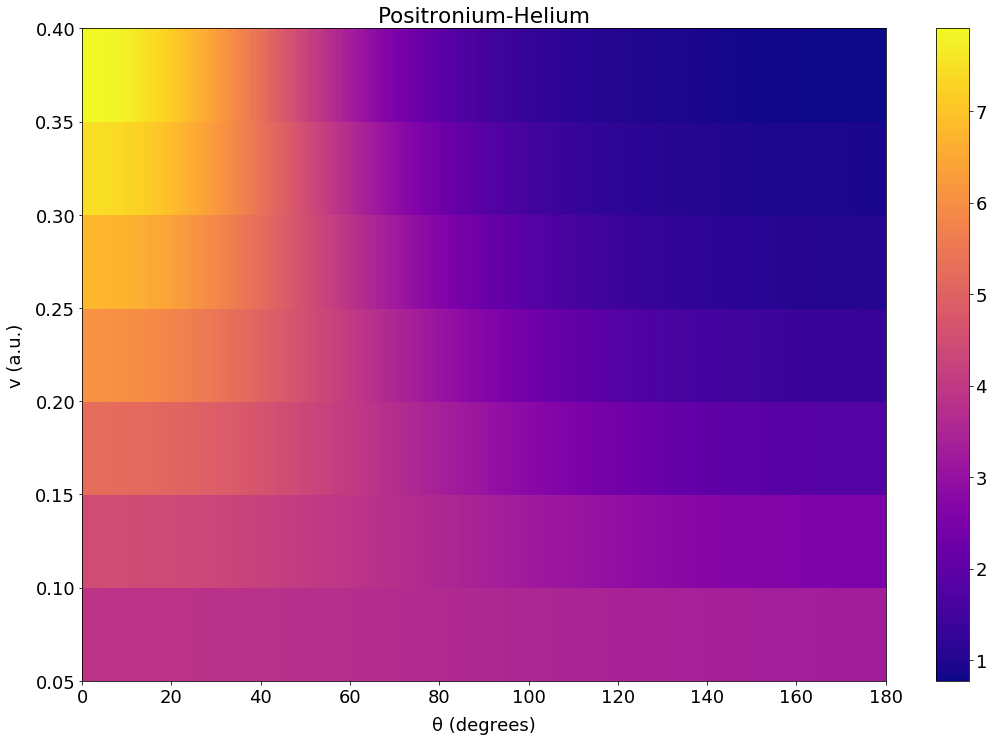

In [51]:
ps_hel_system.diff_plot_3d(velocity=True)
ps_hel_system.diff_plot_3d(density=True,velocity=True)

Between 0 and 40 degrees the differential cross section increases with increasing velocity. At v =< 0.15 the magnitude gradually decreases with increasing degrees. At higher energy, the magnitude decreases more with increasing degrees. The peak is at 0 degrees and the highest velocity. The minimum is at the highest velocity and 180 degrees.  

#  Comparing Systems

## Electron-Helium vs Positronium-Helium

Electron-Helium phase shifts from both R K Nesbet 1979 [5]; A. L. Sinfailam and R K Nesbet 1972 [4]. Positronium-Helium phase shifts are from Nirmal K Sarkar et al 1999 [8].

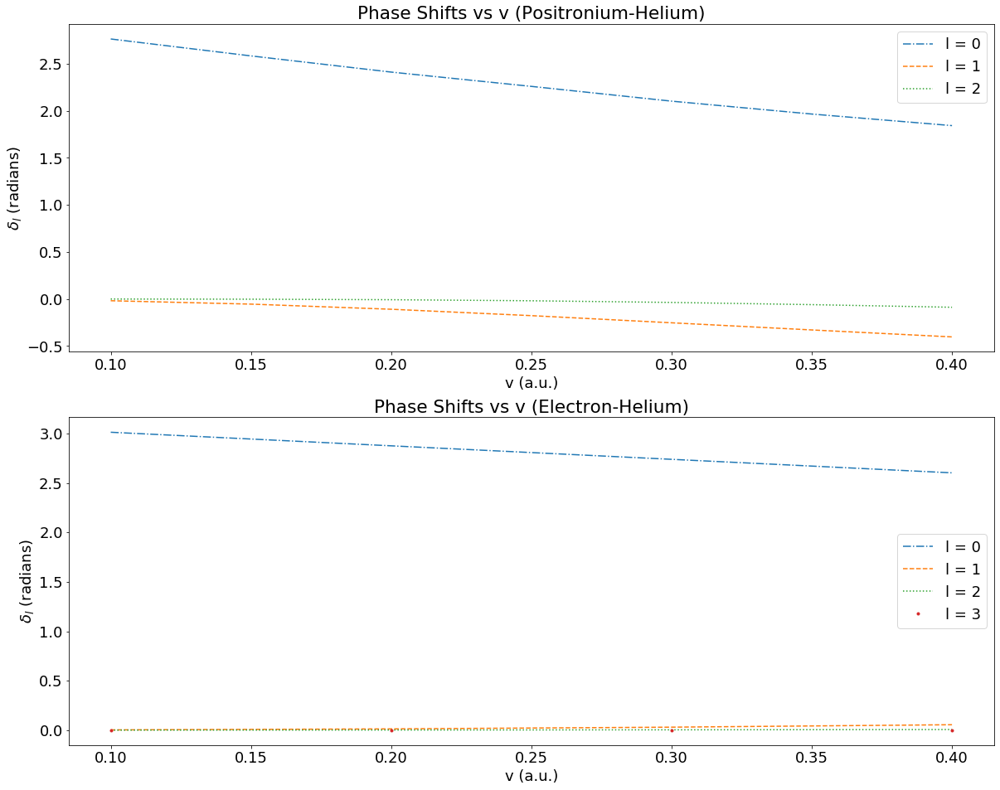

In [52]:
e_ps_hel_system = collision(ps_hel_phases,k_list_ps_hel,'Positronium-Helium',2,e_hel_phases,k_list_e_hel,'Electron-Helium',1)

e_ps_hel_system.plot_phase_shifts(velocity=True,compare=True)

The phaseshifts for the electron-helium and positronium-helium systems are very similar. However, the p wave phase shifts for positronium-helium start to become inreasingly negative with increasing energy. While the magnitude of the s wave phase shifts decreases with increasing energy in both systems, the decrease is greater in the positronium-helium system.

,v,e-he elastic cross section,ps-he elastic cross section,ratio of elastic cross section e-he/ps-he,e-he momentum transfer cross section,ps-he momentum transfer cross section,ratio of momentum transfer cross section e-he/ps-he
0,0.1,6.549,13.695,0.478,6.861,12.416,0.553
1,0.2,6.938,12.003,0.578,7.589,8.965,0.847
2,0.3,6.935,10.413,0.666,7.880,6.583,1.197
3,0.4,6.816,8.923,0.764,7.951,5.009,1.587


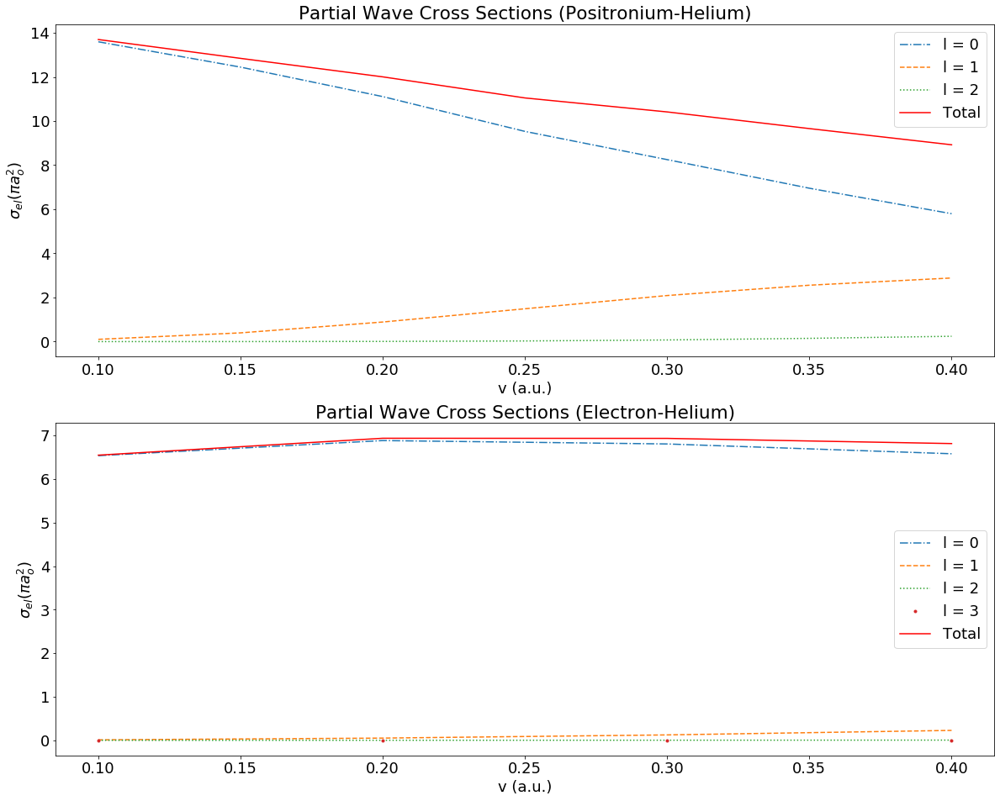

In [53]:
e_hel_ps_compare = compare_stuff(e_hel_cross_data, ps_hel_cross_data, e_hel_momentum_data, ps_hel_momentum_data, 'e-he', 'ps-he')
display(e_hel_ps_compare)

e_ps_hel_system.plot_cross_section(velocity=True,compare=True)

The elastic cross section of the two systems become more similar with increasing energy. The elastic cross section of electron-helium is 48% and 76% that of positronium-helium at v = 0.1 au and v = 0.4 au, respectively. These are very similar compared to positron-helium vs positronium-helium, where the elastic cross section of positron-helium is not even 2% of positronium-helium’s. Since the elastic cross section of electron-helium is hardly changing with increasing energy, and there is a decrease in th¬¬e magnitude for positronium-helium, this suggest that, within this energy range, the behavior of positronium approaches that of the electron. Therefore, this suggest the importance of the positron in positronium lessens with increasing energy, within this energy range. The s wave is the greatest contributor to the elastic cross section in both systems; however, while at a minimum it contributes 96% to the elastic cross section of the electron-helium system, the p wave gradually increases in influence for the positronium-helium system, finishing with a contribution of 32% for the highest velocity. 

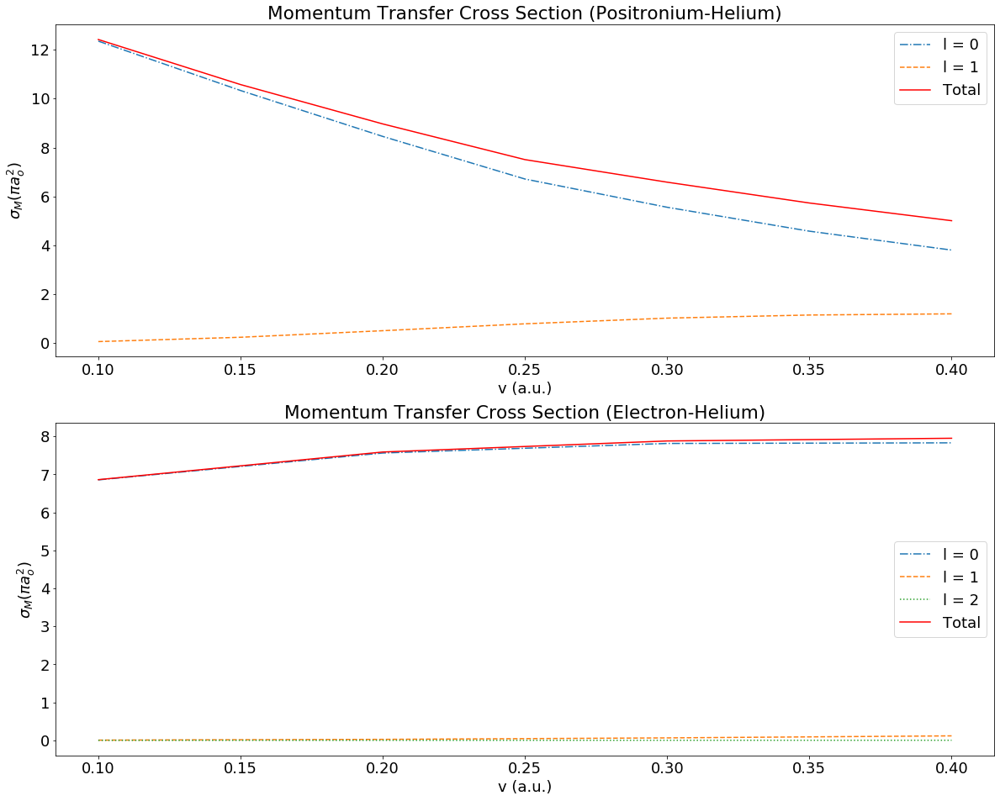

In [54]:
e_ps_hel_system.plot_momentum_transfer(velocity=True,compare=True)

The shape of the momentum transfer cross section is similar to the elastic cross section, except that the decline is greater for positronium-helium, which causes the momentum transfer cross section for electron-helium to be greater than that of positronium-helium at v = 0.3 au. At the highest comparable velocity, it is 1.59 times greater. It is worth noting here that positronium-helium gets a larger contribution out of the higher waves, and the used dataset of positronium-helium is one wave less than that of electron-helium. Therefore, there could be a modest contribution to the momentum transfer cross section of positronium-helium from the d wave that is missing here.

,v,e-he 0 degrees,ps-he 0 degrees,ratio e-he/ps-he at 0 degrees,e-he 90 degrees,ps-he 90 degrees,ratio e-he/ps-he at 90 degrees,e-he 180 degrees,ps-he 180 degrees,ratio e-he/ps-he at 180 degrees
0,0.1,1.340,4.466,0.300,1.660,3.384,0.491,1.849,2.541,0.728
1,0.2,1.153,6.062,0.190,1.775,2.659,0.668,2.164,1.324,1.634
2,0.3,0.944,7.477,0.126,1.777,1.850,0.961,2.373,0.907,2.616
3,0.4,0.811,8.127,0.100,1.738,1.292,1.345,2.502,0.631,3.965


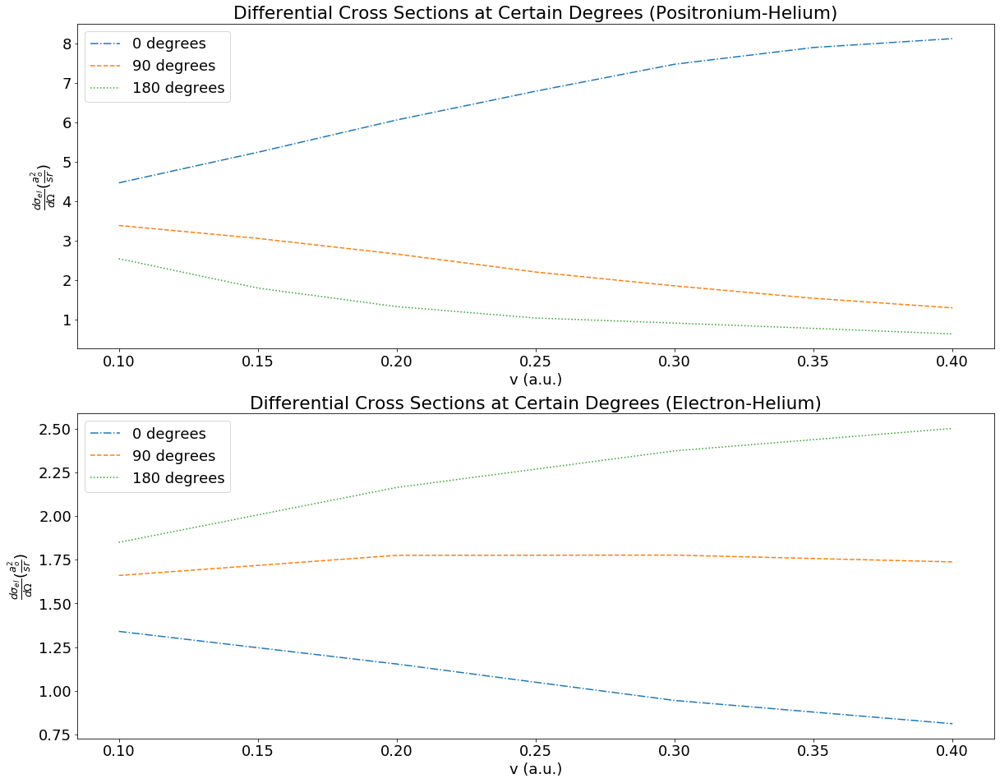

In [55]:
e_hel_ps_compare_degreee = compare_at_degree(e_hel_diff_degree, ps_hel_diff_degree, 'e-he', 'ps-he')
display(e_hel_ps_compare_degreee)

e_ps_hel_system.plot_diff_cross_vs_k(r_interval,velocity=True,compare=True)

At 90 degrees the magnitude between the two systems becomes increasing comparable with increasing velocity. The change in magnitude of differential cross section as a function of velocity at 180 degrees of one system is incredibly similar to the other’s at 0 degrees. For example, when comparing the change in magnitude of electron-helium at 180 degrees and positronium-helium at 0 degrees, it is seen that the magnitude of electron-helium drops to 95% of its maximum and positronium drops to 92% of its maximum. This similarity is maintained for other velocities.

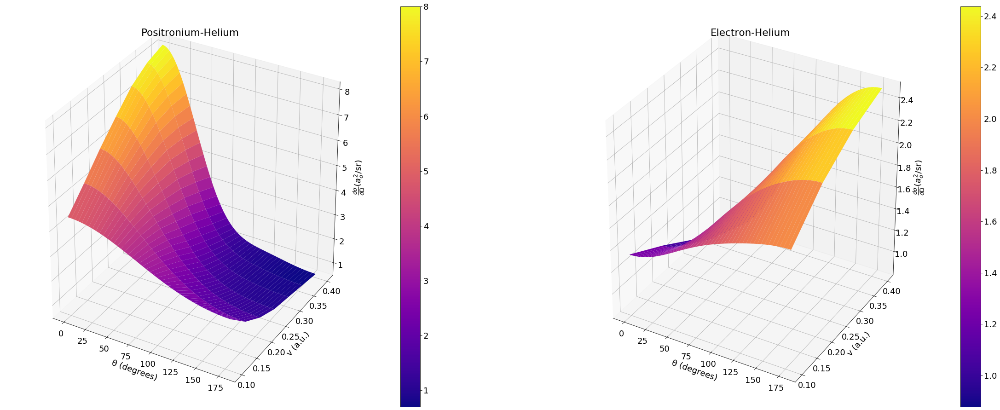

In [56]:
e_ps_hel_system.diff_plot_3d(velocity=True,compare=True)

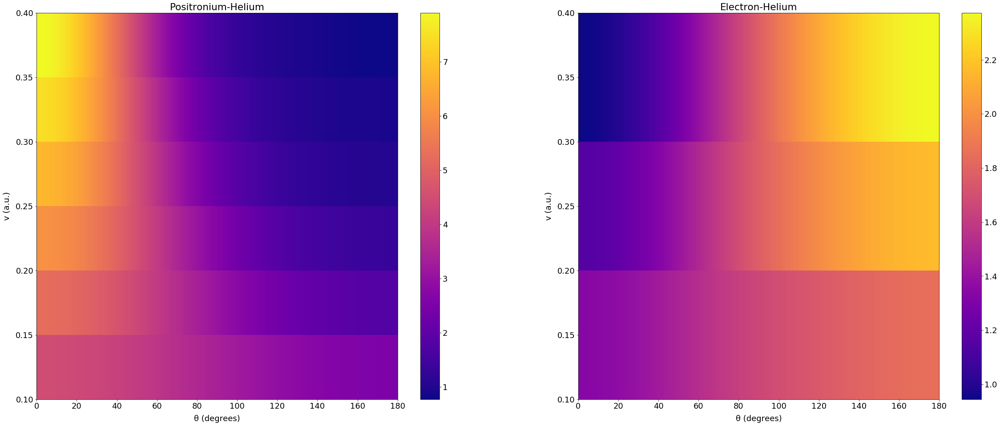

In [57]:
e_ps_hel_system.diff_plot_3d(velocity=True,compare=True, density=True)

The differential cross section generally rises in one system where the other falls. Though, the magnitude for positronium-helium is generally greater than electron-helium.

## Electron-Helium vs Positron-Helium

Electron-Helium phase shifts from both R K Nesbet 1979 [5]; A. L. Sinfailam and R K Nesbet 1972 [4]. Phase shifts for positron-helium provided by P Van Reeth, Private Communication 2020 [13].

In [58]:
e_positron_hel_system = collision(pos_hel_vr_phases,k_vr_pos_hel,'Positron-Helium',1,e_hel_phases,k_list_e_hel,'Electron-Helium',1)

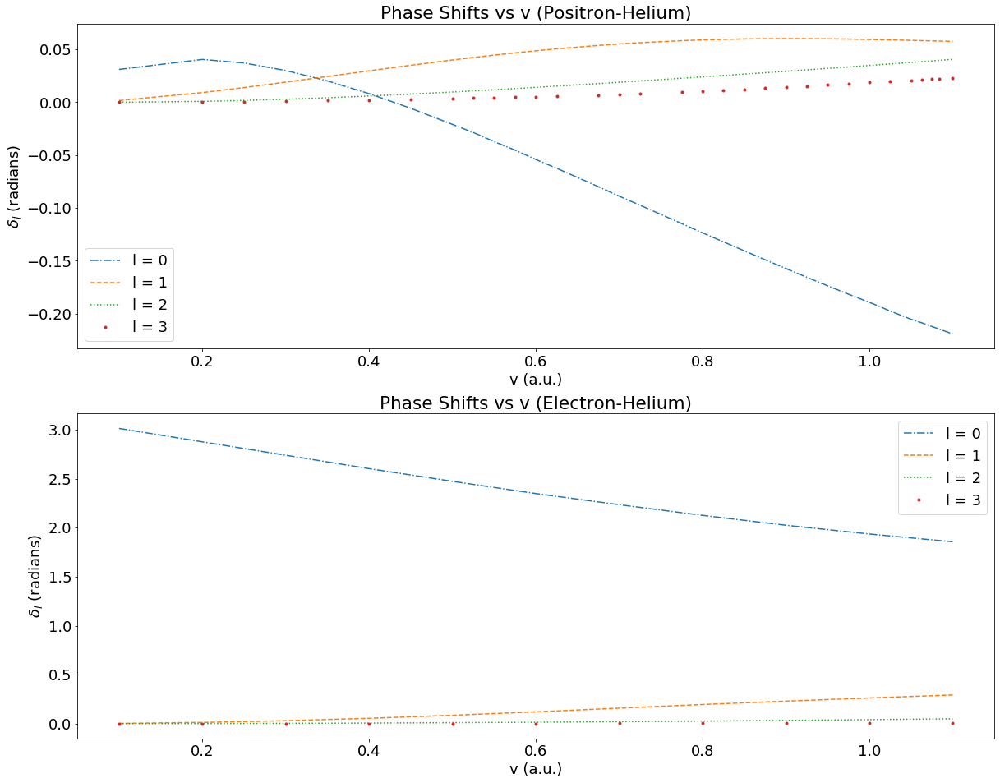

In [59]:
e_positron_hel_system.plot_phase_shifts(velocity=True,compare=True)

The only resemblance the phaseshifts of these two systems is that the waves higher than the s wave are close to zero. The s wave for the positron system rapidly declines into negative values, but is still fairly small in magnitude compare to the s wave of the electron system. The s wave phaseshifts for the electron system linearly declines gradually with increasing energy.

,v,e-he elastic cross section,e(+)-he elastic cross section,ratio of elastic cross section e-he/e(+)-he,e-he momentum transfer cross section,e(+)-he momentum transfer cross section,ratio of momentum transfer cross section e-he/e(+)-he
0,0.1,6.549,0.388,16.879,6.861,0.348,19.716
1,0.2,6.938,0.189,36.709,7.589,0.112,67.759
2,0.3,6.935,0.090,77.056,7.880,0.029,271.724
3,0.4,6.816,0.073,93.370,7.951,0.041,193.927
4,0.5,6.509,0.092,70.750,7.693,0.090,85.478
5,0.6,6.138,0.124,49.500,7.222,0.146,49.466
6,0.7,5.692,0.156,36.487,6.569,0.193,34.036
7,0.8,5.247,0.183,28.672,5.842,0.225,25.964
8,0.9,4.789,0.203,23.591,5.084,0.243,20.922
9,1.0,4.335,0.218,19.885,4.357,0.250,17.428


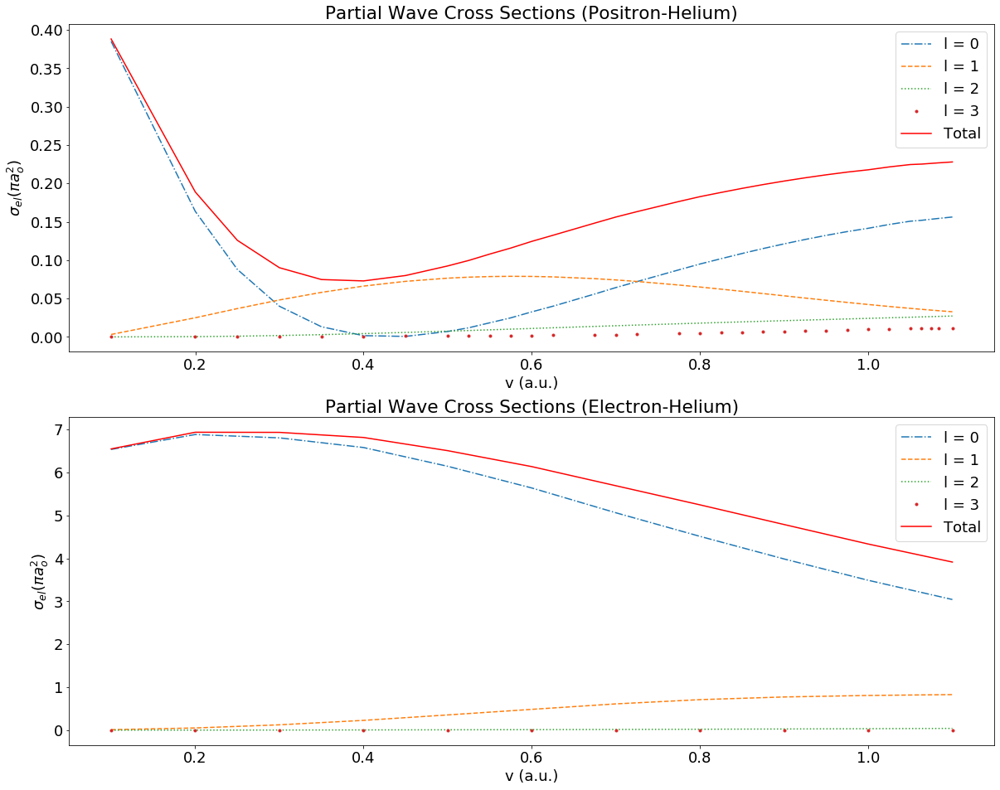

In [60]:
e_hel_pos_compare = compare_stuff(e_hel_cross_data, pos_hel_cross_data, e_hel_momentum_data, pos_hel_momentum_data, 'e-he', 'e(+)-he')
display(e_hel_pos_compare)

e_positron_hel_system.plot_cross_section(velocity=True,compare=True)

The total elastic cross section of electron-helium stays around the same value before gradually decreasing with increasing energy, while for positron-helium it rapidly decreases at the beginning, before gradually increasing. This shift in slope for both systems occurs at v = 0.4 au. The magnitude of the elastic cross section of electron-helium is between 17-93 times greater than positron-helium. At the lowest and at the highest velocity, the ratio of elastic cross sections is around 17. In the electron-helium system the contribution of the s wave gradually decreases with increasing energy, and the p wave contribution mostly rises by the same amount. At the highest comparable velocity, the contribution from the s and p wave are 78% and 21%, respectively. The s wave contribution in the positron-helium system rapidly decreases; at v = 0.45 the contribution from the s, p, d and f wave are 0.8%, 90.5%, 7.3%, and 1.4%, respectively. The contribution from the s wave then increases, p wave decreases, and the d and f wave slowly increase with increasing velocity. 

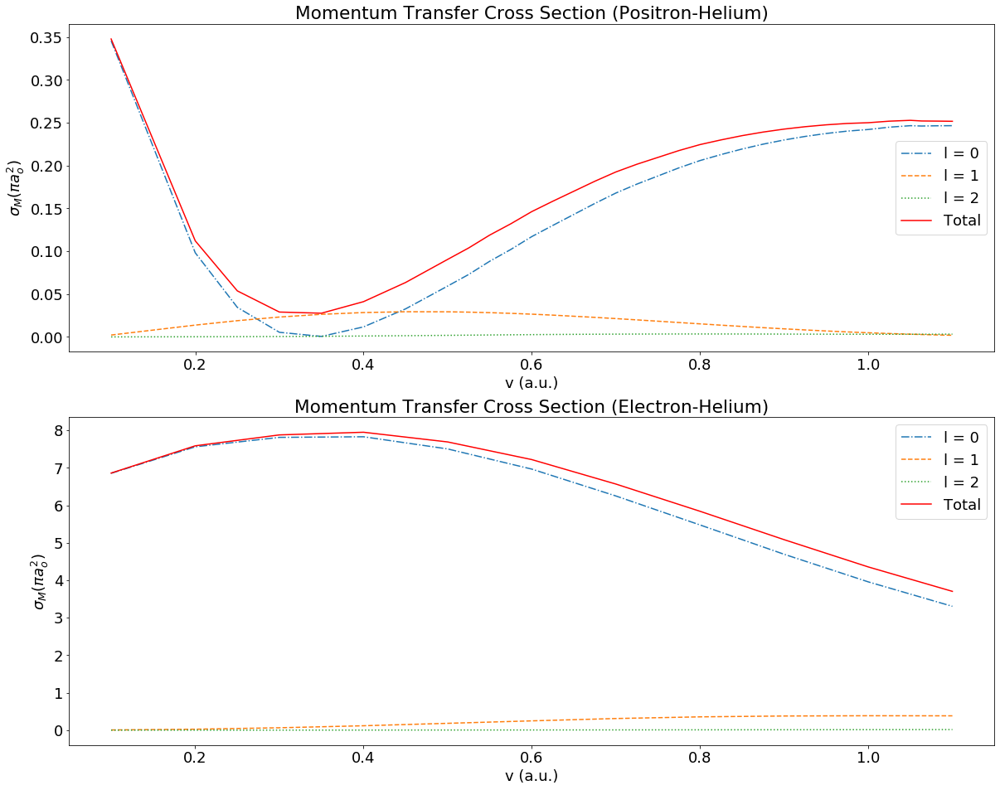

In [61]:
e_positron_hel_system.plot_momentum_transfer(velocity=True, compare=True)

The momentum transfer cross section ratio is similar to the elastic cross section ratio, except that the maximum difference is greater. At v = 0.3 au the momentum transfer cross section is 271 times greater for electron-helium compared to positron-helium. However, at v = 1.1 au the ratio is actually smaller than that of the elastic cross section, having a value of 14.7.

C:\Users\Zoruku\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: divide by zero encountered in double_scalars
  


,v,e-he 0 degrees,e(+)-he 0 degrees,ratio e-he/e(+)-he at 0 degrees,e-he 90 degrees,e(+)-he 90 degrees,ratio e-he/e(+)-he at 90 degrees,e-he 180 degrees,e(+)-he 180 degrees,ratio e-he/e(+)-he at 180 degrees
0,0.1,1.340,0.129,10.388,1.660,0.097,17.113,1.849,0.067,27.597
1,0.2,1.153,0.131,8.802,1.775,0.037,47.973,2.164,0.007,309.143
2,0.3,0.944,0.130,7.262,1.777,0.006,296.167,2.373,0.004,593.250
3,0.4,0.811,0.125,6.488,1.738,0.000,inf,2.502,0.028,89.357
4,0.5,0.773,0.118,6.551,1.639,0.008,204.875,2.496,0.055,45.382
5,0.6,0.855,0.109,7.844,1.516,0.022,68.909,2.382,0.076,31.342
6,0.7,1.016,0.102,9.961,1.369,0.038,36.026,2.172,0.091,23.868
7,0.8,1.230,0.097,12.680,1.224,0.052,23.538,1.903,0.099,19.222
8,0.9,1.445,0.094,15.372,1.081,0.065,16.631,1.609,0.104,15.471
9,1.0,1.635,0.092,17.772,0.945,0.075,12.600,1.329,0.103,12.903


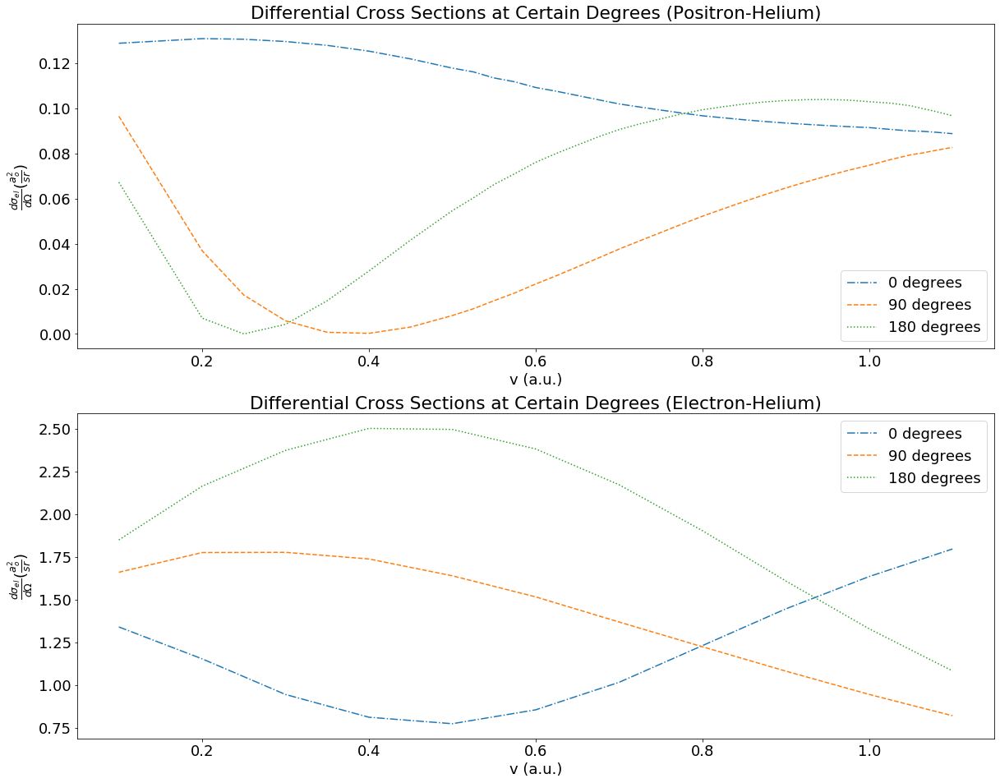

In [62]:
e_hel_pos_compare_degree = compare_at_degree(e_hel_diff_degree, pos_hel_diff_degree, 'e-he', 'e(+)-he')
display(e_hel_pos_compare_degree)

e_positron_hel_system.plot_diff_cross_vs_k(r_interval,velocity=True,compare=True)

The only visible similarity here is that the differential cross section has a similar shape at 0 degrees in the electron system as at 90 degrees in the positron system. Overall, the magnitude is greater for the electron-helium system.

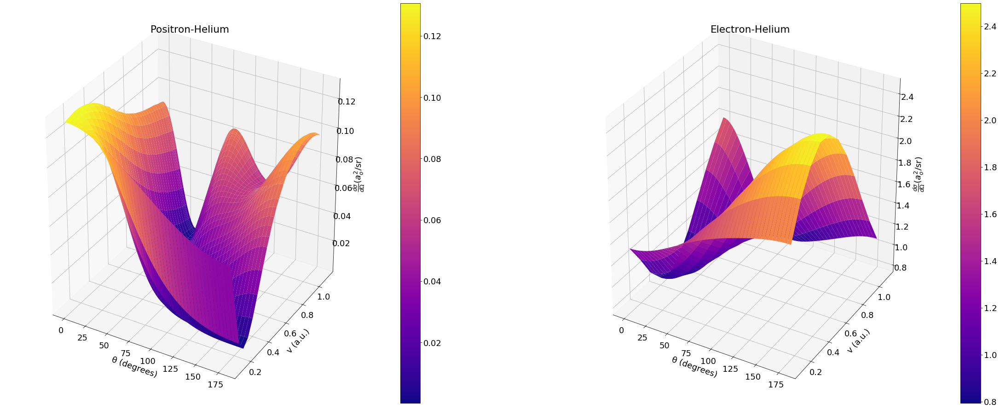

In [63]:
e_positron_hel_system.diff_plot_3d(velocity=True,compare=True)

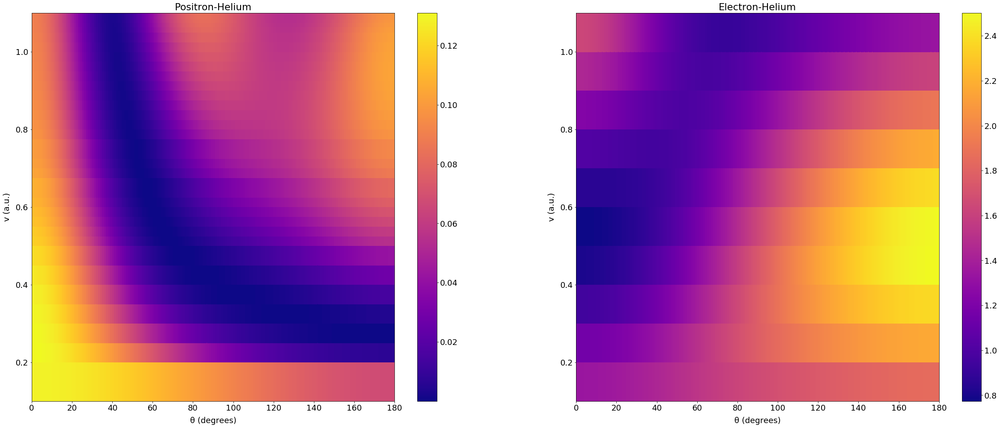

In [64]:
e_positron_hel_system.diff_plot_3d(velocity=True,compare=True,density=True)

The only noticeable similarity of the differential cross section in the above graphs is that they both have a valley, though this valley is at different values. The positron-helium system peaks at the lowest energy and 0 degrees. The electron-helium system peaks at a more moderate energy at 180 degrees. 

## Positron-Helium vs Positronium-Helium

Phase shifts for positronium-helium  are from Nirmal K Sarkar et al 1999 [8]. Phase shifts for positron-helium provided by P Van Reeth, Private Communication 2020 [13].

In [65]:
pos_ps_hel_system = collision(ps_hel_phases,k_list_ps_hel,'Positronium-Helium',2,pos_hel_vr_phases,k_vr_pos_hel,'Positron-Helium',1)

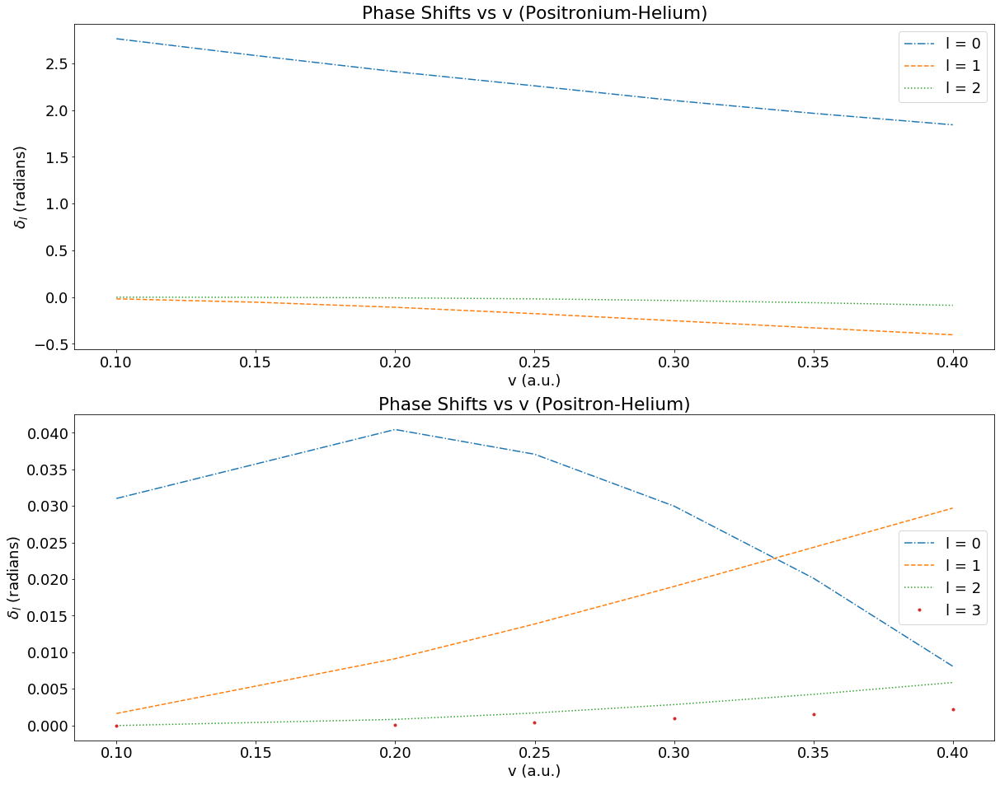

In [66]:
pos_ps_hel_system.plot_phase_shifts(velocity=True,compare=True)

There are no noticeable similarities in the phaseshifts between these two systems.

,v,e(+)-he elastic cross section,ps-he elastic cross section,ratio of elastic cross section e(+)-he/ps-he,e(+)-he momentum transfer cross section,ps-he momentum transfer cross section,ratio of momentum transfer cross section e(+)-he/ps-he
0,0.10,0.388,13.695,0.028,0.348,12.416,0.028
1,0.20,0.189,12.003,0.016,0.112,8.965,0.012
2,0.25,0.126,11.046,0.011,0.054,7.506,0.007
3,0.30,0.090,10.413,0.009,0.029,6.583,0.004
4,0.35,0.075,9.657,0.008,0.028,5.732,0.005
5,0.40,0.073,8.923,0.008,0.041,5.009,0.008


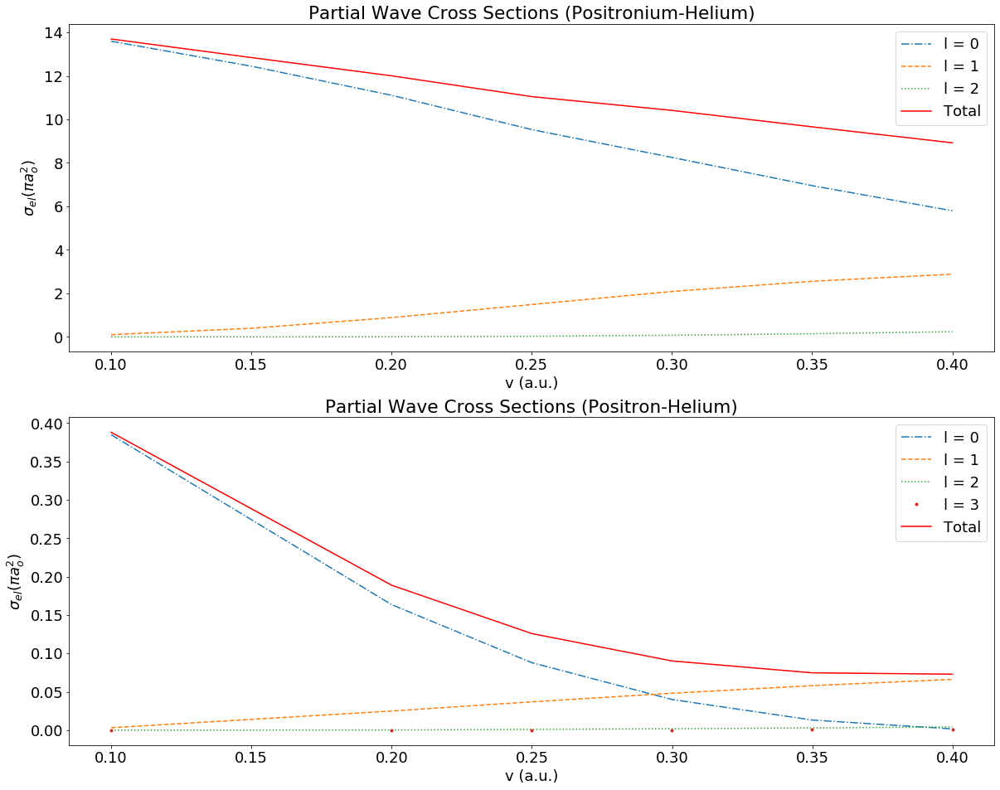

In [67]:
pos_hel_ps_compare = compare_stuff(pos_hel_cross_data, ps_hel_cross_data, pos_hel_momentum_data, ps_hel_momentum_data, 'e(+)-he', 'ps-he')
display(pos_hel_ps_compare)

pos_ps_hel_system.plot_cross_section(velocity=True,compare=True)

Both the shape and magnitude of the elastic cross section for the two systems is not comparable. The magnitude of the elastic cross section for positron-helium is less than 2% that of positronium-helium for all comparable velocities. For the comparable velocities, the s wave contribution decreases with increasing energy in both systems. However, the extent of decrease is different; the p wave contributes 90.7% of the elastic cross section at the highest comparable velocity in the positron-helium system, but the majority contributor of the elastic cross section in the positronium-helium system is still the s wave. 

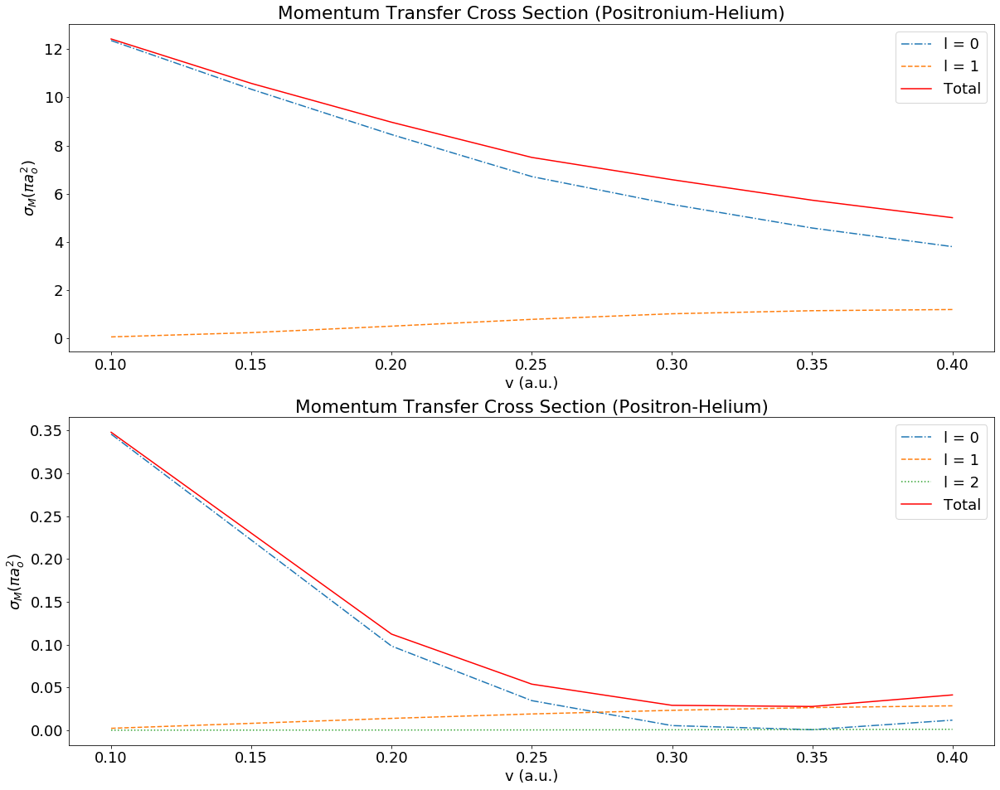

In [68]:
pos_ps_hel_system.plot_momentum_transfer(velocity=True,compare=True)

The difference in magnitude of the momentum transfer cross section is roughly the same as the elastic cross section and is not similar between the two systems.

,v,e(+)-he 0 degrees,ps-he 0 degrees,ratio e(+)-he/ps-he at 0 degrees,e(+)-he 90 degrees,ps-he 90 degrees,ratio e(+)-he/ps-he at 90 degrees,e(+)-he 180 degrees,ps-he 180 degrees,ratio e(+)-he/ps-he at 180 degrees
0,0.10,0.129,4.466,0.029,0.097,3.384,0.029,0.067,2.541,0.026
1,0.20,0.131,6.062,0.022,0.037,2.659,0.014,0.007,1.324,0.005
2,0.25,0.131,6.793,0.019,0.017,2.202,0.008,0.000,1.035,0.000
3,0.30,0.130,7.477,0.017,0.006,1.850,0.003,0.004,0.907,0.004
4,0.35,0.128,7.902,0.016,0.001,1.536,0.001,0.015,0.773,0.019
5,0.40,0.125,8.127,0.015,0.000,1.292,0.000,0.028,0.631,0.044


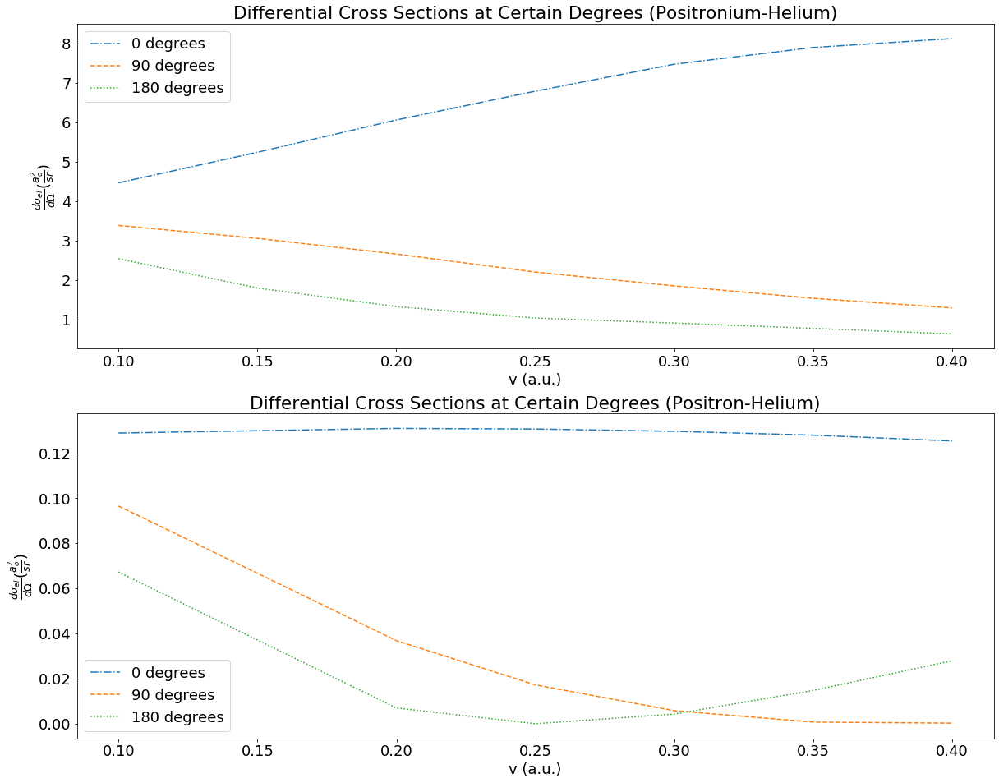

In [69]:
pos_hel_ps_compare_degree = compare_at_degree(pos_hel_diff_degree, ps_hel_diff_degree, 'e(+)-he', 'ps-he')
display(pos_hel_ps_compare_degree)

pos_ps_hel_system.plot_diff_cross_vs_k(r_interval,velocity=True,compare=True)

At 0 degrees the differential cross section of the positronium system increases with increasing energy while it stays mostly flat in the positron system. At 90 and 180 degrees the differential cross section decreases with increasing energy except at v = 0.30 in the positron system where at 180 degrees it begins to increase.

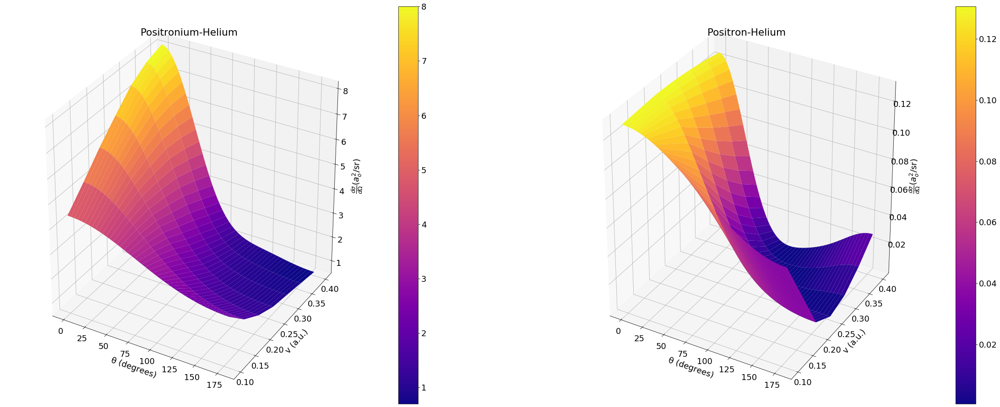

In [70]:
pos_ps_hel_system.diff_plot_3d(velocity=True,compare=True)


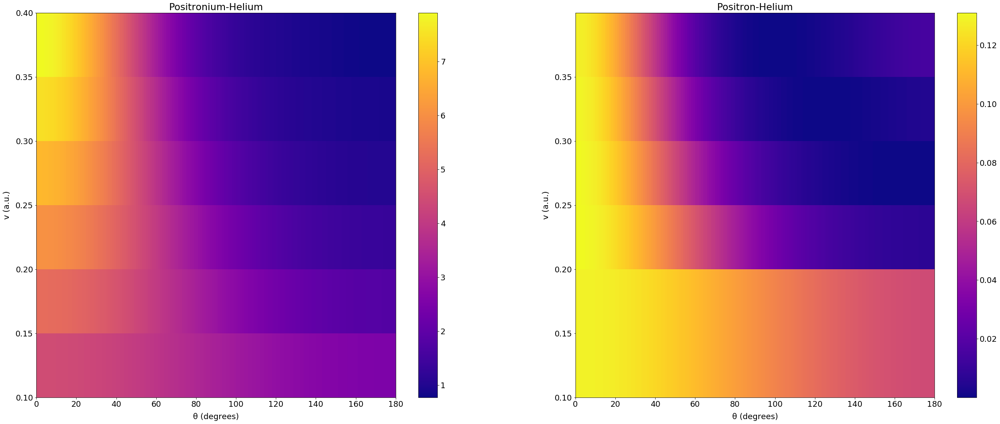

In [71]:
pos_ps_hel_system.diff_plot_3d(velocity=True,compare=True,density=True)

Beyond v = 0.2, the shape of the differential cross section is very similar, though the magnitude for positronium-helium is far greater.

## Positron-Helium vs Positron-Hydrogen

Phase shifts for positron-helium provided by P Van Reeth, Private Communication 2020 [13].Positron-Hydrogen phase shifts from  P Van Reeth, private communication 2020 [12]

In [72]:
positron_hyd_hel_system = collision(positron_hyd_vr_hybrid,k_vr_higher,'Positron-Hydrogen, Hybrid All',1,pos_hel_vr_phases,k_vr_pos_hel,'Positron-Helium',1)


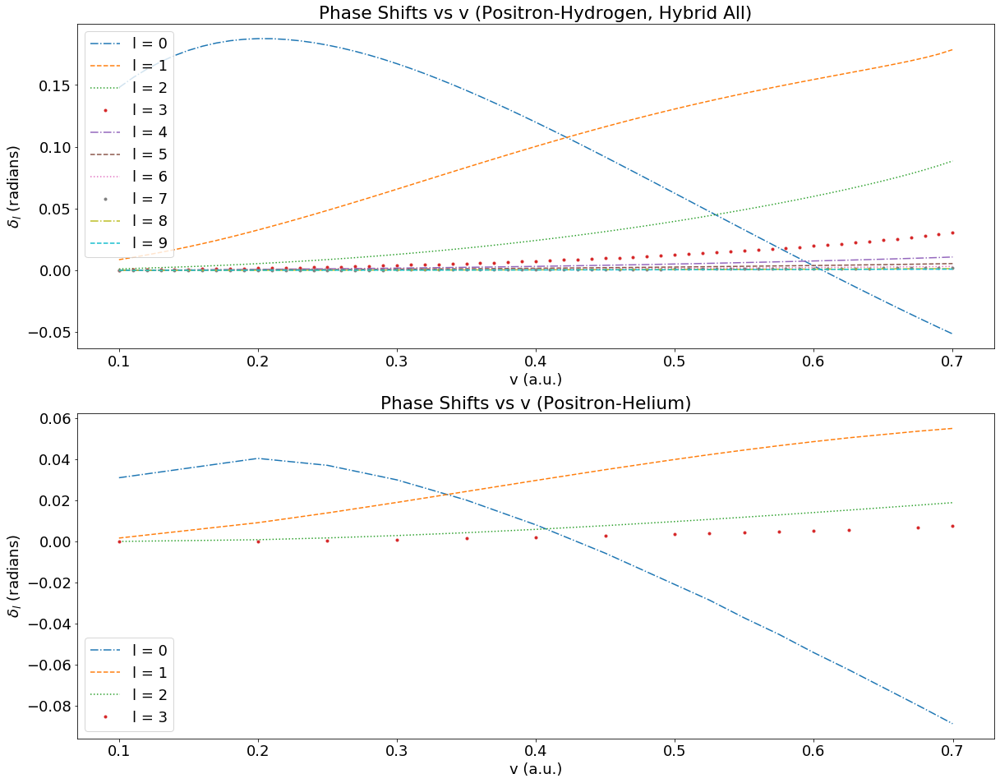

In [73]:
positron_hyd_hel_system.plot_phase_shifts(velocity=True,compare=True)

The p and d phaseshifts of the positron-hydrogen system diverge from zero much more so than in the positron-helium system. 

,v,e(+)-h elastic cross section,e(+)-he elastic cross section,ratio of elastic cross section e(+)-h/e(+)-he,e(+)-h momentum transfer cross section,e(+)-he momentum transfer cross section,ratio of momentum transfer cross section e(+)-h/e(+)-he
0,0.10,8.779,0.388,22.626,7.757,0.348,22.290
1,0.20,3.812,0.189,20.169,2.532,0.112,22.607
2,0.25,2.584,0.126,20.508,1.349,0.054,24.981
3,0.30,1.850,0.090,20.556,0.716,0.029,24.690
4,0.35,1.427,0.075,19.027,0.421,0.028,15.036
5,0.40,1.196,0.073,16.384,0.322,0.041,7.854
6,0.45,1.077,0.080,13.462,0.326,0.064,5.094
7,0.50,1.025,0.092,11.141,0.378,0.090,4.200
8,0.55,1.012,0.108,9.370,0.444,0.119,3.731
9,0.60,1.027,0.124,8.282,0.510,0.146,3.493


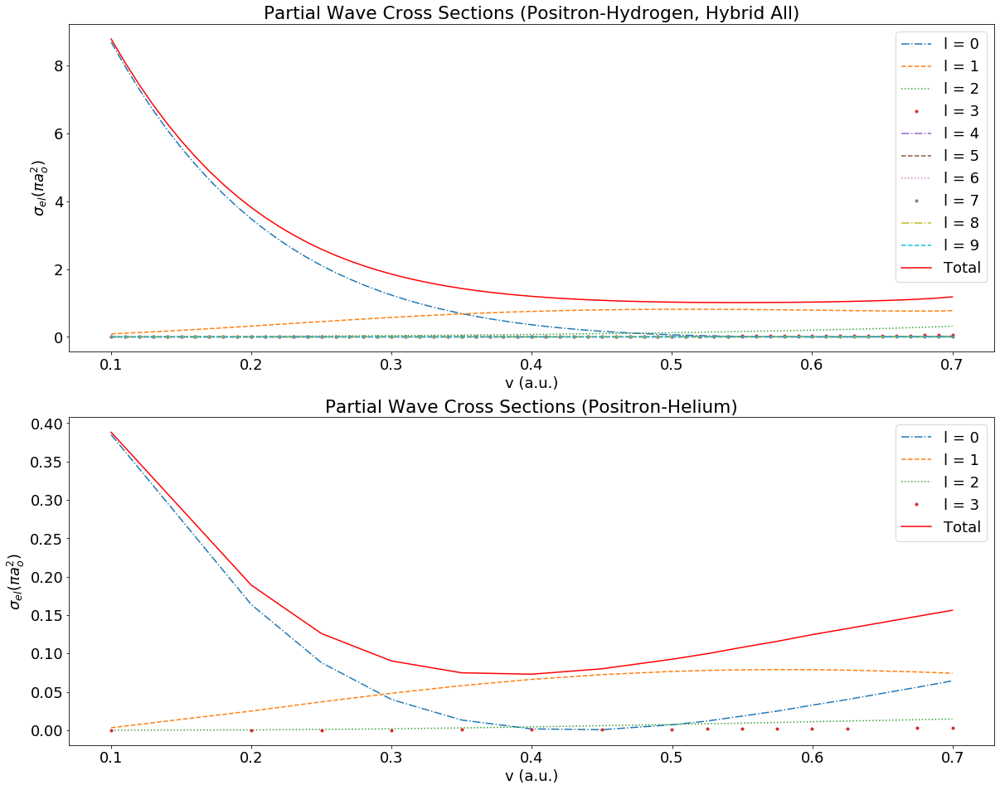

In [74]:
pos_hyd_pos_hel_compare = compare_stuff(pos_hyd_cross_data, pos_hel_cross_data, pos_hyd_momentum_data, pos_hel_momentum_data, 'e(+)-h', 'e(+)-he')
display(pos_hyd_pos_hel_compare)

positron_hyd_hel_system.plot_cross_section(velocity=True,compare=True)

The shape of the elastic cross section is very similar for the systems up to v = 0.4. Here it begins increasing for positron-helium but stays mostly flat for positron-hydrogen. Regarding the magnitude, positron-hydrogen is anywhere between 7-23 times greater than positron-helium. The s wave is the greatest contributor for low velocity in both systems before it is overtaken by the p wave. The p wave then remains the greatest contributor in both systems. In the positron-hydrogen system the s wave continues to decrease to nearly 0. In the positron-helium system the s wave only contributes slightly less than the p wave at the highest comparable velocity. 

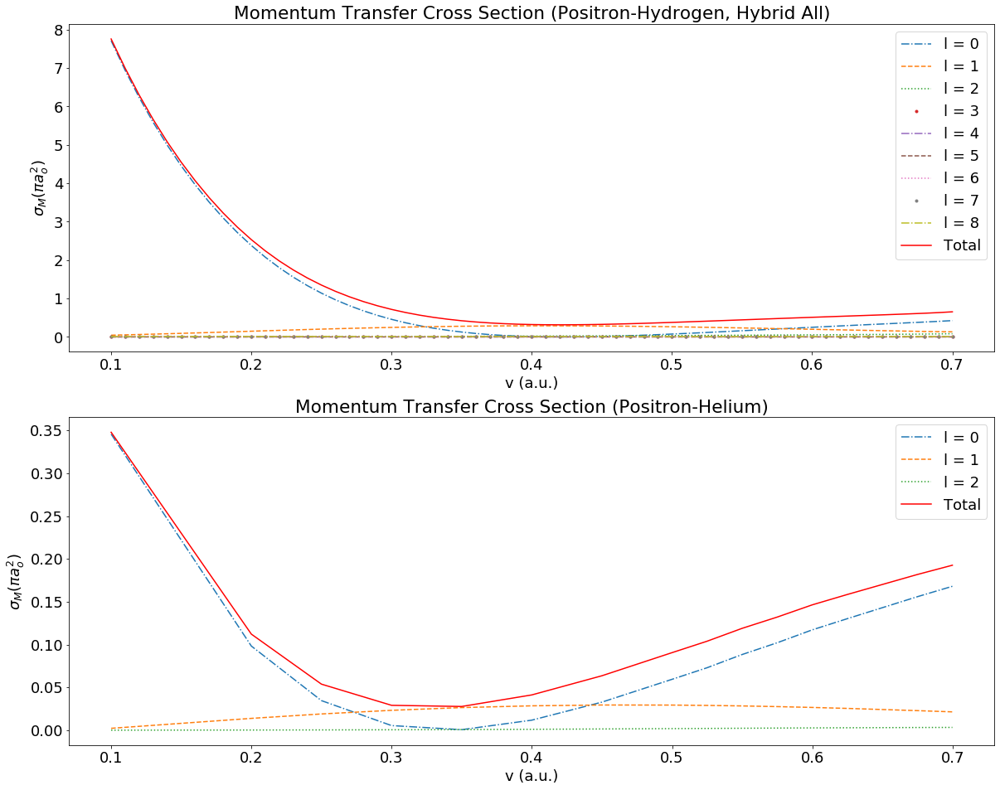

In [75]:
positron_hyd_hel_system.plot_momentum_transfer(velocity=True,compare=True)

For the momentum transfer cross section, the s wave contributes the most for most velocities in both systems, briefly being overtaken by the p wave in mid-range velocities. 

C:\Users\Zoruku\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: divide by zero encountered in double_scalars
  
C:\Users\Zoruku\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: divide by zero encountered in double_scalars
  if __name__ == '__main__':


,v,e(+)-h 0 degrees,e(+)-he 0 degrees,ratio e(+)-h/e(+)-he at 0 degrees,e(+)-h 90 degrees,e(+)-he 90 degrees,ratio e(+)-h/e(+)-he at 90 degrees,e(+)-h 180 degrees,e(+)-he 180 degrees,ratio e(+)-h/e(+)-he at 180 degrees
0,0.10,3.308,0.129,25.643,2.097,0.097,21.619,1.585,0.067,23.657
1,0.20,2.917,0.131,22.267,0.767,0.037,20.730,0.295,0.007,42.143
2,0.25,2.851,0.131,21.763,0.422,0.017,24.824,0.079,0.000,inf
3,0.30,2.790,0.130,21.462,0.216,0.006,36.000,0.004,0.004,1.000
4,0.35,2.809,0.128,21.945,0.094,0.001,94.000,0.015,0.015,1.000
5,0.40,2.854,0.125,22.832,0.029,0.000,inf,0.060,0.028,2.143
6,0.45,2.929,0.122,24.008,0.003,0.003,1.000,0.110,0.042,2.619
7,0.50,3.018,0.118,25.576,0.002,0.008,0.250,0.151,0.055,2.745
8,0.55,3.148,0.114,27.614,0.017,0.015,1.133,0.177,0.066,2.682
9,0.60,3.308,0.109,30.349,0.043,0.022,1.955,0.189,0.076,2.487


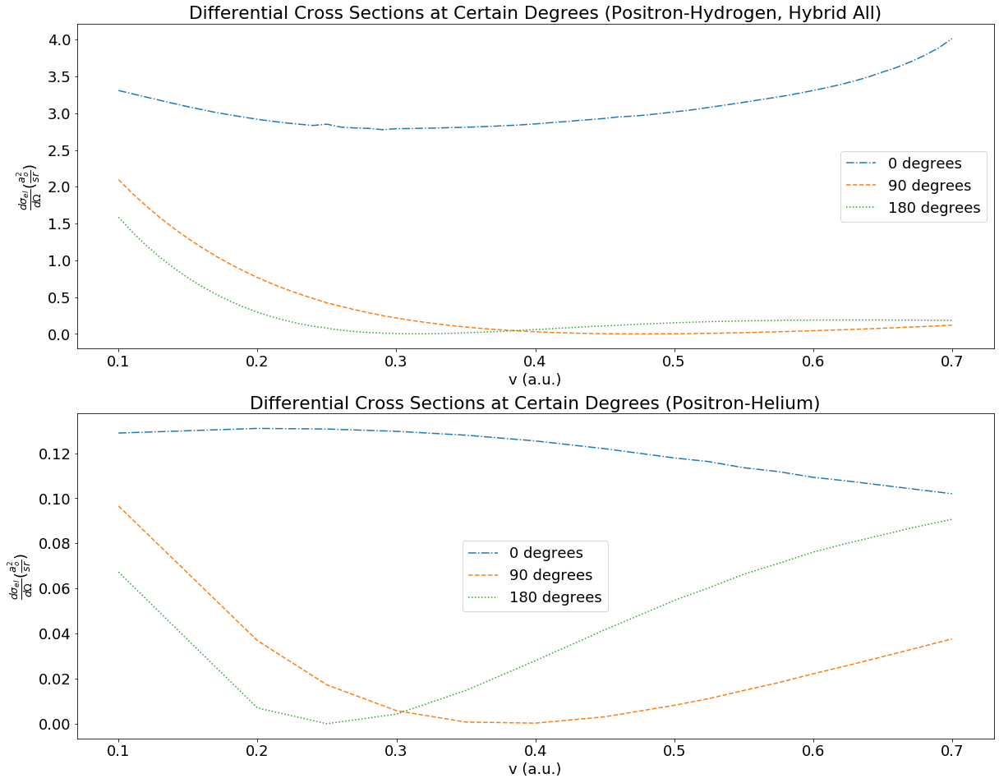

In [76]:
pos_hyd_pos_hel_compare_degree = compare_at_degree(pos_hyd_diff_degree, pos_hel_diff_degree,'e(+)-h', 'e(+)-he')
display(pos_hyd_pos_hel_compare_degree)

positron_hyd_hel_system.plot_diff_cross_vs_k(r_interval,velocity=True,compare=True)

At 90 and 180 degrees the differential cross section is close for both systems. In the positron-hydrogen system at 0 degrees the differential cross section gets further away from 90 and 180 degrees in magnitude with increasing energy whereas in the positron-helium system the differential cross section at the various degrees converges with increasing energy.

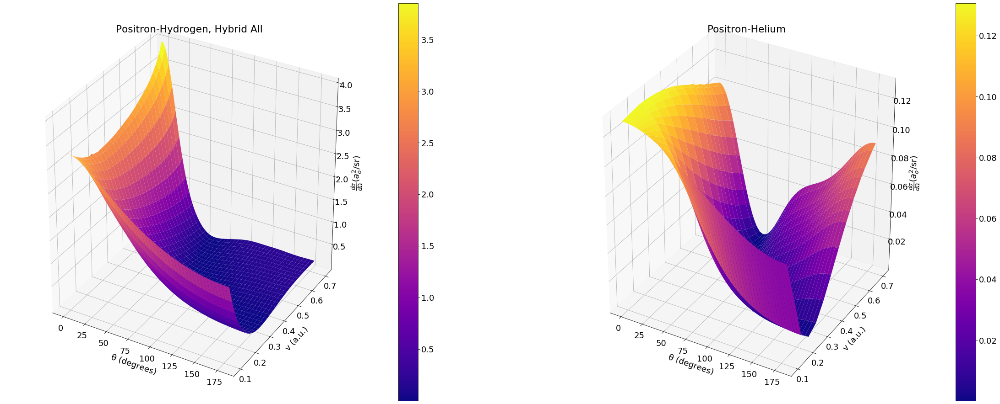

In [77]:
positron_hyd_hel_system.diff_plot_3d(velocity=True,compare=True)

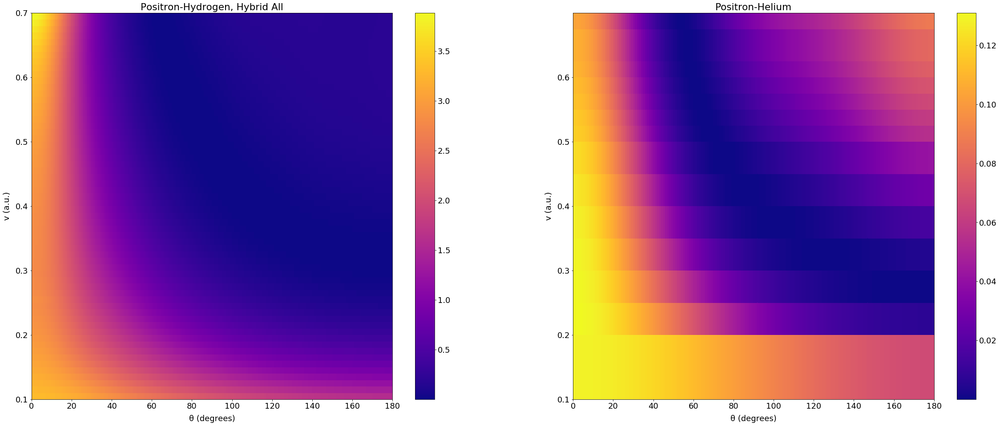

In [78]:
positron_hyd_hel_system.diff_plot_3d(velocity=True,compare=True,density=True)

When both the velocity and degrees are low, there is a peak region maintained for both systems. Moving from this causes the differential cross section to decrease rapidly. The differential cross section never again increases in the positron-hydrogen system, but when both the velocity and degrees are high the differential cross section increases in the positron-helium system.   

#  Electron-Positronium

### Ward et al 1987

Phase shifts from Ward et al 1987 [9]

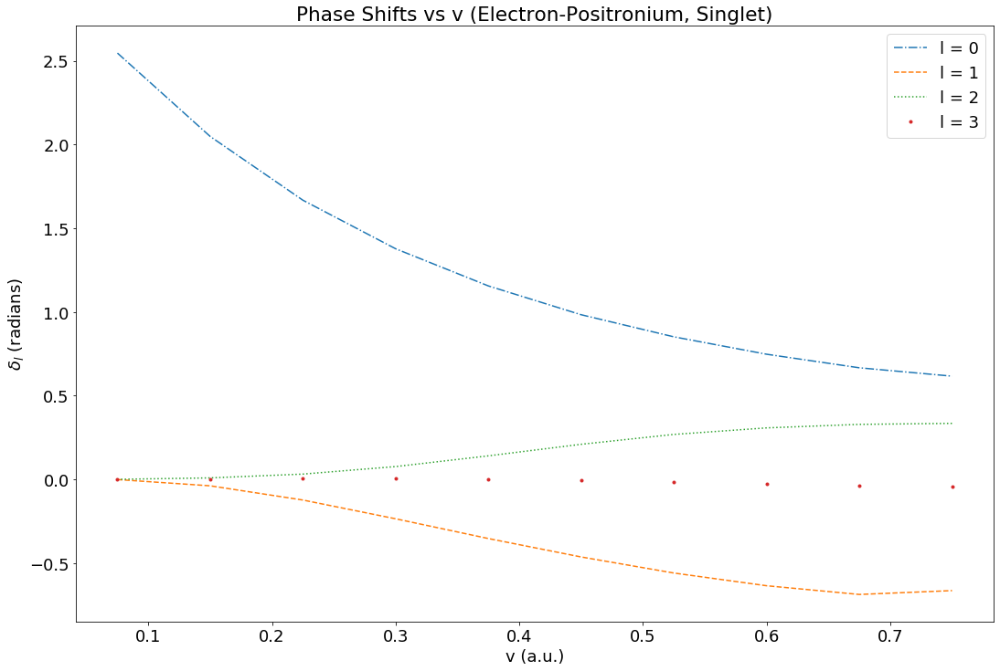

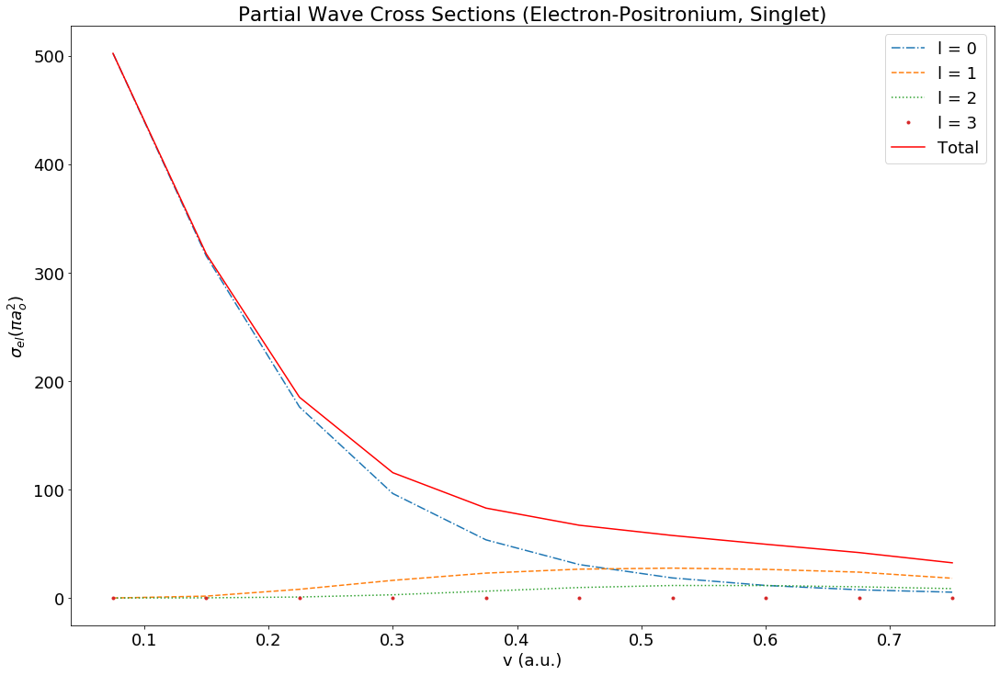

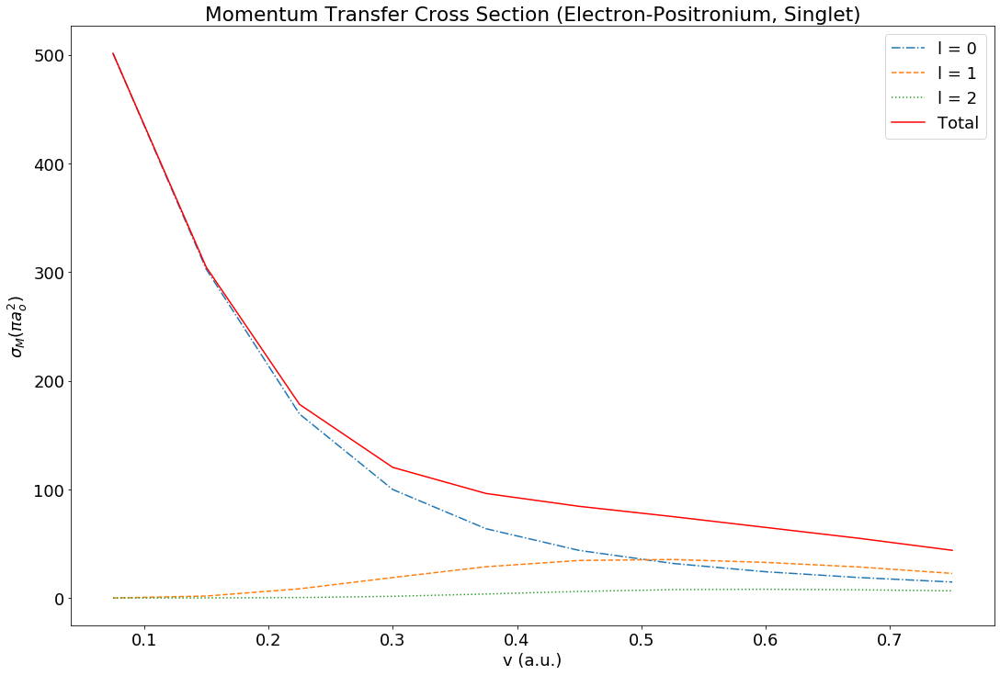

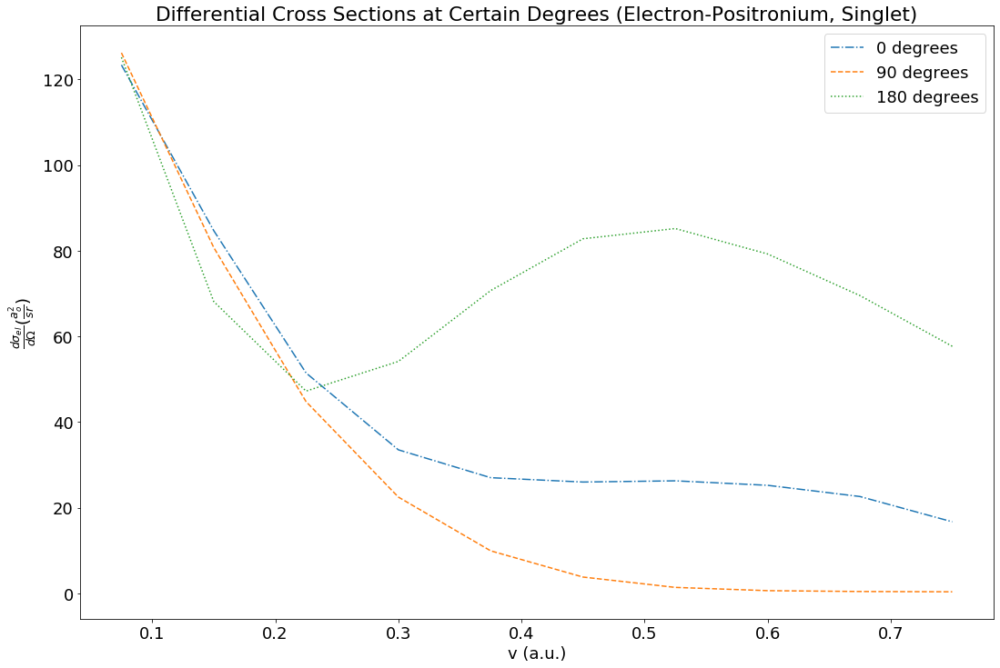

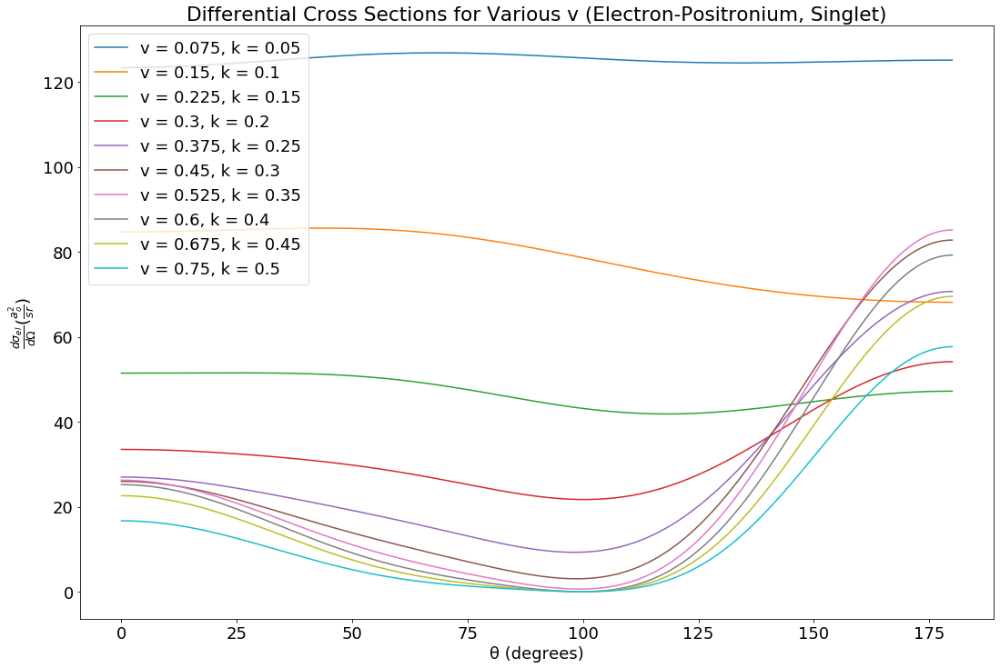

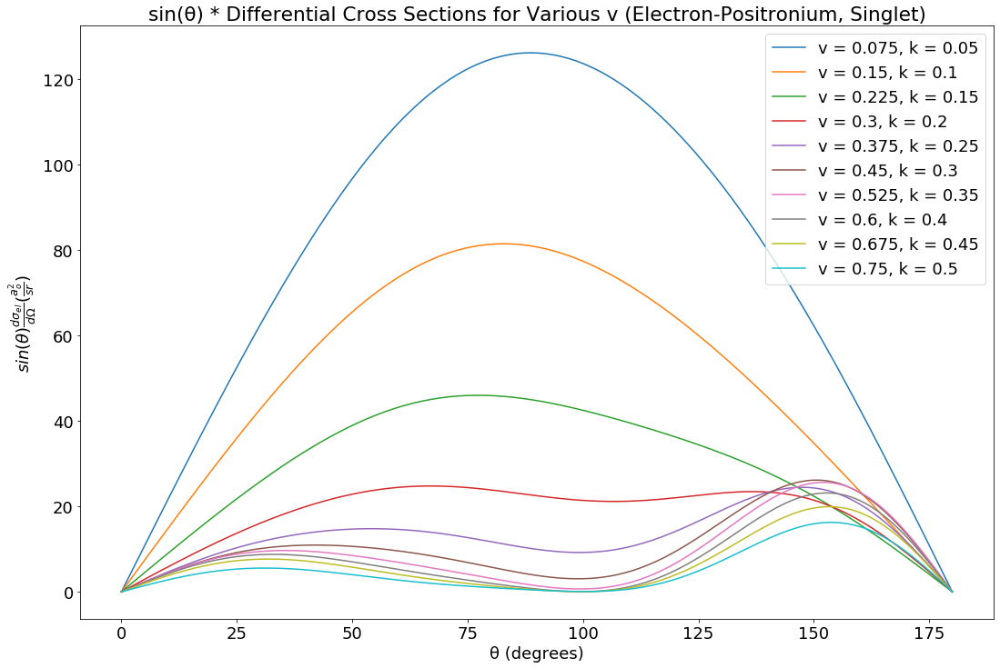

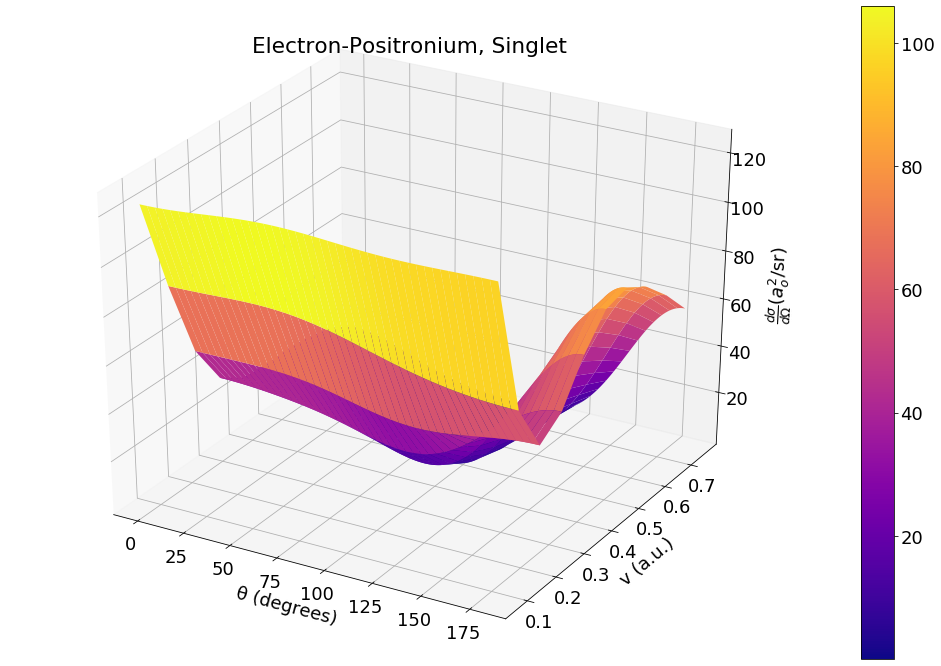

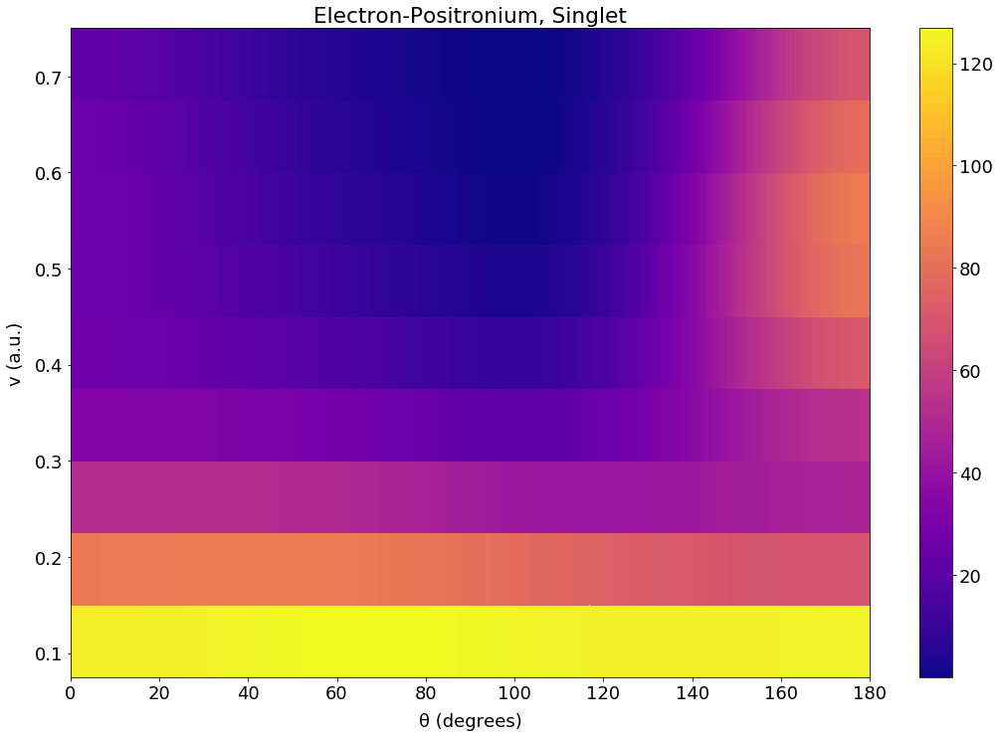

In [79]:
e_ps_system_w = collision(e_ps_phases_w,k_e_ps_w, 'Electron-Positronium, Singlet',(2/3))


e_ps_system_w.plot_phase_shifts(velocity=True)
e_ps_system_w.plot_cross_section(velocity=True)
e_ps_system_w.plot_momentum_transfer(velocity=True)
e_ps_system_w.plot_diff_cross_vs_k(r_interval,velocity=True)
e_ps_system_w.diff_plot(velocity=True)
e_ps_system_w.diff_plot(sin=True,velocity=True)
e_ps_system_w.diff_plot_3d(velocity=True)
e_ps_system_w.diff_plot_3d(density=True,velocity=True)

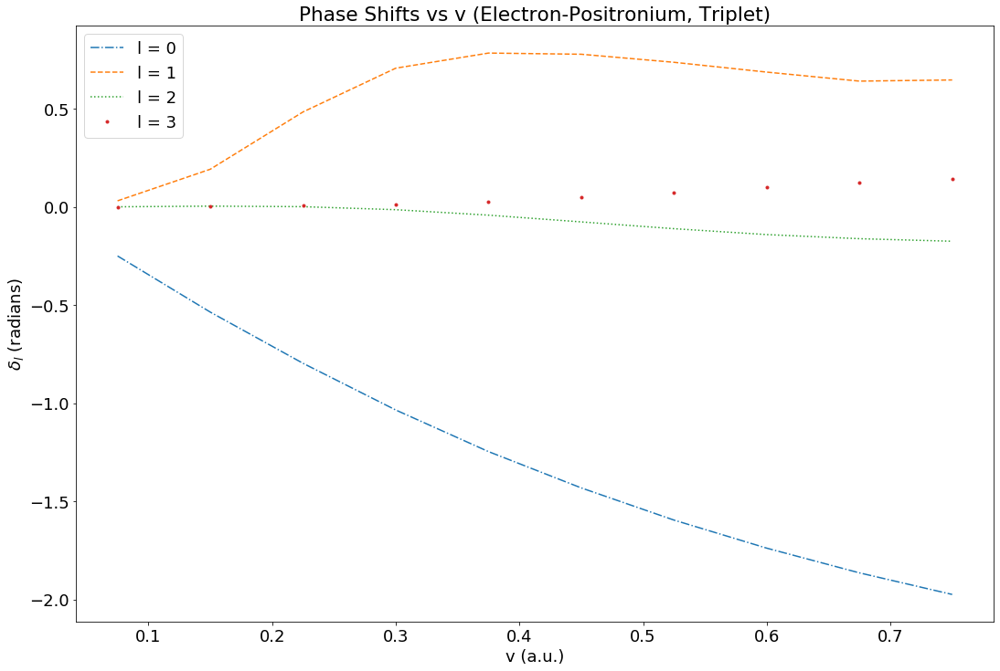

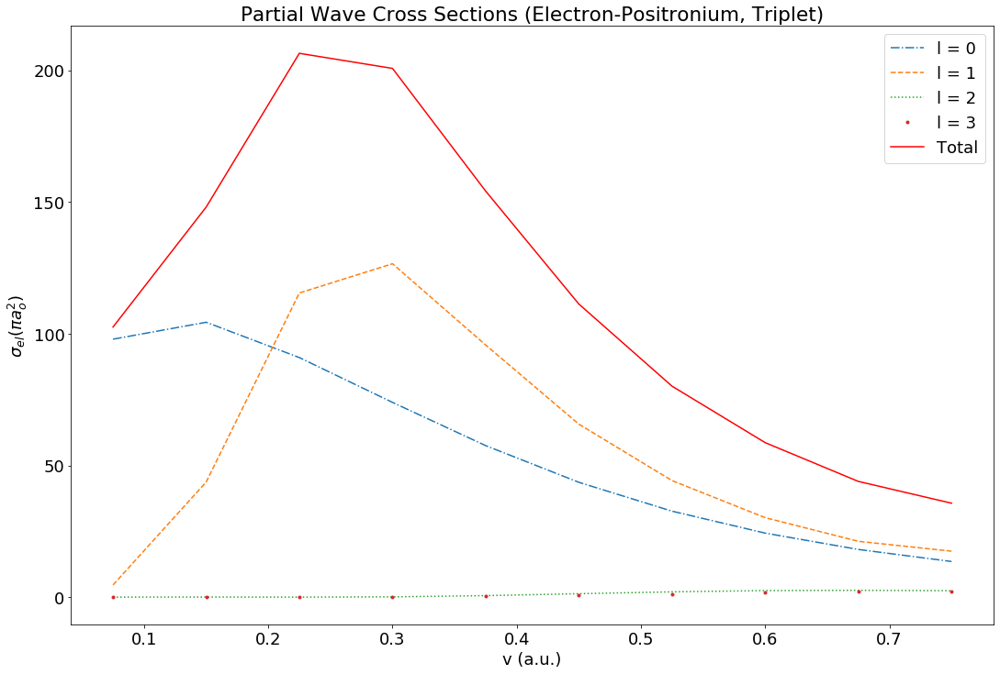

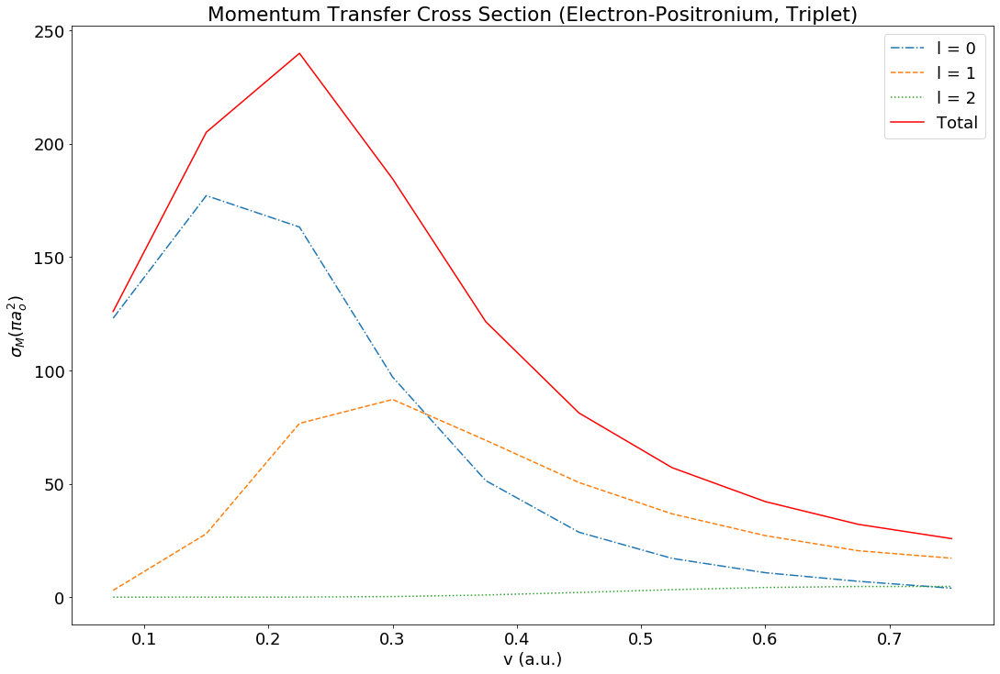

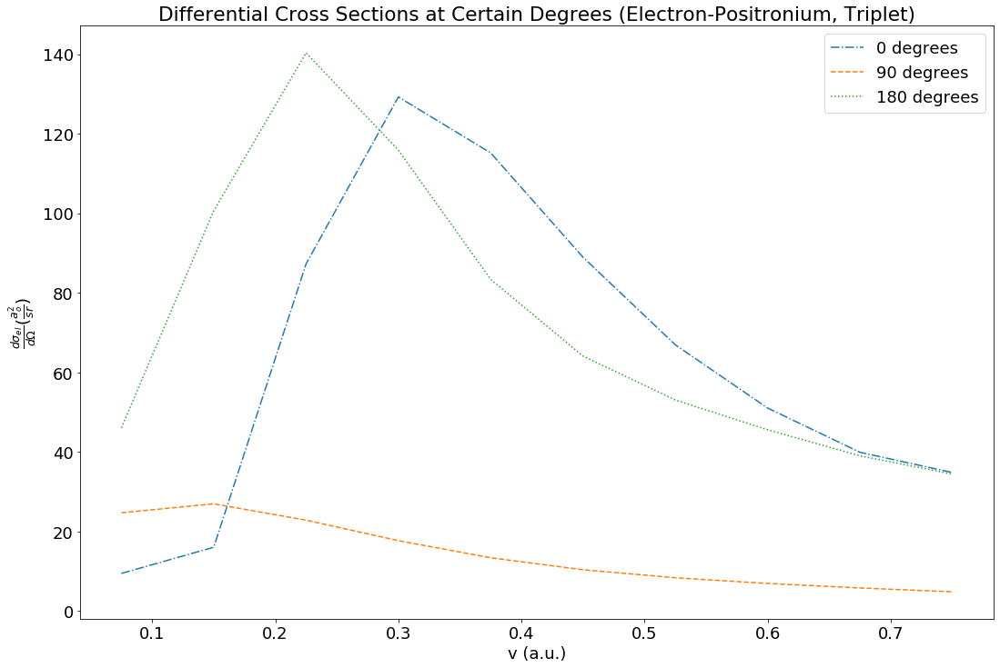

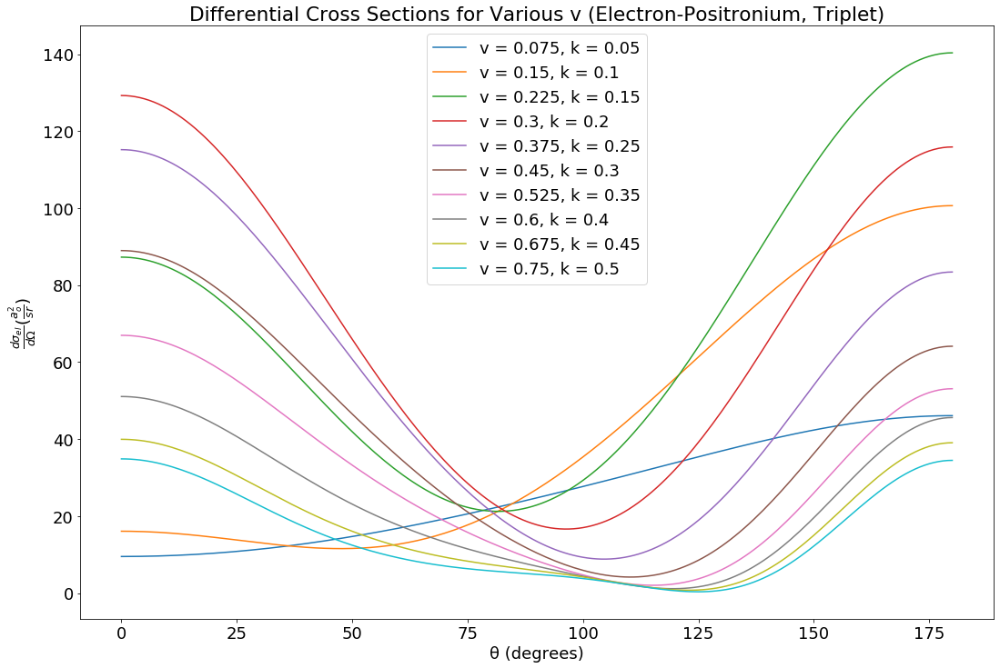

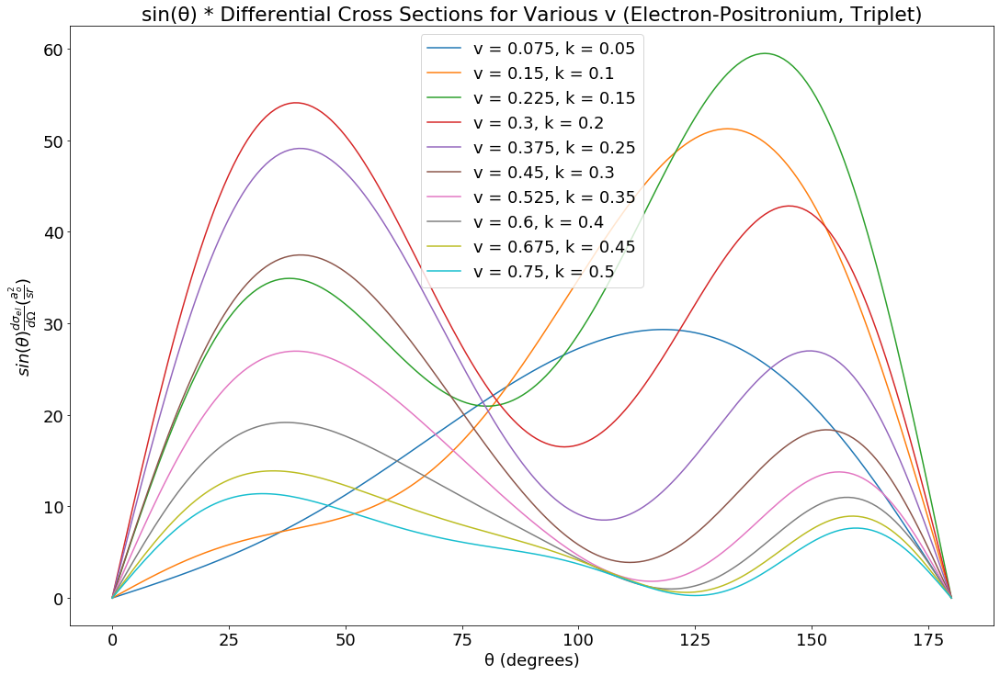

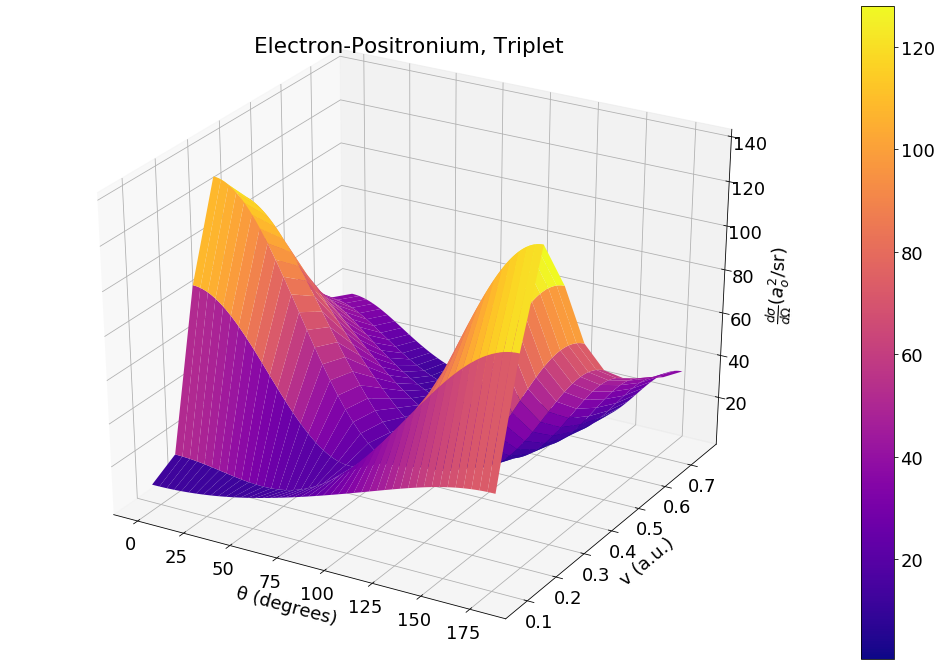

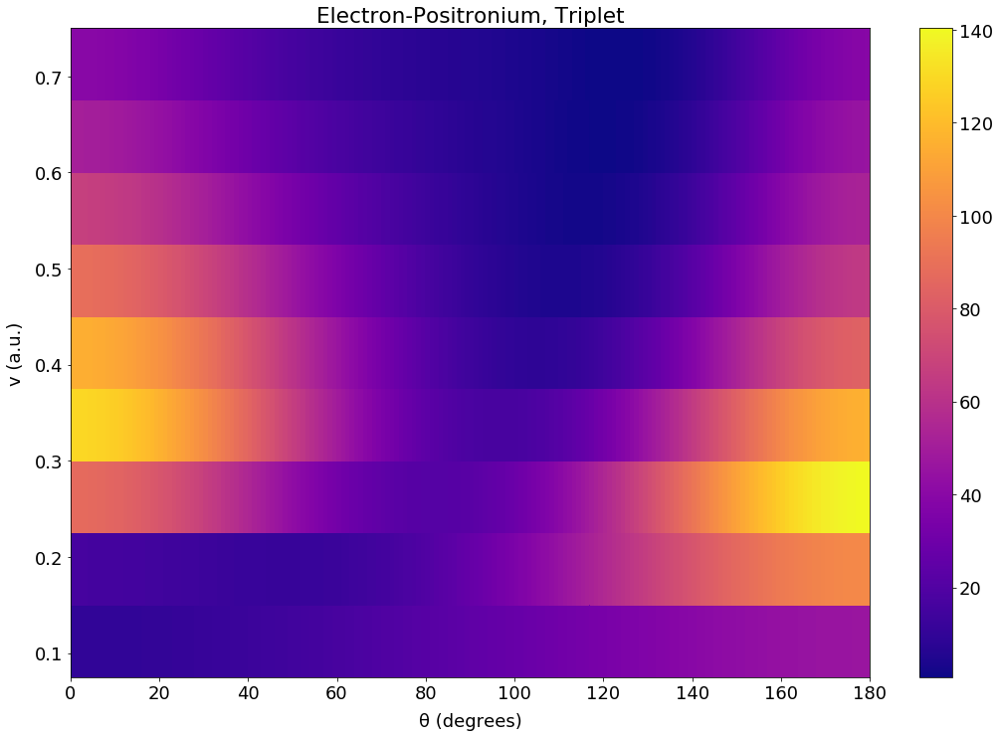

In [80]:
e_ps_triplet_system_w = collision(e_ps_phases_trip_w,k_e_ps_w, 'Electron-Positronium, Triplet',(2/3))


e_ps_triplet_system_w.plot_phase_shifts(velocity=True)
e_ps_triplet_system_w.plot_cross_section(velocity=True)
e_ps_triplet_system_w.plot_momentum_transfer(velocity=True)
e_ps_triplet_system_w.plot_diff_cross_vs_k(r_interval,velocity=True)
e_ps_triplet_system_w.diff_plot(velocity=True)
e_ps_triplet_system_w.diff_plot(sin=True, velocity=True)
e_ps_triplet_system_w.diff_plot_3d(velocity=True)
e_ps_triplet_system_w.diff_plot_3d(density=True, velocity=True)

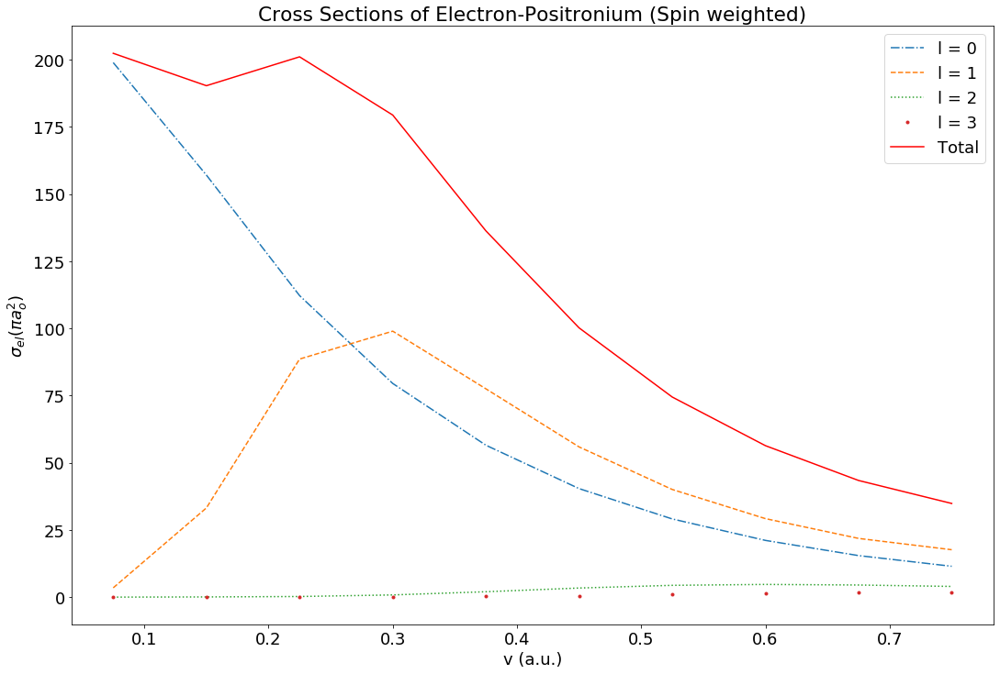

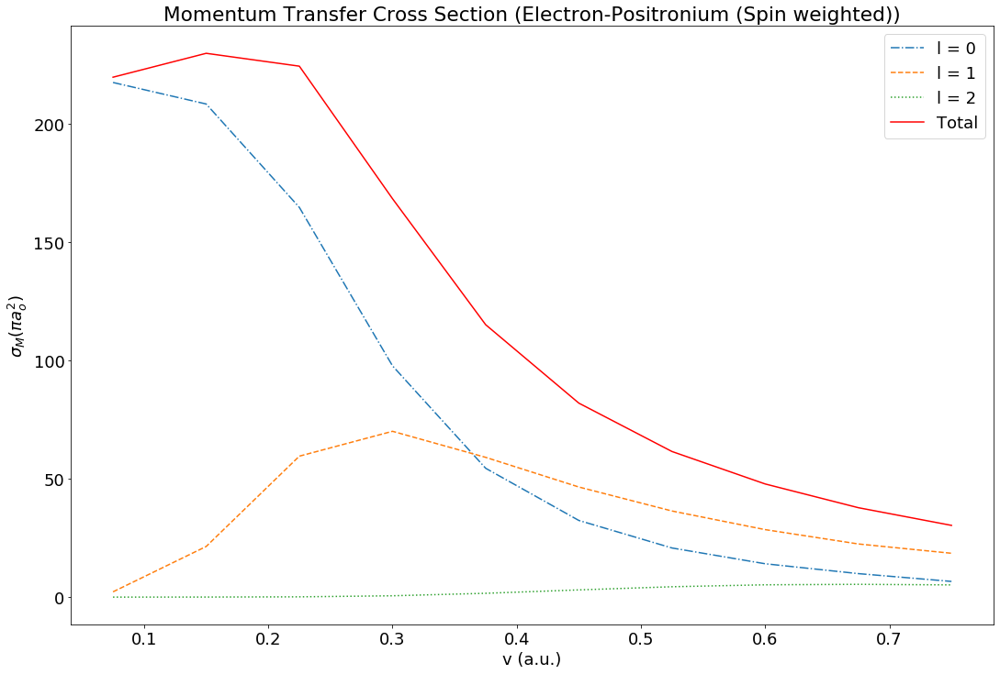

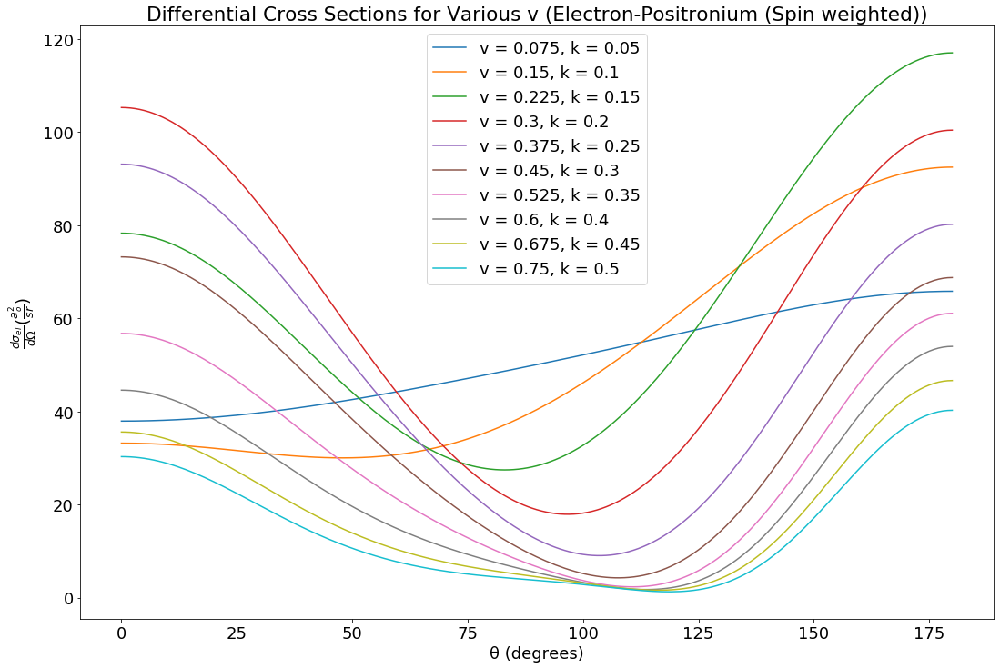

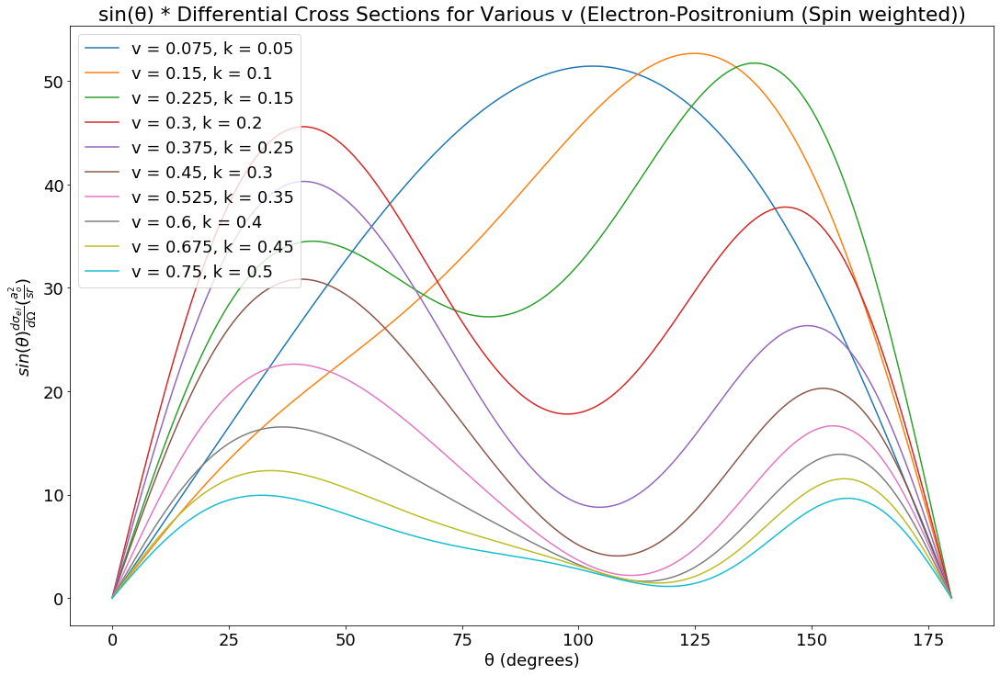

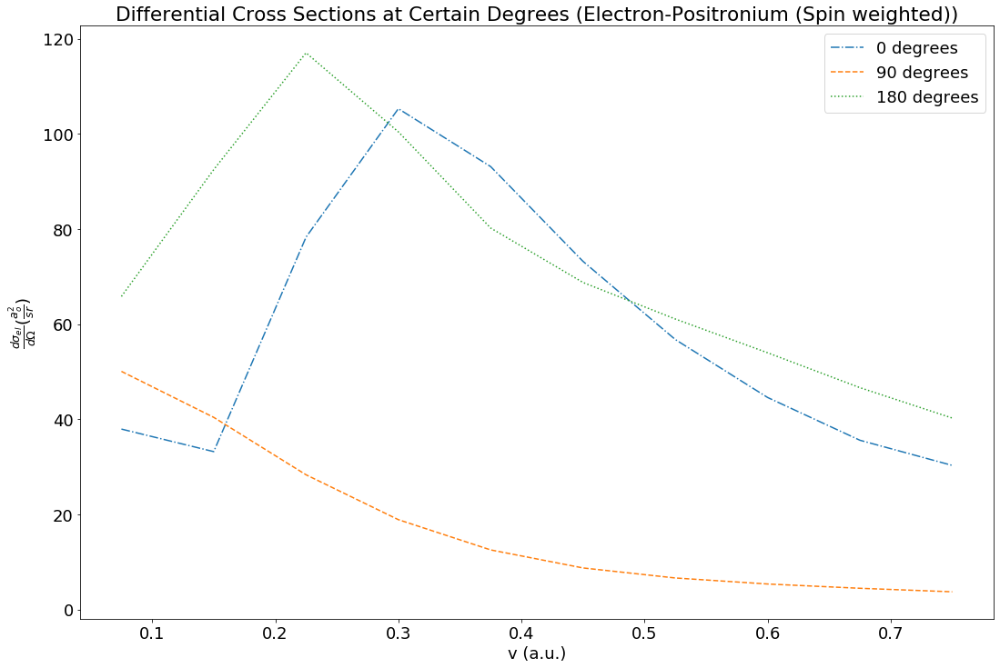

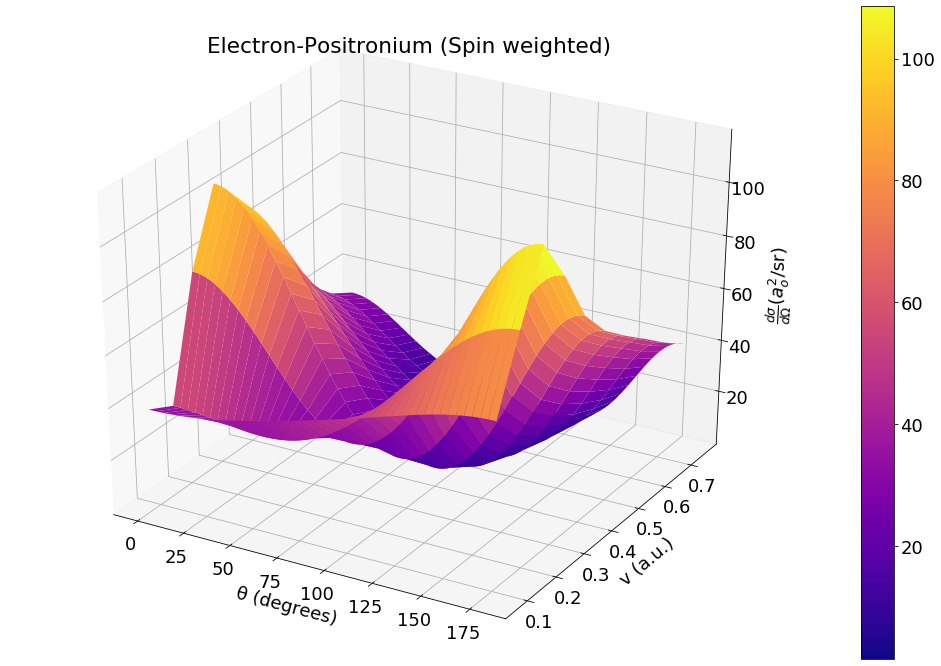

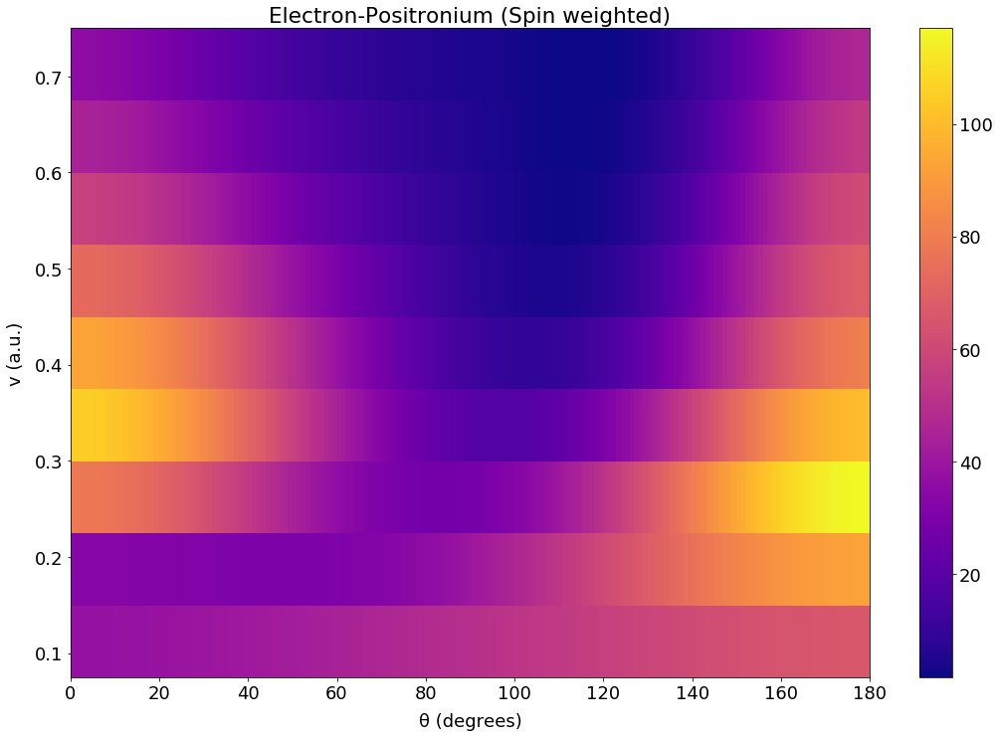

In [81]:
e_ps_weighted_w = collision(e_ps_phases_w,k_e_ps_w,'Electron-Positronium (Spin weighted)',(2/3),e_ps_phases_trip_w,k_e_ps_w,(2/3))


e_ps_weighted_w.plot_cross_section(spin_weight=True, velocity=True)
e_ps_weighted_w.plot_momentum_transfer(spin_weight=True, velocity=True)
e_ps_weighted_w.diff_plot(spin_weight=True, velocity=True)
e_ps_weighted_w.diff_plot(spin_weight=True, sin=True, velocity=True)
e_ps_weighted_w.plot_diff_cross_vs_k(r_interval,spin_weight=True, velocity=True)
e_ps_weighted_w.diff_plot_3d(spin_weight=True, velocity=True)
e_ps_weighted_w.diff_plot_3d(spin_weight=True, density=True, velocity=True)

### A Igarashi et al 2000

Phase shifts from A Igarashi et al 2000 [10]

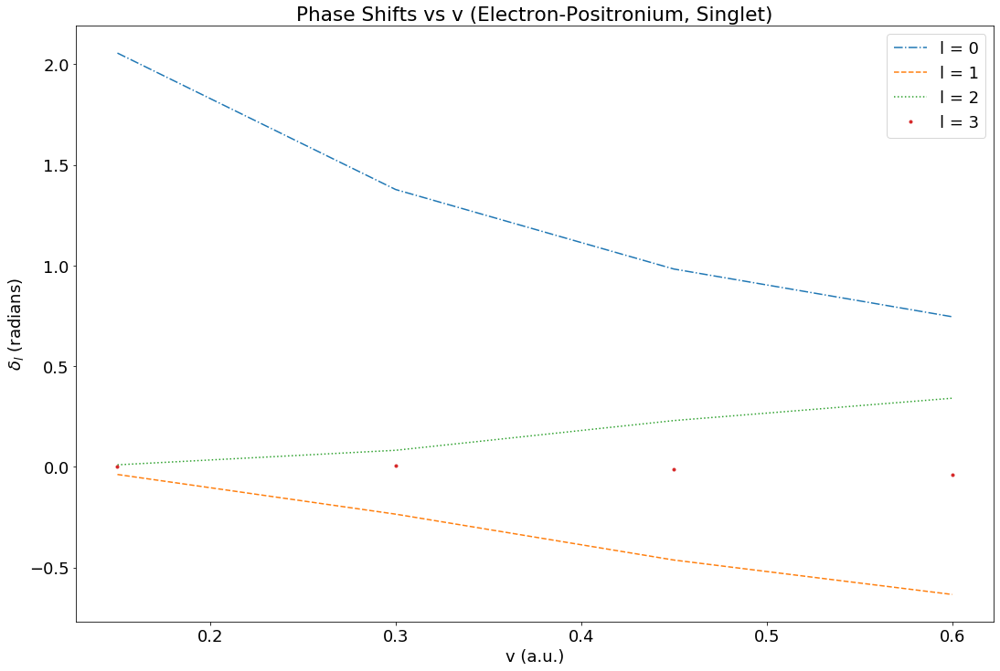

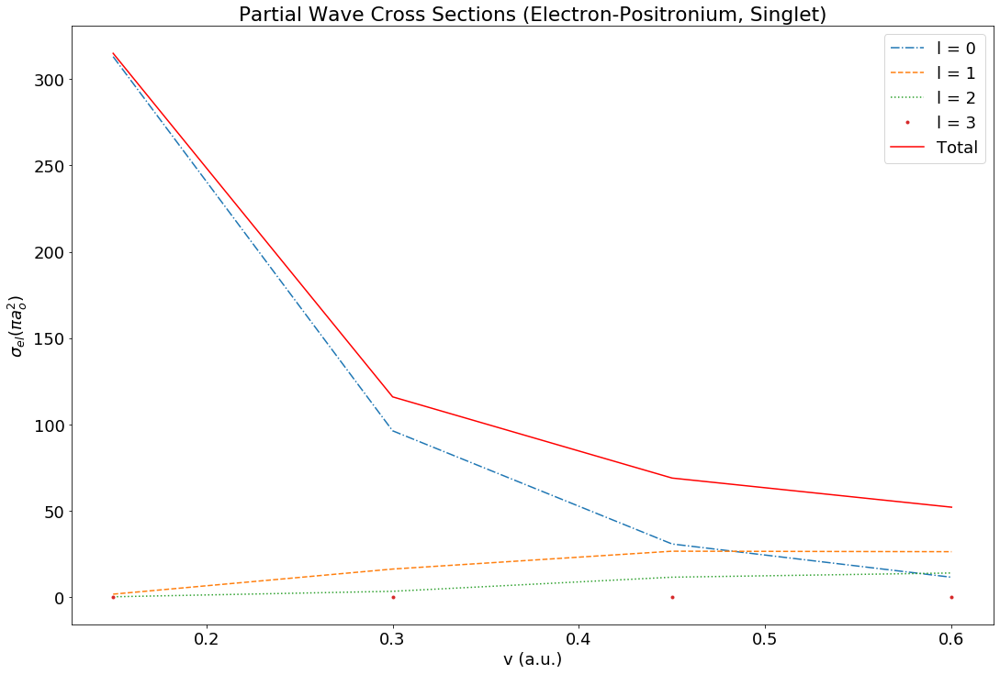

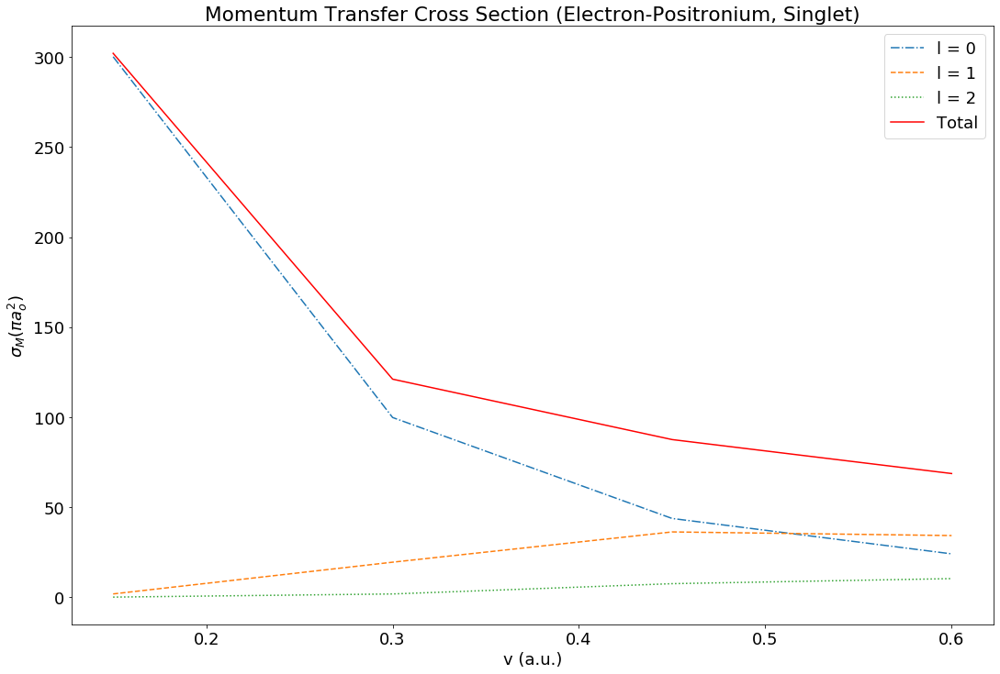

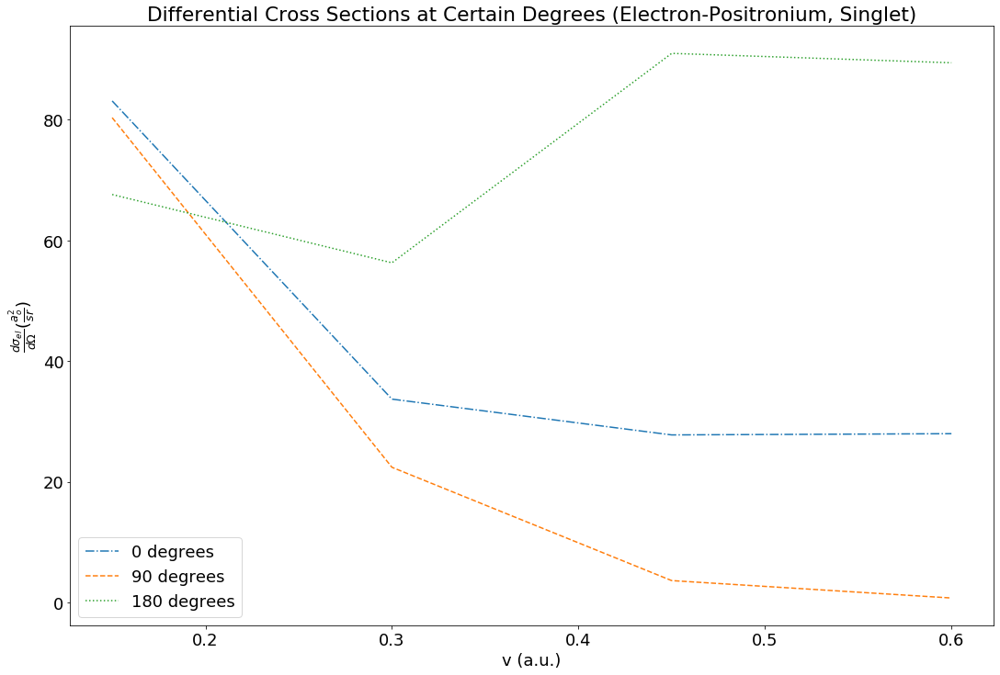

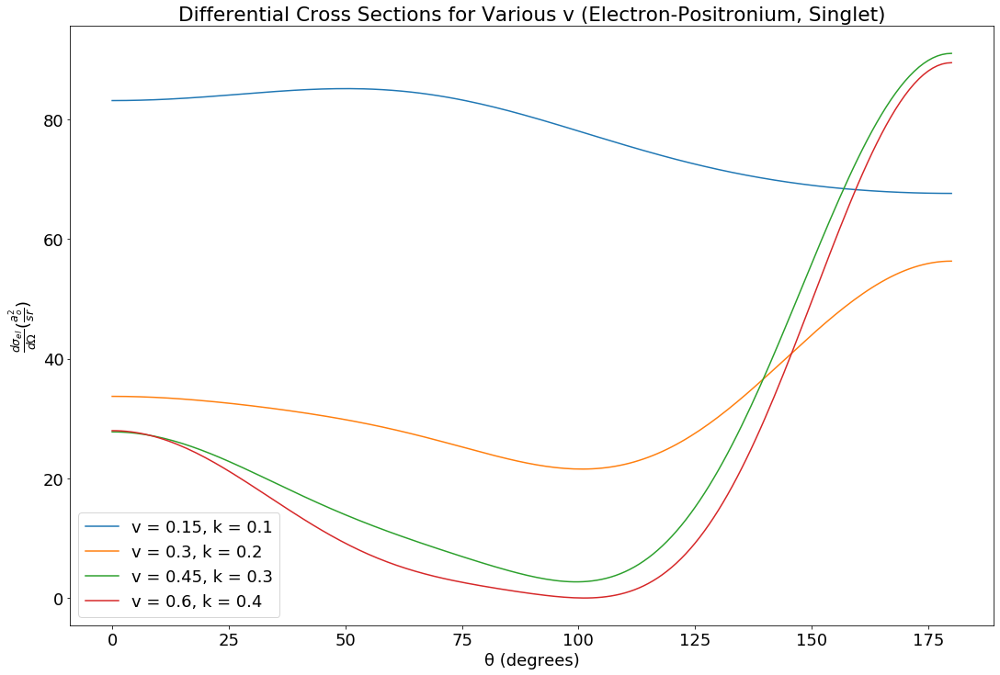

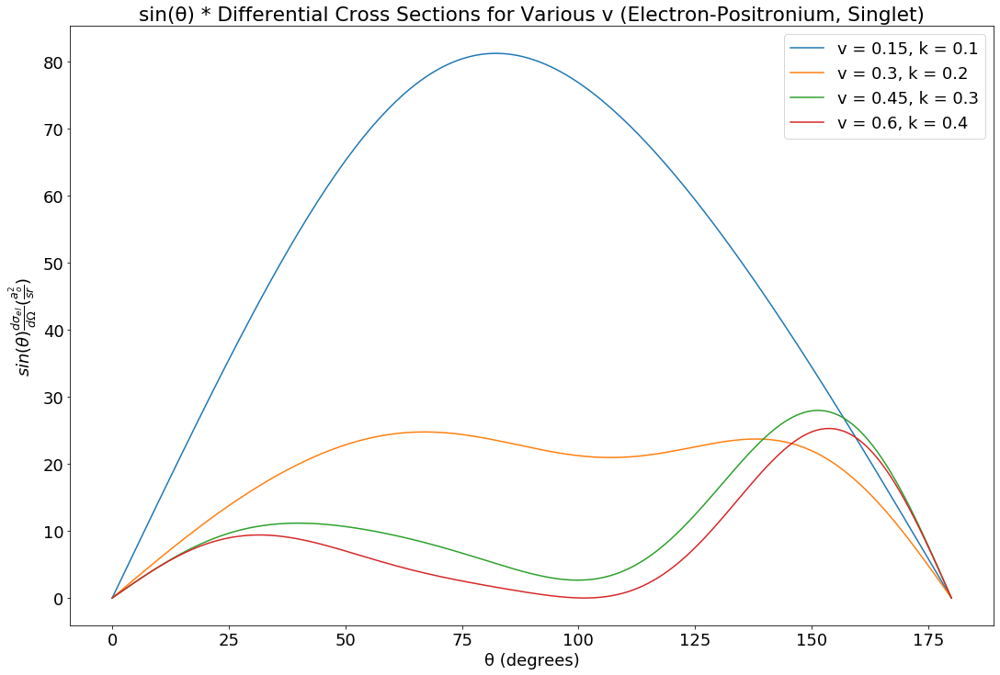

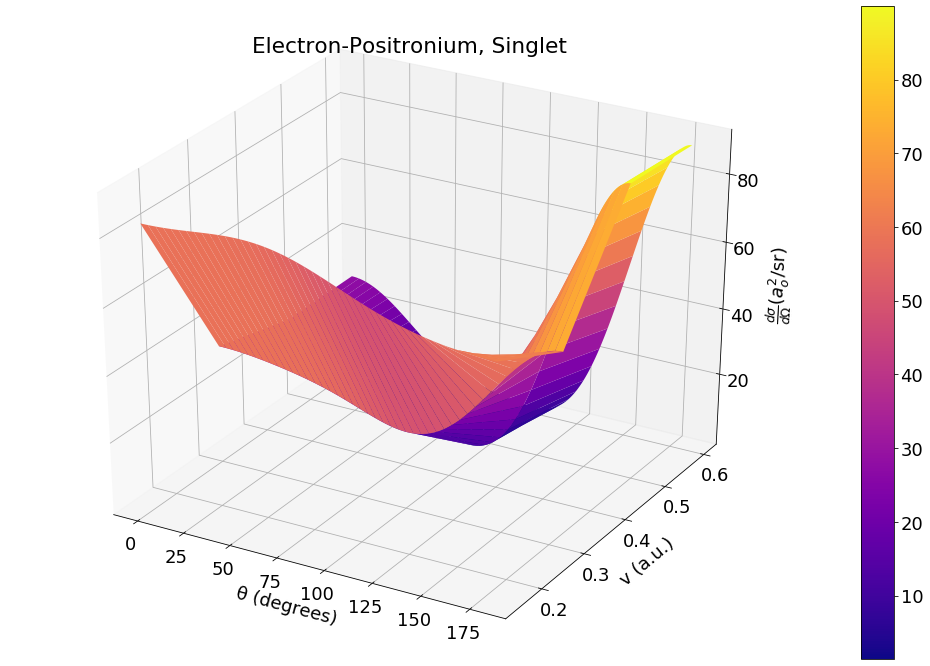

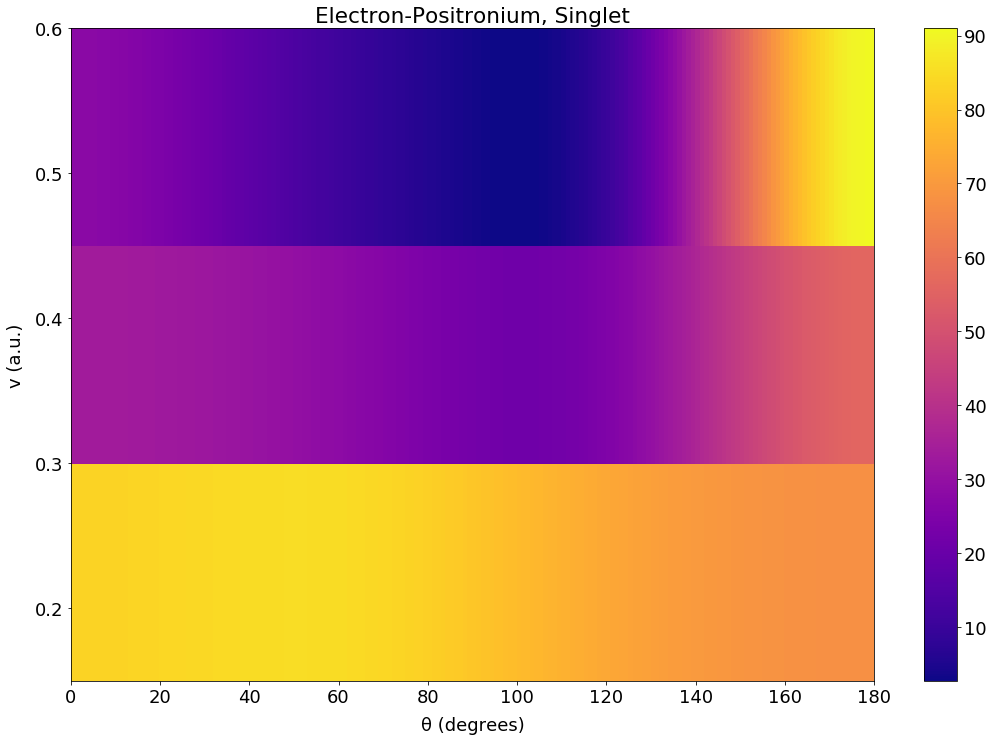

In [82]:
e_ps_system = collision(e_ps_phases,k_e_ps, 'Electron-Positronium, Singlet',(2/3))


e_ps_system.plot_phase_shifts(velocity=True)
e_ps_system.plot_cross_section(velocity=True)
e_ps_system.plot_momentum_transfer(velocity=True)
e_ps_system.plot_diff_cross_vs_k(r_interval,velocity=True)
e_ps_system.diff_plot(velocity=True)
e_ps_system.diff_plot(sin=True,velocity=True)
e_ps_system.diff_plot_3d(velocity=True)
e_ps_system.diff_plot_3d(density=True,velocity=True)

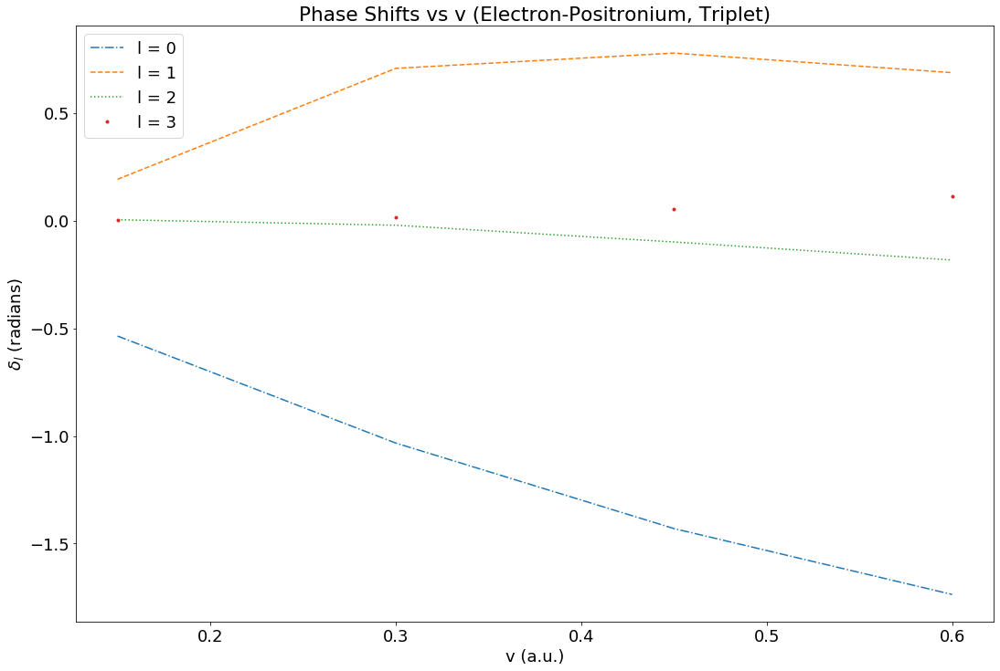

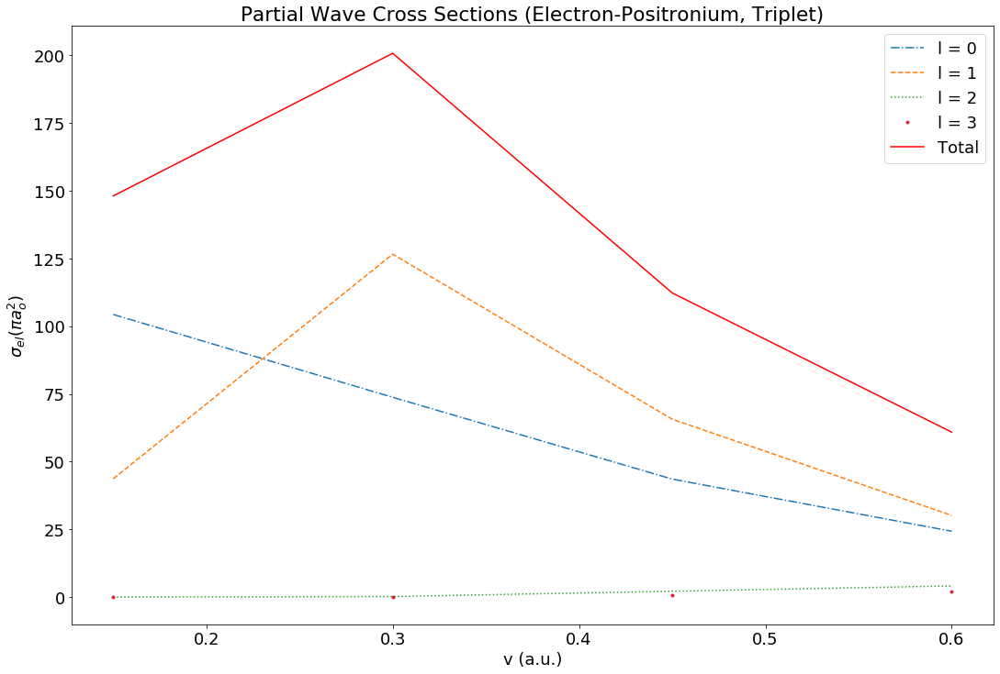

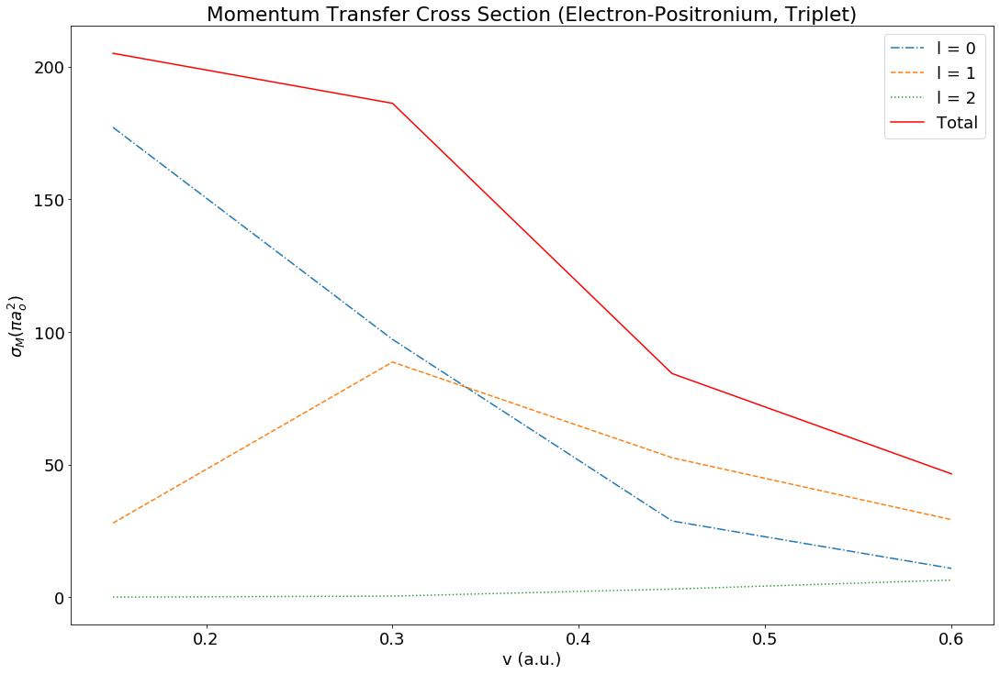

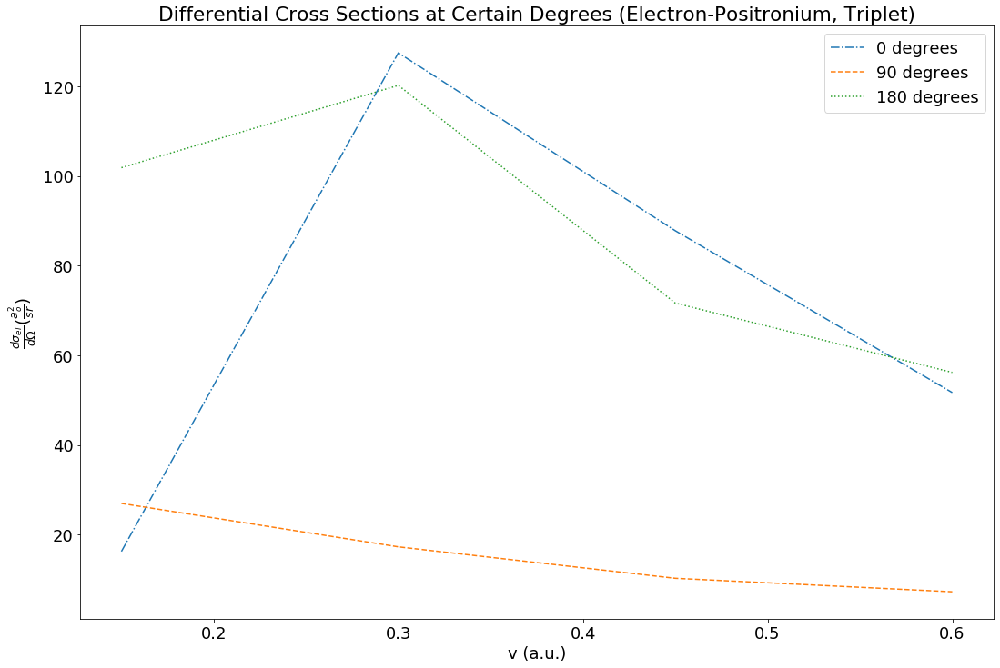

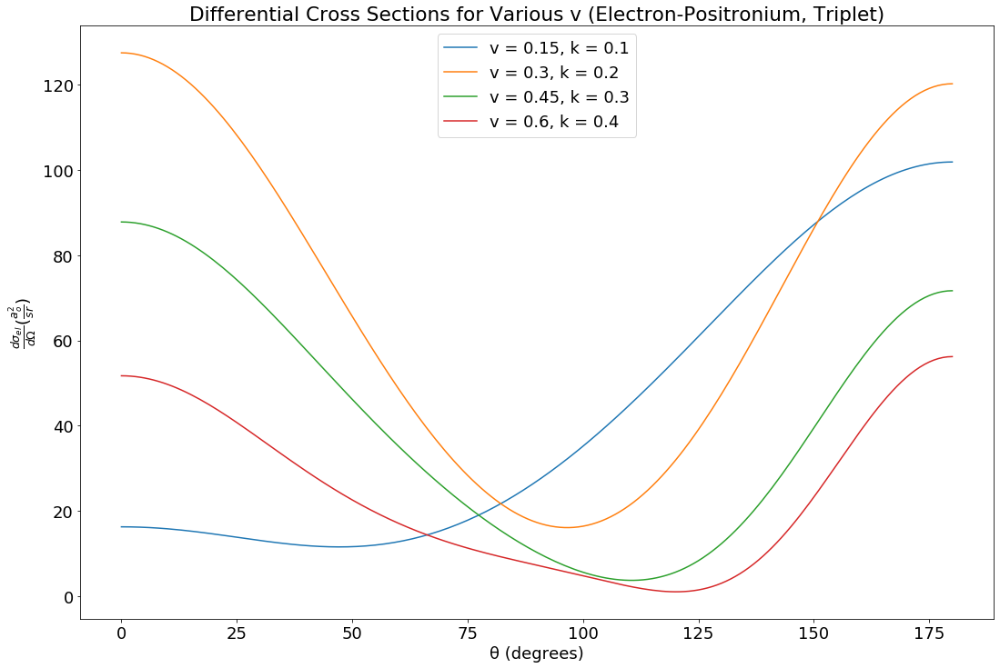

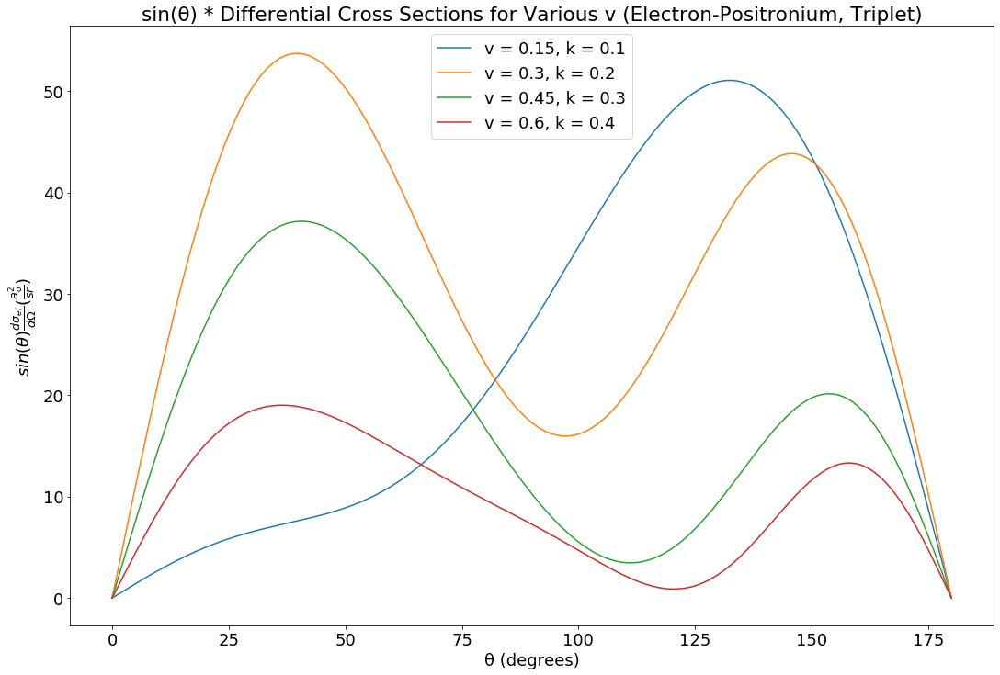

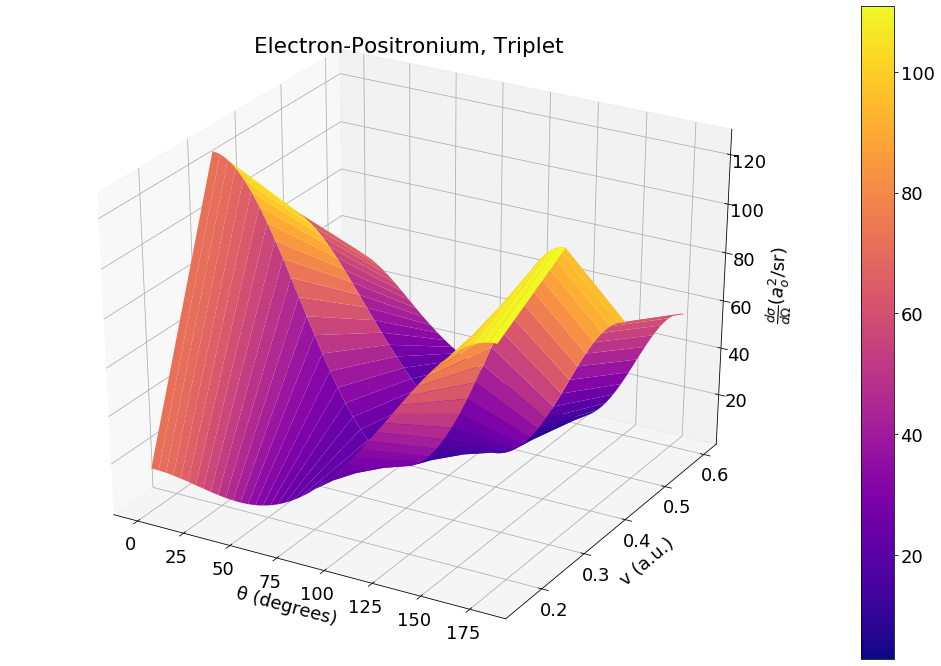

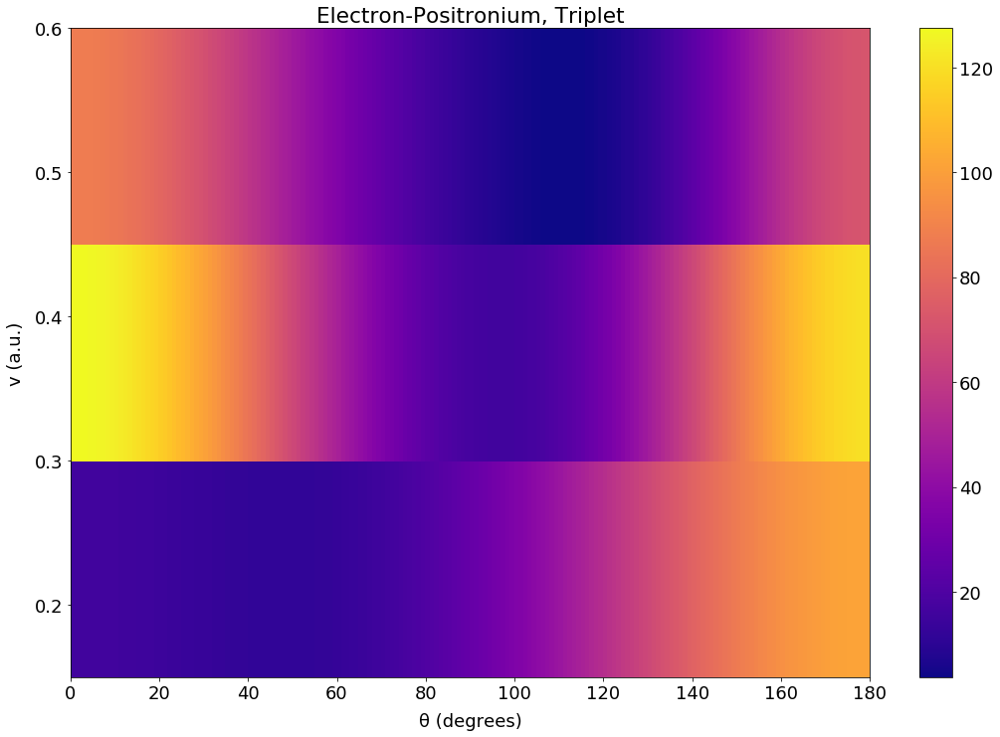

In [83]:
e_ps_triplet_system = collision(e_ps_phases_trip,k_e_ps, 'Electron-Positronium, Triplet',(2/3))


e_ps_triplet_system.plot_phase_shifts(velocity=True)
e_ps_triplet_system.plot_cross_section(velocity=True)
e_ps_triplet_system.plot_momentum_transfer(velocity=True)
e_ps_triplet_system.plot_diff_cross_vs_k(r_interval,velocity=True)
e_ps_triplet_system.diff_plot(velocity=True)
e_ps_triplet_system.diff_plot(sin=True, velocity=True)
e_ps_triplet_system.diff_plot_3d(velocity=True)
e_ps_triplet_system.diff_plot_3d(density=True, velocity=True)

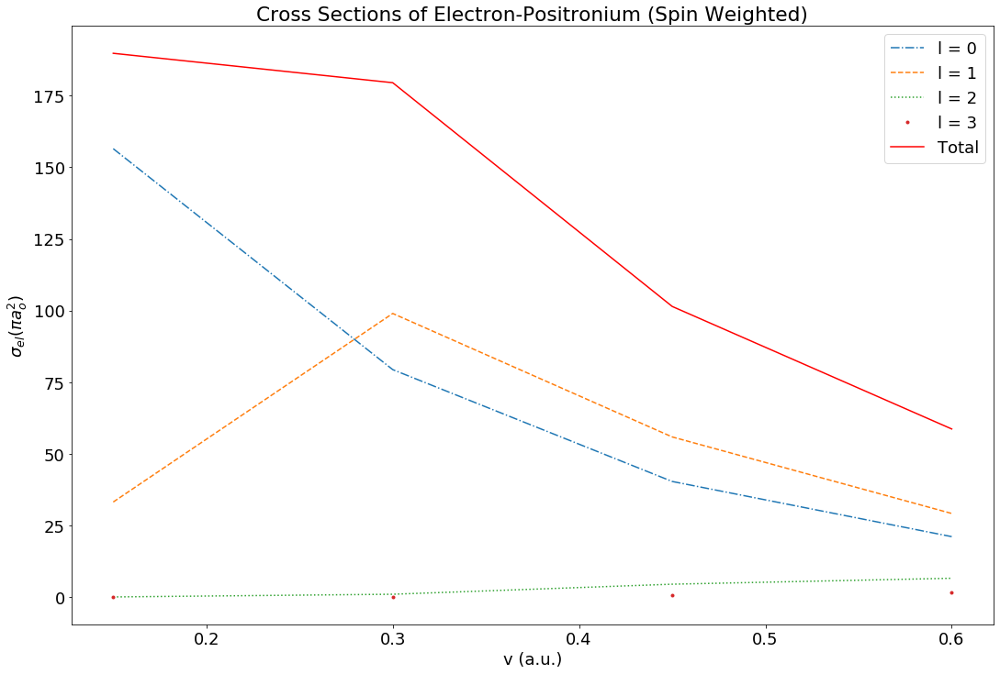

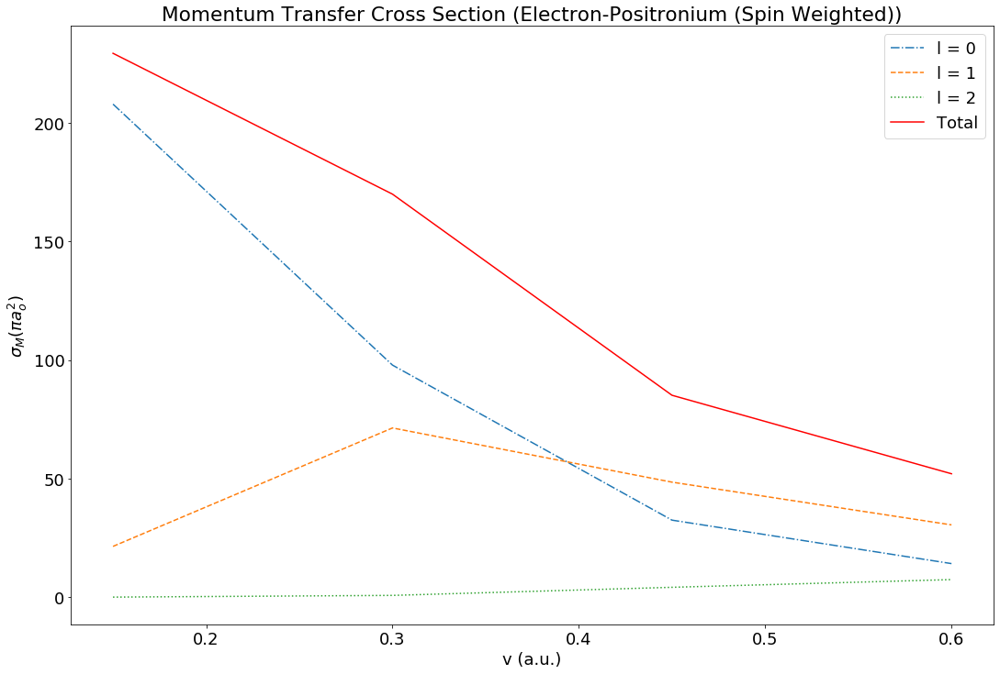

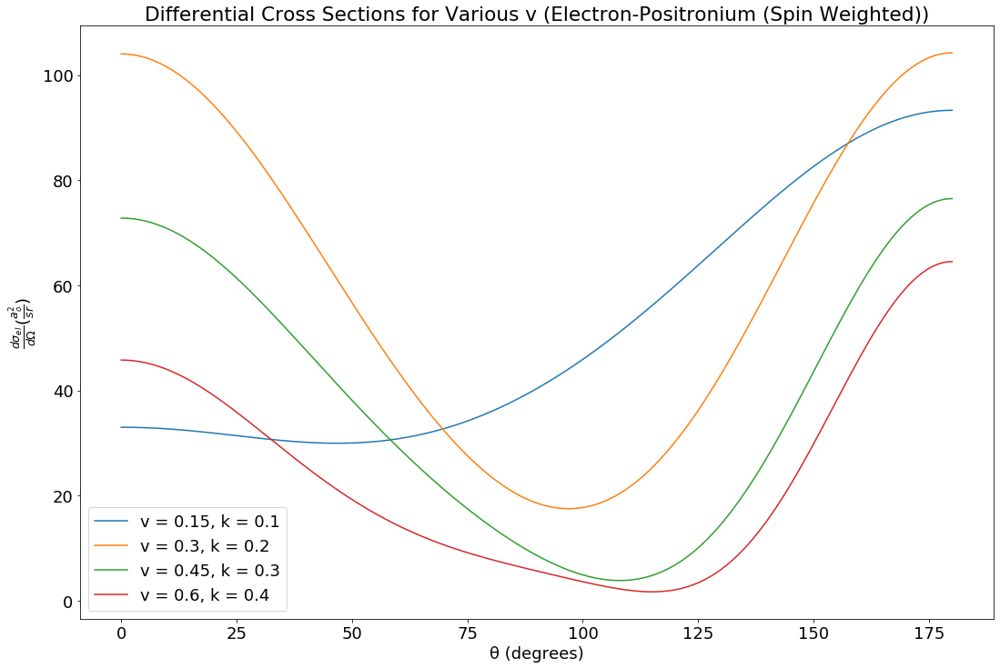

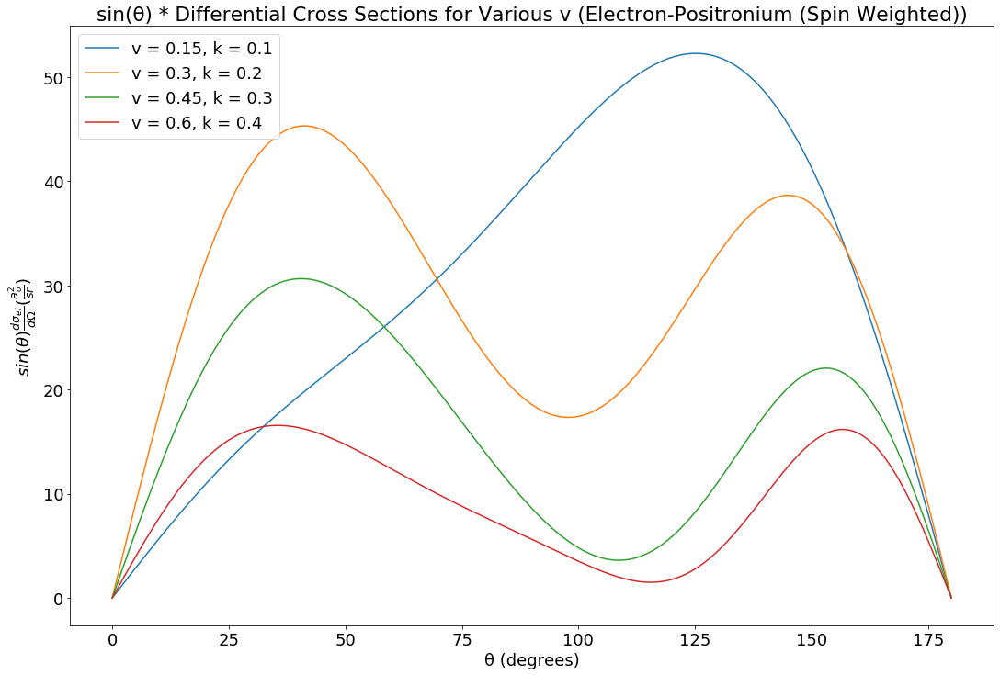

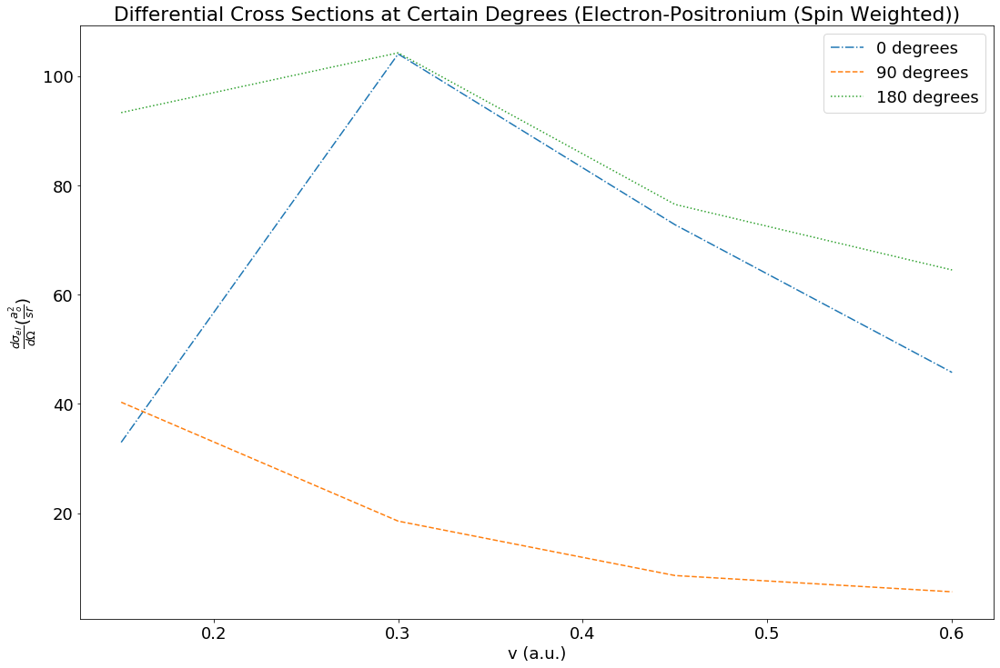

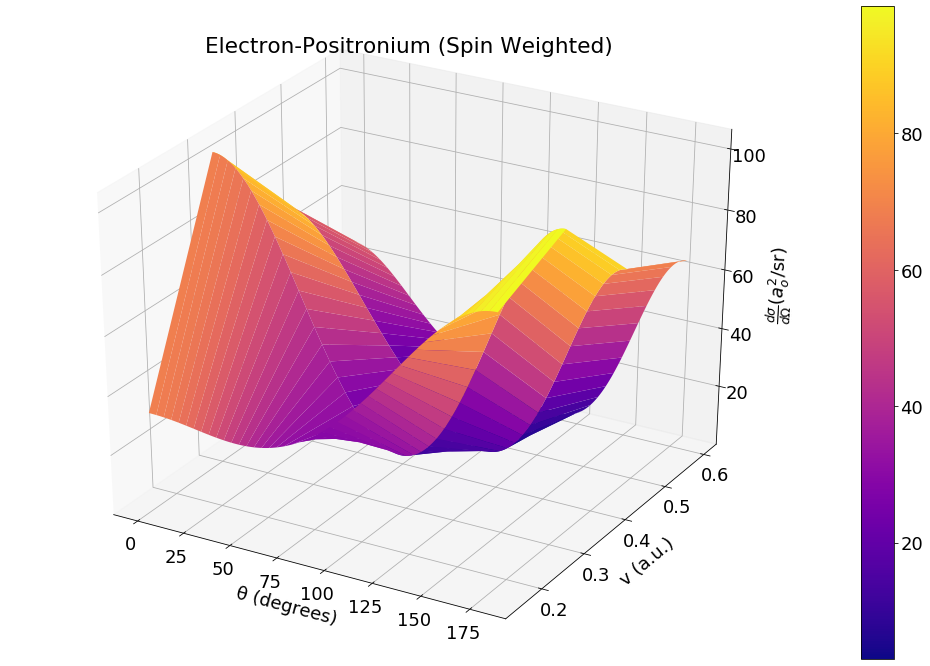

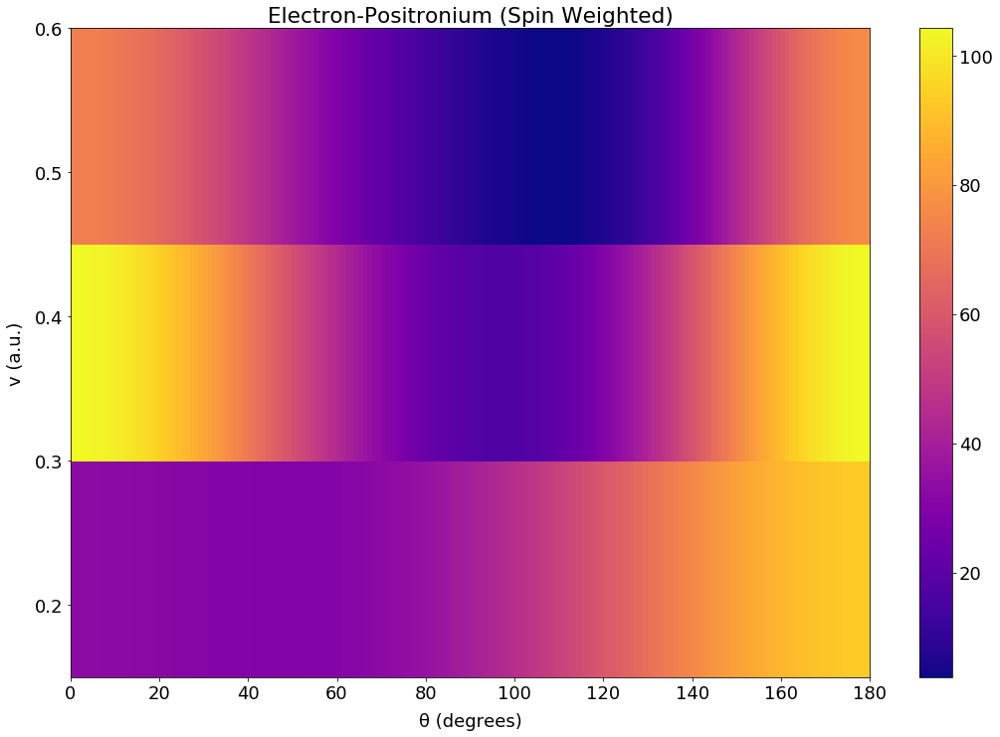

In [84]:
e_ps_weighted_a = collision(e_ps_phases,k_e_ps,'Electron-Positronium (Spin Weighted)',(2/3),e_ps_phases_trip,k_e_ps,(2/3))


e_ps_weighted_a.plot_cross_section(spin_weight=True, velocity=True)  
e_ps_weighted_a.plot_momentum_transfer(spin_weight=True, velocity=True)
e_ps_weighted_a.diff_plot(spin_weight=True, velocity=True)
e_ps_weighted_a.diff_plot(spin_weight=True, sin=True, velocity=True)
e_ps_weighted_a.plot_diff_cross_vs_k(r_interval,spin_weight=True, velocity=True)
e_ps_weighted_a.diff_plot_3d(spin_weight=True, velocity=True)
e_ps_weighted_a.diff_plot_3d(spin_weight=True, density=True, velocity=True)

###  Mixture from Ward et al 1987 and A Igarashi et al 2000

Here phase shifts from Ward et al 1987 [9] are used unless available from A Igarashi et al 2000 [10]

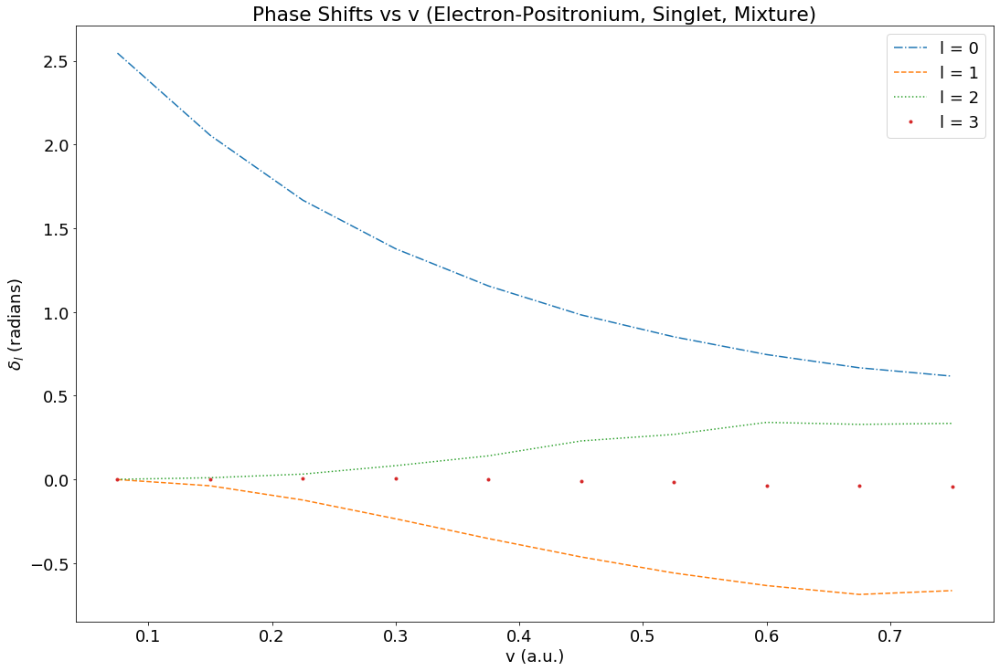

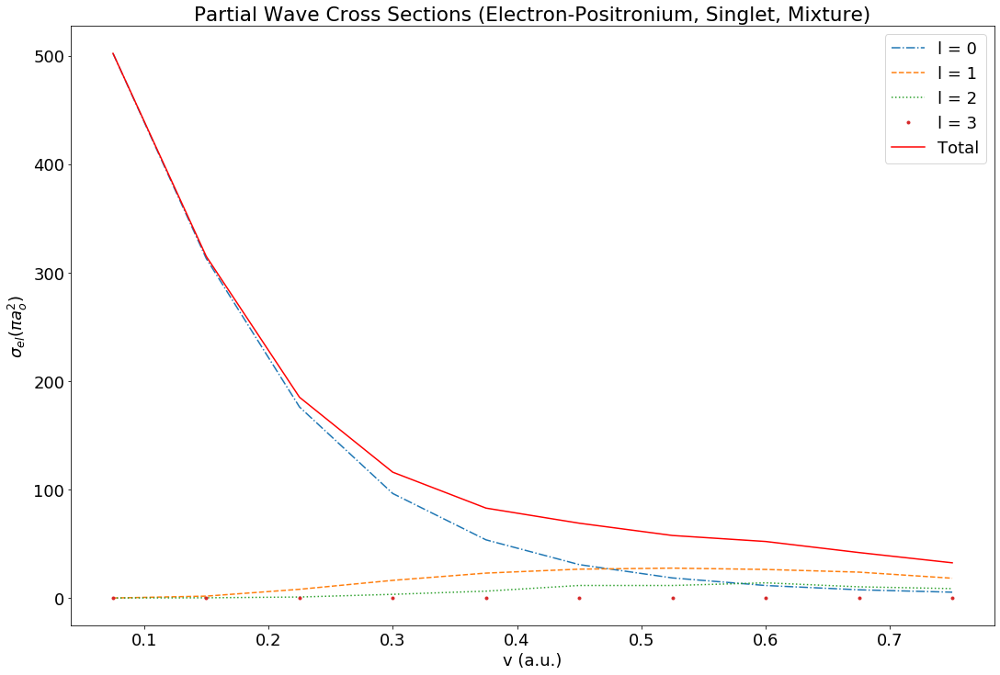

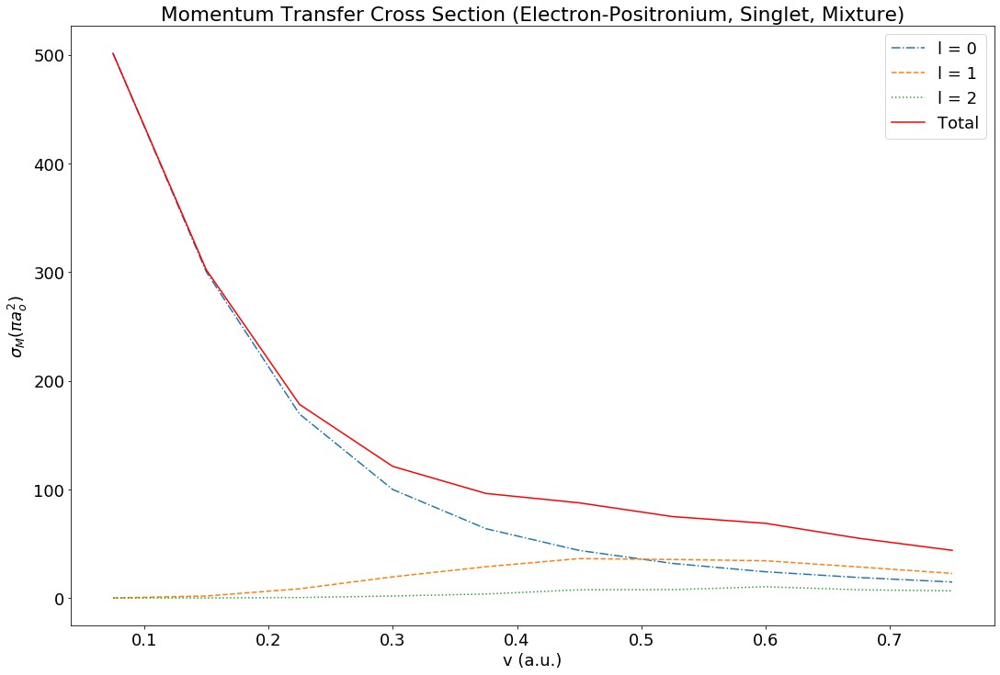

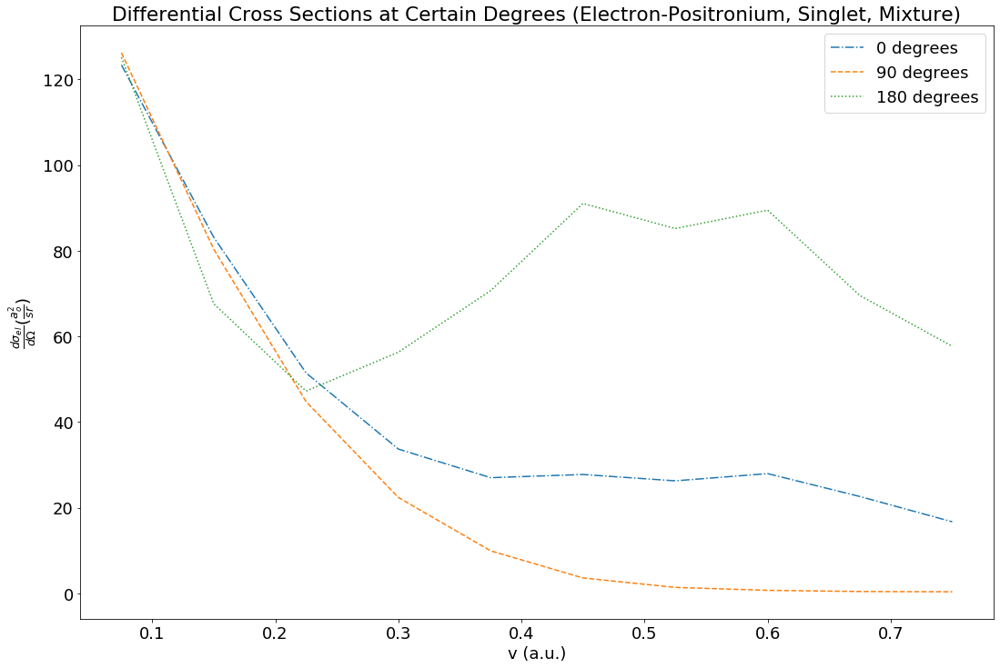

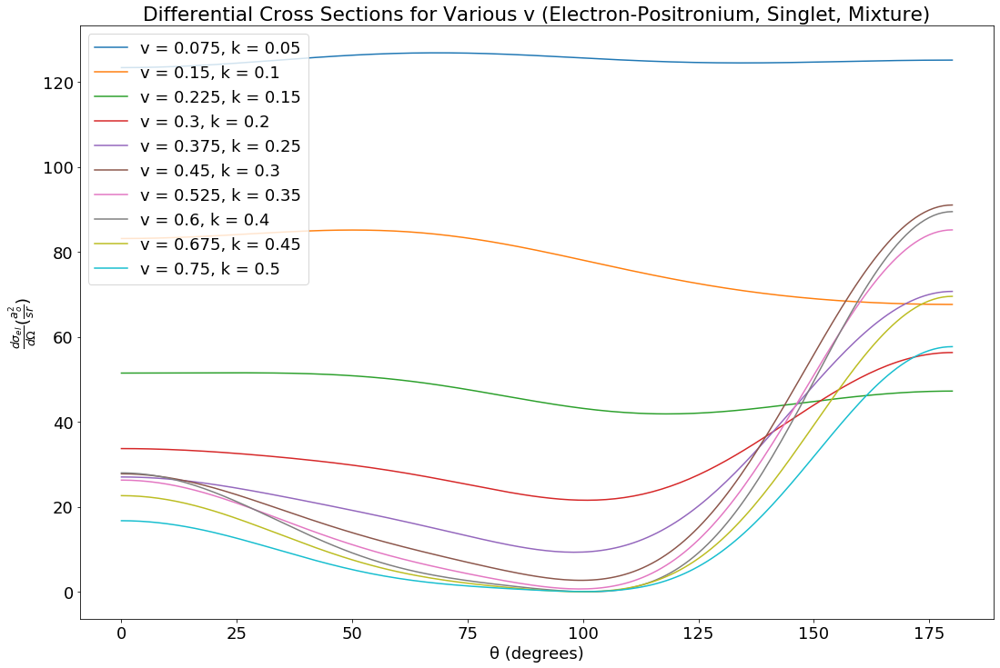

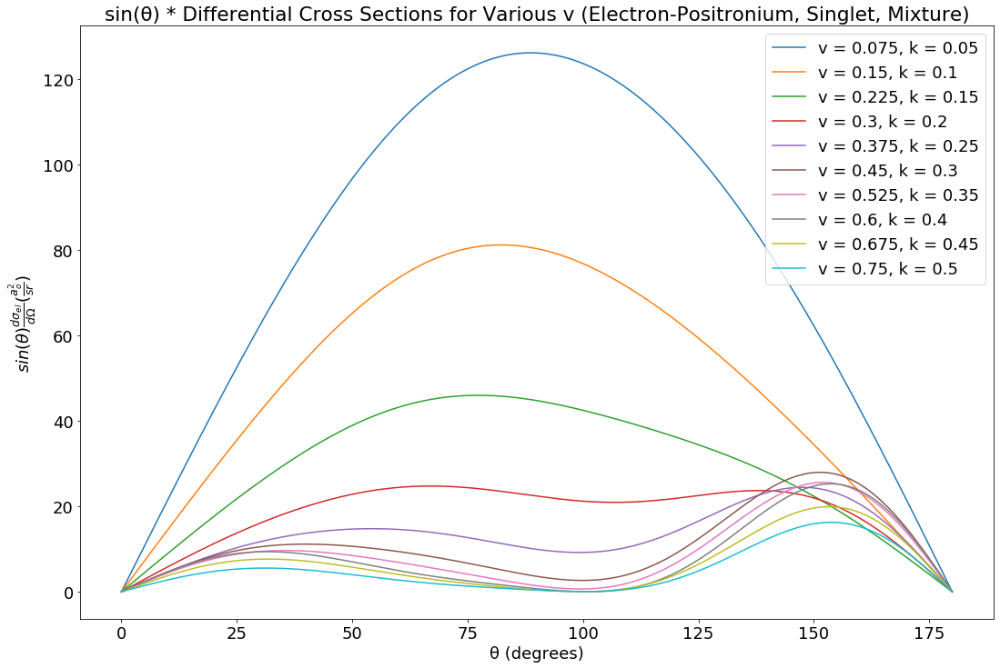

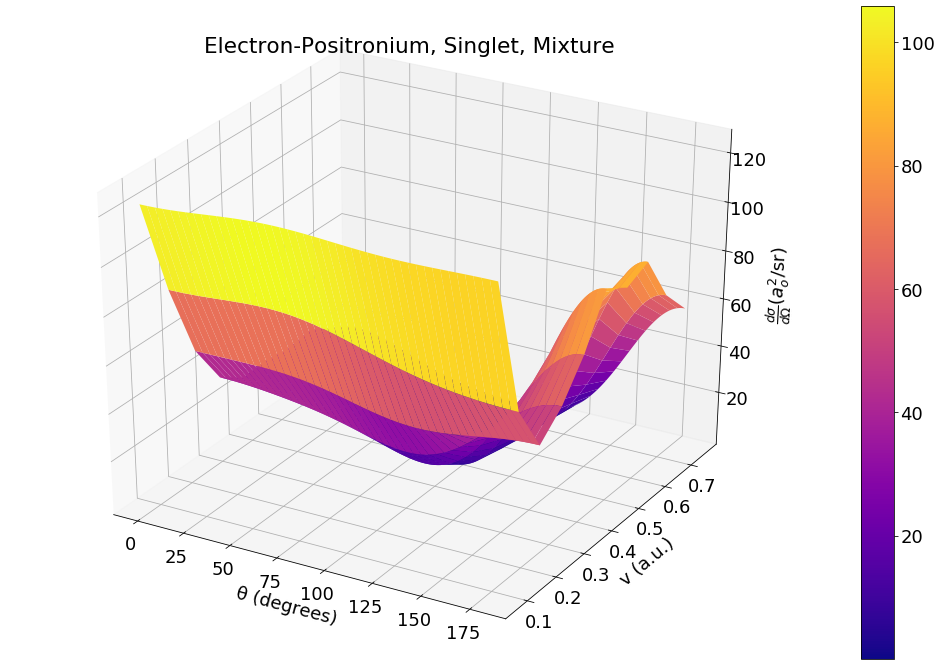

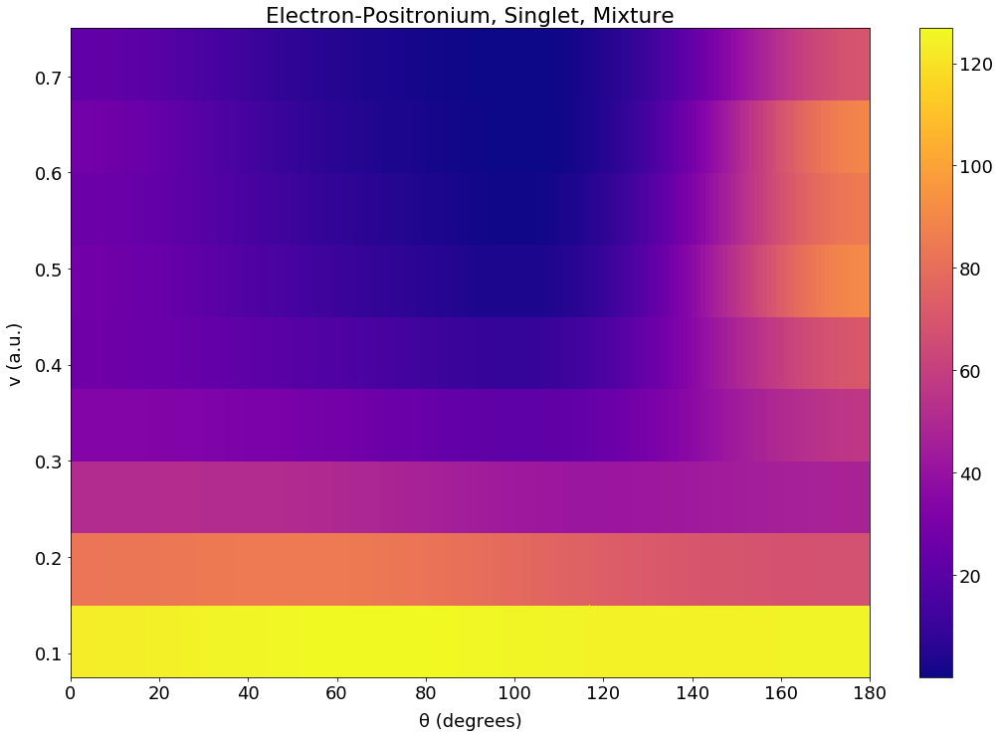

In [85]:
e_ps_system_m = collision(e_ps_phases_m,k_e_ps_m, 'Electron-Positronium, Singlet, Mixture',(2/3))


e_ps_system_m.plot_phase_shifts(velocity=True)
e_ps_system_m.plot_cross_section(velocity=True)
e_ps_system_m.plot_momentum_transfer(velocity=True)
e_ps_system_m.plot_diff_cross_vs_k(r_interval,velocity=True)
e_ps_system_m.diff_plot(velocity=True)
e_ps_system_m.diff_plot(sin=True,velocity=True)
e_ps_system_m.diff_plot_3d(velocity=True)
e_ps_system_m.diff_plot_3d(density=True,velocity=True)

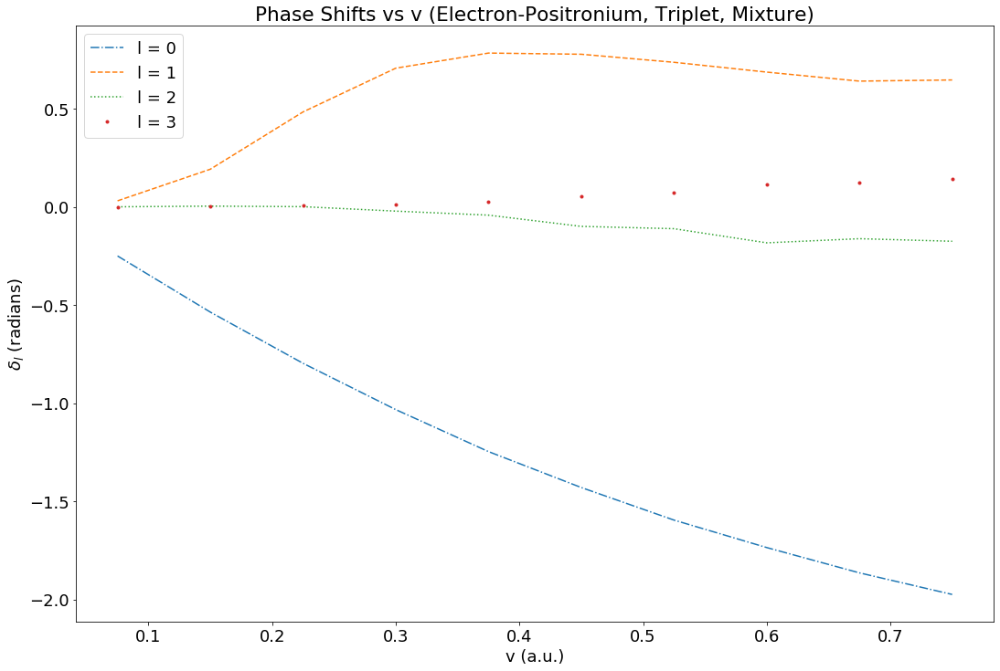

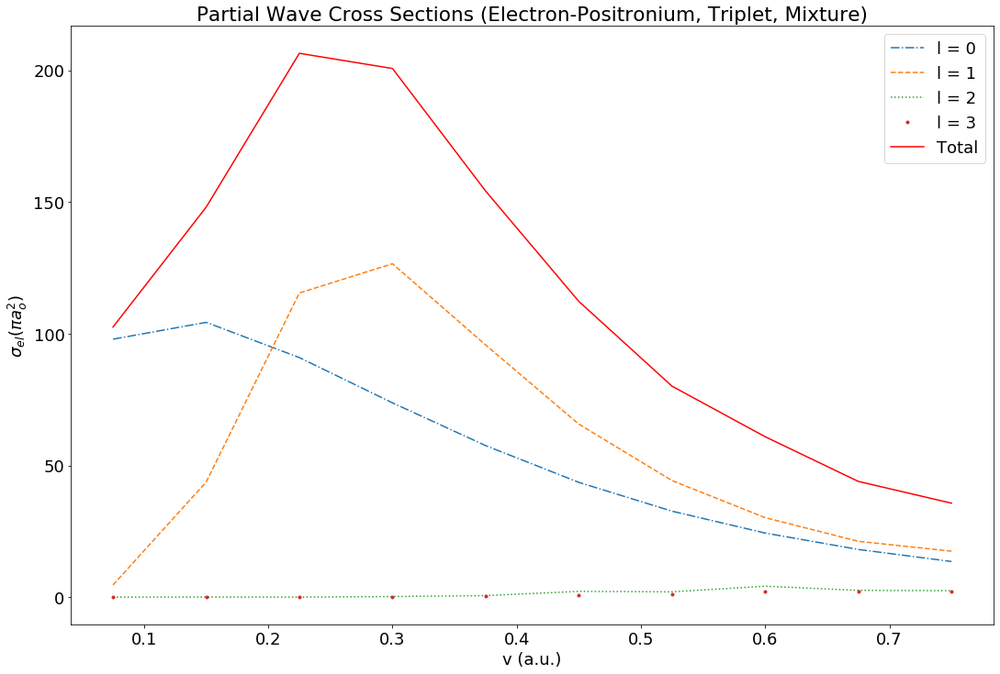

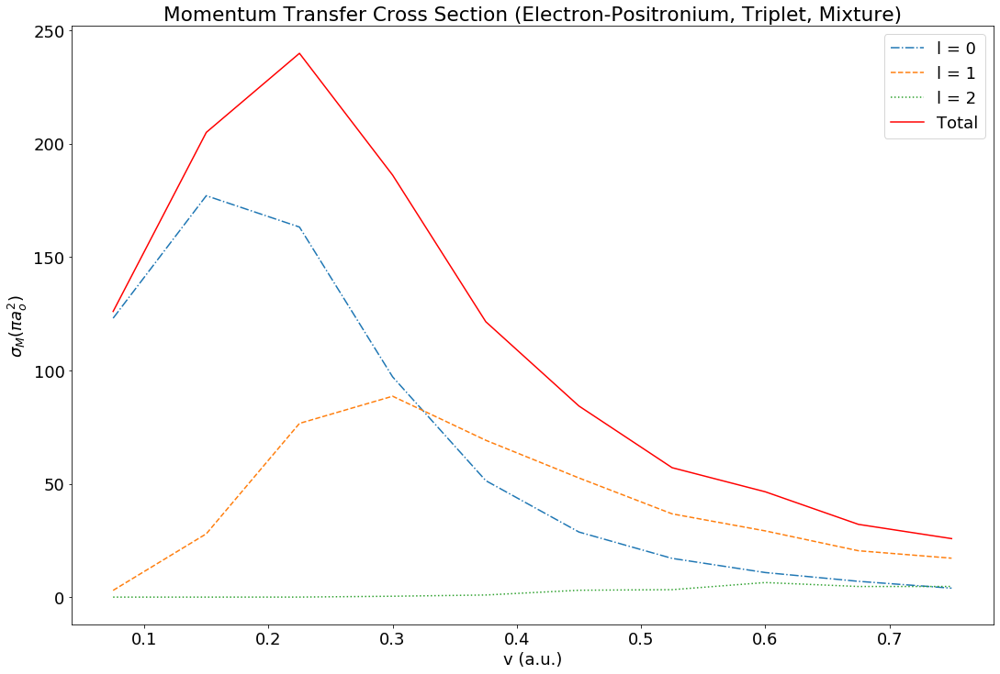

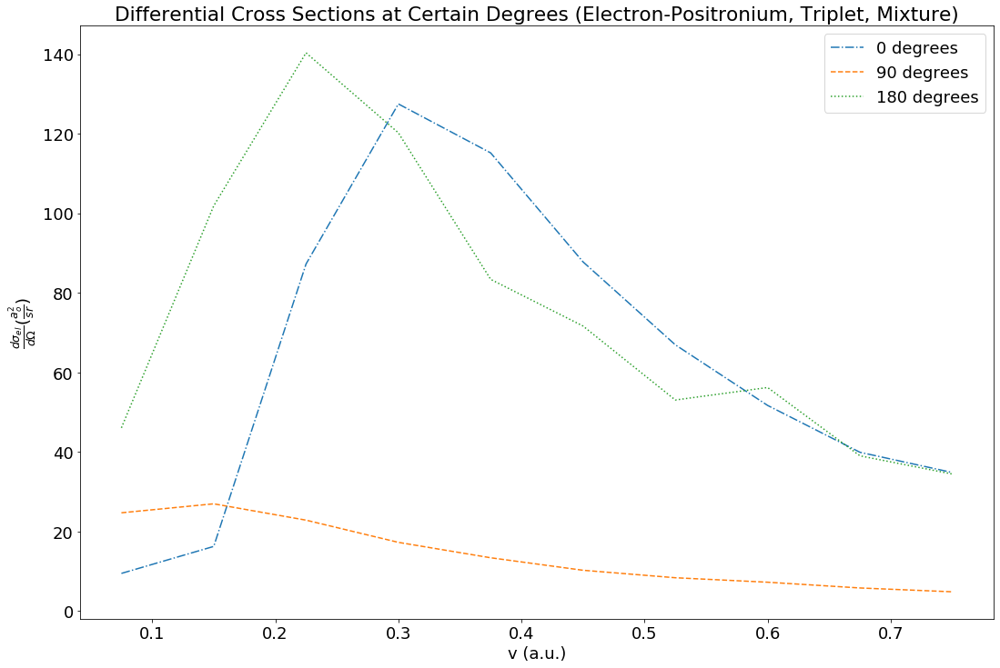

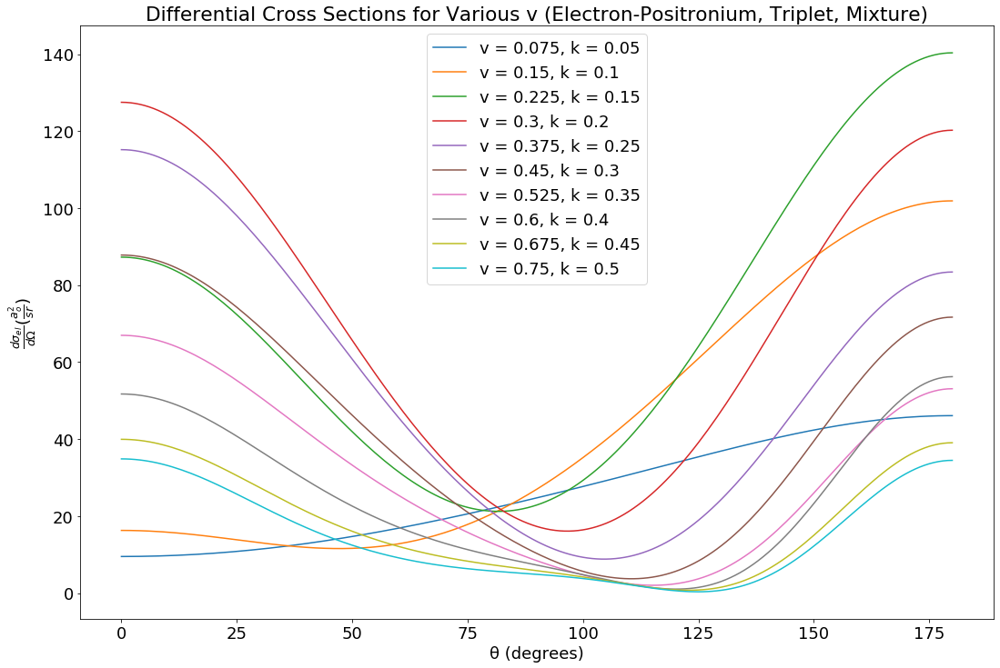

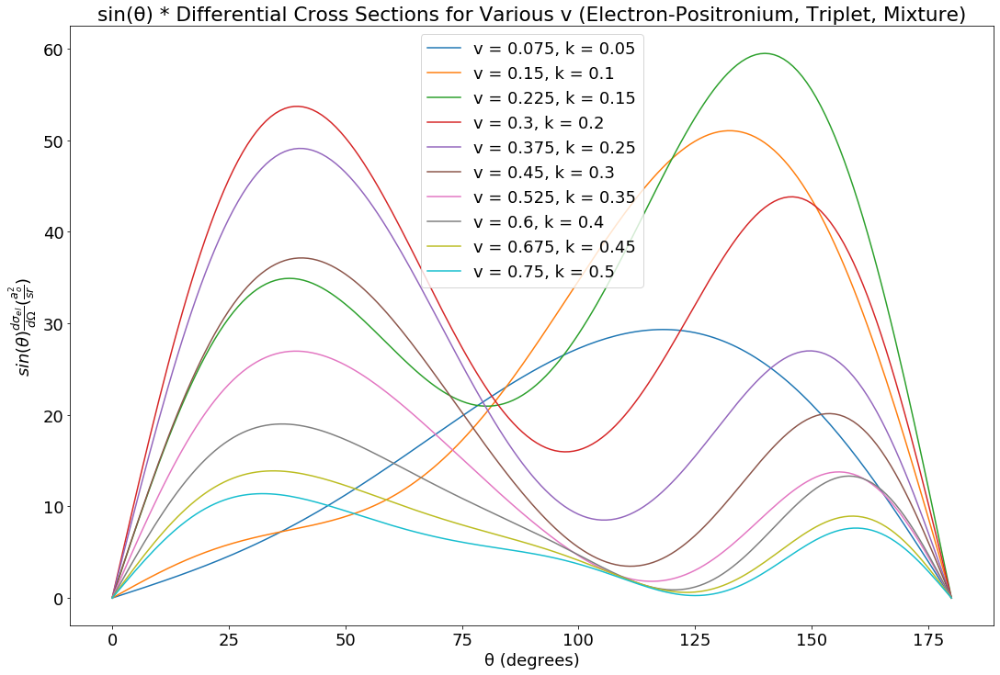

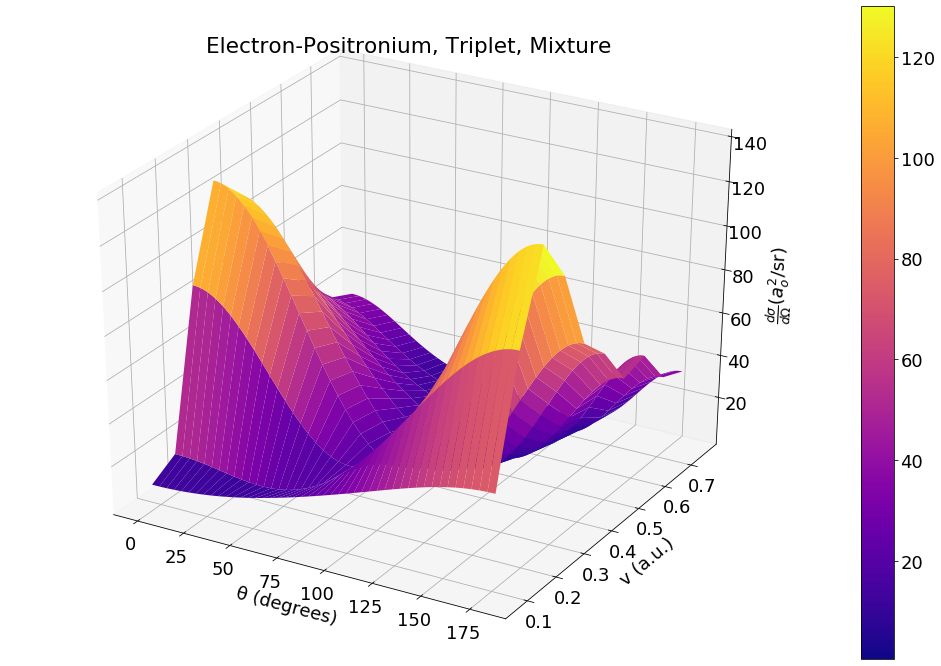

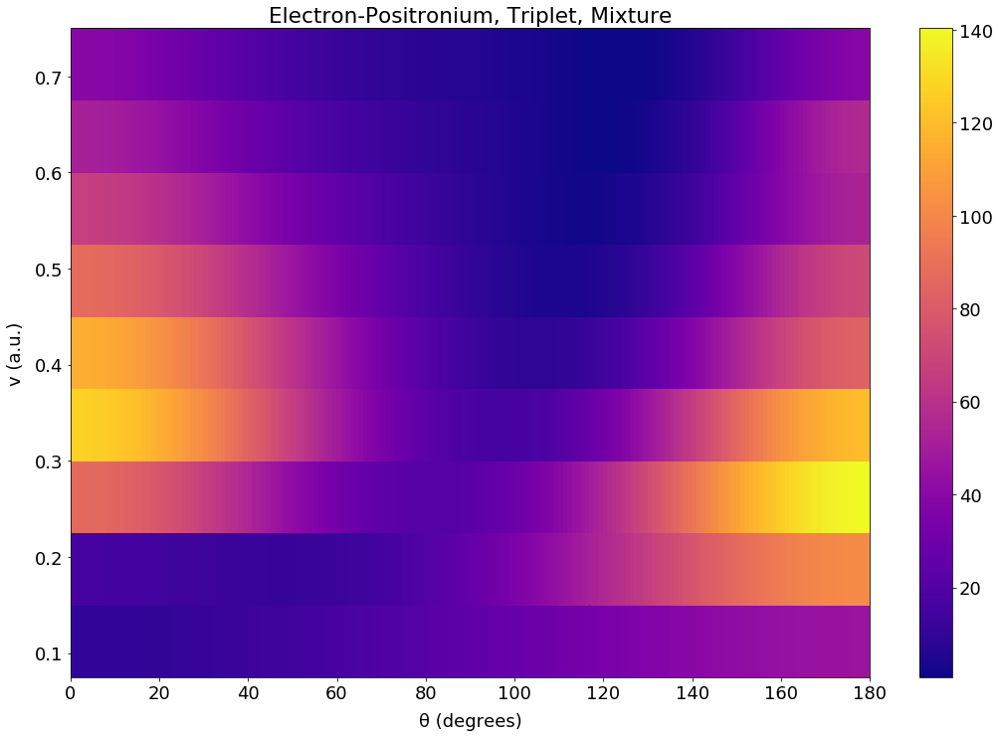

In [86]:
e_ps_triplet_system_m = collision(e_ps_phases_trip_m,k_e_ps_m, 'Electron-Positronium, Triplet, Mixture',(2/3))


e_ps_triplet_system_m.plot_phase_shifts(velocity=True)
e_ps_triplet_system_m.plot_cross_section(velocity=True)
e_ps_triplet_system_m.plot_momentum_transfer(velocity=True)
e_ps_triplet_system_m.plot_diff_cross_vs_k(r_interval,velocity=True)
e_ps_triplet_system_m.diff_plot(velocity=True)
e_ps_triplet_system_m.diff_plot(sin=True, velocity=True)
e_ps_triplet_system_m.diff_plot_3d(velocity=True)
e_ps_triplet_system_m.diff_plot_3d(density=True, velocity=True)

In [87]:
e_ps_weighted_m = collision(e_ps_phases_m,k_e_ps_m,'Electron-Positronium (Spin weighted), Mixture',(2/3),e_ps_phases_trip_m,k_e_ps_m,(2/3))

In [88]:
e_ps_cross_data = e_ps_weighted_m.plot_cross_section(spin_weight=True, velocity=True, data=True)


display(e_ps_cross_data)
get_avg(e_ps_cross_data, 'total cross section')
data_max(e_ps_cross_data, 'total cross section')
data_min(e_ps_cross_data, 'total cross section')

,v,total cross section,l = 0 contribution,l = 1 contribution,l = 2 contribution,l = 3 contribution
0,0.075,202.433,98.2881%,1.7087%,0.0012%,0.002%
1,0.150,189.787,82.457%,17.4947%,0.0398%,0.0085%
2,0.225,201.124,55.8059%,44.061%,0.1136%,0.0194%
3,0.300,179.528,44.2284%,55.1438%,0.5662%,0.0615%
4,0.375,136.337,41.4723%,56.8703%,1.4692%,0.1882%
5,0.450,101.446,39.7958%,55.1126%,4.4577%,0.6338%
6,0.525,74.483,39.0667%,53.8009%,5.8879%,1.2445%
7,0.600,58.694,35.9866%,49.7586%,11.2444%,3.0104%
8,0.675,43.422,35.6015%,50.3253%,10.374%,3.6993%
9,0.750,34.862,32.9383%,50.5952%,11.4181%,5.0484%


Average value for total cross section : 122.212
Maximum value for total cross section


,v,total cross section,l = 0 contribution,l = 1 contribution,l = 2 contribution,l = 3 contribution
0,0.075,202.433,98.2881%,1.7087%,0.0012%,0.002%


Minimum value for total cross section


,v,total cross section,l = 0 contribution,l = 1 contribution,l = 2 contribution,l = 3 contribution
9,0.75,34.862,32.9383%,50.5952%,11.4181%,5.0484%


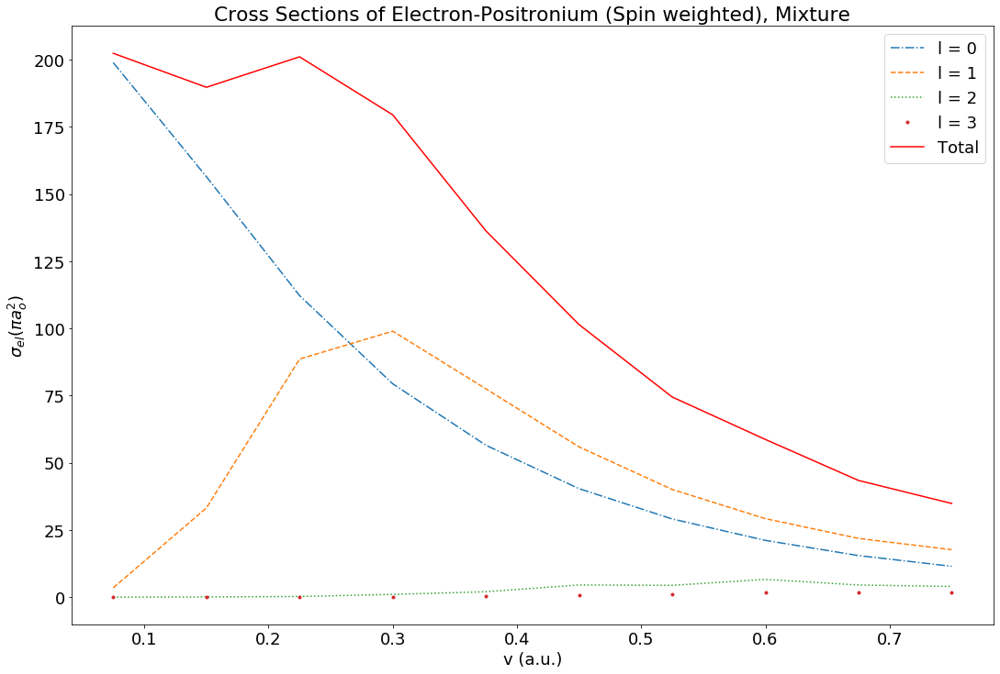

In [89]:
e_ps_weighted_m.plot_cross_section(spin_weight=True, velocity=True)

The elastic cross section decreases shortly then rises briefly before gradually decreasing with increasing velocity. The contribution from the s wave quickly decreases while the p wave contribution quickly increases. At v = 0.30 the p wave becomes the majority contributor. Beyond this point, the s and p wave contributions become increasingly similar. At the highest velocity, the contributions from the s, p, d, and f waves are 33, 51, 11, and 5 percent, respectively. 

In [90]:
e_ps_momentum_data = e_ps_weighted_m.plot_momentum_transfer(spin_weight=True, velocity=True, data=True)


display(e_ps_momentum_data)
get_avg(e_ps_momentum_data, 'total momentum transfer')
data_max(e_ps_momentum_data, 'total momentum transfer')
data_min(e_ps_momentum_data, 'total momentum transfer')

,v,total momentum transfer,l = 0 contribution,l = 1 contribution,l = 2 contribution
0,0.075,219.813,98.984%,1.016%,0.0%
1,0.150,229.289,90.6546%,9.3363%,0.009%
2,0.225,224.477,73.4015%,26.5485%,0.05%
3,0.300,169.907,57.5776%,41.9852%,0.4371%
4,0.375,115.171,47.2956%,51.3042%,1.4002%
5,0.450,85.120,38.1501%,56.9649%,4.885%
6,0.525,61.557,33.7397%,59.1415%,7.1188%
7,0.600,52.027,27.1998%,58.5674%,14.2329%
8,0.675,37.806,26.2681%,59.4408%,14.2911%
9,0.750,30.328,21.867%,61.1148%,17.0182%


Average value for total momentum transfer : 122.55
Maximum value for total momentum transfer


,v,total momentum transfer,l = 0 contribution,l = 1 contribution,l = 2 contribution
1,0.15,229.289,90.6546%,9.3363%,0.009%


Minimum value for total momentum transfer


,v,total momentum transfer,l = 0 contribution,l = 1 contribution,l = 2 contribution
9,0.75,30.328,21.867%,61.1148%,17.0182%


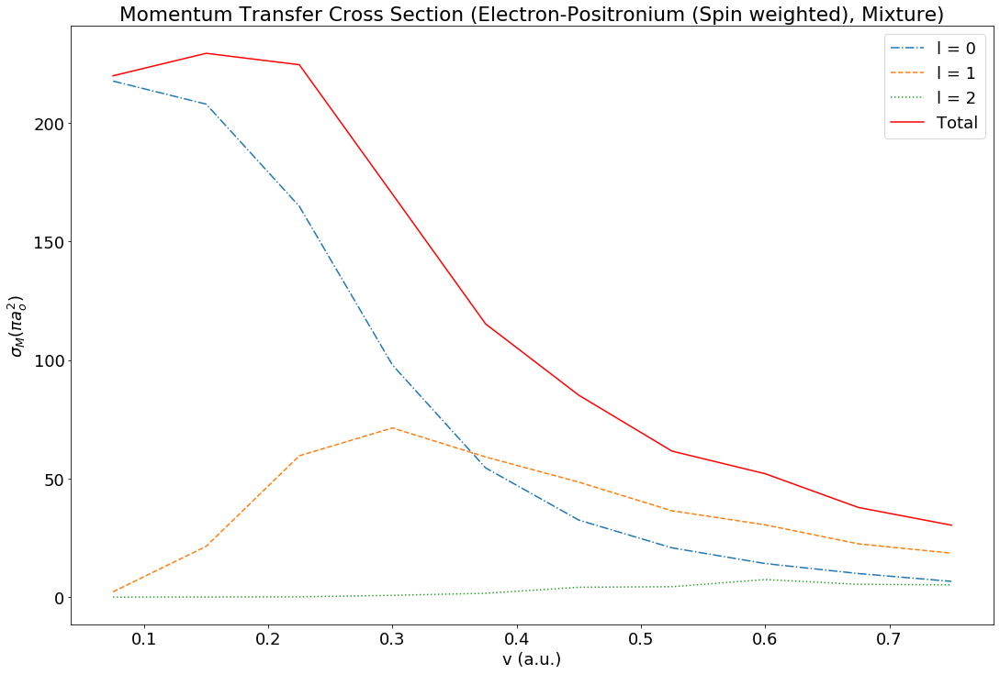

In [91]:
e_ps_weighted_m.plot_momentum_transfer(spin_weight=True, velocity=True)

The momentum transfer cross section starts greater than the elastic cross section but becomes less than at v = 0.30. This difference increases with increasing velocity. The momentum transfer cross section maintains majority contribution from the s wave longer than the elastic cross section does. At v = 0.375, the p wave becomes the majority contributor. 

In [92]:
e_ps_cross_momentum = cross_momentum_compare(e_ps_cross_data, e_ps_momentum_data)


display(e_ps_cross_momentum)
get_avg(e_ps_cross_momentum, 'ratio momentum/cross')
data_max(e_ps_cross_momentum, 'ratio momentum/cross')
data_min(e_ps_cross_momentum, 'ratio momentum/cross')

,v,total cross section,total momentum transfer,ratio momentum/cross
0,0.075,202.433,219.813,1.086
1,0.150,189.787,229.289,1.208
2,0.225,201.124,224.477,1.116
3,0.300,179.528,169.907,0.946
4,0.375,136.337,115.171,0.845
5,0.450,101.446,85.120,0.839
6,0.525,74.483,61.557,0.826
7,0.600,58.694,52.027,0.886
8,0.675,43.422,37.806,0.871
9,0.750,34.862,30.328,0.870


Average value for ratio momentum/cross : 0.949
Maximum value for ratio momentum/cross


,v,total cross section,total momentum transfer,ratio momentum/cross
1,0.15,189.787,229.289,1.208


Minimum value for ratio momentum/cross


,v,total cross section,total momentum transfer,ratio momentum/cross
6,0.525,74.483,61.557,0.826


In [93]:
e_ps_diff_degree =  e_ps_weighted_m.plot_diff_cross_vs_k(r_interval,spin_weight=True, velocity=True, data=True)

display(e_ps_diff_degree)

,v,0 degrees,90 degrees,180 degrees
0,0.075,37.954,50.085,65.835
1,0.150,32.984,40.323,93.308
2,0.225,78.307,28.346,117.050
3,0.300,104.035,18.569,104.242
4,0.375,93.135,12.550,80.216
5,0.450,72.789,8.612,76.503
6,0.525,56.781,6.651,61.095
7,0.600,45.772,5.638,64.519
8,0.675,35.605,4.485,46.661
9,0.750,30.318,3.747,40.271


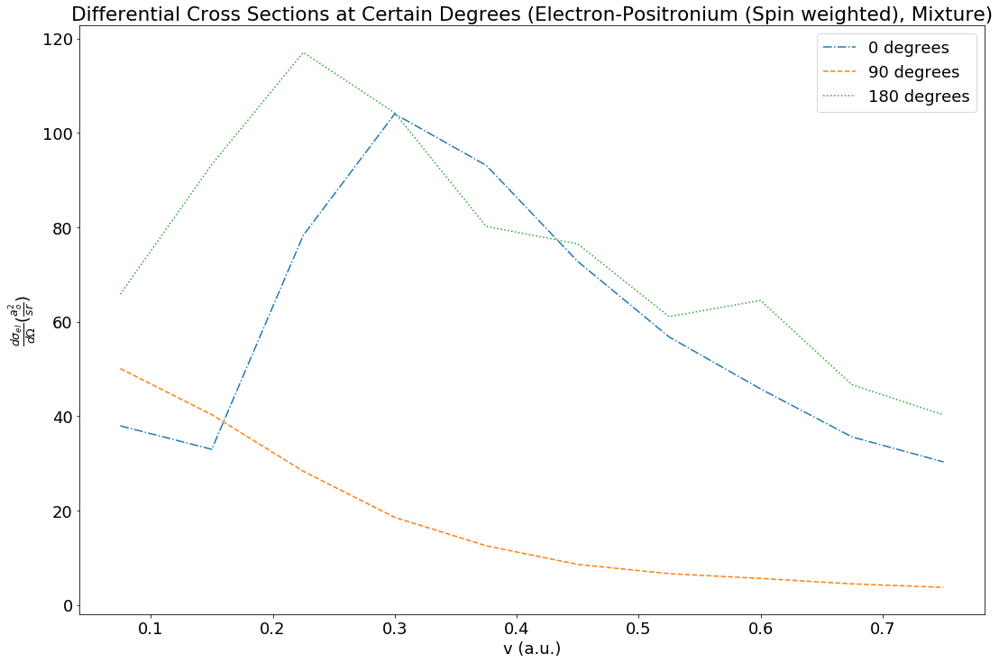

In [94]:
e_ps_weighted_m.plot_diff_cross_vs_k(r_interval,spin_weight=True, velocity=True)

At 0 and 180 degrees there is a quick increase before a decrease with increasing velocity. At 180 degrees the slope changes repeatedly. At 90 degrees it is a simple gradual decrease with increasing energy. 

In [95]:
e_ps_diff = e_ps_weighted_m.diff_plot(velocity=True, data=True)
sliced = e_ps_diff[e_ps_diff.index % 10 == 0 ]
display(sliced)

,degrees,v = 0.075,v = 0.15,v = 0.225,v = 0.3,v = 0.375,v = 0.45,v = 0.525,v = 0.6,v = 0.675,v = 0.75
0,0,123.342,83.128,51.464,33.699,27.017,27.763,26.285,27.968,22.623,16.726
10,10,123.528,83.296,51.484,33.498,26.550,26.882,25.315,26.769,21.670,15.995
20,20,124.044,83.751,51.522,32.938,25.264,24.457,22.644,23.448,19.027,13.968
30,30,124.779,84.352,51.513,32.111,23.437,21.057,18.893,18.753,15.280,11.098
40,40,125.574,84.890,51.336,31.076,21.356,17.366,14.831,13.680,11.204,7.992
50,50,126.260,85.124,50.838,29.808,19.168,13.910,11.093,9.156,7.526,5.226
60,60,126.699,84.845,49.888,28.222,16.864,10.890,7.971,5.739,4.688,3.161
70,70,126.815,83.932,48.453,26.294,14.403,8.206,5.404,3.460,2.737,1.832
80,80,126.612,82.392,46.656,24.203,11.928,5.718,3.200,1.925,1.412,0.997
90,90,126.167,80.355,44.771,22.399,9.948,3.614,1.412,0.729,0.456,0.387


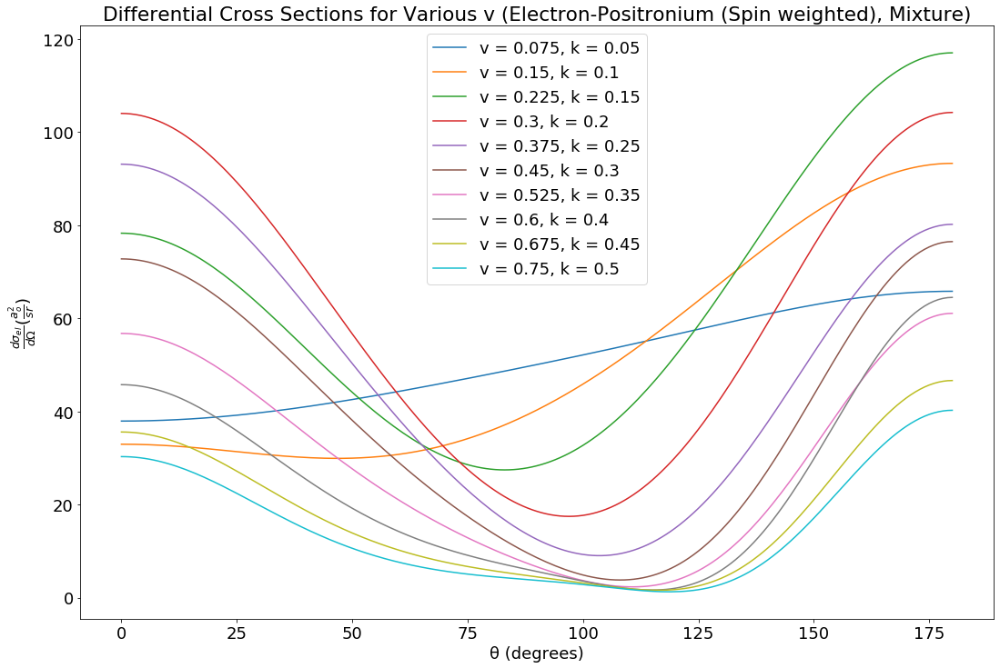

In [96]:
e_ps_weighted_m.diff_plot(spin_weight=True, velocity=True)

At low velocity, the curve is a mixture between linear and curved. At mid-range velocities the differential cross section quickly falls and then quickly rises. At higher velocities the decrease is slower but the increase is mostly just as quick as mid-range.

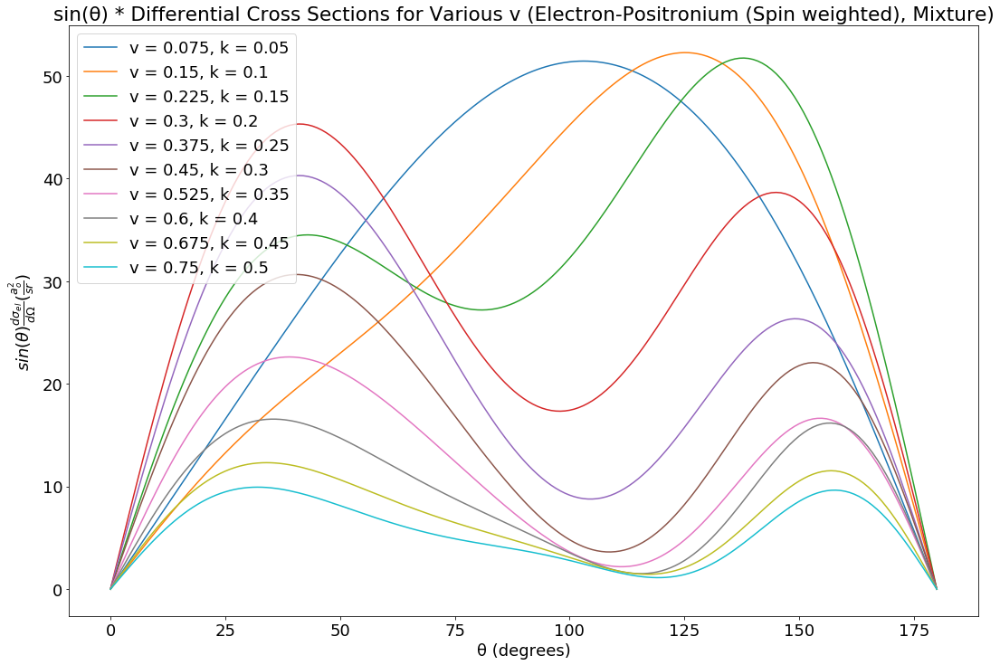

In [97]:
e_ps_weighted_m.diff_plot(spin_weight=True, sin=True, velocity=True)

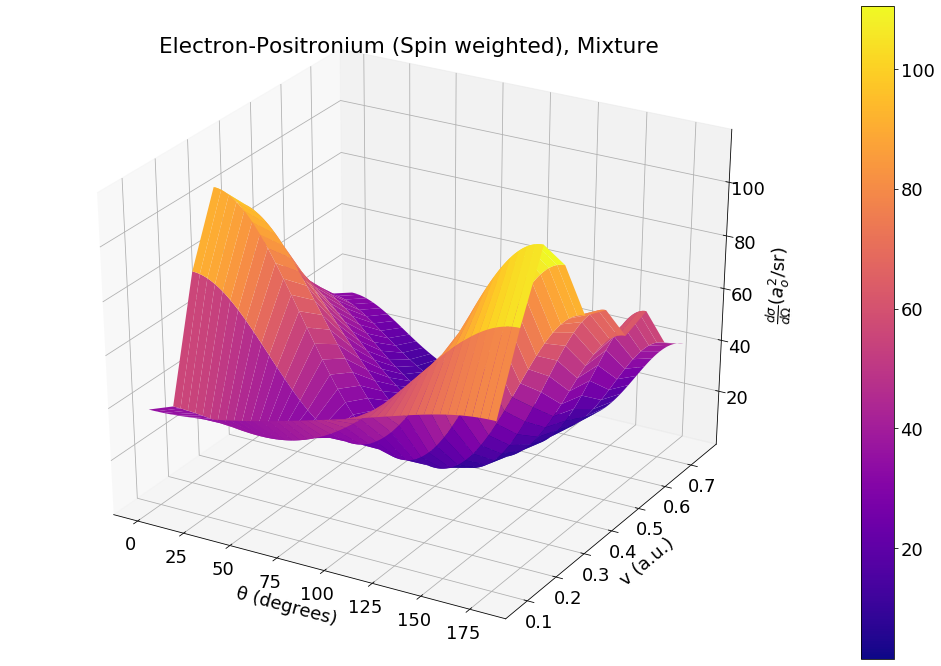

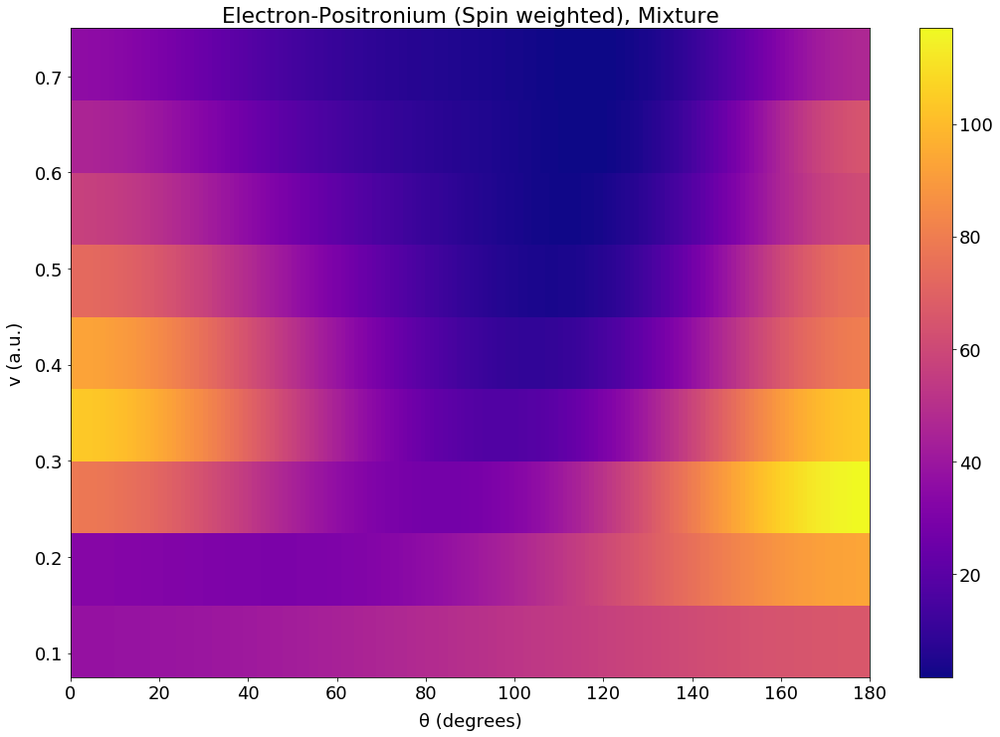

In [98]:
e_ps_weighted_m.diff_plot_3d(spin_weight=True, velocity=True)
e_ps_weighted_m.diff_plot_3d(spin_weight=True, density=True, velocity=True)

At degrees less than 60, the differential cross section quickly rises to a peak with increasing energy before falling again. At mid-range degrees, the differential cross section falls and remains low for increasing energy. At high degrees, the differential cross section increases even more rapidly than at low degrees before gradually decreasing with increasing velocity. 

# Conclusions 

The elastic cross section of positronium-helium becomes increasingly similar to that of electron-helium with increasing velocity, within the velocity range examined. This is especially similar when compared to the massive difference when comparing the elastic cross section of positronium-helium to positron helium. This suggest that the positron in positronium has little influence for scattering at certain velocities. The p wave makes a significant contribution to the elastic cross section with increasing energy of positronium-helium, while it makes little contribution to that of electron-helium. The momentum transfer cross section declines faster than the elastic cross section for positronium-helium, which results in the momentum transfer of electron-helium being greater after v = 0.3. The shape of the differential cross section of one system is very similar to the other’s inverted, though overall the magnitude for that of positronium-helium is greater. None of the cross sections for positron-helium are similar to electron-helium. The elastic cross section of positron-helium is never even 2% that of positronium-helium for all compared velocities. The p wave makes a greater contribution to the elastic cross section of positron-helium than that of positronium-helium. For velocity greater than 0.2, the shape of the differential cross section is similar for the two systems, but the magnitude for positronium-helium is far greater. The shape of the elastic cross section for positron-hydrogen is similar to that of positron-helium at velocities less than 0.4. Outside of when both degrees and velocity is high, the shape of the differential cross section for positron-hydrogen and positron-helium are similar. However, at the intersection of high degrees and velocity, the positron-hydrogen’s stays at a minimum while it increases in the positron-helium system.

# References

[1] J W Humberston, P Van Reeth, M S T Watts and W E Meyerhof  J. Phys. B: At. Mol. Opt. Phys. **30**, 2477 (1997)

[2] T. T. Gien, J. Phys. Rev. A **56**, 1332 (1997)

[3] P Van Reeth and J W Humberston J. Phys. B: At. Mol. Opt. Phys. **32**, 3651 (1999)

[4] A. L. Sinfailam and R K Nesbet Phys. Rev. A **6**, 2118 (1972) 

[5] R. K. Nesbet Phys. Rev. A **20**, 58 (1979)

[6] R K Nesbet  J. Phys. B: At. Mol. Phys. **12**, L243 (1979)

[7] Nirmal K Sarkar and A S Ghosh J. Phys. B: At. Mol. Opt. Phys. **30**, 4591 (1997)

[8] Nirmal K Sarkar, Puspitapallab Chaudhury, and A S Ghosh  J. Phys. B: At. Mol. Opt. Phys. **32**, 1657 (1999)

[9] S J Ward, J W Humberston, and M R C McDowell. Phys. B: At. Mol. Opt. Phys **20** (1987)

[10] A. Igarashi, S. Nakazaki, and A. Ohsaki Phys. Rev. A **61**, 032710 (2000)

[11] I. A. Ivanov, J. Mitroy, and K. Varga Phys. Rev. A **65**, 022704 (2002)

[12] P Van Reeth, private communication 2020, additional positron-hydrogen phase shifts

[13] P Van Reeth, private communication 2020, additional positron-helium phase shifts

[14] P Van Reeth, Denton Woods, S J Ward, and J W Humberston J. Phys. B: At. Mol. Opt. Phys. **49**, 114001 (2016)

[15] S. Brawley, S. Armitage, J. Beale, D. Leslie, A. Williams, & G. Laricchia, Electron-Like Scattering of Positronium. Science, **330**, (6005) (2010)

[16] S. J. Brawley, S. E. Fayer, M. Shipman, and G. Laricchia Phys. Rev. Lett. **115**, 223201 (2015)

[17] D. J. Griffiths, & D. F. Schroeter,  Introduction to Quantum Mechanics (3rd ed.). Cambridge: Cambridge University Press. (2018)

[18] B. H. Bransden, & C. J. Joachain, Physics of atoms and molecules (2nd ed.). Harlow: Prentice Hall. (2003)
